**Корректность проверена на Python 3.6:**
+ numpy 1.15.4
+ pandas 0.23.4

# Линейная регрессия и стохастический градиентный спуск

Задание основано на материалах лекций по линейной регрессии и градиентному спуску. Вы будете прогнозировать выручку компании в зависимости от уровня ее инвестиций в рекламу по TV, в газетах и по радио.

## Вы научитесь:
- решать задачу восстановления линейной регрессии
- реализовывать стохастический градиентный спуск для ее настройки
- решать задачу линейной регрессии аналитически

## Введение
Линейная регрессия - один из наиболее хорошо изученных методов машинного обучения, позволяющий прогнозировать значения количественного признака в виде линейной комбинации прочих признаков с параметрами - весами модели. Оптимальные (в смысле минимальности некоторого функционала ошибки) параметры линейной регрессии можно найти аналитически с помощью нормального уравнения или численно с помощью методов оптимизации.  

Линейная регрессия использует простой функционал качества - среднеквадратичную ошибку. Мы будем работать с выборкой, содержащей 3 признака. Для настройки параметров (весов) модели решается следующая задача:
$$\Large \frac{1}{\ell}\sum_{i=1}^\ell{{((w_0 + w_1x_{i1} + w_2x_{i2} +  w_3x_{i3}) - y_i)}^2} \rightarrow \min_{w_0, w_1, w_2, w_3},$$
где $x_{i1}, x_{i2}, x_{i3}$ - значения признаков $i$-го объекта, $y_i$ - значение целевого признака $i$-го объекта, $\ell$ - число объектов в обучающей выборке.

## Градиентный спуск
Параметры $w_0, w_1, w_2, w_3$, по которым минимизируется среднеквадратичная ошибка, можно находить численно с помощью градиентного спуска.
Градиентный шаг для весов будет выглядеть следующим образом:
$$\Large w_0 \leftarrow w_0 - \frac{2\eta}{\ell} \sum_{i=1}^\ell{{((w_0 + w_1x_{i1} + w_2x_{i2} +  w_3x_{i3}) - y_i)}}$$
$$\Large w_j \leftarrow w_j - \frac{2\eta}{\ell} \sum_{i=1}^\ell{{x_{ij}((w_0 + w_1x_{i1} + w_2x_{i2} +  w_3x_{i3}) - y_i)}},\ j \in \{1,2,3\}$$
Здесь $\eta$ - параметр, шаг градиентного спуска.

## Стохастический градиентный спуск
Проблема градиентного спуска, описанного выше, в том, что на больших выборках считать на каждом шаге градиент по всем имеющимся данным может быть очень вычислительно сложно. 
В стохастическом варианте градиентного спуска поправки для весов вычисляются только с учетом одного случайно взятого объекта обучающей выборки:
$$\Large w_0 \leftarrow w_0 - \frac{2\eta}{\ell} {((w_0 + w_1x_{k1} + w_2x_{k2} +  w_3x_{k3}) - y_k)}$$
$$\Large w_j \leftarrow w_j - \frac{2\eta}{\ell} {x_{kj}((w_0 + w_1x_{k1} + w_2x_{k2} +  w_3x_{k3}) - y_k)},\ j \in \{1,2,3\},$$
где $k$ - случайный индекс, $k \in \{1, \ldots, \ell\}$.

## Нормальное уравнение 
Нахождение вектора оптимальных весов $w$ может быть сделано и аналитически.
Мы хотим найти такой вектор весов $w$, чтобы вектор $y$, приближающий целевой признак, получался умножением матрицы $X$ (состоящей из всех признаков объектов обучающей выборки, кроме целевого) на вектор весов $w$. То есть, чтобы выполнялось матричное уравнение:
$$\Large y = Xw$$
Домножением слева на $X^T$ получаем:
$$\Large X^Ty = X^TXw$$
Это хорошо, поскольку теперь матрица $X^TX$ - квадратная, и можно найти решение (вектор $w$) в виде:
$$\Large w = {(X^TX)}^{-1}X^Ty$$
Матрица ${(X^TX)}^{-1}X^T$ - [*псевдообратная*](https://ru.wikipedia.org/wiki/Псевдообратная_матрица) для матрицы $X$. В NumPy такую матрицу можно вычислить с помощью функции [numpy.linalg.pinv](http://docs.scipy.org/doc/numpy-1.10.0/reference/generated/numpy.linalg.pinv.html).

Однако, нахождение псевдообратной матрицы - операция вычислительно сложная и нестабильная в случае малого определителя матрицы $X$ (проблема мультиколлинеарности). 
На практике лучше находить вектор весов $w$ решением матричного уравнения 
$$\Large X^TXw = X^Ty$$Это может быть сделано с помощью функции [numpy.linalg.solve](http://docs.scipy.org/doc/numpy-1.10.1/reference/generated/numpy.linalg.solve.html).

Но все же на практике для больших матриц $X$ быстрее работает градиентный спуск, особенно его стохастическая версия.

## Инструкции по выполнению

**1. Загрузите данные из файла *advertising.csv* в объект pandas DataFrame. [Источник данных](http://www-bcf.usc.edu/~gareth/ISL/data.html).**

In [1]:
import pandas as pd
adver_data = pd.read_csv('advertising.csv')

**Посмотрите на первые 5 записей и на статистику признаков в этом наборе данных.**

In [2]:
# Ваш код здесь
first_5_rows = adver_data.head()
first_5_rows

,TV,Radio,Newspaper,Sales
1,230.1,37.8,69.2,22.1
2,44.5,39.3,45.1,10.4
3,17.2,45.9,69.3,9.3
4,151.5,41.3,58.5,18.5
5,180.8,10.8,58.4,12.9


In [3]:
# Ваш код здесь
adver_data.describe()

,TV,Radio,Newspaper,Sales
count,200.000000,200.000000,200.000000,200.000000
mean,147.042500,23.264000,30.554000,14.022500
std,85.854236,14.846809,21.778621,5.217457
min,0.700000,0.000000,0.300000,1.600000
25%,74.375000,9.975000,12.750000,10.375000
50%,149.750000,22.900000,25.750000,12.900000
75%,218.825000,36.525000,45.100000,17.400000
max,296.400000,49.600000,114.000000,27.000000


In [4]:
adver_data.isna().sum()

TV           0
Radio        0
Newspaper    0
Sales        0
dtype: int64

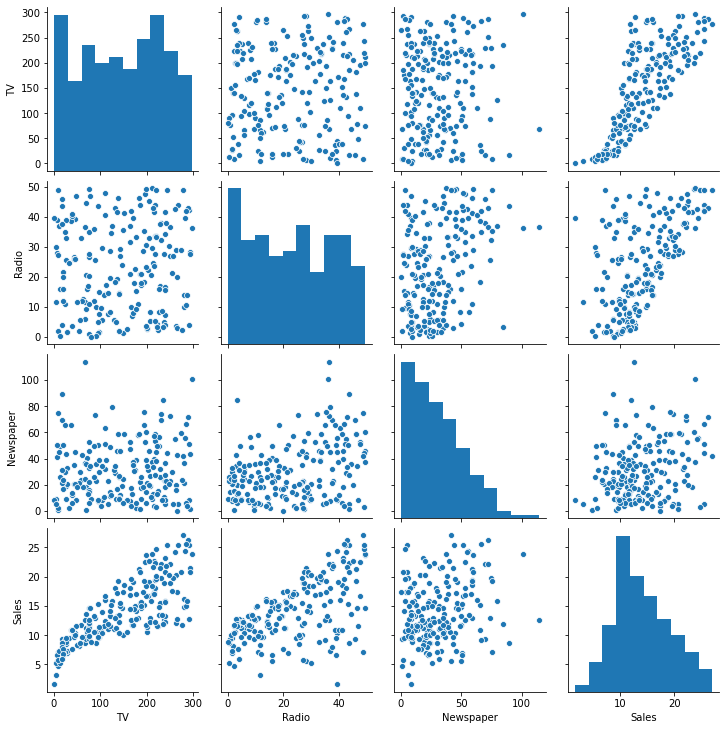

In [5]:
import seaborn as sns
sns.pairplot(adver_data)

**Создайте массивы NumPy *X* из столбцов TV, Radio и Newspaper и *y* - из столбца Sales. Используйте атрибут *values* объекта pandas DataFrame.**

In [6]:
X = adver_data.drop("Sales", axis=1).to_numpy()
y = adver_data.Sales.values

In [7]:
type(X), type(y)

(numpy.ndarray, numpy.ndarray)

In [8]:
y

array([22.1, 10.4,  9.3, 18.5, 12.9,  7.2, 11.8, 13.2,  4.8, 10.6,  8.6,
       17.4,  9.2,  9.7, 19. , 22.4, 12.5, 24.4, 11.3, 14.6, 18. , 12.5,
        5.6, 15.5,  9.7, 12. , 15. , 15.9, 18.9, 10.5, 21.4, 11.9,  9.6,
       17.4,  9.5, 12.8, 25.4, 14.7, 10.1, 21.5, 16.6, 17.1, 20.7, 12.9,
        8.5, 14.9, 10.6, 23.2, 14.8,  9.7, 11.4, 10.7, 22.6, 21.2, 20.2,
       23.7,  5.5, 13.2, 23.8, 18.4,  8.1, 24.2, 15.7, 14. , 18. ,  9.3,
        9.5, 13.4, 18.9, 22.3, 18.3, 12.4,  8.8, 11. , 17. ,  8.7,  6.9,
       14.2,  5.3, 11. , 11.8, 12.3, 11.3, 13.6, 21.7, 15.2, 12. , 16. ,
       12.9, 16.7, 11.2,  7.3, 19.4, 22.2, 11.5, 16.9, 11.7, 15.5, 25.4,
       17.2, 11.7, 23.8, 14.8, 14.7, 20.7, 19.2,  7.2,  8.7,  5.3, 19.8,
       13.4, 21.8, 14.1, 15.9, 14.6, 12.6, 12.2,  9.4, 15.9,  6.6, 15.5,
        7. , 11.6, 15.2, 19.7, 10.6,  6.6,  8.8, 24.7,  9.7,  1.6, 12.7,
        5.7, 19.6, 10.8, 11.6,  9.5, 20.8,  9.6, 20.7, 10.9, 19.2, 20.1,
       10.4, 11.4, 10.3, 13.2, 25.4, 10.9, 10.1, 16

**Отмасштабируйте столбцы матрицы *X*, вычтя из каждого значения среднее по соответствующему столбцу и поделив результат на стандартное отклонение. Для определенности, используйте методы mean и std векторов NumPy (реализация std в Pandas может отличаться). Обратите внимание, что в numpy вызов функции .mean() без параметров возвращает среднее по всем элементам массива, а не по столбцам, как в pandas. Чтобы произвести вычисление по столбцам, необходимо указать параметр axis.**

In [9]:
import numpy as np
means, stds = np.mean(X, axis=0), np.std(X, axis=0)

In [10]:
X = (X - means)/stds

**Добавьте к матрице *X* столбец из единиц, используя методы *hstack*, *ones* и *reshape* библиотеки NumPy. Вектор из единиц нужен для того, чтобы не обрабатывать отдельно коэффициент $w_0$ линейной регрессии.**

In [11]:
import numpy as np
nrows = X.shape[0]
w0s = np.ones((nrows, 1))
X = np.hstack((w0s, X))

**2. Реализуйте функцию *mserror* - среднеквадратичную ошибку прогноза. Она принимает два аргумента - объекты Series *y* (значения целевого признака) и *y\_pred* (предсказанные значения). Не используйте в этой функции циклы - тогда она будет вычислительно неэффективной.**

In [31]:
def mserror(y, y_pred):
    print(y.shape, y_pred.shape)
    return ((y - y_pred)**2).sum()/len(y)

In [13]:
mserror(pd.Series([1, 2, 3]), pd.Series([1, 2, 3]))

0.0

**Какова среднеквадратичная ошибка прогноза значений Sales, если всегда предсказывать медианное значение Sales по исходной выборке? Полученный результат, округленный до 3 знаков после запятой, является ответом на *'1 задание'.***

In [14]:
answer1 = mserror(adver_data.Sales, adver_data.Sales.mean())
print(round(answer1, 3))

27.086


**3. Реализуйте функцию *normal_equation*, которая по заданным матрицам (массивам NumPy) *X* и *y* вычисляет вектор весов $w$ согласно нормальному уравнению линейной регрессии.**

In [15]:
def normal_equation(X, y):
    #print("pinv used: ", np.matmul(np.linalg.pinv(X), y))
    #return np.matmul(np.linalg.pinv(X), y)    
    inversed = np.linalg.inv(np.matmul(X.T,X))
    pseudo_matrix = np.matmul(inversed, X.T)
    sol = np.matmul(pseudo_matrix, y) 
    return sol

In [16]:
norm_eq_weights = normal_equation(X, y)
print(norm_eq_weights)

[14.0225      3.91925365  2.79206274 -0.02253861]


**Какие продажи предсказываются линейной моделью с весами, найденными с помощью нормального уравнения, в случае средних инвестиций в рекламу по ТВ, радио и в газетах? (то есть при нулевых значениях масштабированных признаков TV, Radio и Newspaper). Полученный результат, округленный до 3 знаков после запятой, является ответом на *'2 задание'*.**

In [17]:
mean_values = np.hstack((np.ones(1), np.zeros(3)))

In [18]:
mean_values.shape, norm_eq_weights.shape

((4,), (4,))

In [19]:
answer2 = np.dot(norm_eq_weights, mean_values)
print(round(answer2, 3))

14.022


**4. Напишите функцию *linear_prediction*, которая принимает на вход матрицу *X* и вектор весов линейной модели *w*, а возвращает вектор прогнозов в виде линейной комбинации столбцов матрицы *X* с весами *w*.**

In [20]:
def linear_prediction(X, w):
    return np.matmul(X, w)

**Какова среднеквадратичная ошибка прогноза значений Sales в виде линейной модели с весами, найденными с помощью нормального уравнения?
Полученный результат, округленный до 3 знаков после запятой, является ответом на *'3 задание'***

In [21]:
answer3 = mserror(y, linear_prediction(X, norm_eq_weights))
print(round(answer3, 3))

2.784


**5. Напишите функцию *stochastic_gradient_step*, реализующую шаг стохастического градиентного спуска для линейной регрессии. Функция должна принимать матрицу *X*, вектора *y* и *w*, число *train_ind* - индекс объекта обучающей выборки (строки матрицы *X*), по которому считается изменение весов, а также число *$\eta$* (eta) - шаг градиентного спуска (по умолчанию *eta*=0.01). Результатом будет вектор обновленных весов. Наша реализация функции будет явно написана для данных с 3 признаками, но несложно модифицировать для любого числа признаков, можете это сделать.**

In [35]:
def stochastic_gradient_step(X, y, w, train_ind, eta=0.01):
    training_example = X[train_ind, :]
    print(training_example)
    training_label = y[train_ind]
    diff = np.dot(training_example, w) - training_label
    '''
    print(training_example)
    grad0 = diff
    grad1 = diff*training_example[1]
    grad2 = diff*training_example[2]
    grad3 = diff*training_example[3]
    w - eta * np.array([grad0, grad1, grad2, grad3])
    '''
    grad = np.dot(diff, training_example)
    return  w - eta * grad

In [23]:
stochastic_gradient_step(X, y, norm_eq_weights, 0)

[1.         0.96985227 0.98152247 1.77894547]


array([1.40382603e+01, 3.93453877e+00, 2.80753179e+00, 5.49802691e-03])

In [44]:
X[0]

array([1.        , 0.96985227, 0.98152247, 1.77894547])

In [46]:
X[3]

array([1.        , 0.05204968, 1.21785493, 1.28640506])

In [45]:
X[0][3]

1.7789454671970675

**6. Напишите функцию *stochastic_gradient_descent*, реализующую стохастический градиентный спуск для линейной регрессии. Функция принимает на вход следующие аргументы:**
- X - матрица, соответствующая обучающей выборке
- y - вектор значений целевого признака
- w_init - вектор начальных весов модели
- eta - шаг градиентного спуска (по умолчанию 0.01)
- max_iter - максимальное число итераций градиентного спуска (по умолчанию 10000)
- max_weight_dist - максимальное евклидово расстояние между векторами весов на соседних итерациях градиентного спуска,
при котором алгоритм прекращает работу (по умолчанию 1e-8)
- seed - число, используемое для воспроизводимости сгенерированных псевдослучайных чисел (по умолчанию 42)
- verbose - флаг печати информации (например, для отладки, по умолчанию False)

**На каждой итерации в вектор (список) должно записываться текущее значение среднеквадратичной ошибки. Функция должна возвращать вектор весов $w$, а также вектор (список) ошибок.**

In [41]:
def stochastic_gradient_descent(X, y, w_init, eta=1e-2, max_iter=1e4,
                                min_weight_dist=1e-8, seed=42, verbose=False):
    # Инициализируем расстояние между векторами весов на соседних
    # итерациях большим числом. 
    weight_dist = np.inf
    # Инициализируем вектор весов
    w = w_init
    # Сюда будем записывать ошибки на каждой итерации
    errors = []
    # Счетчик итераций
    iter_num = 0
    # Будем порождать псевдослучайные числа 
    # (номер объекта, который будет менять веса), а для воспроизводимости
    # этой последовательности псевдослучайных чисел используем seed.
    np.random.seed(seed)
        
    # Основной цикл
    while weight_dist > min_weight_dist and iter_num < max_iter:
        # порождаем псевдослучайный 
        # индекс объекта обучающей выборки
        random_ind = np.random.randint(X.shape[0])
        
        # Ваш код здесь
        w = stochastic_gradient_step(X, y, w, random_ind)
        error = mserror(y, linear_prediction(X, w))
        errors.append(error)
        iter_num+=1
        if verbose:
            print("iteration: ", iter_num)
            print("w: ", w)
            print("error: ", error)
        
    return w, errors

 **Запустите $10^5$ итераций стохастического градиентного спуска. Укажите вектор начальных весов *w_init*, состоящий из нулей. Оставьте параметры  *eta* и *seed* равными их значениям по умолчанию (*eta*=0.01, *seed*=42 - это важно для проверки ответов).**

In [42]:
%%time
w_init = np.zeros(4)
stoch_grad_desc_weights, stoch_errors_by_iter = stochastic_gradient_descent(X, y, w_init, eta=1e-2, max_iter=1e5,
                                min_weight_dist=1e-8, seed=42, verbose=True)

[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  1
w:  [ 0.148       0.23011985 -0.13155426 -0.06236353]
error:  218.7261014122997
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  2
w:  [ 0.27047123  0.25665859 -0.24124348 -0.13539265]
error:  216.037794171801
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  3
w:  [ 0.4630892   0.41557977 -0.10811149  0.11682535]
error:  208.12019800741461
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  4
w:  [0.64556229 0.5371531  0.01061591 0.24656507]
error:  201.3720349382224
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  5
w:  [ 0.71894634  0.43257529 -0.05015408  0.24368026]
error:

iteration:  87
w:  [8.09891651 1.80159332 1.39106195 1.27870294]
error:  44.73541591586621
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  88
w:  [8.17778146 1.85413736 1.44237598 1.33477649]
error:  43.56408671735532
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  89
w:  [8.23929772 1.91523569 1.38146469 1.27289241]
error:  42.63519063551141
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  90
w:  [8.26721295 1.87340083 1.36042128 1.2636996 ]
error:  42.515787959309534
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  91
w:  [8.36772886 1.96842161 1.45840118 1.27039014]
error:  40.79487602986935
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200

w:  [11.69757598  3.16413694  2.00798572  1.06939779]
error:  9.931844896715939
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  182
w:  [11.77910446  3.23387794  2.1496648   0.96674086]
error:  9.199410018441506
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  183
w:  [11.80638667  3.23204855  2.15617879  0.98638988]
error:  9.104810257859018
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  184
w:  [11.83925027  3.23045889  2.16957309  0.95922958]
error:  8.914077349475246
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  185
w:  [11.85578452  3.20568001  2.15710902  0.95378466]
error:  8.876046301273423
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23

[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  277
w:  [13.31046657  3.7880281   2.48104292  0.59135772]
error:  3.6420661703088717
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  278
w:  [13.31405571  3.78646727  2.48698925  0.59480178]
error:  3.6396043607478146
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  279
w:  [13.33433047  3.80887704  2.50716319  0.58793841]
error:  3.596374749542747
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  280
w:  [13.35187006  3.82191458  2.5145487   0.57077838]
error:  3.552193692460022
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  281
w:  [13.36731164  3.8270818   2.50634914  0.5507664 ]
error:  3.51309943316983

iteration:  367
w:  [13.8366576   3.95448156  2.53219776  0.02042282]
error:  2.8805416377042974
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  368
w:  [13.85367508  3.98282918  2.55407166  0.03659577]
error:  2.865607097902189
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  369
w:  [13.85902902  3.98133236  2.55816982  0.03212169]
error:  2.862135119609405
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  370
w:  [1.38836222e+01 4.01575198e+00 2.59227226e+00 3.19284318e-03]
error:  2.8478307729696963
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  371
w:  [1.38728290e+01 4.00551110e+00 2.59691028e+00 5.35602893e-03]
error:  2.847402753669129
[1.         0.82505898 0.69117116 1.30942097]


w:  [13.93798072  3.87245363  2.70984463  0.05914004]
error:  2.802124048945452
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  445
w:  [13.91036552  3.82819367  2.7334589   0.08984407]
error:  2.815817910166637
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  446
w:  [13.92512957  3.84021972  2.75403137  0.08756464]
error:  2.8098008525684075
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  447
w:  [13.93175079  3.84463113  2.75833951  0.09227237]
error:  2.80881223059448
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  448
w:  [13.94455589  3.84994782  2.77817104  0.10886281]
error:  2.8102452210689393
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867

(200,) (200,)
iteration:  543
w:  [1.40916980e+01 3.84274983e+00 2.88979657e+00 1.36669408e-02]
error:  2.8070028247728787
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  544
w:  [ 1.41143033e+01  3.82510608e+00  2.85428653e+00 -8.55330538e-03]
error:  2.805310278176924
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  545
w:  [ 1.41184035e+01  3.82437153e+00  2.85293990e+00 -7.78967704e-03]
error:  2.8060941323645765
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  546
w:  [ 1.41074475e+01  3.83443237e+00  2.83722983e+00 -1.03344875e-02]
error:  2.8005791941100995
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  547
w:  [1.41225961e+01 3.82982575e+00 2.82202563e+00 2.31903551e-03]
e

error:  2.895712484596943
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  625
w:  [14.1529341   3.62130418  2.93423732 -0.07472828]
error:  2.9047139505888753
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  626
w:  [14.11497055  3.67899579  2.88185099 -0.17756348]
error:  2.8744928716175737
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  627
w:  [14.12006263  3.67076407  2.87457406 -0.18449086]
error:  2.8812767090767952
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  628
w:  [14.14198964  3.70572812  2.9023144  -0.14851192]
error:  2.8626527438129994
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  629
w:  [14.

(200,) (200,)
iteration:  685
w:  [14.04305691  3.76841722  2.84296286 -0.21287029]
error:  2.8416674595693934
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  686
w:  [14.00203975  3.69961213  2.89603994 -0.17123026]
error:  2.8559552319179717
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  687
w:  [14.01426592  3.70957095  2.91307608 -0.17311787]
error:  2.853369976118196
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  688
w:  [13.98009344  3.76357638  2.88161173 -0.19615634]
error:  2.8388455220850157
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  689
w:  [13.99177344  3.75295975  2.87943183 -0.20274472]
error:  2.8434838943814134
[ 1.          1.62258973 -0.63229062 -1.236138

(200,) (200,)
iteration:  756
w:  [14.02313996  3.95528472  2.60482661 -0.020554  ]
error:  2.8194916959845124
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  757
w:  [14.03357104  3.95201524  2.60224589 -0.02965498]
error:  2.821651844857806
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  758
w:  [14.02543471  3.96419916  2.60310514 -0.0370879 ]
error:  2.8230136419876275
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  759
w:  [14.05130331  3.92842189  2.56508909 -0.03417526]
error:  2.838322782735704
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  760
w:  [14.05943181  3.92998396  2.57251853 -0.04283878]
error:  2.837090586028262
[ 1.         -0.43487612  1.65675807  0.95957919

w:  [14.15989723  3.98649385  2.66159218 -0.0750612 ]
error:  2.83079806789468
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  835
w:  [14.18563182  3.95090192  2.62377307 -0.07216364]
error:  2.847676717100098
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  836
w:  [14.19282408  3.94757262  2.61927404 -0.07867055]
error:  2.853097708678279
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  837
w:  [14.20795836  3.94099108  2.61011354 -0.07787218]
error:  2.861721291876228
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  838
w:  [14.20881874  3.93994683  2.61031315 -0.07769214]
error:  2.8619016097757073
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 

[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  915
w:  [13.9898056   3.7658223   2.7587752  -0.14089773]
error:  2.8292609208391597
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  916
w:  [14.01105839  3.74260821  2.72825999 -0.14985313]
error:  2.8452768062281724
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  917
w:  [14.00124253  3.75730719  2.72929661 -0.15882039]
error:  2.842989794940174
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  918
w:  [13.98953988  3.75009786  2.7452303  -0.16099995]
error:  2.843305494529361
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  919
w:  [13.9688676   3.72763493

[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  997
w:  [14.02944455  3.63554897  2.7578521  -0.06878296]
error:  2.8716425426544583
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  998
w:  [14.01794056  3.61962306  2.76038754 -0.05276197]
error:  2.878586708507089
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  999
w:  [14.00718172  3.60972878  2.77133117 -0.0656117 ]
error:  2.8852980017029903
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  1000
w:  [14.01670811  3.60674286  2.76897428 -0.07392335]
error:  2.8884468081469072
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  1001
w:  [14.00676875  3.59980

iteration:  1069
w:  [13.92764172  3.89135563  2.76263394  0.12731516]
error:  2.81371805548309
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  1070
w:  [13.93388587  3.89475753  2.76775081  0.14026271]
error:  2.816484540385097
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  1071
w:  [13.9443025   3.88936399  2.77220735  0.12963995]
error:  2.812096931904804
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  1072
w:  [13.93488663  3.8973179   2.75559026  0.12307522]
error:  2.8107818230271993
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  1073
w:  [13.95822936  3.92998749  2.78795879  0.09561724]
error:  2.802145336209294
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.6

(200,) (200,)
iteration:  1155
w:  [14.03099282  3.77385734  2.84846512 -0.07679289]
error:  2.8092909005723836
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  1156
w:  [14.04366215  3.7663358   2.84122435 -0.07192557]
error:  2.8111260281891624
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  1157
w:  [14.05369902  3.76865136  2.85392222 -0.08437873]
error:  2.8127563021633257
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  1158
w:  [14.07346441  3.78465894  2.87852744 -0.07614835]
error:  2.811448584987835
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  1159
w:  [14.07301656  3.78444527  2.87871082 -0.07588748]
error:  2.8114661659229574
[ 1.          0.47708803 -0.40946287 -0.58248657]

w:  [14.00469054  3.56444713  2.79805134 -0.11911595]
error:  2.922933912697074
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  1233
w:  [14.01516169  3.55544284  2.79362239 -0.12762529]
error:  2.931737330208604
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  1234
w:  [14.01574293  3.55572014  2.79338439 -0.12796385]
error:  2.9316355993815466
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  1235
w:  [14.01650899  3.5545721   2.79280691 -0.12821612]
error:  2.932603956747705
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  1236
w:  [14.00759364  3.54637317  2.80187538 -0.13886409]
error:  2.9407210605651017
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803

iteration:  1304
w:  [13.96441147  3.73878731  2.75978046 -0.07059015]
error:  2.8261394495749177
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  1305
w:  [13.96938866  3.73667516  2.7656067  -0.06311066]
error:  2.824756954455747
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  1306
w:  [13.97223466  3.73752117  2.76461432 -0.06309153]
error:  2.8242476497027673
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  1307
w:  [13.9770316   3.74319854  2.76686094 -0.06535573]
error:  2.8217621396813155
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  1308
w:  [13.97438723  3.74005647  2.76617599 -0.06442405]
error:  2.8231040570626567
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1. 

(200,) (200,)
iteration:  1377
w:  [13.88130081  3.81068243  3.01981606  0.05631784]
error:  2.882979882437403
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  1378
w:  [13.89116766  3.81477915  3.03509705  0.06910144]
error:  2.8916579807485348
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  1379
w:  [13.89688795  3.80706147  3.03561309  0.0616354 ]
error:  2.889347344456651
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  1380
w:  [13.88968239  3.80262254  3.04542378  0.0602934 ]
error:  2.896951642962431
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  1381
w:  [13.88666315  3.80084012  3.04945306  0.06371983]
error:  2.901515510148968
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 

w:  [14.18449453  3.63501246  3.12194164 -0.07203106]
error:  2.9821841626590166
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  1458
w:  [14.20735483  3.61716973  3.08603113 -0.0945019 ]
error:  2.978894935213767
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  1459
w:  [14.21322683  3.6217265   3.09385642 -0.09362451]
error:  2.9825181691613216
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  1460
w:  [14.20860153  3.62010852  3.09069077 -0.09535888]
error:  2.9800041526606322
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  1461
w:  [14.20572024  3.62050696  3.08710395 -0.09739424]
error:  2.9768287918005942
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  

iteration:  1532
w:  [14.21655068  3.59988189  3.12919238 -0.11800904]
error:  3.015408986689076
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  1533
w:  [14.22887377  3.58768786  3.12031888 -0.12496017]
error:  3.023001178745718
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  1534
w:  [14.22415166  3.59341919  3.1192233  -0.12594832]
error:  3.016857841664461
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  1535
w:  [14.24316122  3.58202257  3.09115882 -0.1462091 ]
error:  3.0187677692606996
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  1536
w:  [14.14237173  3.75425402  2.97998148 -0.04481696]
error:  2.855582890877063
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.    

w:  [14.01230859  3.90758991  2.8035105   0.06445543]
error:  2.792640935788007
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  1612
w:  [14.01745153  3.91101642  2.80685679  0.0681121 ]
error:  2.793507881730063
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  1613
w:  [14.01559555  3.91378269  2.80776713  0.06881727]
error:  2.79374645528117
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  1614
w:  [14.02332268  3.91418488  2.81717766  0.07875749]
error:  2.796773928295971
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  1615
w:  [14.02429234  3.9149849   2.81784786  0.08002718]
error:  2.79714366783811
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(2

(200,) (200,)
iteration:  1692
w:  [14.28991434  3.91444549  2.91176774  0.10481023]
error:  2.896870535033898
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  1693
w:  [14.2772677   3.90082152  2.91839778  0.10670454]
error:  2.893075386129487
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  1694
w:  [14.28371849  3.90349989  2.92838826  0.11506226]
error:  2.9029321429564705
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  1695
w:  [14.28444334  3.90343351  2.92794952  0.11489696]
error:  2.9030889291259907
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  1696
w:  [14.28434616  3.90331055  2.92792566  0.11500904]
error:  2.9030708227248323
[ 1.         -0.20600931 -1.18598381  0.03433973]


w:  [14.20000851  4.18375279  2.88870941 -0.07801017]
error:  2.895356096938329
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  1774
w:  [14.21129039  4.18207413  2.87471985 -0.08904792]
error:  2.896605979405808
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  1775
w:  [14.23174104  4.17017175  2.84466593 -0.08956944]
error:  2.895172382163488
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  1776
w:  [14.18137933  4.25152648  2.7574881  -0.19260597]
error:  2.9463952668190534
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  1777
w:  [14.15315422  4.22085648  2.78791325 -0.16421209]
error:  2.907687819303402
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 

w:  [14.11632059  4.10915657  2.85951901 -0.10298506]
error:  2.8358439352272224
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  1845
w:  [14.11638564  4.10909638  2.85957759 -0.10273518]
error:  2.835816360170418
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  1846
w:  [14.11408186  4.10727633  2.8594631  -0.0999192 ]
error:  2.8344437826882403
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  1847
w:  [14.1176703   4.10298799  2.86007758 -0.10156343]
error:  2.8337312761369207
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  1848
w:  [14.13158837  4.09472509  2.85212313 -0.09621636]
error:  2.8324090923512273
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.3

iteration:  1915
w:  [13.93121195  3.92097038  2.76952421 -0.03188393]
error:  2.7932012008529226
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  1916
w:  [13.92153363  3.91178726  2.77368318 -0.02994417]
error:  2.7948866223675735
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  1917
w:  [13.9236696   3.91347474  2.77378933 -0.03255503]
error:  2.794509164331765
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  1918
w:  [13.93681697  3.93410133  2.78829173 -0.01727623]
error:  2.7917189238702527
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  1919
w:  [ 1.39432183e+01  3.93836626e+00  2.79245682e+00 -1.27248104e-02]
error:  2.7908984702641693
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1. 

[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  1991
w:  [14.01254141  4.06692507  2.689546    0.02109119]
error:  2.814348394496652
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  1992
w:  [14.01749611  4.06603743  2.6879187   0.02201397]
error:  2.8143069668267695
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  1993
w:  [14.00643821  4.05950935  2.70267587  0.03456324]
error:  2.811224884538521
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  1994
w:  [13.98948521  4.07980847  2.68431903  0.02321187]
error:  2.8201409302446394
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  1995
w:  [14.00878925  4.068

(200,) (200,)
iteration:  2064
w:  [13.89973199  4.00726263  2.64398067 -0.18047858]
error:  2.86737740420582
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  2065
w:  [13.88638334  3.99903928  2.66215546 -0.18296469]
error:  2.8638053405209147
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  2066
w:  [13.87493767  3.99103935  2.67364314 -0.1807761 ]
error:  2.8611683509573935
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  2067
w:  [13.85108623  3.96520542  2.70450742 -0.18774353]
error:  2.8595219732357267
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  2068
w:  [13.85011802  3.96486673  2.70542034 -0.18666703]
error:  2.859157120468758
[ 1.         -0.07873135 -1.44257334 -0.992

[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  2142
w:  [13.74392078  4.30416669  2.85988378 -0.08707912]
error:  3.0156029781033835
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  2143
w:  [13.7576938   4.29619897  2.8453162  -0.1018855 ]
error:  3.0012875476326797
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  2144
w:  [13.75500561  4.29866753  2.84146153 -0.1025099 ]
error:  3.0042892036996873
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  2145
w:  [13.78055109  4.27258419  2.82203202 -0.087757  ]
error:  2.9698254280423315
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  2146
w:  [13.79148511  4.2814905   2.83726766 -0.08944511]
error:  2.9721368

(200,) (200,)
iteration:  2210
w:  [1.39736922e+01 4.04133288e+00 2.96944993e+00 1.61080564e-03]
error:  2.8392028890835803
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  2211
w:  [1.39762960e+01 4.04210689e+00 2.96854202e+00 1.62830460e-03]
error:  2.838816490496452
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  2212
w:  [13.93536245  3.98013379  3.02648601  0.01454291]
error:  2.8597314442042796
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  2213
w:  [1.39372383e+01 3.98161578e+00 3.02657923e+00 1.22499785e-02]
error:  2.8591199833243515
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  2214
w:  [1.39425110e+01 3.98163163e+00 3.02680567e+00 9.46994456e-03]
error:  2.8576969785

[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  2283
w:  [ 1.41002737e+01  3.80288535e+00  2.88607257e+00 -1.59443496e-04]
error:  2.81305105242671
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  2284
w:  [1.41216486e+01 3.83529675e+00 2.92307324e+00 1.09057789e-02]
error:  2.820867023853075
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  2285
w:  [14.10408647  3.86057016  2.90903745 -0.01766848]
error:  2.8075518258804903
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  2286
w:  [ 1.40860344e+01  3.88591630e+00  2.89716984e+00 -8.31674741e-03]
error:  2.801144904543574
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iterat

(200,) (200,)
iteration:  2362
w:  [14.16032307  3.91484909  3.00235485 -0.06056718]
error:  2.843063686552434
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  2363
w:  [14.17573581  3.89959776  2.99125658 -0.0692611 ]
error:  2.842938746922732
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  2364
w:  [14.1345682   3.83054029  3.04452835 -0.02746834]
error:  2.8650318546010323
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  2365
w:  [14.12512853  3.82472505  3.05738088 -0.02922643]
error:  2.8700987900229595
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  2366
w:  [14.12870962  3.82711096  3.05971094 -0.02668025]
error:  2.8721046090792814
[ 1.         -0.09040823 -0.59177648 -0.93693153]


[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  2438
w:  [14.13598246  3.60344558  2.94466794  0.11285714]
error:  2.942865415217152
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  2439
w:  [14.14960241  3.60141903  2.92777917  0.09953192]
error:  2.9372291441028984
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  2440
w:  [14.17227465  3.63315023  2.95921795  0.07286263]
error:  2.928415177260192
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  2441
w:  [14.1860312   3.63190652  2.95107714  0.05997369]
error:  2.9271282648525556
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  2442
w:  [14.19802962  3.62067824  2.94170827  0.06342341]
error:  2.9351721375338

[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  2520
w:  [14.05212596  3.78838375  2.6779387   0.18887934]
error:  2.841267736219363
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  2521
w:  [14.05199436  3.78825704  2.67785841  0.18861494]
error:  2.841212732072855
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  2522
w:  [14.05683059  3.78764474  2.67653127  0.1855085 ]
error:  2.8407990563218495
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  2523
w:  [14.02247041  3.83974009  2.624013    0.12422545]
error:  2.8229047382610424
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  2524
w:  [14.02015886  3.83849421  2.6247722   0.12048574]
error:  2.8223232922638193


[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  2586
w:  [14.11478064  3.68128411  2.53887154  0.12259833]
error:  2.9111088846577684
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  2587
w:  [14.11380311  3.68052667  2.53878335  0.12338371]
error:  2.9114034403931988
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  2588
w:  [14.11664196  3.67669656  2.53903945  0.11967848]
error:  2.9134044242098933
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  2589
w:  [14.11696248  3.67676601  2.53875239  0.11948736]
error:  2.913539658208242
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  2590
w:  [14.11742576  3.67607171  2.53840315  0.11933479]
error:  2.91411224

[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  2662
w:  [ 1.41158023e+01  3.81803359e+00  2.31453404e+00 -4.18802670e-04]
error:  3.029164129976399
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  2663
w:  [ 1.41202913e+01  3.81664227e+00  2.31612117e+00 -3.79819963e-03]
error:  3.0299089131584833
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  2664
w:  [ 1.41239590e+01  3.81665330e+00  2.31627868e+00 -5.73195909e-03]
error:  3.031092619706031
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  2665
w:  [ 1.41220814e+01  3.81680112e+00  2.31898717e+00 -3.86912148e-03]
error:  3.0275296107681005
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017

(200,) (200,)
iteration:  2744
w:  [13.96006575  3.98713462  2.49014565  0.20665626]
error:  2.8868260667394647
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  2745
w:  [13.97471977  3.97915348  2.47662524  0.18847441]
error:  2.8862461062461393
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  2746
w:  [13.99362817  3.95909625  2.45420017  0.1877311 ]
error:  2.894072693526931
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  2747
w:  [13.99460039  3.95900722  2.45361171  0.18750939]
error:  2.894278335869846
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  2748
w:  [13.95479324  3.90515397  2.50673577  0.20776469]
error:  2.8768959612076066
[ 1.         -1.27094056 -1.32103093 -0.77

[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  2813
w:  [13.97232877  3.82137908  2.69692834  0.06302158]
error:  2.8069013056523304
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  2814
w:  [13.97485516  3.82192654  2.69466562  0.0615151 ]
error:  2.806734600073983
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  2815
w:  [13.98503697  3.83066002  2.70149674  0.06495808]
error:  2.8036257936811975
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  2816
w:  [13.97343046  3.84558739  2.68947772  0.04623411]
error:  2.802472187708793
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  2817
w:  [13.96299252  3.8342453   2

[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  2881
w:  [13.97468185  3.70617461  2.8289333  -0.03286082]
error:  2.8324000177984323
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  2882
w:  [13.97812897  3.70732812  2.82710286 -0.03732822]
error:  2.8316281582147926
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  2883
w:  [13.97332901  3.71448231  2.8294572  -0.03550449]
error:  2.829159919369547
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  2884
w:  [13.95703832  3.73522485  2.81071752 -0.02151604]
error:  2.822243066297674
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  2885
w:  [13.94656675  3.75090573  2.81182339 -0.03108232]
error:  2.818375404

w:  [13.95063234  3.67979236  2.65300252 -0.11039338]
error:  2.8883751389313157
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  2955
w:  [13.95241985  3.68064307  2.65274133 -0.11212575]
error:  2.888314221184294
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  2956
w:  [13.96291921  3.67107508  2.64284149 -0.12645766]
error:  2.9002985310585734
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  2957
w:  [13.96596218  3.67350399  2.64291053 -0.12266923]
error:  2.8973709339460583
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  2958
w:  [13.97698623  3.68568892  2.65387977 -0.12640107]
error:  2.8870827223065474
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79

w:  [13.87741707  3.80480288  2.81761242 -0.28722786]
error:  2.8873097511035275
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  3031
w:  [13.88986541  3.79348787  2.81528912 -0.29424964]
error:  2.8909835664293655
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  3032
w:  [13.9162346   3.83347226  2.86093508 -0.28059901]
error:  2.8633889222699396
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  3033
w:  [13.91448086  3.83608206  2.86130976 -0.27950482]
error:  2.8627268606875504
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  3034
w:  [13.93061304  3.85564607  2.87572777 -0.24850449]
error:  2.8423319562039877
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 

(200,) (200,)
iteration:  3108
w:  [14.06148921  3.8092112   2.75414829 -0.24336942]
error:  2.857099682803298
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  3109
w:  [14.05292698  3.81707388  2.74187065 -0.24535823]
error:  2.858722753021096
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  3110
w:  [14.06957405  3.81201159  2.72516249 -0.23145305]
error:  2.859187015152512
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  3111
w:  [14.02584743  3.73866145  2.78174568 -0.18706241]
error:  2.848698147793757
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  3112
w:  [14.02610234  3.73866966  2.78136762 -0.1871358 ]
error:  2.848782481023531
[ 1.         -0.30409509 -1.0036702   0.83529

iteration:  3181
w:  [13.9844345   3.97819352  2.72758381 -0.03030655]
error:  2.793153338216241
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  3182
w:  [14.0038198   3.96691118  2.6990955  -0.0308009 ]
error:  2.7954713874709047
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  3183
w:  [14.00812479  3.96336006  2.7000943  -0.03243657]
error:  2.794985069097064
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  3184
w:  [14.0234669   3.9586946   2.68469588 -0.0196214 ]
error:  2.796546017450746
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  3185
w:  [14.04593718  3.93415067  2.65243258 -0.02908982]
error:  2.8048457997200313
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.   

(200,) (200,)
iteration:  3252
w:  [13.92218507  3.99387697  2.64275581 -0.10342847]
error:  2.8352418701383364
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  3253
w:  [13.92454236  3.99526861  2.64276154 -0.10520305]
error:  2.8354091902905645
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  3254
w:  [13.83935933  4.14083137  2.54879913 -0.01951068]
error:  2.919595646041423
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  3255
w:  [1.38188798e+01 4.12049099e+00 2.56907725e+00 1.09129218e-03]
error:  2.908253118382827
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  3256
w:  [1.38066780e+01 4.11196258e+00 2.58132380e+00 3.42446712e-03]
error:  2.9051673935318423
[ 1.          0.59

iteration:  3320
w:  [13.95431032  4.24069141  2.62493198 -0.02018455]
error:  2.913954827735551
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  3321
w:  [13.97457212  4.20900134  2.59365062 -0.02480509]
error:  2.9036918596794545
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  3322
w:  [ 1.39809902e+01  4.20740187e+00  2.59956006e+00 -1.04333358e-02]
error:  2.898747046680837
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  3323
w:  [ 1.39784460e+01  4.20528194e+00  2.59879798e+00 -1.31089384e-02]
error:  2.898274804720619
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  3324
w:  [ 1.39768122e+01  4.20522934e+00  2.60122107e+00 -1.26385926e-02]
error:  2.897514572559307
[ 1.         -1.43

[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  3396
w:  [13.95524777  4.30394101  2.52143199  0.1843824 ]
error:  3.010638062598405
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  3397
w:  [13.96196856  4.30206205  2.5265764   0.17876609]
error:  3.005080270102699
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  3398
w:  [13.97364616  4.3133876   2.53803823  0.19953991]
error:  3.014691290384495
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  3399
w:  [13.95220698  4.29209408  2.55926657  0.22110728]
error:  3.0022429492070786
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  3400
w:  [13.96230086  4.28375602  2.56215372

iteration:  3464
w:  [13.97148238  4.07947417  2.57049341  0.33437432]
error:  2.9354611892043034
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  3465
w:  [13.97354428  4.08059752  2.57218307  0.33864977]
error:  2.9378280878530543
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  3466
w:  [13.97453177  4.07912571  2.57169871  0.33827458]
error:  2.93709656949149
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  3467
w:  [13.9381762   4.04199829  2.620462    0.24749321]
error:  2.8772966903185635
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  3468
w:  [13.93838228  4.04202129  2.62017445  0.2472821 ]
error:  2.8772165991535474
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -

iteration:  3537
w:  [ 1.40013090e+01  3.93967717e+00  2.65315195e+00 -1.36635633e-02]
error:  2.803203906186443
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  3538
w:  [13.99484831  3.94513477  2.64175008 -0.01816797]
error:  2.8072948706532133
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  3539
w:  [13.99955091  3.94514891  2.64195204 -0.02064741]
error:  2.807238736261372
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  3540
w:  [14.00112633  3.9441713   2.6441047  -0.01920094]
error:  2.8063623099429353
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  3541
w:  [ 1.39567689e+01  3.87701443e+00  2.70689543e+00 -5.20608738e-03]
error:  2.7970508879438114
[ 1.          1.37971067

iteration:  3625
w:  [14.12457045  3.95393844  2.66359126 -0.12623371]
error:  2.8315440241862406
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  3626
w:  [14.12079976  3.95270307  2.66378578 -0.12639791]
error:  2.8307210891268295
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  3627
w:  [14.11723461  3.9577795   2.66319936 -0.12848965]
error:  2.8310792430409033
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  3628
w:  [14.13482351  3.97483814  2.68046326 -0.09719996]
error:  2.822612028971237
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  3629
w:  [14.11993538  3.96444948  2.69862299 -0.08955581]
error:  2.812513684187792
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.661407

w:  [13.74831578  4.11767133  2.6024533  -0.14489393]
error:  2.959151118975041
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  3702
w:  [13.74869142  4.11785274  2.60232232 -0.14497959]
error:  2.9590997474459084
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  3703
w:  [13.76443158  4.11492257  2.6230858  -0.14617799]
error:  2.9412826423900253
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  3704
w:  [13.76242306  4.11221003  2.62233499 -0.14482315]
error:  2.9411951618079617
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  3705
w:  [13.7648892   4.10869847  2.62274064 -0.14337621]
error:  2.9380311523328237
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.879940

(200,) (200,)
iteration:  3780
w:  [ 1.40305225e+01  4.23217851e+00  2.69012547e+00 -2.18664433e-03]
error:  2.88867367743566
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  3781
w:  [ 1.40230015e+01  4.21936903e+00  2.68756796e+00 -6.56476261e-03]
error:  2.8812934844760747
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  3782
w:  [13.98854942  4.17183511  2.7349413  -0.02630278]
error:  2.850816394069511
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  3783
w:  [13.98988552  4.1722822   2.73423183 -0.02803433]
error:  2.8510516055251345
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  3784
w:  [14.01039116  4.14021076  2.70257401 -0.03271047]
error:  2.839429218694806
[ 1.          0.2704

w:  [13.95660155  3.90295924  2.73010942 -0.05979562]
error:  2.7957748469228023
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  3861
w:  [13.95872037  3.90389588  2.72978551 -0.06062992]
error:  2.7956105639462687
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  3862
w:  [13.95742187  3.90547342  2.72955438 -0.06002897]
error:  2.7956768046093585
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  3863
w:  [13.91516818  3.84150156  2.78936718 -0.04669784]
error:  2.802564669230481
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  3864
w:  [13.91323776  3.84328779  2.78762885 -0.05411293]
error:  2.8032597778362502
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.2

[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  3936
w:  [14.05323895  3.59844474  2.93698838 -0.02072823]
error:  2.9040198016316
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  3937
w:  [14.04630745  3.59097757  2.94062223 -0.01968998]
error:  2.9093842156107637
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  3938
w:  [14.0314199   3.6035536   2.91434876 -0.03006955]
error:  2.8942682894647977
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  3939
w:  [14.03170243  3.60317242  2.91437424 -0.0304383 ]
error:  2.89450161560939
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  3940
w:  [14.03915183  3.60251633  2.90372854 -0.03179416]
error:  2.893004204569

iteration:  4013
w:  [1.40916683e+01 3.76935724e+00 2.82233165e+00 7.04993855e-03]
error:  2.8128056170912448
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  4014
w:  [14.09794138  3.78029776  2.82785349  0.02736328]
error:  2.8128317354750916
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  4015
w:  [14.11267475  3.78861717  2.85216364  0.04251843]
error:  2.81811378054976
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  4016
w:  [14.1265468   3.77597567  2.83908369  0.02358269]
error:  2.819867466821255
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  4017
w:  [14.11568397  3.76839579  2.85233358  0.02916009]
error:  2.8221994235401633
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.       

(200,) (200,)
iteration:  4083
w:  [14.09503347  3.98838437  2.85098379  0.11928292]
error:  2.8252267621889846
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  4084
w:  [14.07042813  3.96173388  2.88282364  0.11209526]
error:  2.8243163457297533
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  4085
w:  [14.07205916  3.96245489  2.88257429  0.11145303]
error:  2.824268315167202
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  4086
w:  [14.03030221  4.03034825  2.83848738  0.07292165]
error:  2.812702542642577
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  4087
w:  [14.02679534  4.02763095  2.83817102  0.07573921]
error:  2.8126385817363473
[ 1.          1.06443498  0.74519001 -1.16

(200,) (200,)
iteration:  4163
w:  [1.40357494e+01 3.82516491e+00 2.98648564e+00 1.26014607e-03]
error:  2.8325391678429206
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  4164
w:  [1.40472729e+01 3.84436071e+00 3.00129772e+00 1.22117783e-02]
error:  2.838472615271932
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  4165
w:  [14.06559563  3.83209215  2.98476357  0.01655206]
error:  2.835349987479107
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  4166
w:  [1.40741784e+01 3.83141642e+00 2.97238235e+00 8.03653526e-03]
error:  2.8298264307138674
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  4167
w:  [1.40775972e+01 3.83505552e+00 2.97493001e+00 4.06221481e-03]
error:  2.829902858553126
[ 1

error:  2.860264829583747
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  4229
w:  [13.90210653  4.13771653  2.86170339  0.03334028]
error:  2.8601259054535886
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  4230
w:  [13.88512778  4.12354945  2.88218385  0.03580533]
error:  2.8633524345719037
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  4231
w:  [13.88371189  4.12473889  2.88106182  0.03436194]
error:  2.8636869340199653
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  4232
w:  [13.87318721  4.11475272  2.88558448  0.03647132]
error:  2.864088588822493
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  4

(200,) (200,)
iteration:  4290
w:  [13.83609861  4.11573308  2.99048854  0.08662777]
error:  2.9308105153246653
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  4291
w:  [13.83751982  4.1153789   2.99179711  0.08981021]
error:  2.9320077345515223
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  4292
w:  [13.8159939   4.15022745  2.98607611  0.11800462]
error:  2.9654143998984033
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  4293
w:  [13.8354053   4.1619817   3.02033326  0.14431585]
error:  2.995631803986677
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  4294
w:  [13.83966505  4.16279036  3.02273098  0.14869755]
error:  2.9982505935011408
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.   

w:  [13.82576484  4.10864396  2.88119169 -0.19422889]
error:  2.8834502309157273
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  4360
w:  [13.84570065  4.09545827  2.85027901 -0.20097752]
error:  2.8718673110226143
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  4361
w:  [13.84902151  4.09644544  2.84912105 -0.2009552 ]
error:  2.8710230378987136
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  4362
w:  [13.84460526  4.09302352  2.84872265 -0.19740702]
error:  2.8703777509241117
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  4363
w:  [13.87306958  4.05329066  2.80708418 -0.21031836]
error:  2.855280021150402
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.935814

[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  4437
w:  [14.0272084   3.84943745  3.02367087 -0.03741758]
error:  2.8387911274740385
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  4438
w:  [14.03756761  3.84874281  3.02614427 -0.02995674]
error:  2.8411945466837163
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  4439
w:  [14.03891396  3.84985363  3.02707483 -0.0281938 ]
error:  2.84179014607022
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  4440
w:  [14.04479685  3.85003619  3.03197511 -0.03484303]
error:  2.843309418676107
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  4441
w:  [14.0637095   3.83752721  3.00264894 -0.0412453 ]
error:  2.832696987677023
[ 

error:  2.9110822840304467
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  4510
w:  [14.10694593  3.79478134  3.12938344 -0.02319667]
error:  2.9157860323055225
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  4511
w:  [14.07568974  3.84538234  3.1210764   0.01774234]
error:  2.9086695003155336
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  4512
w:  [14.0571448   3.86899516  3.09974357  0.03366646]
error:  2.8959110739482457
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  4513
w:  [14.03262255  3.83516156  3.13346288  0.01961738]
error:  2.916275367531238
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  4514
w: 

error:  2.865730840435349
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  4586
w:  [13.93999389  3.7793488   2.93981538 -0.26525224]
error:  2.867431480752328
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  4587
w:  [13.92433271  3.7655679   2.95986978 -0.27912692]
error:  2.882526407183357
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  4588
w:  [13.93908941  3.75096573  2.9492439  -0.28745079]
error:  2.8869509854213478
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  4589
w:  [13.94592009  3.7585157   2.95604061 -0.2897631 ]
error:  2.885069450909333
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  459

error:  2.943300343573585
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  4674
w:  [13.84392231  3.83236145  2.81113692 -0.36723014]
error:  2.9412980243577693
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  4675
w:  [13.84514395  3.83133519  2.81210502 -0.36598478]
error:  2.9400210374144806
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  4676
w:  [13.84616096  3.83182633  2.8117504  -0.3662167 ]
error:  2.939791161940265
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  4677
w:  [13.84887753  3.83098437  2.81271085 -0.36826175]
error:  2.940215443687282
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  46

w:  [14.02523963  3.77303966  2.97252665 -0.15026576]
error:  2.837292970911638
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  4752
w:  [14.03281212  3.77478668  2.98210678 -0.15966127]
error:  2.8408021002295825
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  4753
w:  [14.05104755  3.76257657  2.9656514  -0.15534167]
error:  2.840308342957783
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  4754
w:  [14.01792772  3.81252066  2.93359082 -0.14169071]
error:  2.817608794503767
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  4755
w:  [14.03986422  3.78464068  2.90461203 -0.1586085 ]
error:  2.823299394451632
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 

[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  4827
w:  [13.89335915  3.99604911  2.86740945 -0.12617324]
error:  2.8173210136297313
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  4828
w:  [13.89714737  3.99552526  2.87212527 -0.12349723]
error:  2.8163321321016945
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  4829
w:  [13.91576089  4.00938281  2.9052257  -0.11737443]
error:  2.8179917179303775
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  4830
w:  [13.89793858  4.03072282  2.88592756 -0.12930787]
error:  2.8249784911745635
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  4831
w:  [13.89872511  4.03023475 

[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  4899
w:  [13.81809224  3.97223626  3.04845948 -0.10499823]
error:  2.887275813818742
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  4900
w:  [13.82244574  3.97369307  3.04614775 -0.11064029]
error:  2.8845521825675626
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  4901
w:  [13.80279256  3.94302032  3.05857427 -0.1164718 ]
error:  2.895526295274502
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  4902
w:  [13.7950051   3.93585864  3.06649548 -0.12577269]
error:  2.9023677877769867
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  4903
w:  [13.80124085  3.937

[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  4973
w:  [13.83825902  3.96696828  3.03384137  0.04406303]
error:  2.8962692069089377
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  4974
w:  [13.85451935  3.97797266  3.05781631  0.03586405]
error:  2.9029185377743283
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  4975
w:  [13.84644928  3.96791257  3.05888654  0.03606985]
error:  2.9049390876435166
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  4976
w:  [13.8532027   3.96826408  3.06711122  0.04475748]
error:  2.910330377322717
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  4977
w:  [13.84122408  3.98367002  3.05470687  0.0254332 ]
error:  2.903547713998125


iteration:  5041
w:  [14.05934306  3.93010028  2.75204869 -0.17907332]
error:  2.8159015962590686
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  5042
w:  [14.05998452  3.9306123   2.75206325 -0.17827471]
error:  2.8156755818393093
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  5043
w:  [14.08625949  3.9089385   2.71220808 -0.19732893]
error:  2.835406012456047
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  5044
w:  [14.08434423  3.90818354  2.71381998 -0.19978391]
error:  2.8357501791390827
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  5045
w:  [14.05184788  3.85610037  2.74160821 -0.16365276]
error:  2.817836095807794
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -

iteration:  5110
w:  [14.05799272  3.89459935  2.6561879  -0.19674504]
error:  2.8524210095631406
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  5111
w:  [14.0833968   3.93312031  2.70016321 -0.18359402]
error:  2.8325007978663437
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  5112
w:  [14.09764914  3.94857392  2.71771297 -0.19150219]
error:  2.8328065196479804
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  5113
w:  [14.0983076   3.94935323  2.71802135 -0.19181298]
error:  2.8329696692751263
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  5114
w:  [14.10418898  3.94630795  2.72053758 -0.19781075]
error:  2.835496512488404
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         

w:  [13.80832764  3.95007805  2.75153576  0.03711662]
error:  2.834506640099853
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  5184
w:  [13.77660854  4.00253961  2.73732287  0.06800332]
error:  2.859564308748753
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  5185
w:  [13.77608101  4.00298277  2.73690482  0.06746554]
error:  2.859834031780928
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  5186
w:  [13.74936509  4.04657664  2.7281809   0.05412732]
error:  2.88164453383855
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  5187
w:  [13.73526381  4.03337799  2.73528789  0.04156969]
error:  2.8845295297697153
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -

[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  5255
w:  [ 1.38172783e+01  4.07345438e+00  2.64523091e+00 -1.08773240e-03]
error:  2.867702081616901
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  5256
w:  [13.78642642  4.02400689  2.67161291  0.03321499]
error:  2.8629695339813073
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  5257
w:  [13.75957197  3.98043314  2.68859272  0.0664108 ]
error:  2.869023016285291
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  5258
w:  [13.74869017  3.99609301  2.67989589  0.04870567]
error:  2.876675563191208
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  5259
w:  [13.7667172   3.97905466  2.65863785  0.04343301]
erro

w:  [13.82890901  4.08311199  2.86886696 -0.03402331]
error:  2.855025762557326
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  5323
w:  [ 1.37979659e+01  4.13429006e+00  2.85500179e+00 -3.89226585e-03]
error:  2.887860528176451
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  5324
w:  [ 1.37967676e+01  4.13381770e+00  2.85601031e+00 -5.42827290e-03]
error:  2.8881960915176177
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  5325
w:  [ 1.37999933e+01  4.13621542e+00  2.85736857e+00 -8.58415669e-03]
error:  2.887709097411263
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  5326
w:  [ 1.38036248e+01  4.13080284e+00  2.85558737e+00 -9.96392144e-03]
error:  2.8833194482869846
[ 1.      

w:  [14.12560824  4.04371321  2.57397732 -0.27148518]
error:  2.9517475282080317
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  5398
w:  [14.12437362  4.04298435  2.57397431 -0.27055575]
error:  2.9507609244097934
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  5399
w:  [14.12647643  4.04299067  2.57406462 -0.27166445]
error:  2.9518478153625027
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  5400
w:  [14.14017072  4.0578392   2.59092722 -0.27926297]
error:  2.953024445994784
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  5401
w:  [14.14300712  4.05549619  2.59173852 -0.28116321]
error:  2.9539343460925296
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.304095

w:  [14.08944712  3.86069626  2.89377117 -0.09055024]
error:  2.801906816749694
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  5465
w:  [1.39976940e+01 4.01748607e+00 2.79256158e+00 1.75145129e-03]
error:  2.7952657971731605
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  5466
w:  [13.97878796  4.04904263  2.80745191  0.02338143]
error:  2.806622358175259
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  5467
w:  [13.99668695  4.07841976  2.83130491  0.05736496]
error:  2.8223972158311494
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  5468
w:  [13.99399782  4.0795892   2.82684968  0.05478453]
error:  2.821756136046498
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0

w:  [14.0582277   3.98401734  2.98906719  0.03532462]
error:  2.8416522473820423
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  5530
w:  [14.0774644   3.97129404  2.95923855  0.02881265]
error:  2.8277764669168532
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  5531
w:  [14.08202336  3.97071684  2.9579875   0.0258843 ]
error:  2.827102099260124
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  5532
w:  [14.06711305  3.95007529  2.96127368  0.04664909]
error:  2.829590395271872
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  5533
w:  [14.07129739  3.95008787  2.96145338  0.04444291]
error:  2.829479837866298
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417

iteration:  5602
w:  [14.00514137  3.90119824  2.89267578 -0.0279001 ]
error:  2.7943351668494905
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  5603
w:  [1.40250413e+01 3.93385941e+00 2.91919529e+00 9.88242004e-03]
error:  2.8047361693367963
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  5604
w:  [ 1.40382364e+01  3.91252842e+00  2.90033849e+00 -8.06860425e-03]
error:  2.7973709355727556
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  5605
w:  [ 1.40171196e+01  3.89024822e+00  2.92623821e+00 -1.21180041e-03]
error:  2.804984331583745
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  5606
w:  [ 1.40317684e+01  3.87765150e+00  2.92004224e+00 -1.31160855e-02]
error:  2.8026364744974277
[ 1

[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  5668
w:  [14.04582487  4.01062651  2.75660921 -0.02809565]
error:  2.7940340927844427
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  5669
w:  [14.06350793  4.00293656  2.74590598 -0.02716282]
error:  2.794646540873188
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  5670
w:  [ 1.40757318e+01  4.01924531e+00  2.76194846e+00 -1.35761721e-02]
error:  2.79752577845293
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  5671
w:  [ 1.40645301e+01  4.00528137e+00  2.76343398e+00 -1.32905114e-02]
error:  2.7938314074274215
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  5672
w:  [14.01302243  4.08848737  2.67427238 -0.118671

iteration:  5741
w:  [13.88001202  4.17030588  2.73049412 -0.01557921]
error:  2.86949563181157
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  5742
w:  [13.88253741  4.17085311  2.72823231 -0.01708509]
error:  2.8692706996526125
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  5743
w:  [13.9005448   4.15894288  2.70030983 -0.02318092]
error:  2.862482890204926
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  5744
w:  [13.92033828  4.17497321  2.72495003 -0.01493884]
error:  2.862495402237404
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  5745
w:  [13.94437958  4.15620869  2.68718432 -0.03857055]
error:  2.85566954932445
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21

[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  5817
w:  [13.88320491  4.0833755   2.82120025 -0.06258567]
error:  2.8318713435771063
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  5818
w:  [13.88888249  4.08265668  2.81964223 -0.06623254]
error:  2.83018195640211
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  5819
w:  [13.87928947  4.09646187  2.81197541 -0.08184077]
error:  2.83831148476469
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  5820
w:  [13.89473653  4.08804881  2.7977233  -0.10100657]
error:  2.8334204520260795
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  5821
w:  [13.8999935   4.08738324  2.79628071 -0.10438327]
error:  2.83239229767

error:  2.867507745459548
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  5899
w:  [13.87942825  4.09808849  2.95703197 -0.01921692]
error:  2.8674929552502566
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  5900
w:  [13.88412322  4.09910586  2.952827   -0.02201651]
error:  2.8647062169261837
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  5901
w:  [13.88238522  4.09853645  2.95291666 -0.0220922 ]
error:  2.8649960702293713
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  5902
w:  [13.90225602  4.07887375  2.93860827 -0.03330079]
error:  2.846907470560026
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  5903
w:  [13.9007

iteration:  5976
w:  [13.9877055   4.02272689  2.9358126  -0.13394114]
error:  2.818101419623575
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  5977
w:  [13.9714813   4.00918941  2.95538289 -0.13158564]
error:  2.821268489234145
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  5978
w:  [13.94131863  3.96084652  2.98117555 -0.0980492 ]
error:  2.8243053743223174
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  5979
w:  [13.92620263  3.98009336  2.96378713 -0.08506943]
error:  2.823609786336411
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  5980
w:  [13.89166035  4.0372243   2.94830921 -0.05143364]
error:  2.838847227674626
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.    

w:  [13.89420166  3.94366037  2.99934456 -0.28447361]
error:  2.874136751716863
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  6048
w:  [13.92120214  3.91416816  2.96057669 -0.29585094]
error:  2.8649556784731063
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  6049
w:  [13.92918291  3.92185242  2.9654461  -0.27981674]
error:  2.8574770764298107
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  6050
w:  [13.9451975   3.91234484  2.95629345 -0.27366423]
error:  2.8510494415808125
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  6051
w:  [13.95134568  3.91608213  2.95933897 -0.27135882]
error:  2.8496465905986077
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -

(200,) (200,)
iteration:  6115
w:  [14.02413648  4.01595624  2.75808543 -0.33455011]
error:  2.8957153828403404
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  6116
w:  [14.02652503  4.01576819  2.75463976 -0.33691996]
error:  2.8981922211747455
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  6117
w:  [14.03397686  4.02073299  2.75948835 -0.33162166]
error:  2.894363943491237
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  6118
w:  [14.01953724  4.0106573   2.77710101 -0.3242078 ]
error:  2.8836404751850573
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  6119
w:  [14.01529494  4.01701003  2.77754902 -0.32808334]
error:  2.8869038271535423
[1.         0.18983684 0.5628764  1.02862691]
[1.

(200,) (200,)
iteration:  6183
w:  [14.01679431  4.16500718  2.68094472 -0.24217924]
error:  2.9133186168219356
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  6184
w:  [14.014338    4.16816629  2.67840111 -0.24614184]
error:  2.917659928502958
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  6185
w:  [14.02777492  4.15694118  2.66709241 -0.26132913]
error:  2.9247356873814425
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  6186
w:  [14.04263063  4.14656041  2.65559275 -0.2645117 ]
error:  2.9271295282012835
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  6187
w:  [14.0496156   4.14294372  2.65858113 -0.27163489]
error:  2.9287269623667838
[ 1.         -1.19737623  1.08280781  0.6

[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  6256
w:  [13.91820602  3.89877255  2.84446971 -0.21864768]
error:  2.829687091286345
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  6257
w:  [13.92481188  3.89535216  2.84729589 -0.22538426]
error:  2.830907589238821
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  6258
w:  [13.93199321  3.8928497   2.84314313 -0.23369941]
error:  2.8330580368465066
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  6259
w:  [13.93103702  3.89289595  2.84275342 -0.23290916]
error:  2.8329413869796065
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  6260
w:  [13.92895477  3.89008384  2

[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  6344
w:  [13.99537735  3.85314066  2.82303321 -0.18675264]
error:  2.8145620753007496
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  6345
w:  [14.00563811  3.8385183   2.81453618 -0.187156  ]
error:  2.817219609314121
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  6346
w:  [14.01173699  3.83593014  2.82167546 -0.17799088]
error:  2.8141641755509013
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  6347
w:  [14.03453048  3.85542812  2.86128568 -0.20669139]
error:  2.8188681941744567
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  6348
w:  [14.03097501  3.85974763  2.86065283 -0.20504591]
error:  2.81767016

[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  6425
w:  [14.21953827  3.66000537  2.88466273 -0.23470371]
error:  2.9334352093438087
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  6426
w:  [14.22592486  3.65881645  2.89308754 -0.23518997]
error:  2.9369381543494546
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  6427
w:  [14.1864828   3.59910137  2.9489203  -0.22274591]
error:  2.957717948462796
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  6428
w:  [14.18224628  3.60028579  2.94567748 -0.21920562]
error:  2.954001512611427
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  6429
w:  [14.18424527  3.60066994  2.94750455 -0.22133618]
error:  2.955328471

w:  [14.11437013  3.71237719  2.92370067 -0.11225411]
error:  2.851495403913144
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  6501
w:  [14.11584314  3.71302835  2.92347549 -0.11283412]
error:  2.8515261517307326
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  6502
w:  [14.11509929  3.71273513  2.92410152 -0.11378759]
error:  2.851724605862835
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  6503
w:  [14.12990111  3.68958464  2.90124961 -0.11716302]
error:  2.8616810191593443
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  6504
w:  [14.12759381  3.68969625  2.90030922 -0.11525614]
error:  2.8607611800361137
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.8400637

(200,) (200,)
iteration:  6571
w:  [14.0461123   3.94997306  2.86454463 -0.03636089]
error:  2.790558654403191
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  6572
w:  [14.03009089  3.97246802  2.85401201 -0.02806113]
error:  2.7909696931442953
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  6573
w:  [14.00195105  4.01490237  2.82677214 -0.01646276]
error:  2.7955180222546137
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  6574
w:  [ 1.40106276e+01  4.01535398e+00  2.83733891e+00 -5.30121567e-03]
error:  2.797066942394614
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  6575
w:  [ 1.40252847e+01  4.00203126e+00  2.83460337e+00 -1.35689291e-02]
error:  2.793616723727671
[1.         1.74402

[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  6641
w:  [14.13535929  3.61722456  2.83119659  0.02035421]
error:  2.889881767657385
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  6642
w:  [14.12423215  3.61036976  2.84634669  0.01828184]
error:  2.892800848536444
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  6643
w:  [14.12556615  3.6102476   2.84553924  0.01797763]
error:  2.8930396226978052
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  6644
w:  [1.41325541e+01 3.60781252e+00 2.84149829e+00 9.88635909e-03]
error:  2.895032464750077
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  6645
w:  [1.41298701e+01 

[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  6716
w:  [14.10395016  3.54235272  2.91001264 -0.02509978]
error:  2.9417558336810505
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  6717
w:  [14.10982963  3.53569038  2.905382   -0.02838917]
error:  2.94676923555169
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  6718
w:  [14.11687288  3.53605698  2.91395965 -0.0193287 ]
error:  2.9497588807301476
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  6719
w:  [1.41341523e+01 3.55281546e+00 2.93091979e+00 1.14104461e-02]
error:  2.94765482485569
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  6720
w:  [1.41396531e+01 3.55615925e+00 2.93364465e+00 1.34731208e-02]
error:  2.94752529443

(200,) (200,)
iteration:  6788
w:  [14.09890493  3.62181042  2.94346901  0.09492841]
error:  2.9188593850189957
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  6789
w:  [14.05676634  3.68584667  2.88532148 -0.01921611]
error:  2.8462330603858663
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  6790
w:  [14.05386181  3.68239548  2.88456915 -0.01819276]
error:  2.8475542725017196
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  6791
w:  [14.05643622  3.68316076  2.88367147 -0.01817546]
error:  2.8472245763451043
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  6792
w:  [14.05974738  3.67819852  2.88117541 -0.01926587]
error:  2.849335502957828
[ 1.         -0.09157591 -0.60528119 -0.2

w:  [13.93427938  3.9294479   2.70515318 -0.18004125]
error:  2.833788728091479
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  6864
w:  [13.92864481  3.93420762  2.6952093  -0.18396966]
error:  2.8392399761860543
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  6865
w:  [13.95186716  3.90179193  2.66123894 -0.19450326]
error:  2.852630143864597
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  6866
w:  [13.95830955  3.90710728  2.66569174 -0.18606746]
error:  2.8461341966443614
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  6867
w:  [13.93513393  3.88192416  2.69067381 -0.16275326]
error:  2.8341684145297297
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.090

[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  6946
w:  [ 1.40359043e+01  3.86514815e+00  2.81405392e+00 -1.34938458e-02]
error:  2.7877538091114547
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  6947
w:  [14.02089748  3.88674424  2.80206036 -0.03791051]
error:  2.7854341430796525
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  6948
w:  [14.03602488  3.8774101   2.78330235 -0.05354616]
error:  2.787477887401555
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  6949
w:  [14.0507724   3.86281702  2.77268309 -0.06186485]
error:  2.790943950364016
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  6950
w:  [14.07310036  3.88788729  2.81148431 -0.04773675]
error:  2.7

(200,) (200,)
iteration:  7017
w:  [14.10664739  3.64201767  2.87656612 -0.20310621]
error:  2.900109655674488
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  7018
w:  [14.11211701  3.64666455  2.88034657 -0.19944387]
error:  2.8973165895312474
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  7019
w:  [14.09388621  3.61821171  2.89187373 -0.20485333]
error:  2.9130866545837772
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  7020
w:  [14.08244635  3.62740782  2.8736931  -0.20693129]
error:  2.906383536938957
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  7021
w:  [14.08599918  3.62556822  2.87521311 -0.21055443]
error:  2.9091807528095974
[ 1.         -0.82605152  0.2860298  -0.66994701]


w:  [14.07804889  3.69073255  2.79198101 -0.20903692]
error:  2.8790568861850763
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  7087
w:  [14.08784728  3.68182623  2.79015229 -0.21456394]
error:  2.887120658755405
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  7088
w:  [14.09098871  3.6815789   2.78562054 -0.21768077]
error:  2.88974112959085
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  7089
w:  [14.10081827  3.67336736  2.77734785 -0.22879078]
error:  2.9017683805092407
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  7090
w:  [14.09699178  3.67658185  2.77431552 -0.23269158]
error:  2.9019355051547917
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.610

w:  [14.09564189  3.83690435  2.88272071 -0.03617828]
error:  2.803095529948958
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  7159
w:  [14.10304642  3.83728976  2.89173835 -0.02665306]
error:  2.8061364885191313
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  7160
w:  [1.40749457e+01 3.79225157e+00 2.91576783e+00 4.59083775e-03]
error:  2.8193095898720797
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  7161
w:  [1.40915340e+01 3.76630696e+00 2.89015783e+00 8.08013733e-04]
error:  2.8220251554343307
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  7162
w:  [1.41026541e+01 3.76401611e+00 2.87696953e+00 1.18987603e-03]
error:  2.821986559848075
[ 1.          1.62258973 -0.63229062 -1.23613

w:  [14.27704657  3.64745955  2.96465936 -0.07019269]
error:  2.9453530423785828
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  7228
w:  [14.28118409  3.65021618  2.96735147 -0.06725089]
error:  2.9467930403243074
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  7229
w:  [14.29925804  3.63104412  2.94591606 -0.06796139]
error:  2.9611933989710133
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  7230
w:  [14.31580154  3.62112596  2.9214923  -0.0855938 ]
error:  2.971880411341169
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  7231
w:  [14.33266965  3.60323301  2.90148701 -0.08625691]
error:  2.989787163040292
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.057

iteration:  7303
w:  [13.94578121  3.81482654  2.86963621  0.16309093]
error:  2.848507017282643
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  7304
w:  [13.94782072  3.81472789  2.87046745  0.16140537]
error:  2.847748778960344
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  7305
w:  [13.96129969  3.8278005   2.88369737  0.18538372]
error:  2.8582845084366024
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  7306
w:  [13.97612578  3.85144166  2.90245417  0.2097111 ]
error:  2.8725539249360192
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  7307
w:  [13.97652024  3.85152207  2.9023912   0.21001699]
error:  2.872649629502703
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.8260515

(200,) (200,)
iteration:  7379
w:  [13.78899462  4.16429841  2.6590436   0.30240128]
error:  2.996815125780155
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  7380
w:  [13.76283178  4.14127667  2.69254557  0.27922288]
error:  2.9857125727068556
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  7381
w:  [13.77303734  4.13427637  2.69408643  0.2993511 ]
error:  2.9890021880234947
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  7382
w:  [13.79566985  4.14798112  2.73402818  0.33002839]
error:  3.008756598810349
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  7383
w:  [13.79863216  4.1515736   2.73667572  0.3357209 ]
error:  3.0135995689252
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.8

[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  7466
w:  [13.98335976  3.82451249  3.00730279  0.23297377]
error:  2.9402200096185043
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  7467
w:  [13.94857467  3.88204501  2.99171607  0.26684599]
error:  2.9534642176327464
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  7468
w:  [13.96095058  3.88107064  2.97386292  0.25456699]
error:  2.932929700422502
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  7469
w:  [13.93981721  3.84808776  2.98722535  0.24829628]
error:  2.941194783525845
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  7470
w:  [13.9267042   3.83714625  3.0030428   0.25020009]
error:  2.955259701

[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  7545
w:  [14.06287298  3.71395073  3.01991943  0.05254411]
error:  2.8907034735408286
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  7546
w:  [14.08565628  3.73343999  3.05951193  0.02385643]
error:  2.8986867636393185
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  7547
w:  [1.41006578e+01 3.72526957e+00 3.04567089e+00 5.24339894e-03]
error:  2.8919402537977748
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  7548
w:  [1.41071467e+01 3.73030507e+00 3.05431831e+00 6.21296790e-03]
error:  2.895890319415845
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  7549
w:  [1.4109894

[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  7620
w:  [14.01441921  3.66168018  3.10995141 -0.07476611]
error:  2.9351072574799097
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  7621
w:  [14.03274842  3.64296504  3.09601048 -0.06418072]
error:  2.937819363130892
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  7622
w:  [14.03321588  3.64359635  3.09618522 -0.06449604]
error:  2.9375628838455037
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  7623
w:  [14.02130454  3.66143325  3.09744314 -0.07537761]
error:  2.9281335110104725
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  7624
w:  [14.01695713  3.65

[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  7703
w:  [13.89851184  3.78782967  3.01348591 -0.09594082]
error:  2.857580329548165
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  7704
w:  [13.89639938  3.79097821  3.01452205 -0.0951382 ]
error:  2.857730287842078
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  7705
w:  [13.89120539  3.78791192  3.02145363 -0.08924369]
error:  2.8625383103120208
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  7706
w:  [13.90639252  3.77889559  3.01277388 -0.08340908]
error:  2.8577838193800607
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  7707
w:  [13.87456935  3.83082324  3.00238222 -0.09929715]
error:  2.851253008

[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  7774
w:  [13.82906571  4.10377767  2.75959877  0.04640417]
error:  2.8605988422290847
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  7775
w:  [13.8441277   4.0823132   2.7471258   0.04581206]
error:  2.8475068077969636
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  7776
w:  [13.82891384  4.06807318  2.75479353  0.03226364]
error:  2.847010999954568
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  7777
w:  [13.82760455  4.06630496  2.7543041   0.03314682]
error:  2.8470912290580235
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  7778
w:  [13.83713384  4.06900415  

error:  2.8032071290254543
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  7843
w:  [14.00193388  3.93489545  2.85996741  0.09020349]
error:  2.807853831924248
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  7844
w:  [13.99284171  3.94910525  2.86448843  0.08223219]
error:  2.8080847314267707
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  7845
w:  [13.99715534  3.94554702  2.86548924  0.08059324]
error:  2.8073694693156694
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  7846
w:  [14.01156549  3.96117174  2.88323332  0.07259752]
error:  2.810379419777445
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  7

[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  7916
w:  [13.97037502  4.2764301   2.59606476  0.02332495]
error:  2.942752908036761
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  7917
w:  [1.39829028e+01 4.28196810e+00 2.61352119e+00 6.68551255e-03]
error:  2.940394092915826
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  7918
w:  [1.39800751e+01 4.28435675e+00 2.60853090e+00 4.71405458e-03]
error:  2.943892890602032
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  7919
w:  [ 1.39960756e+01  4.27377394e+00  2.58372045e+00 -7.02379426e-04]
error:  2.943951164940637
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
it

[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  7985
w:  [13.82679699  4.06125039  2.77771093 -0.03225855]
error:  2.8426085424330045
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  7986
w:  [13.81696033  4.05437508  2.78758368 -0.03037762]
error:  2.8445506988870886
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  7987
w:  [13.83021384  4.05164473  2.77186524 -0.0299225 ]
error:  2.838791891192441
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  7988
w:  [13.83615702  4.05016361  2.77733742 -0.01661416]
error:  2.836054147675626
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  7989
w:  [13.84637458  4.034

(200,) (200,)
iteration:  8060
w:  [13.95438985  4.00975072  2.92651425  0.05878425]
error:  2.831556730973631
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  8061
w:  [13.97034029  4.00830867  2.91707515  0.04383979]
error:  2.822578828949058
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  8062
w:  [13.96748602  4.00731022  2.91512164  0.04276951]
error:  2.8218465061219478
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  8063
w:  [13.94812058  3.98626732  2.93599654  0.06225074]
error:  2.8323996874065585
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  8064
w:  [13.95486019  3.99444066  2.94202002  0.07520188]
error:  2.838843563472936
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.     

iteration:  8132
w:  [13.88534544  4.03930015  2.94203563 -0.09435766]
error:  2.838367378491575
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  8133
w:  [13.85738654  3.99393432  2.95971378 -0.0597966 ]
error:  2.8430944960296562
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  8134
w:  [13.86815304  3.99018255  2.95348782 -0.07226296]
error:  2.836681667196735
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  8135
w:  [13.84708569  3.95730268  2.96680851 -0.07851409]
error:  2.843573782272399
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  8136
w:  [13.85548582  3.96382132  2.9780029  -0.07725894]
error:  2.845000670334209
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.

[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  8213
w:  [14.07034848  3.55258117  3.14970083 -0.1688113 ]
error:  3.0248187064330185
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  8214
w:  [14.07660869  3.55290702  3.15732487 -0.16075812]
error:  3.029098863680217
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  8215
w:  [14.08081151  3.55637459  3.16022974 -0.15525486]
error:  3.0285754812111545
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  8216
w:  [14.08383223  3.55878573  3.16029827 -0.15149414]
error:  3.027138255160895
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  8217
w:  [14.0777599   3.56782216  3.16159559 -0.14770551]
error:  3.0208965212021677
[ 1.          0.

error:  2.909849062670217
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  8290
w:  [13.97631107  3.75023387  3.03996424 -0.31642229]
error:  2.9120889453717154
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  8291
w:  [13.95561207  3.77658941  3.01615354 -0.29864853]
error:  2.892545754928859
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  8292
w:  [13.97086213  3.76753573  3.00743784 -0.29278975]
error:  2.889075206432454
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  8293
w:  [13.9872774   3.79050991  3.0302003  -0.31209898]
error:  2.8945248488181607
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  82

error:  2.9302685944130276
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  8371
w:  [14.01885535  3.72986079  2.96542321 -0.33440037]
error:  2.912124633237636
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  8372
w:  [14.00482947  3.71815759  2.9823418  -0.33236404]
error:  2.9181893571508435
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  8373
w:  [14.01817359  3.70495322  2.97273308 -0.3398911 ]
error:  2.9262791421780916
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  8374
w:  [13.99135653  3.74971417  2.99385406 -0.30921038]
error:  2.897528248677361
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  8375
w:  

error:  2.8043059668112527
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  8441
w:  [13.95852393  3.82581686  2.83541154 -0.12665824]
error:  2.8071314541951904
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  8442
w:  [13.94821132  3.81946385  2.84945263 -0.12857891]
error:  2.810402471758408
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  8443
w:  [13.96601712  3.81404919  2.83158147 -0.11370584]
error:  2.80633716619105
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  8444
w:  [13.97414825  3.80934532  2.82298127 -0.12244702]
error:  2.808165598283533
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  844

w:  [13.91657021  4.04920822  3.00492363 -0.08508716]
error:  2.854139868561372
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  8526
w:  [13.92917547  4.04337324  2.99703855 -0.09649125]
error:  2.846739055305031
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  8527
w:  [13.93596687  4.04637542  3.00650179 -0.1055116 ]
error:  2.8498351250947804
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  8528
w:  [13.94734021  4.04516125  3.02426951 -0.09061911]
error:  2.855220775095524
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  8529
w:  [13.92112978  4.08759361  3.01730349 -0.05628898]
error:  2.8727419632841507
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754

error:  2.8616366702551113
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  8597
w:  [14.07143891  4.07443554  2.95716114 -0.22200973]
error:  2.8536274494205407
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  8598
w:  [14.07852988  4.08113885  2.96407321 -0.22153775]
error:  2.857821412364056
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  8599
w:  [14.0908993   4.08002055  2.95675328 -0.23312704]
error:  2.8606258502907256
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  8600
w:  [14.08725002  4.07882496  2.95694154 -0.23328595]
error:  2.859846687458825
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  8601
w:  [14.0888

w:  [14.1174726   4.05102145  2.74963843 -0.36092398]
error:  2.931315759740155
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  8670
w:  [14.13783765  4.08349486  2.77540269 -0.32750798]
error:  2.915311639146503
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  8671
w:  [14.14126773  4.07933168  2.77619851 -0.3267902 ]
error:  2.9142997561772144
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  8672
w:  [14.15519528  4.07106316  2.76823865 -0.32143949]
error:  2.914195615991292
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  8673
w:  [14.15394405  4.07284478  2.76803284 -0.32217361]
error:  2.914833307909823
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.17799

iteration:  8747
w:  [14.13770168  3.99513132  2.96961909 -0.05483085]
error:  2.8328627872994083
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  8748
w:  [14.14374668  3.99200134  2.97220532 -0.06099546]
error:  2.8342628803524463
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  8749
w:  [14.14362851  3.99190384  2.97212364 -0.0611502 ]
error:  2.8341816356889247
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  8750
w:  [14.12664595  3.97773358  2.9926087  -0.0586846 ]
error:  2.8358301554443206
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  8751
w:  [14.12699988  3.97807436  2.99282465 -0.05797351]
error:  2.8360875398026404
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.5139

[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  8822
w:  [13.83974073  4.04994751  2.79206073 -0.04369095]
error:  2.8347423690862117
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  8823
w:  [13.85216069  4.04419831  2.78429157 -0.0549274 ]
error:  2.829475721753556
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  8824
w:  [13.84248002  4.05812963  2.7765547  -0.07067823]
error:  2.8379131663447805
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  8825
w:  [13.84389047  4.0560274   2.77586288 -0.07121413]
error:  2.836927773533453
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  8826
w:  [13.84181733  4.053

(200,) (200,)
iteration:  8898
w:  [13.8902399   3.95915421  2.89202334 -0.13119411]
error:  2.8172632328611384
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  8899
w:  [13.90759903  3.94197687  2.87952353 -0.14098594]
error:  2.812100294926929
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  8900
w:  [13.89221001  3.96358392  2.86940665 -0.13301378]
error:  2.815023463142284
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  8901
w:  [13.89598225  3.96323848  2.86712338 -0.13387401]
error:  2.813986054342989
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  8902
w:  [13.8970526   3.96374787  2.86696698 -0.13491134]
error:  2.8139191181637795
[ 1.          0.85541887  1.73778635 -1.259

(200,) (200,)
iteration:  8977
w:  [13.8494685   4.05430246  2.932647   -0.28404879]
error:  2.892499151402033
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  8978
w:  [13.86888459  4.08526268  2.9572107  -0.2521899 ]
error:  2.8871227466890654
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  8979
w:  [13.87669678  4.0838631   2.95464491 -0.25073492]
error:  2.883390603846676
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  8980
w:  [13.85064865  4.04792421  2.99046239 -0.26565821]
error:  2.8937787738968272
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  8981
w:  [13.85533552  4.04793831  2.99066367 -0.26812936]
error:  2.8930655648097274
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]


w:  [13.94049744  3.75371521  3.16479462 -0.20568779]
error:  2.93905160032975
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  9049
w:  [13.94494361  3.75659441  3.16450521 -0.20547371]
error:  2.9372563087394536
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  9050
w:  [13.93090405  3.74397814  3.18428429 -0.19580945]
error:  2.954872952879113
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  9051
w:  [13.91582063  3.72764101  3.20380257 -0.20021558]
error:  2.9767198437050957
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  9052
w:  [13.9374875   3.716903    3.17810601 -0.19637972]
error:  2.9594439336925458
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067

iteration:  9126
w:  [13.96019303  4.01180245  2.89982722 -0.04020093]
error:  2.808058980098354
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  9127
w:  [13.96657669  4.00318977  2.9004031  -0.04853279]
error:  2.8054674958034957
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  9128
w:  [13.9820989   3.98933449  2.89278959 -0.04121186]
error:  2.8004579374505156
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  9129
w:  [13.97696376  3.98558339  2.89371332 -0.03651877]
error:  2.800755384490837
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  9130
w:  [13.97121306  3.97875035  2.89222377 -0.03449264]
error:  2.80019635229812
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.    

[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  9198
w:  [1.39660496e+01 3.88115303e+00 2.76467572e+00 1.14874524e-02]
error:  2.789979984470241
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  9199
w:  [1.39657511e+01 3.88111971e+00 2.76509228e+00 1.17932795e-02]
error:  2.7900156876020823
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  9200
w:  [1.39720483e+01 3.88056509e+00 2.75609310e+00 1.06471214e-02]
error:  2.7897253121428527
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  9201
w:  [13.96803626  3.87763439  2.7568148   0.01431379]
error:  2.7904923915646385
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration: 

error:  2.853309482124441
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  9267
w:  [13.90741655  3.76515832  2.89783764  0.08496419]
error:  2.8482506457573056
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  9268
w:  [13.91175641  3.76884539  2.90083723  0.08787007]
error:  2.8478655577410303
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  9269
w:  [13.91074943  3.76851548  2.90088918  0.08782622]
error:  2.848183093633212
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  9270
w:  [13.92630709  3.75395639  2.88874109  0.09229928]
error:  2.847197397144547
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  9271
w:  [13.90414

iteration:  9333
w:  [13.98181259  3.92215665  2.79600048  0.01614358]
error:  2.7874238744354547
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  9334
w:  [1.39838161e+01 3.92373948e+00 2.79610005e+00 1.36946245e-02]
error:  2.787096027761942
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  9335
w:  [1.40087131e+01 3.88898621e+00 2.75967999e+00 2.40141802e-03]
error:  2.7863531091623512
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  9336
w:  [1.40112372e+01 3.89062077e+00 2.75951569e+00 2.52295345e-03]
error:  2.7862035838047228
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  9337
w:  [1.40288241e+01 3.87266355e+00 2.74613933e+00 1.26796675e-02]
error:  2.7885894559397446
[ 1.   

(200,) (200,)
iteration:  9406
w:  [13.87751674  4.13941823  2.694271   -0.05408084]
error:  2.863214683402177
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  9407
w:  [13.89043489  4.14239853  2.71061402 -0.07010892]
error:  2.8598070275177587
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  9408
w:  [13.86551073  4.1817881   2.68766508 -0.08691233]
error:  2.8925794911445437
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  9409
w:  [13.86780218  4.18246927  2.68686607 -0.08689693]
error:  2.8923888066396195
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  9410
w:  [13.8458275   4.21560666  2.66559419 -0.07783966]
error:  2.921205038378407
[1.         1.21273132 0.89374184 1.921644

error:  2.9446956356665357
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  9481
w:  [ 1.37710180e+01  4.19622541e+00  2.72084701e+00 -2.21721446e-03]
error:  2.9270180942708763
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  9482
w:  [1.37741142e+01 4.19685657e+00 2.72035277e+00 1.83753059e-04]
error:  2.925922359040643
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  9483
w:  [1.37619841e+01 4.21405796e+00 2.70746388e+00 1.20514007e-02]
error:  2.9436069068931494
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  9484
w:  [ 1.37879046e+01  4.19382668e+00  2.66674616e+00 -1.34275223e-02]
error:  2.9260419700187636
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.2704

[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  9555
w:  [13.92040692  3.91374888  2.70703608  0.0597916 ]
error:  2.803629732800333
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  9556
w:  [13.9092194   3.90594244  2.72068201  0.06553571]
error:  2.8055072562330987
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  9557
w:  [13.9127181   3.90870652  2.72085589  0.06125914]
error:  2.8041384357647736
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  9558
w:  [13.93284627  3.89663928  2.69113997  0.03980612]
error:  2.802382189758309
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  9559
w:  [13.93257022  3.89640926  2.6910572

error:  2.825002328622952
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  9624
w:  [14.04004466  3.8205314   2.89960936  0.07573414]
error:  2.820626000020577
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  9625
w:  [14.0382735   3.81751483  2.89900708  0.07470312]
error:  2.8206703758392537
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  9626
w:  [14.04148428  3.82131492  2.90051082  0.0731876 ]
error:  2.820128880472631
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  9627
w:  [14.04172926  3.82128104  2.90081579  0.07336065]
error:  2.8202723151050826
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  9628
w:  [

w:  [14.02761024  3.83546605  2.80426923  0.0910289 ]
error:  2.804010946711927
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  9693
w:  [14.03755482  3.83479923  2.80664363  0.09819113]
error:  2.8062303083514974
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  9694
w:  [14.02922339  3.84149657  2.79340304  0.09667779]
error:  2.8034835242174374
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  9695
w:  [14.02934039  3.84155307  2.79336224  0.09665112]
error:  2.8034677447985614
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  9696
w:  [14.00715682  3.82203286  2.82176867  0.07699807]
error:  2.80528470655088
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593

iteration:  9768
w:  [13.79546998  3.89658232  2.87079017 -0.03652886]
error:  2.841636921020894
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  9769
w:  [13.77643976  3.87983686  2.89631518 -0.02123924]
error:  2.8567355820154443
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  9770
w:  [ 1.37447311e+01  3.83693971e+00  2.93863148e+00 -5.10475159e-03]
error:  2.890168355698779
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  9771
w:  [ 1.37393485e+01  3.83022982e+00  2.93934530e+00 -4.96748706e-03]
error:  2.8944454967576667
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  9772
w:  [13.76153137  3.86127605  2.97010542 -0.03106108]
error:  2.885214019918644
[ 1.         -1.04557682 

error:  2.886355479152522
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  9851
w:  [13.70462864  3.87651057  2.87556718 -0.14455934]
error:  2.9018410691457053
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  9852
w:  [13.70926241  3.87889443  2.87726804 -0.14719446]
error:  2.8993429212627264
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  9853
w:  [13.70299829  3.87519638  2.88562773 -0.14008551]
error:  2.903066190377479
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  9854
w:  [13.69535537  3.86816763  2.89340192 -0.14921377]
error:  2.911150246739764
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  98

w:  [13.85688914  4.07142513  2.5877101  -0.22880967]
error:  2.941904652647914
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  9923
w:  [13.87158982  4.06868847  2.60710236 -0.22992893]
error:  2.927077220797929
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  9924
w:  [13.87641967  4.06870299  2.60730978 -0.23247546]
error:  2.926895569809751
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  9925
w:  [13.85169343  4.10905019  2.59923557 -0.24482031]
error:  2.957479029454581
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  9926
w:  [13.85016176  4.10854838  2.59931459 -0.24488701]
error:  2.957833689369187
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.602739

[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  9998
w:  [14.10219962  3.80111051  2.73089708 -0.11172399]
error:  2.82198063106673
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  9999
w:  [14.08334124  3.78238026  2.74957    -0.09275286]
error:  2.817137349824661
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  10000
w:  [14.09102807  3.79087655  2.7572186  -0.09535499]
error:  2.8151657367000538
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  10001
w:  [14.09718579  3.7873143   2.75070566 -0.10197469]
error:  2.8192449750859443
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  10002
w:  [14.10696032  3.7

iteration:  10073
w:  [ 1.39767942e+01  3.99326651e+00  2.70464881e+00 -8.49795930e-03]
error:  2.7980708932822473
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  10074
w:  [13.9268893   4.07388332  2.61826173 -0.1105999 ]
error:  2.8614901761775315
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  10075
w:  [13.92240112  4.08060425  2.61873571 -0.11470007]
error:  2.8652787235112367
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  10076
w:  [13.93339992  4.06814091  2.61007311 -0.12085358]
error:  2.8650614918667703
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  10077
w:  [13.93478921  4.06697382  2.61117406 -0.11943731]
error:  2.8636134164955975
[ 1.          0.48292647 -0.34869

[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  10148
w:  [13.9175238   4.14657415  2.71248887  0.02470691]
error:  2.851956493572453
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  10149
w:  [13.9349181   4.13506943  2.68551707  0.01881863]
error:  2.8468057422019433
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  10150
w:  [13.94062293  4.13456699  2.67736448  0.0177803 ]
error:  2.8469726206903747
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  10151
w:  [13.95271948  4.15070585  2.69323984  0.03122542]
error:  2.850362078652312
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  10152
w:  [13.97229414  4.16527896  2.72

iteration:  10219
w:  [14.00305554  4.14203632  2.73595274 -0.12802981]
error:  2.848572315961612
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  10220
w:  [14.01635285  4.13721631  2.72197811 -0.1325924 ]
error:  2.849765786057264
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  10221
w:  [14.00358613  4.12967943  2.73901575 -0.11810385]
error:  2.8407980711809864
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  10222
w:  [14.01256016  4.13364647  2.75152032 -0.13002319]
error:  2.8429085908910015
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  10223
w:  [13.99346263  4.1072082   2.75572936 -0.10342708]
error:  2.827769787000848
[1.         1.59456522 1.26512143 1.64085003]
[1.   

w:  [14.08100722  3.97088989  2.57279003 -0.17293187]
error:  2.8821480637588945
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  10289
w:  [14.10147727  3.94231609  2.54284582 -0.18221703]
error:  2.90563743443184
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  10290
w:  [14.07694835  3.92073211  2.57425551 -0.2039479 ]
error:  2.8953596331409575
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  10291
w:  [14.0717436   3.92551163  2.56679226 -0.20515684]
error:  2.8995372019508396
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  10292
w:  [14.08285663  3.90866255  2.55241176 -0.20462176]
error:  2.9098686177597086
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.544

iteration:  10364
w:  [14.18235154  4.23504593  2.32817892  0.01533765]
error:  3.0988802568420977
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  10365
w:  [14.19361411  4.24378586  2.34318792  0.01702049]
error:  3.0946914132469168
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  10366
w:  [1.41681897e+01 4.28527232e+00 2.33488573e+00 4.32706675e-03]
error:  3.1231268016592093
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  10367
w:  [ 1.41752569e+01  4.27943446e+00  2.33690716e+00 -4.07569529e-04]
error:  3.1206463784489604
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  10368
w:  [ 1.41752936e+01  4.27940071e+00  2.33695986e+00 -3.99032173e-04]
error:  3.120587802562597
[ 1.         -

w:  [14.11182357  4.01129974  2.68340019  0.10155651]
error:  2.8184325559742707
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  10435
w:  [14.09871235  3.99717529  2.69027378  0.10352041]
error:  2.8134144157376433
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  10436
w:  [14.10285341  3.99993429  2.6929682   0.10646473]
error:  2.8148033493542908
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  10437
w:  [14.11920346  3.97436231  2.66772603  0.10273624]
error:  2.816668081079998
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  10438
w:  [14.11521073  3.97771646  2.66456195  0.09866596]
error:  2.816127797098186
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1

[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  10515
w:  [13.92280715  3.89606867  2.91659477  0.11987527]
error:  2.8422620016159454
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  10516
w:  [13.90437906  3.87985305  2.94131215  0.13468112]
error:  2.861896336879988
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  10517
w:  [13.90212724  3.87906534  2.93977096  0.13383674]
error:  2.861497399642415
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  10518
w:  [13.9092175   3.88766392  2.94610782  0.1474617 ]
error:  2.8679916193856227
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  10519
w:  [13.91549157  3.8865399   2.9440472   0.14863021]
error:  2.866289940653077
[ 1.    

w:  [14.11449122  3.75754711  3.0504434   0.03515078]
error:  2.8937458307909285
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  10589
w:  [14.12252175  3.7593998   3.06060299  0.02518698]
error:  2.8975821613141775
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  10590
w:  [14.14118115  3.78769362  3.09290305  0.03484646]
error:  2.916349993333138
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  10591
w:  [14.16327555  3.77483457  3.0604335   0.03428302]
error:  2.9056738946889618
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  10592
w:  [14.16704051  3.7743579   3.05940034  0.03186469]
error:  2.90560312811728
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.

[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  10661
w:  [1.40283713e+01 3.74448320e+00 3.15671179e+00 6.63693693e-03]
error:  2.9484965442935676
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  10662
w:  [14.04514488  3.76331692  3.18586073  0.01725049]
error:  2.9692779164000944
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  10663
w:  [14.04467968  3.76262892  3.18568369  0.01662636]
error:  2.969085769803542
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  10664
w:  [14.04631352  3.76127928  3.18615102  0.01553178]
error:  2.969523829602295
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  10665
w:  [1.40492517e+01 3.76440677e+00 3.18834051e+00 1.21161920e-02]
error:

error:  2.9886365222791427
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  10738
w:  [14.26210376  3.78109471  3.05239621  0.16262685]
error:  2.9899818968237604
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  10739
w:  [14.27618505  3.79249886  3.06992551  0.16849035]
error:  3.0092364233637188
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  10740
w:  [14.27428606  3.79211175  3.07022864  0.16701777]
error:  3.0077306576056118
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  10741
w:  [14.28448221  3.7889159   3.06770605  0.15812176]
error:  3.0070275607389045
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  10742
w:  [

(200,) (200,)
iteration:  10817
w:  [14.09862575  3.66714611  3.17680639  0.0941946 ]
error:  3.0329745012034035
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  10818
w:  [14.0874975   3.65786069  3.19022974  0.09581025]
error:  3.0476796392797016
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  10819
w:  [14.08250328  3.65437582  3.19632142  0.09837447]
error:  3.055183044129203
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  10820
w:  [14.06887834  3.67477879  3.1977603   0.08592744]
error:  3.039688426517623
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  10821
w:  [14.04769457  3.71013709  3.21444453  0.11016326]
error:  3.0513764663556486
[ 1.         -0.34846722 -0.57827177 

w:  [14.14695312  3.80525749  2.91241154  0.08436899]
error:  2.8447504118183726
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  10897
w:  [14.10783642  3.86470151  2.85843395 -0.02158989]
error:  2.798432431916766
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  10898
w:  [ 1.40901172e+01  3.88958029e+00  2.84678517e+00 -1.24105905e-02]
error:  2.792856494404305
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  10899
w:  [14.11409737  3.85610678  2.81170625 -0.02328793]
error:  2.7967493147969815
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  10900
w:  [14.12839375  3.87160814  2.82931024 -0.03122053]
error:  2.7986959584658213
[1.         0.28325186 1.10981724 0.32894334]
[1.    

iteration:  10963
w:  [14.31383628  3.84635737  2.76081339 -0.11426822]
error:  2.8867452112384497
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  10964
w:  [14.3073046   3.84472844  2.76794241 -0.10893021]
error:  2.881241521575541
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  10965
w:  [14.32831041  3.8792047   2.79593569 -0.06904799]
error:  2.8814948190771092
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  10966
w:  [14.32711804  3.87896164  2.79612603 -0.06997261]
error:  2.8808704955315196
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  10967
w:  [14.32070618  3.87399341  2.7955476  -0.06482106]
error:  2.8769968507428336
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.    

w:  [13.95454898  4.27149846  2.61354653  0.03088177]
error:  2.9360270788884235
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  11037
w:  [1.39698250e+01 4.24680359e+00 2.59171604e+00 1.00998827e-02]
error:  2.9247807611162036
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  11038
w:  [ 1.39623644e+01  4.25754002e+00  2.58575347e+00 -2.03878266e-03]
error:  2.9353041117332612
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  11039
w:  [13.94614626  4.28461012  2.59852682  0.01651601]
error:  2.950935609468114
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  11040
w:  [13.94625053  4.28465974  2.59851158  0.01641497]
error:  2.9509617778708734
[ 1.          0.61604287 -1.36154507  0.

[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  11111
w:  [14.29475459  4.02682774  2.48532455  0.08504745]
error:  2.949806928561989
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  11112
w:  [14.29432684  4.02701376  2.48461588  0.08463699]
error:  2.9499793668357843
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  11113
w:  [14.26495412  4.00116752  2.52401316  0.10823619]
error:  2.912554010763318
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  11114
w:  [14.26233789  4.0006342   2.52443078  0.10620743]
error:  2.9108709160756234
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  11115
w:  [14.26770063  3.99753184  2.51875866  0.10044234]
error:  2.9151

iteration:  11180
w:  [14.25458654  3.91182536  2.59398613  0.11559971]
error:  2.8770292722222837
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  11181
w:  [14.24162477  3.92849575  2.58056369  0.09468939]
error:  2.8730511079740233
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  11182
w:  [14.24387194  3.92821124  2.57994703  0.09324597]
error:  2.874127078277996
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  11183
w:  [14.24847844  3.93311455  2.58337974  0.08789098]
error:  2.874663842120408
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  11184
w:  [14.2241885   3.91815091  2.61727166  0.09834978]
error:  2.855013156100986
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 

(200,) (200,)
iteration:  11253
w:  [14.03156135  4.06844855  2.50314357  0.02843396]
error:  2.8782468015619673
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  11254
w:  [1.40456214e+01 4.05670284e+00 2.49131040e+00 1.25423217e-02]
error:  2.8837786857084935
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  11255
w:  [14.01421966  4.10863958  2.47723969  0.04312003]
error:  2.9037203556016773
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  11256
w:  [14.02037776  4.10673097  2.47941691  0.03848419]
error:  2.9021092472594447
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  11257
w:  [13.9946633   4.0787891   2.50713571  0.0643524 ]
error:  2.878140467284948
[ 1.         -1.42507534

error:  2.8918263844200642
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  11322
w:  [13.76644097  3.84382418  2.71547222  0.17576332]
error:  2.8887542436990885
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  11323
w:  [13.77890897  3.83947949  2.70826233  0.16132682]
error:  2.878814778887506
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  11324
w:  [13.76804079  3.83278422  2.72305985  0.15930268]
error:  2.8841667481949798
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  11325
w:  [13.7759739   3.83806968  2.72822157  0.16494317]
error:  2.8810845239092426
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  1132

[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  11394
w:  [13.81640773  4.11236908  2.57024658  0.19054479]
error:  2.9249936846115956
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  11395
w:  [13.82258828  4.11151441  2.57794052  0.19491075]
error:  2.9214369987829296
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  11396
w:  [13.81974735  4.10943918  2.57845156  0.19750712]
error:  2.9224546869064283
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  11397
w:  [13.80903409  4.09927408  2.58305526  0.1996543 ]
error:  2.9226733641909197
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  11398
w:  [13.81314382  4.1012

[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  11470
w:  [14.04744777  4.05646731  2.92510058  0.1673194 ]
error:  2.8801620408250197
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  11471
w:  [14.04717256  4.05623349  2.92491036  0.16713512]
error:  2.8799066855910396
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  11472
w:  [14.05581123  4.05030797  2.92621465  0.184173  ]
error:  2.887773175731317
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  11473
w:  [14.07343924  4.02358119  2.90340363  0.18502177]
error:  2.8731767498503786
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  11474
w:  [14.09146953  4.00573

[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  11546
w:  [14.11120658  4.21348723  2.53026595  0.0988698 ]
error:  2.9349396679941986
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  11547
w:  [14.06116039  4.12953618  2.5950268   0.14967597]
error:  2.873850541337449
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  11548
w:  [14.03961149  4.11155577  2.62101996  0.15280454]
error:  2.8603747776704433
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  11549
w:  [14.05157215  4.11652184  2.63954368  0.1683009 ]
error:  2.863921591283831
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  11550
w:  [14.05224304  4.116354

[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  11619
w:  [13.98613988  3.87116413  2.68701719  0.07350542]
error:  2.800905355945949
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  11620
w:  [14.00431553  3.86058581  2.66030658  0.07304191]
error:  2.805687562329167
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  11621
w:  [14.01647497  3.85617827  2.64752778  0.06886975]
error:  2.8083764540719334
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  11622
w:  [14.03017902  3.8432258   2.63136753  0.06486151]
error:  2.8140670263813155
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  11623
w:  [14.0316237   3.843655

iteration:  11693
w:  [14.14716741  3.9511869   2.71815154 -0.03239036]
error:  2.8064692525495185
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  11694
w:  [14.16604924  3.96524421  2.75172912 -0.0261793 ]
error:  2.808369575439503
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  11695
w:  [ 1.41803886e+01  3.97915128e+00  2.76580353e+00 -6.70342181e-04]
error:  2.813379927059068
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  11696
w:  [14.09206605  4.13007896  2.66837801  0.08818033]
error:  2.8510575107667275
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  11697
w:  [14.10061114  4.11855013  2.66914888  0.07702739]
error:  2.8458638082102583
[ 1.          1.39956136  1.38666383 -1.17629696]
[

[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  11764
w:  [13.91773884  4.06399755  2.53317154  0.19499514]
error:  2.8899726936282573
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  11765
w:  [13.93348705  4.05542047  2.51864159  0.17545569]
error:  2.8851858217097903
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  11766
w:  [13.93336699  4.05550646  2.51853997  0.17535209]
error:  2.8852472577058568
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  11767
w:  [13.93706708  4.05988566  2.52027288  0.17360561]
error:  2.8847255307284296
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  11768
w:  [13.91929658  4.0895468   2.53426884  0.1939364 ]
error:  2.89

[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  11847
w:  [13.8847598   4.14406837  2.56984794  0.39829378]
error:  3.0191341617377963
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  11848
w:  [13.86516903  4.17361088  2.55088373  0.40636849]
error:  3.0480817037660297
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  11849
w:  [13.89115833  4.15332593  2.51005796  0.38082196]
error:  3.021295985823417
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  11850
w:  [13.90930059  4.14543629  2.4990768   0.381779  ]
error:  3.016615380744328
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  11851
w:  [13.9081707   4.14504105  2.49

w:  [14.16385051  4.0076912   2.4287742   0.09393409]
error:  2.925150596638765
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  11926
w:  [14.13706141  3.9836179   2.46651499  0.11237462]
error:  2.8931582697576927
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  11927
w:  [14.15115178  3.97541723  2.44580803  0.1120153 ]
error:  2.907558151989661
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  11928
w:  [14.16608574  3.98990097  2.46046605  0.138582  ]
error:  2.9065346718428
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  11929
w:  [14.11545129  4.0716963   2.37281609  0.03498745]
error:  2.9719895298355072
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06

w:  [14.12810405  4.08301982  2.35374493  0.10206881]
error:  2.9855102256883375
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  12002
w:  [14.13517356  4.08687139  2.35953816  0.11672779]
error:  2.983427907949838
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  12003
w:  [14.14335584  4.07583206  2.36027629  0.1060484 ]
error:  2.981772249722431
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  12004
w:  [14.1324285   4.09290998  2.36570984  0.09646816]
error:  2.980598320306764
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  12005
w:  [14.1404711   4.1026635   2.37289785  0.11192318]
error:  2.979912884922171
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 

[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  12068
w:  [14.09968294  3.85805519  2.38604983  0.05389028]
error:  2.9447339430630164
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  12069
w:  [14.11789038  3.87571372  2.40392084  0.08628033]
error:  2.9290200715237846
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  12070
w:  [14.03329174  4.02027786  2.31060305  0.17138481]
error:  2.9946235576545424
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  12071
w:  [14.04235189  4.00805412  2.31142038  0.15955962]
error:  2.9917509709353185
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  12072
w:  [14.06115693  4.03803998  2.33521104  0.19041586]
error:  2.981810680835717
[ 

w:  [14.18272961  3.63715548  2.67983899  0.15804398]
error:  2.9179299386279967
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  12141
w:  [14.17023106  3.64771344  2.6577816   0.14933001]
error:  2.9096201189015267
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  12142
w:  [14.18907885  3.66814983  2.68099001  0.13887199]
error:  2.899086869344867
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  12143
w:  [14.20494891  3.65131556  2.66216838  0.13824812]
error:  2.916072744160202
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  12144
w:  [14.20331642  3.65005062  2.66202111  0.13955972]
error:  2.916442690210068
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.0607

[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  12231
w:  [14.06129513  3.66025337  2.92348821  0.03767164]
error:  2.8737165348566664
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  12232
w:  [14.07511757  3.64765708  2.91045504  0.01880363]
error:  2.8750550657869915
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  12233
w:  [14.07725825  3.64840591  2.9084366   0.01642352]
error:  2.8741046591176524
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  12234
w:  [14.09394727  3.64114825  2.89833505  0.01730391]
error:  2.8779584394398885
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  12235
w:  [1.41070057e+01 3.62822661e+00 2.88893208e+00 9.93801376e-03]
erro

[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  12318
w:  [14.06623582  3.7499165   2.79624317 -0.0846805 ]
error:  2.819523925533933
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  12319
w:  [14.08426547  3.7674026   2.81393968 -0.05260672]
error:  2.8120700054334793
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  12320
w:  [13.99223228  3.92467108  2.71242111  0.03997675]
error:  2.7917877922301364
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  12321
w:  [13.99141872  3.92423258  2.71268831  0.03866054]
error:  2.791713765482457
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  12322
w:  [14.00511786  3.94250959  2.7306669   0.05388692]
error:  2.7913013967815083
[ 1

w:  [14.1004841   3.94310651  2.69403533 -0.17294383]
error:  2.832786820682811
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  12388
w:  [14.09778817  3.94638178  2.69355548 -0.17169614]
error:  2.8321366041449414
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  12389
w:  [14.10066618  3.94371874  2.69614711 -0.16064119]
error:  2.827847974570154
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  12390
w:  [14.12700566  3.90729023  2.65743908 -0.15767553]
error:  2.8448202546026833
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  12391
w:  [14.12506946  3.90399258  2.65678067 -0.15880262]
error:  2.8452658934006463
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0

error:  2.829520385974778
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  12460
w:  [14.17176946  3.79036247  2.88588877 -0.028771  ]
error:  2.830214026866473
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  12461
w:  [14.17834905  3.79394712  2.89128051 -0.0151279 ]
error:  2.833068738955518
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  12462
w:  [14.1779263   3.79400558  2.89075425 -0.01542653]
error:  2.832802525120529
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  12463
w:  [14.19224338  3.78517144  2.87300104 -0.03022463]
error:  2.836013828922635
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  12464
w:

(200,) (200,)
iteration:  12528
w:  [13.95664403  4.03110009  2.69622383  0.04869314]
error:  2.8101248518176956
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  12529
w:  [13.94420355  4.04856723  2.68804534  0.05513783]
error:  2.8177733583236675
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  12530
w:  [13.94626737  4.0499037   2.687911    0.0552372 ]
error:  2.8178266340483087
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  12531
w:  [13.96041369  4.04839349  2.71001075  0.0737607 ]
error:  2.8153157008606113
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  12532
w:  [13.98629784  4.01226225  2.67214664  0.06201972]
error:  2.8081047807238364
[ 1.          0.83440049 -1.2062408

w:  [13.9241065   4.1944431   2.56690281  0.08196083]
error:  2.91095647394589
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  12603
w:  [13.94888217  4.16738103  2.53132938  0.07152097]
error:  2.9061262488538473
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  12604
w:  [13.94938622  4.16786635  2.53163692  0.07253367]
error:  2.9061865385807755
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  12605
w:  [13.92829393  4.14691736  2.55252178  0.09375208]
error:  2.8930287228860188
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  12606
w:  [13.93380763  4.15026897  2.55525301  0.09581958]
error:  2.8926993283312363
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.3934161

(200,) (200,)
iteration:  12680
w:  [13.94840029  3.88728641  2.62248726  0.17114848]
error:  2.833541473372252
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  12681
w:  [13.95314059  3.88596115  2.6261157   0.1671872 ]
error:  2.8311722076676
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  12682
w:  [13.92074146  3.93954743  2.6115981   0.19873607]
error:  2.8482499028047332
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  12683
w:  [13.90056027  3.92711495  2.63975705  0.20742572]
error:  2.8504067192070073
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  12684
w:  [13.90673956  3.93123192  2.64377764  0.21181923]
error:  2.8500942171864936
[1.         0.34981006 0.68441881 0.37497515]
[

(200,) (200,)
iteration:  12757
w:  [13.98365692  3.97465922  2.5940652   0.03779745]
error:  2.8222640431241546
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  12758
w:  [13.98212162  3.97460979  2.59634218  0.03823943]
error:  2.8215905929989225
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  12759
w:  [13.98323331  3.97295545  2.59610468  0.03754583]
error:  2.8214353467730877
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  12760
w:  [13.96053174  3.9525553   2.6280869   0.05317268]
error:  2.812590454670501
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  12761
w:  [13.97191893  3.95179173  2.63080574  0.06137388]
error:  2.8109396952313306
[ 1.         -1.09228433 -1.43582099

[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  12835
w:  [14.02604897  3.81649521  2.9321178   0.18473717]
error:  2.87384543655825
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  12836
w:  [14.01696439  3.80662372  2.93614431  0.18793792]
error:  2.8789146368046996
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  12837
w:  [14.02650189  3.82158688  2.9466648   0.19902164]
error:  2.8868237953959444
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  12838
w:  [13.99487338  3.77879812  2.98887419  0.21511536]
error:  2.9261444893330144
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  12839
w:  [13.9973878   3.77999772  2.98784463  0.21365074]
error:  2.924298785986

w:  [1.41470575e+01 3.62496124e+00 3.04501036e+00 1.01044451e-02]
error:  2.9478962744928494
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  12908
w:  [1.41495589e+01 3.62693743e+00 3.04513468e+00 7.04688284e-03]
error:  2.9468533139183295
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  12909
w:  [14.12827564  3.65403694  3.02065183  0.02532237]
error:  2.919862745377327
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  12910
w:  [14.12444183  3.65269584  3.0180279   0.02388479]
error:  2.9182115135722073
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  12911
w:  [14.14752936  3.62747769  2.98487834  0.01415628]
error:  2.921047070623983
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1

iteration:  12979
w:  [14.14308265  4.20040259  2.84586443  0.09593346]
error:  2.904587366601468
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  12980
w:  [14.15820035  4.22332601  2.87203368  0.1037595 ]
error:  2.931517022208697
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  12981
w:  [14.12921904  4.26912743  2.8453491   0.08422082]
error:  2.9424683138767396
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  12982
w:  [14.14756858  4.25699091  2.8168961   0.07800917]
error:  2.9310965738073134
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  12983
w:  [14.1345141   4.2733842   2.80117395  0.09288437]
error:  2.9412168028037162
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.     

(200,) (200,)
iteration:  13057
w:  [14.13530941  4.07885693  2.84497444  0.05366903]
error:  2.8360921419350933
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  13058
w:  [14.15050045  4.06579393  2.83854912  0.04132409]
error:  2.832133399134264
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  13059
w:  [14.15419787  4.06532582  2.83753449  0.03894913]
error:  2.832381936321087
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  13060
w:  [14.16017653  4.06485511  2.82890983  0.03301728]
error:  2.8316793900835804
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  13061
w:  [14.16629574  4.05659923  2.82946185  0.02503058]
error:  2.8298920584323866
[ 1.         -1.49747198 -0.10560685 

(200,) (200,)
iteration:  13134
w:  [14.25453772  3.98122748  2.7046639   0.16030835]
error:  2.872252651191931
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  13135
w:  [14.24116088  3.96853509  2.71041219  0.16298937]
error:  2.8653215311072016
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  13136
w:  [14.25427366  3.96203644  2.69486064  0.16531084]
error:  2.871934632472986
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  13137
w:  [14.25426723  3.96203505  2.6948664   0.16531467]
error:  2.8719323872498275
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  13138
w:  [14.26497469  3.95815382  2.68361354  0.16164071]
error:  2.8763202367082474
[1.         0.84958043 0.69117116 0.6

[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  13205
w:  [14.19209514  3.67520391  2.65531457  0.07494941]
error:  2.8921745214282373
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  13206
w:  [14.21679879  3.70977819  2.68957023  0.04589058]
error:  2.876708013537453
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  13207
w:  [14.2369135   3.72606867  2.71461031  0.05426642]
error:  2.875063982750209
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  13208
w:  [14.24951241  3.7458348   2.72850773  0.06890785]
error:  2.8734321813238224
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  13209
w:  [14.23702663  3.75638197  2.70

iteration:  13286
w:  [14.10506915  3.96691559  2.66744728  0.20537865]
error:  2.841156076409717
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  13287
w:  [14.10702724  3.96784748  2.66716116  0.20348096]
error:  2.840903968216112
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  13288
w:  [14.08345143  3.94710218  2.6987831   0.22242269]
error:  2.841629718900415
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  13289
w:  [14.09605003  3.94253545  2.68554277  0.21809984]
error:  2.841540881767734
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  13290
w:  [14.08970648  3.94763481  2.67546138  0.21694759]
error:  2.84102905672702
[1.         0.84958043 0.69117116 0.66957876]
[1.      

error:  2.8203379410969194
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  13363
w:  [ 1.39391543e+01  4.04395951e+00  2.71479330e+00 -3.22563488e-03]
error:  2.8111276619809846
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  13364
w:  [1.39515340e+01 4.06458154e+00 2.73070590e+00 8.53969660e-03]
error:  2.8131970070517047
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  13365
w:  [13.97287292  4.08854125  2.76778831  0.02204194]
error:  2.817462305968212
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  13366
w:  [13.97773861  4.09178304  2.77095421  0.02550149]
error:  2.81847136740322
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iterat

error:  2.789320266305556
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  13431
w:  [14.04876157  3.88562192  2.85192359 -0.06805013]
error:  2.789625016396534
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  13432
w:  [14.04803352  3.88554067  2.85293945 -0.06730431]
error:  2.789640795780665
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  13433
w:  [14.01697565  3.93621953  2.84279769 -0.0828103 ]
error:  2.7884642732774148
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  13434
w:  [14.01510294  3.93901074  2.84371624 -0.08209877]
error:  2.7885866236666565
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:

(200,) (200,)
iteration:  13513
w:  [13.79831803  4.10692778  2.80626619  0.10210604]
error:  2.889539747904097
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  13514
w:  [13.78244007  4.12593966  2.78907341  0.0914745 ]
error:  2.899842814925247
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  13515
w:  [13.79008061  4.12497232  2.78697673  0.08656677]
error:  2.894430349399098
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  13516
w:  [13.77026993  4.10344562  2.80833157  0.10649589]
error:  2.9030954688603003
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  13517
w:  [13.78258393  4.08499138  2.79904887  0.10244075]
error:  2.8879157310712946
[ 1.         -0.43487612 -0.60528119  

error:  2.8168238794076887
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  13587
w:  [13.99190989  3.8358304   2.89965459 -0.19016598]
error:  2.819524129638711
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  13588
w:  [14.01076915  3.82452389  2.87181199 -0.21026657]
error:  2.8254233645693607
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  13589
w:  [14.01572782  3.82873668  2.87523928 -0.20694636]
error:  2.8234931249861392
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  13590
w:  [14.027571    3.81797173  2.87302892 -0.21362679]
error:  2.8278169052683517
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  1359

(200,) (200,)
iteration:  13685
w:  [1.39858102e+01 3.60357357e+00 3.00583040e+00 2.88210642e-03]
error:  2.9270112866736007
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  13686
w:  [1.39883820e+01 3.60409783e+00 3.00541988e+00 4.87639367e-03]
error:  2.9266792100261716
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  13687
w:  [ 1.39925908e+01  3.60742288e+00  3.00562904e+00 -2.68115933e-04]
error:  2.923647311452119
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  13688
w:  [ 1.39853651e+01  3.60297155e+00  3.01546714e+00 -1.61386176e-03]
error:  2.9307024653786202
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  13689
w:  [1.39957392e+01 3.60227592e+00 3.01794409e+00 5.85770542e

[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  13791
w:  [14.16037397  3.89336863  2.71599925  0.01496038]
error:  2.8090832404020585
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  13792
w:  [1.41550897e+01 3.89128568e+00 2.72044654e+00 8.18701812e-03]
error:  2.8071253238511145
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  13793
w:  [14.17059437  3.9000406   2.74602931  0.02413552]
error:  2.809198668723693
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  13794
w:  [1.41643208e+01 3.90584559e+00 2.74037997e+00 3.75711000e-05]
error:  2.8068153462323635
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  13795
w

[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  13877
w:  [14.16206191  3.89418809  2.69156941 -0.18511388]
error:  2.853070060896722
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  13878
w:  [14.17929729  3.88073567  2.6644949  -0.20205563]
error:  2.8762356496746575
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  13879
w:  [14.18312871  3.88020585  2.6692645  -0.19934909]
error:  2.874478412779369
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  13880
w:  [14.18388058  3.88014666  2.66817988 -0.20009508]
error:  2.875468255988365
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  13881
w:  [14.18076751  3

[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  13968
w:  [14.20166783  3.96292184  2.7026597  -0.05414809]
error:  2.8285434465704253
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  13969
w:  [14.21798353  3.94626261  2.69025022 -0.04472553]
error:  2.8351581108215367
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  13970
w:  [14.2297536   3.93614135  2.68527186 -0.05429043]
error:  2.841920990507452
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  13971
w:  [14.2416309   3.92784182  2.67607776 -0.05683493]
error:  2.849521764857874
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  13972
w:  [14.20914475  3.88302033  2.72074783 -0.07544663]
error:  2.8313

(200,) (200,)
iteration:  14044
w:  [14.08820418  3.74636226  2.86307622 -0.05879885]
error:  2.822233318208673
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  14045
w:  [14.076807    3.75682828  2.84673346 -0.06144615]
error:  2.8161964089403546
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  14046
w:  [14.0912392   3.7760833   2.8656741  -0.04540499]
error:  2.813314226079482
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  14047
w:  [14.09395972  3.77832789  2.86755445 -0.04184268]
error:  2.813274478430933
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  14048
w:  [14.09574867  3.77685012  2.86806614 -0.04304118]
error:  2.814008123112947
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1. 

error:  2.8648548409771863
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  14108
w:  [14.03416059  3.64513444  2.98930581 -0.08232663]
error:  2.8894613396187583
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  14109
w:  [14.03482783  3.64458327  2.98949666 -0.08277364]
error:  2.8898381927955556
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  14110
w:  [14.00991022  3.6861738   3.00912164 -0.05426604]
error:  2.8771470604966765
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  14111
w:  [14.02390412  3.69407566  3.03221164 -0.03987154]
error:  2.8843719371693566
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  141

error:  2.976055996559271
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  14218
w:  [14.10934785  3.79539092  3.18327192 -0.07724707]
error:  2.9433471838180445
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  14219
w:  [14.12520101  3.78964448  3.16661125 -0.08268663]
error:  2.9349838331139897
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  14220
w:  [14.13515149  3.79526316  3.1830296  -0.0724513 ]
error:  2.949103891661319
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  14221
w:  [14.13530453  3.79533618  3.18296694 -0.07254044]
error:  2.949062560488743
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  14222


[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  14284
w:  [ 1.41995944e+01  3.83156194e+00  2.92209404e+00 -1.15003729e-02]
error:  2.8398654501876672
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  14285
w:  [14.17730939  3.79678174  2.93618462 -0.01811279]
error:  2.8423378165564515
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  14286
w:  [14.18666838  3.8044051   2.94922559 -0.01955773]
error:  2.847291219368037
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  14287
w:  [14.16255125  3.83328239  2.92311137 -0.03570605]
error:  2.8261500438242226
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  14288
w:  [14.17821921  3.82851784  2.90738591 -0.02261871]
e

[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  14360
w:  [14.10895621  3.95965536  2.770684    0.10608046]
error:  2.8087798887029876
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  14361
w:  [14.08856715  3.98406874  2.74860656  0.09242837]
error:  2.8047952854251355
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  14362
w:  [14.10416626  3.96985338  2.73389817  0.07113516]
error:  2.801869642667234
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  14363
w:  [14.10627931  3.97056047  2.73277613  0.06839668]
error:  2.8019388445083506
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  14364
w:  [14.07570774  3.92156

[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  14432
w:  [14.11205845  4.13431214  2.6534107   0.07519997]
error:  2.856689837853014
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  14433
w:  [14.08881575  4.11999364  2.6858414   0.08520785]
error:  2.843720611929948
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  14434
w:  [14.0743634   4.10428941  2.69224704  0.09029981]
error:  2.8361144101158384
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  14435
w:  [14.08429342  4.10362356  2.69461797  0.09745155]
error:  2.838086491228747
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  14436
w:  [14.09919307  4.09321208  2.6830843   0.09425957]
error:  2.83699

(200,) (200,)
iteration:  14503
w:  [14.070999    3.96738201  2.83116821  0.11903955]
error:  2.815267692073976
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  14504
w:  [14.07221763  3.96841734  2.83201049  0.11985551]
error:  2.815924073413356
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  14505
w:  [14.07679186  3.96843109  2.83220693  0.11744376]
error:  2.815675045941484
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  14506
w:  [14.0757385   3.9697108   2.83201944  0.11793126]
error:  2.8158338681167066
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  14507
w:  [14.0792913   3.97038525  2.83401923  0.12158576]
error:  2.817850757802901
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1. 

[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  14575
w:  [14.08519785  4.09054889  2.7917188  -0.09800191]
error:  2.8216416274286313
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  14576
w:  [14.06196814  4.07010813  2.82146484 -0.11858177]
error:  2.815374718610847
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  14577
w:  [14.07333572  4.08527442  2.83638351 -0.10594688]
error:  2.81981442604829
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  14578
w:  [14.08433252  4.08453704  2.83900914 -0.09802684]
error:  2.8200977776533285
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  14579
w:  [14.09569881  4.09686135  2.85300514 -0.10433362]
error:  2.8274435961143

(200,) (200,)
iteration:  14650
w:  [ 1.40914471e+01  4.02377656e+00  2.82650378e+00 -8.90715600e-03]
error:  2.802065574519247
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  14651
w:  [14.06657453  3.99837597  2.85986501 -0.07101491]
error:  2.797102089030409
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  14652
w:  [14.05307604  3.9859622   2.87359533 -0.08713671]
error:  2.7967096747375826
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  14653
w:  [14.07137184  3.97371168  2.85708548 -0.08280281]
error:  2.7945813700425233
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  14654
w:  [14.07602744  3.97885754  2.86171794 -0.08437882]
error:  2.796207085623662
[ 1.          0.297264

w:  [14.09952224  4.26196631  2.8435296   0.05825109]
error:  2.924701597492627
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  14721
w:  [14.08156015  4.24544762  2.86180019  0.03679822]
error:  2.9100180954093617
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  14722
w:  [14.07942238  4.24442772  2.86267552  0.03804345]
error:  2.909539476741778
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  14723
w:  [14.10892406  4.20324682  2.81951957  0.02466156]
error:  2.878520519377348
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  14724
w:  [14.12020017  4.19971247  2.81672979  0.0148233 ]
error:  2.8769313614042913
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.3528

(200,) (200,)
iteration:  14796
w:  [ 1.38603899e+01  4.25852262e+00  2.89765437e+00 -1.36614401e-02]
error:  2.9416698125011145
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  14797
w:  [13.88204671  4.27163655  2.9358742   0.01569334]
error:  2.961145820146171
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  14798
w:  [13.89271233  4.28864358  2.94936751  0.03319403]
error:  2.9801817902542167
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  14799
w:  [1.38580693e+01 4.34497022e+00 2.91279151e+00 1.22708289e-03]
error:  3.0163507638733504
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  14800
w:  [1.38673400e+01 4.34127423e+00 2.90912073e+00 4.66066398e-03]
error:  3.009715213493746
[ 1.         

[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  14877
w:  [13.87893064  4.03478029  2.99721168 -0.07526519]
error:  2.85719834451295
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  14878
w:  [13.8998689   4.02567475  2.98453815 -0.07416064]
error:  2.8447879677743124
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  14879
w:  [13.9120585   4.03889176  2.99954794 -0.08092426]
error:  2.8504462259481307
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  14880
w:  [13.92281144  4.02277698  2.99144202 -0.08446532]
error:  2.841160267939405
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  14881
w:  [13.92442732  4.02360828  2.99203514 -0.08538424]
error:  2.84121

iteration:  14961
w:  [13.91710614  3.87729941  2.93578112 -0.21116653]
error:  2.834266440109519
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  14962
w:  [13.8876708   3.9253307   2.92616919 -0.22586244]
error:  2.842305904521364
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  14963
w:  [13.85941833  3.97143184  2.91694352 -0.2399678 ]
error:  2.8565143309128587
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  14964
w:  [13.84293133  3.94860754  2.9205772  -0.21700724]
error:  2.8536341247793895
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  14965
w:  [13.84812184  3.94795039  2.91915284 -0.22034125]
error:  2.8525885643952105
[ 1.          0.21669366 -0.8956325  -0.59629611]
[

(200,) (200,)
iteration:  15031
w:  [14.02973498  4.11626589  2.81724485 -0.09821018]
error:  2.82685805897842
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  15032
w:  [14.04472005  4.12472743  2.8419703  -0.08279613]
error:  2.8305527915897666
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  15033
w:  [14.04931907  4.11923141  2.84275783 -0.08490341]
error:  2.828755290164468
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  15034
w:  [14.06192487  4.11788566  2.86245093 -0.06839711]
error:  2.830407378718645
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  15035
w:  [14.06816203  4.1173946   2.85345337 -0.07458543]
error:  2.8298510069569427
[ 1.          0.87994031 -1.341288   -0.8034392

iteration:  15111
w:  [14.03094366  3.94732786  2.81873508 -0.15851799]
error:  2.8012685606932792
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  15112
w:  [14.04261768  3.96148531  2.82916864 -0.13608468]
error:  2.7972287601627848
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  15113
w:  [14.01918673  3.94086748  2.86059628 -0.11725934]
error:  2.7936063751654374
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  15114
w:  [14.01142555  3.94710643  2.84826193 -0.11866909]
error:  2.793466329508328
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  15115
w:  [14.03277006  3.97947176  2.88521002 -0.1076196 ]
error:  2.798195008762947
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.0

[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  15190
w:  [13.72815844  4.14300079  2.74206582 -0.19250589]
error:  2.9526979976933556
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  15191
w:  [13.75694688  4.1028155   2.69995322 -0.20556426]
error:  2.9366017946039555
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  15192
w:  [13.71885817  4.05128704  2.75078397 -0.18618336]
error:  2.923979648276023
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  15193
w:  [13.72163137  4.05359776  2.75161464 -0.18326694]
error:  2.921728359893096
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  15194
w:  [13.72363266  4.05061491  2.75063302 -0.18402732]
error:  2.920237075451

iteration:  15260
w:  [13.84711602  4.11756576  2.64962274 -0.31903147]
error:  2.982562049232363
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  15261
w:  [13.83394887  4.10945424  2.6675504  -0.32148378]
error:  2.978048860773628
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  15262
w:  [13.7859295   4.02890313  2.7296885  -0.2727352 ]
error:  2.92579810942525
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  15263
w:  [13.79408085  4.03385808  2.7337263  -0.26967865]
error:  2.920185782070499
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  15264
w:  [13.80159203  4.03281941  2.74307671 -0.26437271]
error:  2.911375587051189
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         

w:  [13.95408973  4.1995466   2.62830875 -0.15020734]
error:  2.916205481400873
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  15336
w:  [13.96490381  4.19615707  2.62563328 -0.15964249]
error:  2.9174224239864284
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  15337
w:  [13.98784262  4.17182457  2.59842822 -0.16054424]
error:  2.91527453029262
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  15338
w:  [13.99163657  4.17504784  2.60105049 -0.15800389]
error:  2.914389577595575
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  15339
w:  [13.98673483  4.1745008   2.60788991 -0.15298259]
error:  2.909580674762465
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 

w:  [14.07614631  4.00022165  2.71570837 -0.07809185]
error:  2.804292946102906
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  15399
w:  [14.06797004  4.01073732  2.70724151 -0.09128207]
error:  2.8090497869281648
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  15400
w:  [14.0814882   3.99911286  2.70152376 -0.10226755]
error:  2.812135737856961
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  15401
w:  [14.10239893  3.97253657  2.67390005 -0.11839425]
error:  2.823252694525729
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  15402
w:  [14.09081525  3.95271303  2.67043033 -0.10306211]
error:  2.8173763057248578
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.6317

w:  [ 1.41355035e+01  3.96054866e+00  2.80435438e+00 -2.30201709e-03]
error:  2.79948847471062
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  15469
w:  [14.14453371  3.96454051  2.81693715 -0.0142959 ]
error:  2.8020670974864474
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  15470
w:  [ 1.41480890e+01  3.96670165e+00  2.81869827e+00 -1.29627570e-02]
error:  2.8033220127093172
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  15471
w:  [ 1.41440720e+01  3.96538558e+00  2.81890550e+00 -1.31376818e-02]
error:  2.8022067154772787
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  15472
w:  [ 1.41606512e+01  3.95428442e+00  2.80394462e+00 -9.21039149e-03]
error:  2.8049687337234963
[ 1.         -1.65394

error:  2.8619650473768288
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  15539
w:  [14.20328914  4.06728459  2.82057349 -0.16846967]
error:  2.85590153852277
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  15540
w:  [14.16301615  4.01280113  2.87431922 -0.14797734]
error:  2.827329874284173
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  15541
w:  [14.14900038  3.99757129  2.88053136 -0.14303919]
error:  2.820749831587087
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  15542
w:  [14.14883058  3.99739056  2.88040483 -0.14284181]
error:  2.8206332478003535
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration: 

(200,) (200,)
iteration:  15609
w:  [14.11197401  3.9957622   3.02232207 -0.19864855]
error:  2.8537056207440643
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  15610
w:  [14.12872454  4.01457001  3.0514309  -0.18804961]
error:  2.869681395642493
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  15611
w:  [14.09133176  4.07641549  3.03467571 -0.15163813]
error:  2.868790726400547
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  15612
w:  [14.11123393  4.08846693  3.06979898 -0.12466168]
error:  2.8913064399561734
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  15613
w:  [14.12531422  4.09987026  3.08732702 -0.1187986 ]
error:  2.9075137197813454
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.       

(200,) (200,)
iteration:  15696
w:  [14.10929084  3.72111368  2.9962242  -0.09285553]
error:  2.8645219597742
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  15697
w:  [14.11741715  3.71641259  2.98762909 -0.10159154]
error:  2.8652950068335823
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  15698
w:  [14.13437894  3.7112546   2.97060505 -0.08742347]
error:  2.8652480753746308
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  15699
w:  [14.12668808  3.70166721  2.97162499 -0.08722734]
error:  2.8678381687449472
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  15700
w:  [14.14051642  3.68872645  2.96082723 -0.08325149]
error:  2.8734291125849927
[ 1.         -1.63175608  0.32654394  

error:  2.882914676664427
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  15768
w:  [ 1.40415480e+01  3.63124146e+00  2.92969939e+00 -4.46499590e-03]
error:  2.8835373027581532
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  15769
w:  [ 1.40410164e+01  3.63110887e+00  2.93027967e+00 -4.03050087e-03]
error:  2.8837848632407215
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  15770
w:  [ 1.40348881e+01  3.63377393e+00  2.92012654e+00 -9.91109727e-03]
error:  2.8790675192234154
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  15771
w:  [14.04453678  3.62930753  2.9140909  -0.01864039]
error:  2.8799171571265845
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612

iteration:  15842
w:  [13.98877328  3.83662054  2.70818898  0.06382997]
error:  2.801407231513384
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  15843
w:  [13.99003466  3.83508957  2.70848163  0.06409393]
error:  2.801571912088936
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  15844
w:  [13.99246414  3.83561603  2.7063057   0.06264523]
error:  2.8014397882028423
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  15845
w:  [13.99731507  3.83368207  2.70438494  0.06444188]
error:  2.8019142829562464
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  15846
w:  [13.99989777  3.83296002  2.70636185  0.06228362]
error:  2.8014564058746565
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[

error:  2.803626298748088
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  15914
w:  [14.0557251   3.96128276  2.82972165  0.10107529]
error:  2.8077541917825872
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  15915
w:  [14.04556517  3.94861745  2.83106902  0.10133438]
error:  2.806346143568123
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  15916
w:  [14.04711706  3.94866742  2.82876744  0.10088762]
error:  2.8059168177887135
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  15917
w:  [14.04877341  3.94796452  2.83070634  0.10337671]
error:  2.806966124788089
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  15918


(200,) (200,)
iteration:  15995
w:  [14.25975766  3.92965545  2.66566728 -0.10260169]
error:  2.8698399352378554
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  15996
w:  [14.24343708  3.91960126  2.68788849 -0.10564131]
error:  2.85682178625019
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  15997
w:  [14.25775297  3.91001561  2.67497005 -0.10225017]
error:  2.8664324036504247
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  15998
w:  [14.21116272  3.83186181  2.73525884 -0.05495242]
error:  2.8338036765483845
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  15999
w:  [14.21662914  3.8290314   2.73759753 -0.06052701]
error:  2.836754352709745
[ 1.         -0.46290062 -0.62553826 -

iteration:  16078
w:  [14.09132391  3.91403247  2.76654515 -0.04692693]
error:  2.790606013760814
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  16079
w:  [14.09064044  3.91406553  2.76626659 -0.04636208]
error:  2.7904932555572155
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  16080
w:  [14.08017573  3.92752441  2.75542995 -0.06324407]
error:  2.791504798548013
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  16081
w:  [14.08125655  3.92774474  2.75525742 -0.06240595]
error:  2.7915613461362225
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  16082
w:  [14.09441092  3.92634043  2.7758075  -0.04518134]
error:  2.790354501117116
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 

error:  2.7930789790750286
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  16150
w:  [14.00187015  3.9591783   2.75671536 -0.10777632]
error:  2.7962543157591835
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  16151
w:  [13.99438045  3.97088368  2.76043957 -0.1143427 ]
error:  2.7983507457752865
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  16152
w:  [13.99476862  3.97089617  2.75986388 -0.11445445]
error:  2.7984235205526535
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  16153
w:  [14.00907406  3.9768358   2.782019   -0.09592016]
error:  2.793087845788954
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  1615

[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  16222
w:  [14.17509563  3.78798595  2.82940978 -0.0787031 ]
error:  2.8280045710077037
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  16223
w:  [14.19099671  3.77175007  2.81731566 -0.06951999]
error:  2.836656311342023
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  16224
w:  [14.19938461  3.76472328  2.8156369  -0.06876862]
error:  2.8416252906717934
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  16225
w:  [14.18623008  3.75262583  2.82901736 -0.08447962]
error:  2.842774274033012
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  16226
w:  [14.199769    

(200,) (200,)
iteration:  16294
w:  [14.01355461  3.91333424  2.51648356 -0.25473586]
error:  2.9597526585097187
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  16295
w:  [13.92597     4.06300088  2.41987205 -0.16662756]
error:  3.0031640036118254
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  16296
w:  [13.91472495  4.04375684  2.41650377 -0.15174363]
error:  2.9963983868874187
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  16297
w:  [13.93081956  4.0329802   2.40198025 -0.14793114]
error:  3.001515273579506
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  16298
w:  [13.94886157  4.06303448  2.42517106 -0.1307845 ]
error:  2.9771288242709932
[ 1.         -0.57850171 -1.05768905 -1.0750

(200,) (200,)
iteration:  16370
w:  [13.96192588  3.76667854  2.66694522 -0.04590459]
error:  2.8318419906143824
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  16371
w:  [13.97345708  3.76727874  2.68098854 -0.03107081]
error:  2.8247066532843825
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  16372
w:  [13.97083439  3.76624492  2.68319582 -0.03443257]
error:  2.8251499684760133
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  16373
w:  [13.98408696  3.76504678  2.67535327 -0.04684931]
error:  2.8280006976186183
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  16374
w:  [13.96378069  3.7467991   2.70396096 -0.0328713 ]
error:  2.827695594973546
[ 1.         -1.48813048 -0.21364454 -0.6239

iteration:  16442
w:  [13.84767319  3.81430798  2.64022075  0.16485275]
error:  2.8632432916708983
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  16443
w:  [13.87027855  3.85140954  2.67034567  0.20777193]
error:  2.8590404371820237
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  16444
w:  [13.86315861  3.84253387  2.67128989  0.2079535 ]
error:  2.862412339001356
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  16445
w:  [13.87487706  3.83271699  2.66894456  0.20900321]
error:  2.8608860635014315
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  16446
w:  [13.86246673  3.8250717   2.68584178  0.20669185]
error:  2.8638431359786627
[1.         0.41520058 1.54872038 1.29561142]
[1.         

iteration:  16517
w:  [13.77449291  3.98075651  2.90496737  0.26738331]
error:  2.9721820930849194
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  16518
w:  [13.7790435   3.98053639  2.90682206  0.26362246]
error:  2.9682258509815584
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  16519
w:  [13.76874058  3.98923962  2.88863952  0.25643929]
error:  2.9626079705011
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  16520
w:  [13.79789157  3.95219045  2.85013017  0.23395756]
error:  2.9165370886919737
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  16521
w:  [13.80791132  3.95996594  2.86348295  0.2354547 ]
error:  2.918051618678746
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.       

error:  2.938537062940579
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  16588
w:  [13.85091985  4.21851574  2.68776012  0.17539473]
error:  2.941848958170398
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  16589
w:  [13.85822173  4.21560464  2.68486888  0.17809914]
error:  2.9387063468033534
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  16590
w:  [13.87415676  4.21928095  2.70502863  0.15832789]
error:  2.9285733309121924
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  16591
w:  [13.87897817  4.22190772  2.70897961  0.16832531]
error:  2.9322139386757953
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  16592
w:  [13

(200,) (200,)
iteration:  16662
w:  [14.00263672  3.94739695  2.71015682  0.0815253 ]
error:  2.796893544707341
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  16663
w:  [14.01712597  3.93950554  2.69678843  0.06354789]
error:  2.7952308301312936
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  16664
w:  [14.00743764  3.92742813  2.69807326  0.06379495]
error:  2.7949565412887436
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  16665
w:  [13.9958703   3.91485881  2.7032002   0.06787045]
error:  2.795233189059881
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  16666
w:  [13.95390998  3.84447158  2.75749776  0.11046796]
error:  2.809209304900581
[ 1.         -0.84006377  0.7924565   

w:  [13.93560154  3.76379761  2.84557622 -0.05169275]
error:  2.8180545646662405
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  16745
w:  [13.95607752  3.7964479   2.87148083 -0.01809473]
error:  2.8090655106917213
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  16746
w:  [ 1.39388499e+01  3.82063644e+00  2.86015524e+00 -9.17010456e-03]
error:  2.8054235326624264
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  16747
w:  [ 1.39395765e+01  3.82060129e+00  2.86045138e+00 -9.77061844e-03]
error:  2.805311067434722
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  16748
w:  [ 1.39430159e+01  3.82343895e+00  2.86282856e+00 -5.26706937e-03]
error:  2.804865460789657
[ 1.         -0.82488383  0.23201095 

error:  2.9438821117234384
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  16822
w:  [13.93662505  3.85148151  3.05346552  0.23727922]
error:  2.976093078314999
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  16823
w:  [13.94308273  3.85150092  3.05374284  0.23387441]
error:  2.972855683326703
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  16824
w:  [13.95772294  3.84848491  3.03637979  0.23437715]
error:  2.959525351075369
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  16825
w:  [13.94381339  3.83991603  3.05578788  0.24036635]
error:  2.9797289242788247
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:

(200,) (200,)
iteration:  16896
w:  [14.03050615  3.74267441  2.96722025  0.12195065]
error:  2.8785705433675868
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  16897
w:  [14.03974778  3.74205472  2.96942681  0.1286066 ]
error:  2.8826320777446415
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  16898
w:  [14.05069149  3.75096891  2.98467595  0.12691699]
error:  2.8866622750687996
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  16899
w:  [14.05601795  3.75247765  2.99058735  0.1286691 ]
error:  2.8901126791837273
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  16900
w:  [14.07277553  3.73536723  2.97784178  0.13834685]
error:  2.8949372724698277
[1.         0.74448853 1.77830048 0.3289433

error:  2.791625320135658
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  16973
w:  [ 1.40397674e+01  3.90393617e+00  2.85765124e+00 -2.84312801e-03]
error:  2.790119418352792
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  16974
w:  [ 1.40616711e+01  3.88070161e+00  2.83167374e+00 -3.70419030e-03]
error:  2.7893494155987075
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  16975
w:  [1.40667867e+01 3.88167274e+00 2.83455318e+00 1.55781932e-03]
error:  2.7903334980958157
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  16976
w:  [1.40688341e+01 3.88148525e+00 2.83331393e+00 1.09093144e-03]
error:  2.7903780571843257
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 

(200,) (200,)
iteration:  17049
w:  [ 1.41592688e+01  3.89864942e+00  2.74396964e+00 -4.43718778e-03]
error:  2.805346984219641
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  17050
w:  [ 1.41554129e+01  3.90141131e+00  2.74070577e+00 -7.76443410e-03]
error:  2.804499546661639
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  17051
w:  [14.17897182  3.91567702  2.78228241  0.02416854]
error:  2.8105611398373016
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  17052
w:  [ 1.41724314e+01  3.92172889e+00  2.77639281e+00 -9.54296807e-04]
error:  2.8070855659831535
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  17053
w:  [14.19135949  3.95279503  2.80161722  0.03498309]
error:  2.8178078382738065
[ 1. 

(200,) (200,)
iteration:  17129
w:  [13.97690958  3.86991415  2.89666652  0.07148175]
error:  2.814294789202031
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  17130
w:  [13.99261292  3.89495415  2.91653316  0.09724858]
error:  2.8253498942274167
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  17131
w:  [14.00863025  3.87996491  2.90402615  0.10185379]
error:  2.82269915319533
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  17132
w:  [14.00948042  3.88013821  2.90389044  0.10251306]
error:  2.8228392704826306
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  17133
w:  [14.01432403  3.88277708  2.90785961  0.11255653]
error:  2.8272409124545197
[1.         0.66625345 0.65065703 0.71100739]
[1.     

[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  17199
w:  [14.22540962  3.71351184  2.86446858  0.06409465]
error:  2.8811663079292886
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  17200
w:  [14.23655332  3.73099493  2.87676081  0.07704496]
error:  2.8845786633228654
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  17201
w:  [14.25769972  3.70147702  2.84582721  0.06745301]
error:  2.8977837019452397
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  17202
w:  [14.22536642  3.75382178  2.8372339   0.10980281]
error:  2.873137585337707
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  17203
w:  [14.22836037  3.75383

[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  17274
w:  [1.40257324e+01 4.21257361e+00 2.65088055e+00 4.44190690e-03]
error:  2.884493225158126
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  17275
w:  [1.40265750e+01 4.21307103e+00 2.65088260e+00 3.80760131e-03]
error:  2.884793269507211
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  17276
w:  [1.40403023e+01 4.19350848e+00 2.63951483e+00 3.26796198e-03]
error:  2.877023564312335
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  17277
w:  [14.06092399  4.21666286  2.67535084  0.01631638]
error:  2.8834790038462796
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  17278
w:  [1.40784137e+01 4.22849922e+00 2.7011

[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  17343
w:  [13.99510658  3.9201957   2.77991959  0.07511827]
error:  2.7937312561695182
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  17344
w:  [14.00029334  3.92118034  2.7828391   0.08045351]
error:  2.7946633779158816
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  17345
w:  [14.0200285   3.90969438  2.75383664  0.07995023]
error:  2.7933434786803364
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  17346
w:  [14.01556876  3.90793643  2.75759002  0.07423373]
error:  2.792411790083735
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  17347
w:  [13.97515332  3.97364

iteration:  17420
w:  [13.99815606  3.93026296  2.72397429 -0.06456121]
error:  2.7931338591899966
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  17421
w:  [13.94783226  4.01155646  2.63686208 -0.16752019]
error:  2.8561773803461756
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  17422
w:  [13.95175501  4.00912224  2.64222216 -0.16391851]
error:  2.8517353997361816
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  17423
w:  [13.95680453  4.00230955  2.64267768 -0.17050908]
error:  2.85245383428701
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  17424
w:  [13.87076316  4.14933907  2.54776846 -0.08395324]
error:  2.926404175916267
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 

w:  [13.95966969  4.09223077  2.73516964 -0.13292798]
error:  2.8346233733567407
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  17523
w:  [13.96115067  4.09302898  2.73468324 -0.130532  ]
error:  2.8342121973668344
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  17524
w:  [13.97153662  4.09868739  2.74319417 -0.10899622]
error:  2.8290565196830237
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  17525
w:  [13.95701131  4.1169277   2.72570061 -0.09244505]
error:  2.8370628619437785
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  17526
w:  [13.96272591  4.11221383  2.72702646 -0.09461629]
error:  2.834726270392496
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -

w:  [13.82980824  4.05002871  2.87817785 -0.11557252]
error:  2.84861183797452
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  17630
w:  [13.82452505  4.04375118  2.8768094  -0.11371111]
error:  2.848712991834501
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  17631
w:  [13.83374586  4.04293908  2.86363223 -0.11538939]
error:  2.8437589649384796
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  17632
w:  [13.83394282  4.04265862  2.86366462 -0.11527383]
error:  2.8436050774286468
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  17633
w:  [13.84219252  4.04291462  2.87053638 -0.12459817]
error:  2.842465238703844
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604

error:  2.8258779528233555
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  17730
w:  [13.82830082  3.99769831  2.85847223 -0.09032118]
error:  2.8337786025979876
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  17731
w:  [13.80168402  3.96097482  2.89507166 -0.10557027]
error:  2.8461530830284794
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  17732
w:  [13.8069132   3.95935412  2.89692046 -0.10950682]
error:  2.844378098995575
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  17733
w:  [13.81550531  3.95592864  2.89351834 -0.10632455]
error:  2.8396710683420867
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteratio

w:  [13.83109176  3.84061307  3.05905889 -0.09652154]
error:  2.8880764085022776
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  17835
w:  [13.81404931  3.82215408  3.08111219 -0.10149994]
error:  2.9084189376854397
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  17836
w:  [13.79312248  3.79328111  3.10988762 -0.11348917]
error:  2.9383316939911275
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  17837
w:  [13.7779428   3.77726512  3.12850548 -0.1085602 ]
error:  2.960339511107793
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  17838
w:  [13.68510862  3.93590234  3.02610336 -0.01517095]
error:  2.954727929782156
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.653

[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  17946
w:  [13.87032656  4.0916214   2.81425944 -0.0429619 ]
error:  2.837603021146111
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  17947
w:  [13.8731617   4.09082876  2.8164296  -0.04533112]
error:  2.836601400962971
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  17948
w:  [13.86771577  4.09582975  2.80862051 -0.04659609]
error:  2.8396736168192116
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  17949
w:  [13.87036588  4.09754588  2.80844801 -0.04646848]
error:  2.839459508444603
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  17950
w:  [13.87326138  4

w:  [13.99470116  4.25383408  2.63953401  0.13873647]
error:  2.929215823820078
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  18017
w:  [13.99083938  4.24709902  2.63613473  0.12623142]
error:  2.9225509462944967
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  18018
w:  [13.9809284   4.26136178  2.62821378  0.11010586]
error:  2.9309383038554233
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  18019
w:  [13.98484413  4.26397065  2.63076158  0.11288997]
error:  2.932456488598802
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  18020
w:  [13.93665748  4.18313894  2.69311614  0.16180837]
error:  2.8946361370539067
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.711

[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  18093
w:  [14.04191003  3.98319897  2.92274429 -0.02319535]
error:  2.8065206407521863
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  18094
w:  [14.04321653  3.9834653   2.92253574 -0.02218222]
error:  2.806655839952985
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  18095
w:  [14.02492734  3.97219838  2.94805477 -0.01430723]
error:  2.813200677881162
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  18096
w:  [14.02921715  3.97221128  2.948239   -0.01656903]
error:  2.8130053007706657
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  18097
w:  [14.03846252  

(200,) (200,)
iteration:  18163
w:  [13.92782419  4.0506143   2.79248528 -0.22170162]
error:  2.8469939500085695
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  18164
w:  [13.8407306   4.19944187  2.69641539 -0.13408728]
error:  2.918340810376408
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  18165
w:  [13.8415753   4.19946907  2.69516263 -0.13433045]
error:  2.91841403848552
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  18166
w:  [13.86169412  4.18740743  2.66546051 -0.15577351]
error:  2.9198477338713156
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  18167
w:  [13.85037231  4.17329373  2.66696197 -0.15548478]
error:  2.916084060018326
[ 1.         -0.62053847  1.36640677  0

[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  18239
w:  [13.9848108   4.07286161  2.59472651 -0.0739218 ]
error:  2.8536880779962246
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  18240
w:  [13.97820328  4.06803498  2.59591509 -0.06788309]
error:  2.8510900541913147
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  18241
w:  [13.95226731  4.10902362  2.57203451 -0.08536866]
error:  2.881294258930859
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  18242
w:  [13.95875858  4.1036615   2.5738912  -0.08971746]
error:  2.878873481561841
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  18243
w:  [13.97034801  4.11461734  2.58518824 -0.08894605]
error:  2.876049361881

(200,) (200,)
iteration:  18319
w:  [13.89493995  4.23964392  2.61813017  0.12884554]
error:  2.936956451368798
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  18320
w:  [13.88264431  4.22431625  2.61976077  0.1291591 ]
error:  2.9304195001219715
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  18321
w:  [13.8973731   4.21557204  2.61134299  0.13481762]
error:  2.92428132191323
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  18322
w:  [13.89097906  4.21384305  2.61801954  0.13345017]
error:  2.9231895619781803
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  18323
w:  [13.90257155  4.20713677  2.60575828  0.12098793]
error:  2.916559889027701
[ 1.         -0.08807285 -1.42906863 -0

[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  18395
w:  [13.98665934  4.11532566  2.90367706  0.06988132]
error:  2.8566116754731836
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  18396
w:  [14.0139935   4.08058557  2.86756779  0.04880075]
error:  2.827470972720276
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  18397
w:  [13.97716623  4.03076367  2.91671509  0.06753978]
error:  2.8328820599712183
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  18398
w:  [13.95026881  3.98712019  2.93372207  0.10078871]
error:  2.8436013481382427
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  18399
w:  [13.95822831 

error:  2.8064743373334617
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  18465
w:  [14.0944727   3.90266564  2.73579357 -0.09743355]
error:  2.801584668477367
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  18466
w:  [14.11111037  3.89543032  2.7257231  -0.09655587]
error:  2.8062756843403593
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  18467
w:  [14.08125218  3.84900489  2.75226346 -0.08397437]
error:  2.8003984288915023
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  18468
w:  [14.08301785  3.85004726  2.75226775 -0.08530357]
error:  2.800664263622811
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration

w:  [14.23576871  3.83313893  2.79338909 -0.06338962]
error:  2.8390438337008526
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  18545
w:  [14.25726162  3.86572928  2.83059405 -0.0522633 ]
error:  2.8436154600037304
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  18546
w:  [14.25735229  3.86574893  2.83051284 -0.05231737]
error:  2.843653960806545
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  18547
w:  [14.26544184  3.86321336  2.82851143 -0.0593754 ]
error:  2.8480321248998233
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  18548
w:  [14.28428907  3.84322104  2.80615893 -0.0601163 ]
error:  2.8598826516487827
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -

iteration:  18614
w:  [ 1.41703810e+01  4.03849426e+00  2.80076323e+00 -5.76202211e-03]
error:  2.8210143224658926
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  18615
w:  [1.41566300e+01 4.02889903e+00 2.81753602e+00 1.29830365e-03]
error:  2.816388658493853
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  18616
w:  [ 1.41651856e+01  4.02394956e+00  2.80848678e+00 -7.89928018e-03]
error:  2.816463213128009
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  18617
w:  [ 1.41746106e+01  4.03162666e+00  2.82161968e+00 -9.35440723e-03]
error:  2.8217469934302057
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  18618
w:  [1.41841491e+01 4.04435263e+00 2.83413787e+00 1.24746596e-03]
error:  2.8298

[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  18684
w:  [14.17239166  3.99857216  2.75617037  0.07007538]
error:  2.8209168821732504
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  18685
w:  [14.15971219  3.98654146  2.76161898  0.07261663]
error:  2.815911754078512
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  18686
w:  [14.138402    3.97341347  2.79135324  0.0817924 ]
error:  2.811961883867998
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  18687
w:  [14.12255934  3.99621244  2.77869165  0.05601576]
error:  2.8062386689559844
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  18688
w:  [14.12177697  3.99545913  2.77821429  0.05444388]
error:  2.805701543043

iteration:  18765
w:  [14.07583923  3.85676999  2.83547258 -0.03683113]
error:  2.7923287404877772
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  18766
w:  [14.0720227   3.85950373  2.83224197 -0.04012446]
error:  2.791427975293484
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  18767
w:  [14.04024439  3.90768457  2.78366999 -0.09680262]
error:  2.7907099979357843
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  18768
w:  [14.05294094  3.9065367   2.77615647 -0.10869843]
error:  2.7940081055389863
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  18769
w:  [14.02385292  3.95362764  2.76842567 -0.07059925]
error:  2.7887065518647205
[1.         1.47896413 0.38056279 1.34164324]
[1. 

w:  [14.13648008  3.90260192  2.64857698 -0.17074315]
error:  2.85554951434593
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  18832
w:  [14.13334682  3.90110708  2.64985993 -0.16891806]
error:  2.853716770235467
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  18833
w:  [14.08461813  3.97982381  2.56550892 -0.26861354]
error:  2.939822378769983
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  18834
w:  [14.11136304  4.02371949  2.60115038 -0.21783492]
error:  2.8994317659921056
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  18835
w:  [14.11773356  4.02042094  2.60387588 -0.22433151]
error:  2.9020594068102485
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.0

error:  2.9466149401195723
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  18899
w:  [14.17770627  4.24101353  2.6620336  -0.14597525]
error:  2.9461699386429685
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  18900
w:  [14.18665581  4.24307824  2.67335585 -0.15707931]
error:  2.950289316534119
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  18901
w:  [14.18221069  4.24879519  2.66875275 -0.16425031]
error:  2.9561492696855907
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  18902
w:  [14.15916348  4.21688905  2.67383229 -0.13215368]
error:  2.919008514576908
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  18903

[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  18968
w:  [13.78341063  4.01396058  2.77449884 -0.16144179]
error:  2.8699170733878043
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  18969
w:  [13.77907424  4.0195377   2.77000833 -0.16843739]
error:  2.8755908564906876
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  18970
w:  [13.78500268  4.01405208  2.77534686 -0.14566522]
error:  2.864919112820537
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  18971
w:  [13.79386401  4.01184372  2.78350594 -0.12582237]
error:  2.855170002206005
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  18972
w:  [13.81123637  

w:  [13.83666417  4.01290483  2.80285362 -0.05319388]
error:  2.8280392453656007
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  19035
w:  [13.83702458  4.01320514  2.80296157 -0.05281485]
error:  2.8279460452579754
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  19036
w:  [13.84675354  3.99862493  2.79562756 -0.05601871]
error:  2.8220919788654304
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  19037
w:  [13.82640793  3.97651695  2.81755903 -0.03555145]
error:  2.8265175443785036
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  19038
w:  [13.79920934  3.93422686  2.84173532 -0.02409064]
error:  2.836703299019628
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  

w:  [13.79188547  4.2393586   2.71582185  0.18515727]
error:  2.982369578711659
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  19110
w:  [13.78746529  4.23816335  2.72043734  0.18421195]
error:  2.9834257028249205
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  19111
w:  [13.78309738  4.24185307  2.71272887  0.18116665]
error:  2.986494670892907
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  19112
w:  [13.75218766  4.19379267  2.7402039   0.19419124]
error:  2.97944865065891
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  19113
w:  [13.77527979  4.20777573  2.78095678  0.22549152]
error:  2.995937029282755
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52

[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  19180
w:  [13.84233788  4.21558669  2.77706639 -0.01817558]
error:  2.904254911859243
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  19181
w:  [ 1.38226150e+01  4.20343656e+00  2.80458584e+00 -9.68327732e-03]
error:  2.9060803567549494
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  19182
w:  [13.85153038  4.17185277  2.76306856 -0.02186749]
error:  2.877206951172692
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  19183
w:  [13.87069395  4.15391923  2.74810483 -0.01635768]
error:  2.863050987852232
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  19184
w:  [13.86724241  4.15908782  2.74846934 -0.01951083]

error:  2.9031324841686317
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  19252
w:  [13.84795315  4.20495612  2.87123416 -0.0406092 ]
error:  2.903694823160113
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  19253
w:  [13.8467516   4.20343583  2.87093916 -0.03922347]
error:  2.9032610692865
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  19254
w:  [13.85663691  4.20395035  2.88297803 -0.02650696]
error:  2.9034241743870073
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  19255
w:  [13.88384546  4.1750887   2.85070913 -0.02757656]
error:  2.87355715145775
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  19256
w: 

iteration:  19323
w:  [13.85280549  4.11916141  2.75989262 -0.09372084]
error:  2.858292091852749
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  19324
w:  [13.8487464   4.12288886  2.75407217 -0.09466367]
error:  2.8618577538801855
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  19325
w:  [13.86580996  4.10863408  2.73971125 -0.11395002]
error:  2.8559807930475523
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  19326
w:  [13.86838377  4.11030081  2.73954371 -0.11382609]
error:  2.8557884161500353
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  19327
w:  [13.87664767  4.11186961  2.74419526 -0.10532562]
error:  2.851634293018086
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.     

[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  19419
w:  [13.84960715  3.99249793  2.83692816 -0.06919718]
error:  2.8220634044618937
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  19420
w:  [13.83285152  3.97585614  2.853519   -0.05234137]
error:  2.8268548396240747
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  19421
w:  [13.83983926  3.98051174  2.85806562 -0.04737304]
error:  2.825326936171681
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  19422
w:  [13.83254605  3.97620617  2.86779867 -0.03909621]
error:  2.82894037535356
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  19423
w:  [13.83707142  3.98102313  2.87117093 -0.0443569 ]
error:  2.8282202660120

error:  2.872445797429455
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  19523
w:  [13.94270911  3.7151334   3.01373427 -0.08293825]
error:  2.8718991275254293
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  19524
w:  [13.96372031  3.73872519  3.05024725 -0.06964334]
error:  2.8762911854740114
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  19525
w:  [13.9493114   3.72984868  3.07035211 -0.06343913]
error:  2.8915138224005896
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  19526
w:  [13.93267041  3.7152056   3.09267246 -0.05006911]
error:  2.913006975613513
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  19527
w:  [13

[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  19641
w:  [14.02675839  3.71107662  3.04360628  0.11237485]
error:  2.9240698959652933
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  19642
w:  [14.0059088   3.67724629  3.05678928  0.13814782]
error:  2.9575666356019723
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  19643
w:  [13.98484729  3.65573763  3.08503883  0.08555635]
error:  2.963242550261443
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  19644
w:  [13.97647667  3.66765663  3.08366197  0.08064513]
error:  2.955547907832135
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  19645
w:  [13.99238361  3.65654128  3.07134857  0.07723735]
error:  2.9507

iteration:  19694
w:  [14.00746696  3.60311907  2.87133879  0.16951096]
error:  2.928617715317054
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  19695
w:  [14.00420347  3.60797558  2.87203602  0.1715471 ]
error:  2.926839141838563
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  19696
w:  [14.0235626   3.58744025  2.8490764   0.17078607]
error:  2.9333171414564903
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  19697
w:  [14.03051264  3.58682814  2.83914432  0.16952109]
error:  2.9312557283764216
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  19698
w:  [13.99994978  3.6363067   2.83102155  0.20955199]
error:  2.917832836773054
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 

[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  19757
w:  [13.87929647  3.78795633  2.7376188   0.10386165]
error:  2.834843351841456
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  19758
w:  [13.88348267  3.78994863  2.73700711  0.09980458]
error:  2.8323887115196906
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  19759
w:  [13.89776805  3.77696383  2.73434096  0.09174657]
error:  2.8307097516627544
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  19760
w:  [13.90744406  3.77970458  2.74507957  0.09492943]
error:  2.8277971692535875
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  19761
w:  [13.92919078  3.79731679  2.77215128  0.10398485]
error:  2.8208402439715523
[ 

[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  19845
w:  [13.89784463  3.95451863  2.71214116  0.2986229 ]
error:  2.893237198790226
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  19846
w:  [13.89396802  3.95142431  2.71205321  0.29379661]
error:  2.891097448092327
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  19847
w:  [13.88220128  3.96794548  2.70431765  0.29989227]
error:  2.899115779005517
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  19848
w:  [13.85624293  3.92634102  2.72651511  0.32875413]
error:  2.923444714146987
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  19849
w:  [13.85505224  3.92592451  2.7257

(200,) (200,)
iteration:  19927
w:  [13.96568417  3.70680111  2.67919087  0.17024711]
error:  2.864974443100639
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  19928
w:  [13.95893715  3.7122248   2.66846828  0.16902157]
error:  2.864542735966266
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  19929
w:  [13.96779238  3.69790966  2.65581356  0.15697471]
error:  2.8683836685908277
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  19930
w:  [13.95896071  3.68568327  2.65776003  0.1692741 ]
error:  2.8776666560263875
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  19931
w:  [13.94252474  3.7087603   2.64695487  0.17778862]
error:  2.874000950280556
[1.         0.85775424 0.67091409 0.33

error:  2.8426692976351013
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  19999
w:  [14.09607139  3.92901713  2.57440636  0.1609881 ]
error:  2.842370920660662
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  20000
w:  [14.04272279  4.01519689  2.48205813  0.05184062]
error:  2.876593896039834
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  20001
w:  [14.04444976  4.0168597   2.48311183  0.05531028]
error:  2.8761680365855566
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  20002
w:  [14.05988907  4.00787395  2.46042249  0.05491655]
error:  2.888726481727997
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  20003


(200,) (200,)
iteration:  20076
w:  [ 1.39704730e+01  4.00505144e+00  2.64380276e+00 -3.81281239e-03]
error:  2.813347521109855
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  20077
w:  [ 1.39788598e+01  4.00019967e+00  2.63493215e+00 -1.28288317e-02]
error:  2.8149816391799805
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  20078
w:  [ 1.40004754e+01  4.01629221e+00  2.67337112e+00 -5.71853637e-03]
error:  2.8059070147001055
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  20079
w:  [ 1.40124718e+01  4.00624242e+00  2.67097015e+00 -4.64391772e-03]
error:  2.8042646210726296
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  20080
w:  [ 1.40277075e+01  3.99198465e+00  2.65907347e+00 -2.63433

error:  2.828212372896203
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  20149
w:  [13.95183386  4.02926485  2.70186442 -0.11830949]
error:  2.8223666570629757
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  20150
w:  [13.92786538  3.99185718  2.71701947 -0.12542145]
error:  2.8185939821909285
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  20151
w:  [13.93075901  3.99244704  2.71655757 -0.12317758]
error:  2.817670384358572
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  20152
w:  [13.94855341  3.96461606  2.68908553 -0.12723544]
error:  2.8198032242919853
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration

[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  20224
w:  [13.91924226  4.02309648  2.65433727  0.03069924]
error:  2.8212402735186606
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  20225
w:  [13.93437913  4.00014664  2.63474984  0.03142807]
error:  2.8191822526118835
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  20226
w:  [13.90561535  4.04385775  2.59505837 -0.04648691]
error:  2.853011106135841
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  20227
w:  [13.9195767   4.03556915  2.58707919 -0.04112322]
error:  2.85045191417105
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  20228
w:  [13.92954764  4.04412178  2.59376884 -0.03775154]
error:  2.8471174014446

iteration:  20291
w:  [13.95200456  4.15504946  2.68702107  0.04302859]
error:  2.8541873241194553
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  20292
w:  [13.9712047   4.17059925  2.71092264  0.0510236 ]
error:  2.8575592903989686
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  20293
w:  [13.98420744  4.17359906  2.72737269  0.03489056]
error:  2.8549873633452445
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  20294
w:  [13.99450091  4.18733231  2.74088171  0.04633159]
error:  2.8622304330152155
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  20295
w:  [13.98922081  4.19558439  2.74350721  0.0417024 ]
error:  2.8664083797781585
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0

(200,) (200,)
iteration:  20364
w:  [13.97912653  4.19084047  2.8510683   0.18231843]
error:  2.92183564176729
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  20365
w:  [13.98152692  4.19375151  2.85321364  0.18693114]
error:  2.9261972058797716
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  20366
w:  [13.97014248  4.20804765  2.83950278  0.19990339]
error:  2.9382539749524947
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  20367
w:  [13.94027544  4.2533307   2.79385211  0.14663409]
error:  2.937800279193258
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  20368
w:  [13.93895724  4.25300195  2.79529087  0.14771139]
error:  2.938433973475594
[ 1.          0.91964169 -1.01717491  1.1943414

(200,) (200,)
iteration:  20436
w:  [14.00852849  4.1972102   2.80981033  0.13839456]
error:  2.8954273293702886
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  20437
w:  [14.01855209  4.19653808  2.8122036   0.14561369]
error:  2.89800262399929
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  20438
w:  [14.03558124  4.18105931  2.80902536  0.136008  ]
error:  2.88535854296818
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  20439
w:  [14.04805626  4.19458579  2.8243866   0.12908601]
error:  2.8937984144536997
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  20440
w:  [14.04415577  4.19248353  2.82566765  0.12277567]
error:  2.890458559008841
[ 1.          1.07727954 -0.52425292 -0.

error:  2.846821440037754
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  20511
w:  [13.98151229  3.79196426  2.95845054 -0.02314331]
error:  2.827309996079083
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  20512
w:  [13.99602386  3.80769895  2.9763195  -0.03119531]
error:  2.8280238711832597
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  20513
w:  [13.96411233  3.76452731  3.01890657 -0.01495758]
error:  2.8602288595009133
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  20514
w:  [1.39432160e+01 3.79076809e+00 2.99374009e+00 8.85317622e-03]
error:  2.8497662331444356
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200

error:  2.817615528331447
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  20592
w:  [13.96849545  3.88025783  2.84099192  0.13792955]
error:  2.821350006499039
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  20593
w:  [13.98373204  3.90455357  2.86026806  0.16293051]
error:  2.8334361333290827
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  20594
w:  [13.97883123  3.91153187  2.85946193  0.16005509]
error:  2.8324748974178533
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  20595
w:  [14.00519842  3.87472636  2.82089121  0.14809501]
error:  2.8188374825267357
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  20596

iteration:  20662
w:  [14.0414985   3.93307358  2.71071695  0.11083628]
error:  2.801486158888318
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  20663
w:  [14.03911176  3.92954367  2.70980864  0.10763413]
error:  2.800694856908598
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  20664
w:  [14.05104328  3.93449765  2.72828722  0.12309274]
error:  2.80401653616207
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  20665
w:  [14.05342478  3.93652093  2.72993325  0.12468734]
error:  2.804608765093446
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  20666
w:  [14.05574323  3.93849064  2.7315357   0.12623973]
error:  2.805219140322468
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 

[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  20736
w:  [14.0846722   4.11805281  2.69157489  0.04972398]
error:  2.837127597482492
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  20737
w:  [14.07168897  4.13435664  2.67593853  0.064518  ]
error:  2.846102810498603
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  20738
w:  [14.08446225  4.14674484  2.68847579  0.08724097]
error:  2.8546924314512396
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  20739
w:  [14.08776627  4.14875325  2.69011245  0.0884799 ]
error:  2.8560811370220227
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  20740
w:  [14.05466586  4.09728661  2.71953475  0.1024276 ]
error:  2.8324198753697005
[ 1

w:  [ 1.40159954e+01  4.05599714e+00  2.63685332e+00 -7.47335353e-03]
error:  2.8234352462889585
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  20804
w:  [ 1.40149082e+01  4.05700319e+00  2.63587425e+00 -1.16496960e-02]
error:  2.8242793661923384
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  20805
w:  [14.02942487  4.04377422  2.62218646 -0.03146539]
error:  2.8272465575643237
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  20806
w:  [14.02739186  4.04280429  2.62301891 -0.03028119]
error:  2.8265799107413185
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  20807
w:  [14.02264576  4.04093347  2.62701329 -0.03636476]
error:  2.8255888543872754
[ 1.          0.89862331 -1.4088115

[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  20873
w:  [1.39569635e+01 4.11861172e+00 2.64788453e+00 1.34604110e-02]
error:  2.8442348334851575
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  20874
w:  [13.92677954  4.16853417  2.63435953  0.04285221]
error:  2.874809962316754
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  20875
w:  [13.94378173  4.14275622  2.61235833  0.04367085]
error:  2.865801131968725
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  20876
w:  [13.94452821  4.14222153  2.61299021  0.044315  ]
error:  2.8652906293263674
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  20877
w:  [13.92905957  4.13269218  2.63405145  0.04143404]
er

[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  20943
w:  [14.05359346  4.09325329  2.8312622   0.14102951]
error:  2.852173142892767
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  20944
w:  [14.07068683  4.0673371   2.80914302  0.14185254]
error:  2.8407169982951928
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  20945
w:  [14.06255795  4.07950986  2.81000148  0.13442643]
error:  2.8415320056585034
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  20946
w:  [14.08959288  4.04177227  2.77045398  0.12216345]
error:  2.8245481359164946
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  20947
w:  [14.11067393  4.05453756  2.80765774  0.15073783]
error:  2.84527145963

(200,) (200,)
iteration:  21017
w:  [14.12650116  4.12049677  2.8731324  -0.09815315]
error:  2.843454214041602
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  21018
w:  [14.13407274  4.11785832  2.86875397 -0.10692016]
error:  2.8442082860480786
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  21019
w:  [14.11759986  4.10243988  2.87705623 -0.12158978]
error:  2.8374512996880354
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  21020
w:  [14.12411671  4.09906557  2.87984433 -0.12823559]
error:  2.838668095940315
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  21021
w:  [14.10469006  4.07217168  2.8841259  -0.10118113]
error:  2.8239789615970796
[1.         1.56887609 1.10306488 1.1

w:  [13.89845472  3.89430916  3.02629566 -0.15816544]
error:  2.8506397673976185
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  21087
w:  [13.91518113  3.90676178  3.05604025 -0.1526634 ]
error:  2.8579120374226297
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  21088
w:  [13.93021593  3.90540251  3.04714301 -0.16674998]
error:  2.8524846432151274
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  21089
w:  [13.94619965  3.91730221  3.07556687 -0.16149224]
error:  2.861705567991745
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  21090
w:  [13.95057252  3.91690176  3.07292006 -0.16248943]
error:  2.859900400874285
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.3953068

w:  [13.95339365  3.91573296  2.87838829  0.0276707 ]
error:  2.8019037453123405
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  21153
w:  [13.97042566  3.91055361  2.86129377  0.04189742]
error:  2.798888436671424
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  21154
w:  [13.96453082  3.91600814  2.8559855   0.01925432]
error:  2.7951839218954193
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  21155
w:  [1.39723594e+01 3.91539179e+00 2.84469225e+00 1.14870782e-02]
error:  2.7918139850337536
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  21156
w:  [ 1.39828417e+01  3.92002556e+00  2.85929846e+00 -2.43552862e-03]
error:  2.7915891621541284
[ 1.         -0.49559588 -1.18598381  0.

error:  2.7910846910470695
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  21226
w:  [14.01186176  3.91893981  2.83800399 -0.08642225]
error:  2.7883534797134
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  21227
w:  [13.98978103  3.88447836  2.85196543 -0.09297407]
error:  2.7920166926224055
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  21228
w:  [13.99066245  3.88489784  2.85183664 -0.0938283 ]
error:  2.7920099241591676
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  21229
w:  [13.99257259  3.88574224  2.85154463 -0.09458043]
error:  2.79189331799523
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  

[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  21302
w:  [14.14276842  3.90193703  2.93306825  0.01792472]
error:  2.8241041771469675
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  21303
w:  [14.14470815  3.9017594   2.93189416  0.01748238]
error:  2.8241374915260997
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  21304
w:  [14.14961309  3.90314873  2.93733775  0.01909582]
error:  2.827332793145436
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  21305
w:  [1.41665440e+01 3.89195049e+00 2.91108448e+00 1.33644059e-02]
error:  2.823634713348113
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  21306
w:  [14.162203

w:  [14.05532023  4.1118023   2.76879489 -0.07381504]
error:  2.8246843858918975
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  21381
w:  [14.0737844   4.14210705  2.79340108 -0.03875843]
error:  2.8362927093752535
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  21382
w:  [14.07265895  4.14370959  2.79321595 -0.03941876]
error:  2.8368942975211455
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  21383
w:  [14.08954081  4.15627794  2.82323698 -0.03386559]
error:  2.84615714988288
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  21384
w:  [14.08395875  4.15476851  2.82906568 -0.03505939]
error:  2.845189806559196
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734

w:  [14.01357066  4.19546445  2.84386743 -0.04878531]
error:  2.8636552798630435
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  21453
w:  [14.01347036  4.1954693   2.84382655 -0.04870242]
error:  2.863656351180743
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  21454
w:  [14.01673284  4.19205813  2.84592727 -0.04976177]
error:  2.861955224416879
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  21455
w:  [14.0001148   4.17650382  2.8543027  -0.06456066]
error:  2.8551228040839125
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  21456
w:  [13.98160091  4.16105583  2.8766349  -0.06187274]
error:  2.8517751407964944
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.564

(200,) (200,)
iteration:  21528
w:  [13.98563685  4.19067272  2.81669664 -0.0189815 ]
error:  2.8606773520266096
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  21529
w:  [13.97237341  4.17638428  2.82365004 -0.0169948 ]
error:  2.8549594778739245
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  21530
w:  [ 1.39938673e+01  4.15443784e+00  2.80730211e+00 -4.58176291e-03]
error:  2.8418775790605992
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  21531
w:  [ 1.40001860e+01  4.14921826e+00  2.80910945e+00 -8.81496245e-03]
error:  2.838939831145855
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  21532
w:  [ 1.39879285e+01  4.16642847e+00  2.80105126e+00 -2.46506936e-03]
error:  2.84783

iteration:  21601
w:  [14.13602391  3.80564077  2.76771481 -0.0722103 ]
error:  2.8147810816210375
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  21602
w:  [14.14281581  3.81314788  2.77447294 -0.07450948]
error:  2.8143477756630206
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  21603
w:  [14.15949916  3.82932826  2.79084802 -0.04483071]
error:  2.811738339612373
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  21604
w:  [14.15041864  3.81378846  2.78812809 -0.03281174]
error:  2.8119302835179907
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  21605
w:  [14.147614    3.81280737  2.78620854 -0.03386341]
error:  2.8115249987510786
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.

w:  [14.15200232  3.8945423   2.90850426 -0.08077837]
error:  2.8135032227766796
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  21682
w:  [14.15622191  3.89920622  2.91270286 -0.08220678]
error:  2.8152965589298016
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  21683
w:  [14.14511861  3.88020477  2.90937704 -0.06751046]
error:  2.8124319767942927
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  21684
w:  [14.12375048  3.85838298  2.93803786 -0.12086758]
error:  2.818599317115012
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  21685
w:  [14.1203607   3.8571972   2.93571783 -0.12213866]
error:  2.8177009709864076
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  

w:  [14.21253384  3.75782312  2.75678489 -0.14009203]
error:  2.867073530551937
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  21748
w:  [14.21383135  3.75765885  2.75642883 -0.14092546]
error:  2.8679183735066944
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  21749
w:  [14.20037066  3.74826623  2.77284745 -0.13401422]
error:  2.861833710635571
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  21750
w:  [14.20689297  3.75547536  2.77933732 -0.13622214]
error:  2.8613987357836446
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  21751
w:  [14.22112447  3.77090637  2.79686141 -0.14411874]
error:  2.8619418580150024
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.513

w:  [14.18277492  3.84685742  2.79675103 -0.21126418]
error:  2.851579033498691
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  21801
w:  [14.19008071  3.84456752  2.79494353 -0.21763839]
error:  2.857089086972968
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  21802
w:  [14.18833763  3.84388042  2.79641053 -0.21987268]
error:  2.8573107830644435
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  21803
w:  [14.20175065  3.84244851  2.81736469 -0.20230939]
error:  2.853243833548084
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  21804
w:  [14.18336222  3.82710519  2.83954557 -0.19963968]
error:  2.847527526307079
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530

w:  [14.22285451  3.88641511  2.89697044 -0.29986414]
error:  2.89331154496393
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  21904
w:  [14.21937398  3.88933898  2.89421227 -0.30341227]
error:  2.893402817754461
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  21905
w:  [14.2166016   3.88841126  2.89568441 -0.29981932]
error:  2.8906451930130985
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  21906
w:  [14.22793334  3.88430373  2.88377547 -0.30370748]
error:  2.897517424215343
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  21907
w:  [14.22545979  3.88009088  2.88293434 -0.30514738]
error:  2.8976543474953176
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.3

[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  21993
w:  [14.12595784  3.83626503  2.71003764 -0.40365678]
error:  2.9801651344345474
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  21994
w:  [14.11063617  3.82721983  2.73048495 -0.3862687 ]
error:  2.95673200127555
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  21995
w:  [14.07249314  3.88923725  2.69021361 -0.42146532]
error:  2.987508853874661
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  21996
w:  [14.07337691  3.88850721  2.69046639 -0.4220574 ]
error:  2.9880772106002915
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  21997
w:  [14.09336467  3.86060663  2.66122768 -0.4311238 ]
error:  3.01806

(200,) (200,)
iteration:  22075
w:  [1.38104454e+01 4.00753732e+00 2.88274341e+00 5.80820470e-03]
error:  2.848895517666905
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  22076
w:  [1.38286721e+01 3.99480103e+00 2.86863435e+00 1.90347607e-03]
error:  2.8360323902633335
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  22077
w:  [13.84241817  3.98537219  2.87070978  0.02901461]
error:  2.8335981599545335
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  22078
w:  [13.83890576  3.98862224  2.86754687  0.01552284]
error:  2.8326995064639475
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  22079
w:  [13.8625475   4.00293811  2.90926971  0.04756811]
error:  2.842925828015166
[ 1.         -0.93581

(200,) (200,)
iteration:  22180
w:  [13.86645652  3.82895934  2.49327503  0.11101659]
error:  2.8970703434985716
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  22181
w:  [13.87903736  3.84286499  2.50579331  0.10675775]
error:  2.884275591088232
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  22182
w:  [13.89641749  3.83244525  2.48013442  0.08823365]
error:  2.894536661004748
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  22183
w:  [13.92446265  3.87169618  2.51902363  0.05524421]
error:  2.8625634259081063
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  22184
w:  [13.90038062  3.85050544  2.55132456  0.07459266]
error:  2.8556526250616106
[ 1.         -0.13828342  1.24486436 

(200,) (200,)
iteration:  22258
w:  [13.95297974  3.84774953  2.91305049  0.16634008]
error:  2.858090939777648
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  22259
w:  [13.95371813  3.84874674  2.91332651  0.165842  ]
error:  2.8577567185620762
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  22260
w:  [13.94112213  3.85938702  2.89109715  0.15706009]
error:  2.8471246328659006
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  22261
w:  [13.94606978  3.8626834   2.89431637  0.1605779 ]
error:  2.8486085494967774
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  22262
w:  [13.96379422  3.85389924  2.87329547  0.16371581]
error:  2.8418874462908508
[ 1.         -1.39588315 -1.46283041 -0.4535

[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  22335
w:  [13.97368593  3.72748452  3.02970412  0.10019262]
error:  2.907814454718113
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  22336
w:  [13.97574087  3.7284769   3.02898758  0.09972401]
error:  2.90670742611777
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  22337
w:  [13.98573506  3.72759668  3.0147052   0.09790497]
error:  2.8979850993427387
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  22338
w:  [13.98492111  3.72858459  3.01451636  0.09773465]
error:  2.8975451315126124
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  22339
w:  [13.97861424  3

w:  [14.03530736  3.89414393  2.93710447 -0.08822179]
error:  2.803312908056568
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  22421
w:  [14.02534714  3.87709866  2.93412104 -0.07503845]
error:  2.8031607182658145
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  22422
w:  [14.04121456  3.88783713  2.95751667 -0.08303932]
error:  2.8090552258560217
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  22423
w:  [14.04359104  3.88937607  2.95736198 -0.08292489]
error:  2.809028003186701
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  22424
w:  [14.06701492  3.85960571  2.92641831 -0.10098979]
error:  2.806058703583961
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.8038

error:  2.8296386002589293
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  22503
w:  [14.0902812   4.12049703  2.75549063  0.01521195]
error:  2.831058303317893
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  22504
w:  [ 1.41134379e+01  4.14030569e+00  2.79573199e+00 -1.39458866e-02]
error:  2.8416737515286656
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  22505
w:  [14.12057346  4.14052712  2.80167572 -0.02201098]
error:  2.84304933729719
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  22506
w:  [14.07020652  4.2218903   2.71448883 -0.12505821]
error:  2.8940628213194723
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (

[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  22578
w:  [14.15169604  3.81837863  2.93949348 -0.02033209]
error:  2.8313093248811496
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  22579
w:  [14.14128511  3.81111408  2.95219217 -0.01498672]
error:  2.8344945775647457
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  22580
w:  [ 1.41386624e+01  3.81385631e+00  2.95050341e+00 -1.41351054e-02]
error:  2.832914762546726
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  22581
w:  [14.10799198  3.86350904  2.94235204  0.02603671]
error:  2.823434115218565
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  22582
w:  [14.10416148  3.86216909  2.93973037  0.02460036]
error:

iteration:  22646
w:  [14.25892702  3.89964461  2.71695179 -0.12728935]
error:  2.8629892303101583
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  22647
w:  [14.24354386  3.89016793  2.73789666 -0.13015438]
error:  2.8530033551817717
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  22648
w:  [14.22035393  3.86648566  2.76900104 -0.18806061]
error:  2.857812663375817
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  22649
w:  [14.21792922  3.86457007  2.76888054 -0.18509682]
error:  2.8560867014212956
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  22650
w:  [14.23835924  3.83605215  2.73899488 -0.19436383]
error:  2.878545523669385
[ 1.          1.10530405  0.99502718 -0.33851796]
[

[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  22720
w:  [14.02540961  3.87803844  2.78080829 -0.05474534]
error:  2.7874553494530607
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  22721
w:  [14.03161367  3.88217192  2.784845   -0.05033421]
error:  2.786697314727019
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  22722
w:  [14.03934679  3.87947718  2.78037316 -0.05928826]
error:  2.7880002992363946
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  22723
w:  [14.04822351  3.88709122  2.78632867 -0.0562866 ]
error:  2.7872744785795254
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  22724
w:  [14.05019644  3.88810621  2.7

[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  22792
w:  [14.22033092  4.01975701  2.65242212 -0.0454308 ]
error:  2.853852708786161
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  22793
w:  [14.20556627  4.00943728  2.66724095 -0.04260756]
error:  2.8420909886928554
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  22794
w:  [14.20081573  4.00890711  2.67386941 -0.03774114]
error:  2.838117900649172
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  22795
w:  [14.22271022  3.97834497  2.6418415  -0.04767243]
error:  2.852432978680932
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  22796
w:  [14.24702688  3.95828655  2.60495679 -0.06530651]
error:  2.87757

error:  2.976549784205097
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  22868
w:  [14.25474602  4.01873343  2.51297305 -0.1736942 ]
error:  2.973829229523533
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  22869
w:  [14.22820145  3.99162531  2.54857697 -0.2399771 ]
error:  2.972022152118842
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  22870
w:  [14.22915723  3.9904831   2.54874064 -0.24041505]
error:  2.9724698552688547
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  22871
w:  [14.19305651  4.04917991  2.51062555 -0.27372713]
error:  3.014759315253434
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration: 

error:  2.8807287011610163
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  22940
w:  [14.21132754  3.93707589  2.59255887 -0.20462929]
error:  2.918028785163204
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  22941
w:  [14.22958058  3.91713839  2.56635078 -0.21232067]
error:  2.9444109239943557
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  22942
w:  [14.21182066  3.93840369  2.54712021 -0.22421233]
error:  2.955037122849085
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  22943
w:  [14.21089166  3.93812753  2.54744414 -0.22421857]
error:  2.9544888548736914
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration

(200,) (200,)
iteration:  23012
w:  [14.13852353  3.98731667  2.57096245 -0.20991236]
error:  2.912460014813531
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  23013
w:  [14.15266228  4.00949863  2.58655842 -0.19348144]
error:  2.901764421887115
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  23014
w:  [14.13735018  3.99286017  2.59334512 -0.18808656]
error:  2.8899438128436628
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  23015
w:  [14.14717112  3.99197228  2.58753332 -0.19728811]
error:  2.899569152312805
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  23016
w:  [14.15880212  3.97433787  2.57248255 -0.19672809]
error:  2.908971258902625
[ 1.          0.73047627 -0.17988276 -0.9139156

(200,) (200,)
iteration:  23081
w:  [14.16510277  3.96253075  2.79475906  0.03597846]
error:  2.810177737432059
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  23082
w:  [14.16089563  3.96115239  2.7949761   0.03579526]
error:  2.8088571440921988
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  23083
w:  [14.1658143   3.96658901  2.79987031  0.0341302 ]
error:  2.810836015352517
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  23084
w:  [14.16850958  3.96436572  2.80049564  0.03310614]
error:  2.811306088023059
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  23085
w:  [14.17259571  3.96273667  2.79887771  0.03461953]
error:  2.8124492424133614
[ 1.          0.4420574  -0.15287334 -0.393756

iteration:  23152
w:  [14.23543613  3.8249208   2.76190643  0.04300601]
error:  2.841783791388721
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  23153
w:  [14.2437424   3.82436382  2.76388966  0.0489883 ]
error:  2.8460853676070235
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  23154
w:  [14.21961093  3.80312957  2.79479042  0.02760954]
error:  2.8383884979874994
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  23155
w:  [14.19664856  3.76729215  2.80930931  0.02079613]
error:  2.839217610619702
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  23156
w:  [1.42174588e+01 3.73824344e+00 2.77886741e+00 1.13566385e-02]
error:  2.855472916399865
[ 1.          0.87994031 -1.341288   -0.

w:  [14.13469334  3.85610953  2.66144998 -0.06448853]
error:  2.824604908179298
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  23233
w:  [14.13505265  3.85664093  2.66158671 -0.06400647]
error:  2.8244798208221003
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  23234
w:  [14.13468035  3.8570302   2.66134699 -0.06388558]
error:  2.8243893969675593
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  23235
w:  [14.15569662  3.88644376  2.69048949 -0.08860696]
error:  2.8229898195646643
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  23236
w:  [14.15317026  3.89020331  2.69102924 -0.08703072]
error:  2.821560534542812
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0

(200,) (200,)
iteration:  23313
w:  [14.22551336  4.0663873   2.80838922  0.04506424]
error:  2.8539976411670778
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  23314
w:  [14.21928741  4.06393314  2.81362907  0.0370838 ]
error:  2.8500336605557117
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  23315
w:  [14.23115933  4.056885    2.80684404  0.04164477]
error:  2.8528411099668234
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  23316
w:  [14.20572273  4.03450231  2.83941602  0.01910977]
error:  2.837494812340377
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  23317
w:  [14.20827479  4.03371134  2.84031831  0.01718857]
error:  2.8381242786399614
[ 1.          0.64757044 -0.06509271

w:  [1.41217943e+01 4.10477782e+00 2.90438202e+00 2.48062615e-03]
error:  2.846446712464587
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  23387
w:  [14.1086631   4.08230596  2.90044877  0.01986106]
error:  2.83765677756286
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  23388
w:  [14.10373597  4.07565177  2.89860696  0.02318466]
error:  2.834715091692825
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  23389
w:  [14.09173416  4.06727713  2.91324612  0.02934686]
error:  2.835497564292086
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  23390
w:  [1.41086445e+01 4.05315032e+00 2.89901411e+00 1.02336405e-02]
error:  2.8265373397772375
[ 1.          1.38438142 -0.2203969  -1.39264649

[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  23463
w:  [14.28705843  3.93310787  2.80347569  0.01452264]
error:  2.8561882682627733
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  23464
w:  [14.29328422  3.93793918  2.81177246  0.01545289]
error:  2.8602824871985923
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  23465
w:  [14.29335778  3.93800168  2.8118233   0.01550215]
error:  2.860333097122961
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  23466
w:  [14.28017315  3.92549165  2.81748901  0.01814465]
error:  2.853641025014963
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  23467
w:  [ 1.42637130e+01  3.91035425e+

[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  23538
w:  [14.03501336  4.0676299   2.76669062 -0.1138166 ]
error:  2.8149668882533336
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  23539
w:  [14.03958788  4.06385112  2.76799907 -0.11688128]
error:  2.8144871653381585
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  23540
w:  [14.04312099  4.06275609  2.76924821 -0.11954103]
error:  2.8147058019636764
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  23541
w:  [14.04828612  4.06183074  2.76755181 -0.11857905]
error:  2.8146767090864966
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  23542
w:  [14.05356016

iteration:  23604
w:  [13.95076759  3.9325995   2.54258164 -0.03459005]
error:  2.853582125672149
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  23605
w:  [ 1.39697788e+01  3.95103760e+00  2.56124161e+00 -7.70074725e-04]
error:  2.837384025281312
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  23606
w:  [ 1.39623859e+01  3.96054586e+00  2.55358588e+00 -1.26966523e-02]
error:  2.843717547297223
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  23607
w:  [1.39879967e+01 3.98930220e+00 2.59809204e+00 3.50868984e-03]
error:  2.823665836385368
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  23608
w:  [ 1.39978037e+01  3.97818935e+00  2.59036809e+00 -1.97804716e-03]
error:  2.8252104674670027
[ 1.     

iteration:  23673
w:  [14.234904    3.84322921  2.70028305  0.10429736]
error:  2.85096053115809
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  23674
w:  [14.24526152  3.85947888  2.71170807  0.11633404]
error:  2.85474761996943
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  23675
w:  [14.2670055   3.87264559  2.75008175  0.14580697]
error:  2.870504613931433
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  23676
w:  [14.24185085  3.83338667  2.7659868   0.13834306]
error:  2.86188640734052
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  23677
w:  [14.25972398  3.82267136  2.73960006  0.1192935 ]
error:  2.86633210521842
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.691

error:  2.89622284758044
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  23758
w:  [14.16839238  3.74094622  2.63185475  0.22825295]
error:  2.8953775135825617
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  23759
w:  [14.15385633  3.7543965   2.61876512  0.17241752]
error:  2.872161921992721
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  23760
w:  [14.16673858  3.74644769  2.60279109  0.15910244]
error:  2.879291474570824
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  23761
w:  [14.17012444  3.74912261  2.60295936  0.15496381]
error:  2.8784644155642987
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  23762
w

error:  2.8137698611291033
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  23827
w:  [14.02841287  4.05645433  2.68798885  0.0464071 ]
error:  2.812994963591168
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  23828
w:  [14.04338105  4.04599496  2.67640213  0.04320044]
error:  2.8122769784881894
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  23829
w:  [14.04613334  4.04522549  2.67850886  0.04090045]
error:  2.8117083760601895
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  23830
w:  [14.04521186  4.04519582  2.6798755   0.04116573]
error:  2.8114465495519165
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  2383

[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  23904
w:  [13.96904841  3.94276986  2.77297134  0.08028526]
error:  2.7973081193419587
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  23905
w:  [13.98451448  3.951503    2.79849044  0.09619408]
error:  2.801745026156608
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  23906
w:  [13.98483862  3.95184499  2.79858315  0.09590232]
error:  2.801685228666136
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  23907
w:  [14.00374716  3.96715863  2.82212173  0.10377591]
error:  2.807164161901733
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  23908
w:  [14.00542297  3.96466481  2.821

(200,) (200,)
iteration:  23980
w:  [13.97754672  3.9589767   2.75985207  0.08028017]
error:  2.7973112501777426
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  23981
w:  [13.95097596  3.91586326  2.77665251  0.1131253 ]
error:  2.806368697208303
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  23982
w:  [13.95845474  3.90465527  2.77101476  0.11066245]
error:  2.8044545977465507
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  23983
w:  [13.98570813  3.92796833  2.81837533  0.07634623]
error:  2.7979919294639353
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  23984
w:  [13.97309984  3.94402217  2.80387161  0.08717269]
error:  2.800613647297662
[1.         1.33417085 1.31238792 1.1

error:  3.0814543807943755
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  24049
w:  [13.97389073  3.66969046  3.13808105  0.21135861]
error:  3.064445549785221
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  24050
w:  [13.99125307  3.65250994  3.12557893  0.20156497]
error:  3.054118773645684
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  24051
w:  [13.99794051  3.65325627  3.1162479   0.19471441]
error:  3.041658398115111
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  24052
w:  [14.02106873  3.63979554  3.08225907  0.1941246 ]
error:  3.022160932121317
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration: 

[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  24118
w:  [13.79401336  3.73431348  2.97314623  0.11488106]
error:  2.9332836744363417
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  24119
w:  [13.78069998  3.71984689  2.98749733  0.12827404]
error:  2.9564904212667376
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  24120
w:  [13.7870594   3.71126692  2.98807102  0.11997381]
error:  2.9535019574068224
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  24121
w:  [13.79602455  3.71298977  2.99626516  0.11041857]
error:  2.948842342965603
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  24122
w:  [13.77440333  3.68315

error:  2.826273143561814
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  24194
w:  [13.87304177  4.01411984  2.82695516 -0.10326453]
error:  2.820698210225239
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  24195
w:  [13.84609998  4.05506214  2.78977788 -0.17624411]
error:  2.855167538437286
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  24196
w:  [13.85019267  4.05589643  2.78912458 -0.17307043]
error:  2.8530946735115723
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  24197
w:  [13.8220745   4.01710149  2.82778847 -0.18917967]
error:  2.857236090041047
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  24198
w

[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  24266
w:  [14.03468796  4.01458177  2.7181383  -0.19937728]
error:  2.836674846626537
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  24267
w:  [14.01267742  4.00102234  2.74884975 -0.18989995]
error:  2.823970210008028
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  24268
w:  [14.00710264  4.00937042  2.74943849 -0.19499278]
error:  2.827065747362872
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  24269
w:  [14.00073766  4.01474714  2.7382056  -0.19943043]
error:  2.8321796850220227
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  24270
w:  [13.98877047  4

(200,) (200,)
iteration:  24351
w:  [13.97430164  3.98691552  2.81020135 -0.02664167]
error:  2.7914237397260813
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  24352
w:  [13.95081806  3.96148003  2.84058961 -0.03350165]
error:  2.7933181291900793
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  24353
w:  [13.95182571  3.96275499  2.840837   -0.03466375]
error:  2.793293473678013
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  24354
w:  [13.96620271  3.95421963  2.83262027 -0.02914037]
error:  2.790146490267201
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  24355
w:  [13.98537535  3.96974714  2.8564876  -0.02115682]
error:  2.7926341583144096
[ 1.         -1.66912209 -0.78759481 -1.14407

w:  [14.07069206  3.76747233  2.97757162 -0.07272986]
error:  2.8376016258242447
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  24427
w:  [14.06049365  3.75809345  2.98794519 -0.08491025]
error:  2.84282844676816
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  24428
w:  [14.07886034  3.78379875  3.01341361 -0.10651493]
error:  2.84653681356325
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  24429
w:  [14.04428081  3.83622667  2.96056007 -0.16818919]
error:  2.823555551281305
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  24430
w:  [14.03012011  3.85660516  2.94924272 -0.19122922]
error:  2.8226112344924044
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.716288

error:  2.8837934148900892
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  24496
w:  [ 1.40669484e+01  3.88136734e+00  3.06300397e+00 -2.51866777e-03]
error:  2.8639776190365285
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  24497
w:  [ 1.40808362e+01  3.89076614e+00  3.08348088e+00 -9.52138805e-03]
error:  2.875169468735869
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  24498
w:  [ 1.41121637e+01  3.84743906e+00  3.03744259e+00 -5.99410994e-03]
error:  2.858617046597932
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  24499
w:  [14.07374669  3.78299564  3.08715502  0.03300628]
error:  2.9018265629823317
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.3805

[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  24573
w:  [14.06383431  3.97090585  3.06046079 -0.04837386]
error:  2.8576654330902147
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  24574
w:  [14.07695248  3.99182363  3.07705687 -0.02684891]
error:  2.874959717709429
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  24575
w:  [14.08983329  4.00141325  3.09996281 -0.02261185]
error:  2.892969072382038
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  24576
w:  [14.08053404  3.99568451  3.11262416 -0.02434379]
error:  2.898359079441288
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  24577
w:  [ 1.40635060e+01  3.98038270e+00  3.13661348e+00 -1.26223621e-02]
error:  2.91315

[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  24668
w:  [13.94654026  4.16743216  2.80886812 -0.16818736]
error:  2.8676131761245176
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  24669
w:  [13.9435094   4.16359728  2.80812399 -0.16469193]
error:  2.8654131630393738
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  24670
w:  [13.92866285  4.18224099  2.79024356 -0.14777472]
error:  2.8741589067259388
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  24671
w:  [13.94402448  4.16034952  2.77752246 -0.1483786 ]
error:  2.8619332929831476
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  24672
w:  [13.94487731

w:  [ 1.39873898e+01  4.21586758e+00  2.77225219e+00 -2.96393756e-03]
error:  2.873853547224956
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  24756
w:  [13.95282035  4.27207459  2.73575386 -0.03486299]
error:  2.9146078319782225
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  24757
w:  [13.97000816  4.25673259  2.72732339 -0.0267565 ]
error:  2.9026198883223704
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  24758
w:  [13.95658498  4.24399622  2.7330916  -0.02406619]
error:  2.8953171428972513
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  24759
w:  [13.87515166  4.38315139  2.64326536  0.05785404]
error:  3.037829583578445
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1

error:  3.113731976786289
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  24828
w:  [13.98880312  4.44875516  2.59098909 -0.08790532]
error:  3.1040532137662193
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  24829
w:  [13.9916642   4.45191752  2.59383594 -0.08887385]
error:  3.106237170206484
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  24830
w:  [13.97607256  4.44271294  2.61464353 -0.07117939]
error:  3.0871816145034576
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  24831
w:  [13.97721601  4.44265763  2.61510957 -0.0721244 ]
error:  3.0870209728945746
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  24832

[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  24895
w:  [13.96883185  4.1815443   2.84495773 -0.03953911]
error:  2.859268633774221
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  24896
w:  [13.98778096  4.16901121  2.81557502 -0.04595373]
error:  2.8484029074511352
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  24897
w:  [13.98860869  4.16962648  2.81592356 -0.04676355]
error:  2.848676006404403
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  24898
w:  [13.98190245  4.16472773  2.8171299  -0.04063461]
error:  2.8468378134318777
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  24899
w:  [13.95744894  4.20160317  2.79345846 -0.03055564]
error:  2.86792424

[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  24966
w:  [13.93117735  4.12248623  2.85427947  0.10771189]
error:  2.8647299976285825
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  24967
w:  [13.93857324  4.12287119  2.86328659  0.117226  ]
error:  2.8691009463722814
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  24968
w:  [13.93947352  4.12264682  2.86411553  0.11924197]
error:  2.8697902314769164
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  24969
w:  [13.93259061  4.12896739  2.85424591  0.11764323]
error:  2.8706411266167096
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  24970
w:  [13.93659034  4.1286

[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  25049
w:  [1.38863839e+01 3.97322687e+00 2.95754518e+00 4.59956587e-03]
error:  2.8380134236604424
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  25050
w:  [1.38843621e+01 3.97251961e+00 2.95616140e+00 3.84143024e-03]
error:  2.837853070033919
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  25051
w:  [1.38819168e+01 3.97427110e+00 2.95409157e+00 1.73141042e-03]
error:  2.837672675711044
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  25052
w:  [13.89046521  3.98463799  2.96173161  0.01815835]
error:  2.8426860899476254
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  25053
w:  [13.87738219  4.00129628  2.9466818   0.0293

w:  [13.75270605  4.14346845  2.72254395 -0.18389898]
error:  2.940194179113843
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  25121
w:  [13.74032659  4.15901408  2.70763475 -0.16979295]
error:  2.9526309242140645
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  25122
w:  [13.75703666  4.14378632  2.69187884 -0.19260265]
error:  2.949244834802446
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  25123
w:  [13.73446676  4.17945529  2.67109757 -0.20781887]
error:  2.99071611634374
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  25124
w:  [13.7557028   4.16523603  2.65193449 -0.20278848]
error:  2.9770265585005466
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509

w:  [13.88557432  3.99603651  2.7334478   0.21238344]
error:  2.85919294873999
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  25190
w:  [13.89014407  3.99852617  2.73719255  0.22185903]
error:  2.8628905107190654
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  25191
w:  [13.9109424   4.01260171  2.76785854  0.21137184]
error:  2.8588017649546607
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  25192
w:  [13.90240808  4.01981094  2.7527972   0.20542173]
error:  2.857992965226561
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  25193
w:  [13.91174931  4.01340352  2.75420756  0.22384524]
error:  2.863026300623592
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247

iteration:  25258
w:  [13.97297262  3.93291945  2.72768053  0.19914457]
error:  2.830193453954339
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  25259
w:  [13.98040115  3.92178676  2.72208066  0.19669827]
error:  2.828045049890867
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  25260
w:  [13.99821968  3.95103183  2.74582644  0.23052904]
error:  2.8443701217153476
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  25261
w:  [14.0146348   3.93551699  2.72646921  0.22572784]
error:  2.839198996809309
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  25262
w:  [14.02233968  3.93769941  2.73502023  0.22826231]
error:  2.8408984882224955
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47

w:  [13.96739334  3.79837834  2.77992219  0.34954045]
error:  2.932230338271783
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  25338
w:  [13.94650844  3.82245871  2.74644915  0.37074249]
error:  2.9394874876933095
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  25339
w:  [13.94951425  3.82302932  2.74814105  0.37383435]
error:  2.9415656438043025
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  25340
w:  [13.93820812  3.83258     2.72818803  0.36595173]
error:  2.932966510012502
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  25341
w:  [13.94648851  3.83492544  2.73737775  0.36867551]
error:  2.9346710095829316
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.4278292

[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  25404
w:  [14.05238923  4.05056538  2.75571963 -0.09552117]
error:  2.809179295256758
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  25405
w:  [14.05075324  4.04814581  2.75509703 -0.09771609]
error:  2.808903871872314
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  25406
w:  [14.06844439  4.03630015  2.73913281 -0.09352541]
error:  2.808818298738608
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  25407
w:  [14.06708502  4.0352151   2.73910197 -0.09521779]
error:  2.808746236892656
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  25408
w:  [14.07461809  4.03131462  2.74232484 -0.10289992]
error:  2.8095315355734582
[1.  

iteration:  25473
w:  [13.93327611  3.86447914  2.83800857 -0.09008087]
error:  2.7997059503019783
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  25474
w:  [13.91176764  3.9003794   2.85494853 -0.06547357]
error:  2.8005917857823333
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  25475
w:  [13.88434841  3.9447687   2.84766125 -0.02956017]
error:  2.806862419429906
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  25476
w:  [13.87801324  3.94986133  2.83759317 -0.0307109 ]
error:  2.8079402810824194
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  25477
w:  [13.89103413  3.94717891  2.8221506  -0.03026376]
error:  2.8030574165157476
[1.         1.56887609 1.10306488 1.16211917]
[1. 

[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  25547
w:  [ 1.38135344e+01  3.86123423e+00  2.89232534e+00 -4.07022898e-03]
error:  2.8421051683486644
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  25548
w:  [13.83520402  3.89156218  2.9223738  -0.02956012]
error:  2.8359816661024917
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  25549
w:  [13.86706649  3.86527934  2.87404324 -0.05266631]
error:  2.8167776003273617
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  25550
w:  [13.85517129  3.85414557  2.88003837 -0.06325936]
error:  2.8228975541666568
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  25551


w:  [13.80605819  3.76122234  3.06354432  0.02555847]
error:  2.935646232597382
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  25614
w:  [13.811181    3.76770411  3.06480205  0.01965044]
error:  2.930809760966755
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  25615
w:  [13.79495581  3.78836325  3.04613771  0.03358264]
error:  2.9263593154130816
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  25616
w:  [13.79821642  3.78446669  3.04669606  0.03208863]
error:  2.9256739236193265
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  25617
w:  [1.38133890e+01 3.75993912e+00 3.02501346e+00 1.14475346e-02]
error:  2.909581296341514
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.    

w:  [14.06913141  3.73456319  2.95729196 -0.02448835]
error:  2.8441834039308844
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  25686
w:  [14.07900485  3.72999276  2.95111575 -0.03342094]
error:  2.8442628548370568
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  25687
w:  [14.09417178  3.71565766  2.93323043 -0.03785706]
error:  2.8465487949836574
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  25688
w:  [14.09462308  3.71570802  2.93260073 -0.03831937]
error:  2.8464163903945465
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  25689
w:  [14.09754238  3.71759848  2.9324107  -0.03817881]
error:  2.846065032774311
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61

w:  [14.08469727  4.05034997  2.81011218 -0.12425856]
error:  2.8133020980819383
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  25754
w:  [14.03900885  3.97370897  2.86923398 -0.07787634]
error:  2.7934767600411523
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  25755
w:  [14.04430636  3.97275991  2.86749409 -0.07688971]
error:  2.7933181315264206
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  25756
w:  [14.04345933  3.9720838   2.86747487 -0.07794424]
error:  2.793259425977668
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  25757
w:  [14.05097929  3.97853409  2.87252012 -0.07540137]
error:  2.7948750551318424
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58

[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  25828
w:  [13.88733982  4.02313436  2.65979195 -0.16376764]
error:  2.8606882998757768
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  25829
w:  [13.86719728  4.00312867  2.6797364  -0.14350467]
error:  2.8499709057288123
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  25830
w:  [13.84326843  4.03949235  2.64671669 -0.20832287]
error:  2.901026067645111
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  25831
w:  [13.85218263  4.04543147  2.65251678 -0.20198481]
error:  2.8939680406087587
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  25832
w:  [13.86604021  4.03382258  2.64974333 -0.20074348]
error:  2.88760489710

(200,) (200,)
iteration:  25892
w:  [13.91465142  3.99602612  2.80206357 -0.10710356]
error:  2.8076525608088025
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  25893
w:  [13.91788043  3.99573042  2.80010912 -0.1078399 ]
error:  2.807103591946663
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  25894
w:  [13.91541721  3.99511612  2.8027976  -0.10582684]
error:  2.8071405353629943
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  25895
w:  [13.91864508  3.99482053  2.80084383 -0.10656293]
error:  2.806590543106645
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  25896
w:  [13.92022576  3.99246827  2.80050613 -0.10754914]
error:  2.806099069874957
[1.         0.05204968 1.21785493 1.28

w:  [1.38981335e+01 4.04239307e+00 2.77695432e+00 1.88762803e-03]
error:  2.815457041607398
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  25962
w:  [1.38969984e+01 4.04199599e+00 2.77617743e+00 1.46199057e-03]
error:  2.815621038731217
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  25963
w:  [13.91053324  4.03271204  2.77822096  0.02815651]
error:  2.8122798101306032
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  25964
w:  [13.91698228  4.0273848   2.78006558  0.02383599]
error:  2.80927908550397
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  25965
w:  [13.91402911  4.02622071  2.78255101  0.0200506 ]
error:  2.809356227479508
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.  

iteration:  26040
w:  [13.95785389  3.93365361  2.91841636  0.20310406]
error:  2.8761517568125714
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  26041
w:  [13.94840731  3.94779961  2.91941399  0.19447416]
error:  2.874416762566266
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  26042
w:  [13.95135453  3.94867571  2.91838632  0.19449397]
error:  2.8736617544987264
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  26043
w:  [13.94235967  3.96273344  2.92285895  0.18660798]
error:  2.8743163124536544
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  26044
w:  [13.94072085  3.96314185  2.92135     0.18293822]
error:  2.872133841518074
[ 1.          1.07727954 -0.52425292 -0.14978752]
[

(200,) (200,)
iteration:  26111
w:  [14.02665634  3.77686842  2.90253007  0.04013976]
error:  2.822717051029249
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  26112
w:  [14.01916701  3.76753227  2.90352327  0.04033075]
error:  2.825561118814909
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  26113
w:  [14.00462107  3.75539513  2.92106918  0.04244259]
error:  2.8345741802110878
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  26114
w:  [13.99672563  3.74987663  2.92899359  0.04395233]
error:  2.8392800126869564
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  26115
w:  [14.00112774  3.75083053  2.92505093  0.04132737]
error:  2.8370553536212104
[ 1.         -1.51965805  1.37991148 

[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  26186
w:  [14.15234247  3.71229612  2.86812341 -0.01954896]
error:  2.8479763860707954
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  26187
w:  [ 1.41622316e+01  3.71124040e+00  2.88357242e+00 -6.59996390e-03]
error:  2.8541195337392127
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  26188
w:  [ 1.41520396e+01  3.70016558e+00  2.88808976e+00 -3.00904739e-03]
error:  2.8570462161100454
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  26189
w:  [1.41744342e+01 3.73412325e+00 2.92685564e+00 8.58407034e-03]
error:  2.8602041500761346
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  26190
w:  [1.41738821e+01 3.73385661

w:  [14.07780061  3.76447438  2.85935935  0.12675842]
error:  2.841315184970491
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  26254
w:  [14.09247978  3.75647954  2.84581573  0.10854536]
error:  2.8372049194393036
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  26255
w:  [14.07310393  3.78436309  2.83033037  0.07702006]
error:  2.81686971089738
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  26256
w:  [14.07047468  3.78344335  2.82853087  0.07603416]
error:  2.816405056455253
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  26257
w:  [14.07908317  3.79082732  2.83430642  0.07894511]
error:  2.8168695857022463
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 

(200,) (200,)
iteration:  26333
w:  [14.09696295  3.95982571  2.69516664  0.18104046]
error:  2.828685157838679
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  26334
w:  [14.09568094  3.9592066   2.69561367  0.18133281]
error:  2.828518769898927
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  26335
w:  [14.09981784  3.95579414  2.69657347  0.17976101]
error:  2.8282571644042354
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  26336
w:  [14.10381948  3.95876864  2.69825847  0.17584596]
error:  2.8277588537165252
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  26337
w:  [14.06794416  4.01328686  2.6487537   0.07866732]
error:  2.8151432256811675
[ 1.          1.07727954 -0.52425292 

w:  [13.92833612  3.87366462  2.7721412   0.11214816]
error:  2.8111125564102593
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  26412
w:  [13.93171852  3.87585496  2.77192103  0.11231102]
error:  2.8103503648254815
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  26413
w:  [13.94514052  3.89821324  2.78917338  0.12506692]
error:  2.811702007872627
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  26414
w:  [13.94546044  3.89864531  2.78929297  0.12485112]
error:  2.811590526336992
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  26415
w:  [13.93544505  3.88776238  2.79373204  0.12837982]
error:  2.8151099396565744
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1

[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  26480
w:  [14.02362317  3.67250655  2.90449221  0.16054841]
error:  2.8975917224068484
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  26481
w:  [14.03980675  3.66167033  2.88988839  0.16438197]
error:  2.9000170990278673
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  26482
w:  [14.02045921  3.68596621  2.86658717  0.18642795]
error:  2.8913745660180616
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  26483
w:  [14.03349318  3.69172798  2.88474892  0.1691162 ]
error:  2.886665730278085
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  26484
w:  [14.01011148  3.65537262  2.90553245  0.17896867]
error:  2.914

[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  26555
w:  [13.87934526  3.74091412  2.69541731  0.1291622 ]
error:  2.857219093839144
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  26556
w:  [13.88123437  3.74370806  2.69613624  0.13169673]
error:  2.8561892456038613
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  26557
w:  [13.85937713  3.72003409  2.72441998  0.12531183]
error:  2.8679164108688497
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  26558
w:  [13.8372823   3.74550951  2.68900774  0.14774218]
error:  2.8744178229724207
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  26559
w:  [13.80487574  3.70166

w:  [13.97866005  3.64846599  2.69073384  0.08545916]
error:  2.8732496296627428
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  26630
w:  [13.96687372  3.64120511  2.70678145  0.08326402]
error:  2.875874858097467
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  26631
w:  [13.96300917  3.64590012  2.70609359  0.08505255]
error:  2.874047527393525
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  26632
w:  [13.96775174  3.64443024  2.70777034  0.08148232]
error:  2.8736679848076285
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  26633
w:  [13.98002107  3.63998286  2.69487605  0.07727246]
error:  2.876277747848144
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.6160

w:  [13.93608727  4.0143052   2.74026368  0.01719213]
error:  2.803320591261788
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  26698
w:  [13.9401146   4.01330153  2.74397186  0.02621041]
error:  2.8028112093585293
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  26699
w:  [13.94187688  4.01414023  2.74371436  0.02450249]
error:  2.80257239774015
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  26700
w:  [1.39389530e+01 4.01684573e+00 2.74108140e+00 1.32712907e-02]
error:  2.8030697033786534
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  26701
w:  [13.94537258  4.01806441  2.74469484  0.01987467]
error:  2.8024200635615717
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.

(200,) (200,)
iteration:  26776
w:  [14.168665    3.76344363  2.785084    0.07170155]
error:  2.8366870319859236
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  26777
w:  [14.13393606  3.82011277  2.77374348  0.05436275]
error:  2.810960245685597
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  26778
w:  [14.13519537  3.82115177  2.77461387  0.05601171]
error:  2.8112690662486495
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  26779
w:  [14.12938492  3.82603291  2.77000934  0.05008842]
error:  2.808325832785213
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  26780
w:  [14.09365323  3.88033288  2.72070276 -0.04670118]
error:  2.79801211517365
[ 1.         -1.61891151  0.26577273 -1.3097892

[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  26851
w:  [ 1.41262899e+01  3.74346963e+00  2.70415366e+00 -7.92288668e-03]
error:  2.834233199093219
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  26852
w:  [ 1.41382848e+01  3.75480879e+00  2.71584595e+00 -7.12448073e-03]
error:  2.8308758346170753
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  26853
w:  [ 1.41361579e+01  3.75612862e+00  2.71293973e+00 -9.07729911e-03]
error:  2.830507596973273
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  26854
w:  [ 1.41401947e+01  3.75955821e+00  2.71572986e+00 -6.37433687e-03]
error:  2.8297389321655864
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (20

error:  2.810179480063066
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  26916
w:  [14.01936742  3.90899142  2.73267354  0.16716575]
error:  2.8156235633827738
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  26917
w:  [14.01992427  3.90900935  2.73184768  0.16700544]
error:  2.8155552609853505
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  26918
w:  [14.02046284  3.90902669  2.73104894  0.16685039]
error:  2.8154913130466936
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  26919
w:  [14.0243708   3.91133376  2.73105844  0.16390847]
error:  2.8145070362960882
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteratio

[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  26991
w:  [13.91441226  4.02390892  2.84573483  0.07068891]
error:  2.8235988564420493
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  26992
w:  [13.89359759  4.00559325  2.8736533   0.08741224]
error:  2.835143904072246
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  26993
w:  [13.89632341  4.00274319  2.87540848  0.08652714]
error:  2.834091345808222
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  26994
w:  [13.88569039  3.9961928   2.88988581  0.0845468 ]
error:  2.838976700180455
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  26995
w:  [13.85474319  4

iteration:  27066
w:  [13.81318959  4.13522763  2.84780314  0.20194538]
error:  2.9437561604934324
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  27067
w:  [13.78565781  4.18076361  2.83546652  0.22875465]
error:  2.9900541779602827
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  27068
w:  [13.7547973   4.13818504  2.87790126  0.2110743 ]
error:  2.987721455597155
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  27069
w:  [13.77399895  4.13644905  2.86653817  0.19308366]
error:  2.9635442949795188
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  27070
w:  [13.8083764   4.08890371  2.81601767  0.19695435]
error:  2.9158953535990007
[ 1.          0.61604287 -1.39530685 -0.43058158]


(200,) (200,)
iteration:  27138
w:  [13.93210192  3.96147031  2.60203526 -0.04799455]
error:  2.8332635136802584
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  27139
w:  [13.93435951  3.96048854  2.60577554 -0.04582822]
error:  2.830962473340459
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  27140
w:  [13.93645736  3.96091619  2.60544067 -0.04420144]
error:  2.8304710674632787
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  27141
w:  [13.93657072  3.96095584  2.60551825 -0.04415893]
error:  2.8304169264637324
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  27142
w:  [13.9345787   3.96379228  2.60519059 -0.04532769]
error:  2.831269363146957
[1.         1.21273132 0.89374184 1.92164409]

(200,) (200,)
iteration:  27217
w:  [14.07666648  4.01419591  2.65466913 -0.17153445]
error:  2.848616309739678
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  27218
w:  [14.05347283  3.99990763  2.68703138 -0.16154769]
error:  2.830087036577081
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  27219
w:  [14.05028998  3.99886485  2.68719558 -0.16168629]
error:  2.8297597104596726
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  27220
w:  [14.01881481  3.94992526  2.71517323 -0.14842344]
error:  2.8129985715314128
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  27221
w:  [14.03711293  3.96230874  2.74215278 -0.15764994]
error:  2.810820776018341
[ 1.          1.39956136  1.38666383 -1.176296

error:  2.8152769619086517
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  27292
w:  [14.15377745  3.86230842  2.8236687  -0.14543863]
error:  2.818550870973521
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  27293
w:  [14.15152778  3.86123513  2.82458986 -0.14412823]
error:  2.8177741201280337
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  27294
w:  [14.15549988  3.8595495   2.82923955 -0.13815914]
error:  2.8176247046426157
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  27295
w:  [14.15788537  3.85955667  2.829342   -0.13941688]
error:  2.8185303088557476
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteratio

w:  [14.14453246  3.85533142  2.78681678  0.22420247]
error:  2.8613460981495753
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  27373
w:  [14.15884827  3.84823657  2.76983846  0.22673692]
error:  2.864636705761618
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  27374
w:  [14.13504092  3.81108039  2.78489162  0.21967278]
error:  2.8630974990017695
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  27375
w:  [14.10510807  3.85621857  2.75591608  0.23201017]
error:  2.8529410868529457
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  27376
w:  [14.12306     3.84577046  2.72953424  0.23155236]
error:  2.855246770332575
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.948

[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  27448
w:  [1.41095227e+01 3.92806587e+00 2.57417066e+00 1.75673590e-03]
error:  2.8359088311434073
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  27449
w:  [14.11520512  3.93797625  2.57917258  0.02015743]
error:  2.8334326121607423
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  27450
w:  [1.41042463e+01 3.95510343e+00 2.58462180e+00 1.05495609e-02]
error:  2.83067872226438
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  27451
w:  [14.01838561  4.10182414  2.48991192  0.0969236 ]
error:  2.893902485178811
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  27452
w:  [14.01508761  4.10171795  2.49480315  0.09787304]
err

(200,) (200,)
iteration:  27516
w:  [14.0687502   3.97703762  2.5641311   0.02437189]
error:  2.835048742651435
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  27517
w:  [14.07194203  3.97941017  2.56547511  0.02124913]
error:  2.8352265644532086
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  27518
w:  [14.08611755  3.95723923  2.5435901   0.01801652]
error:  2.8450032128793805
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  27519
w:  [14.09224148  3.95840178  2.54703712  0.02431577]
error:  2.843781393302684
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  27520
w:  [14.06587254  3.93058008  2.57937857  0.03287798]
error:  2.8259012876024276
[ 1.         -1.1331534  -0.78759481 -0.55947

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  27592
w:  [13.98042242  4.11828251  2.78289473  0.0199339 ]
error:  2.827879221675655
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  27593
w:  [13.96880272  4.11016094  2.79455708  0.02215578]
error:  2.8265569581331396
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  27594
w:  [1.39854587e+01 4.09583824e+00 2.78751215e+00 8.62038433e-03]
error:  2.818106951919856
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  27595
w:  [13.97283128  4.11356782  2.77921078  0.01516191]
error:  2.826150872534604
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  27596
w:  [1.

(200,) (200,)
iteration:  27664
w:  [14.21840144  4.02945227  2.71903756 -0.13912384]
error:  2.8572639653688956
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  27665
w:  [14.21024011  4.03634643  2.70463447 -0.14481391]
error:  2.8605050015205187
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  27666
w:  [14.22643894  4.05901768  2.7270968  -0.16386853]
error:  2.8727153818313735
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  27667
w:  [14.22961998  4.0625337   2.73026202 -0.16494538]
error:  2.874603677305777
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  27668
w:  [14.22664734  4.06676646  2.72977306 -0.16668949]
error:  2.875164680975652
[ 1.         -0.09157591 -0.60528119 

w:  [14.14553723  4.00393804  2.7543667  -0.15943232]
error:  2.8285880614725114
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  27739
w:  [14.14351562  4.00563632  2.75276466 -0.16149319]
error:  2.829221014150598
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  27740
w:  [14.11158656  3.95599098  2.78114577 -0.14803908]
error:  2.8096858944448253
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  27741
w:  [14.09802935  3.94653102  2.79768211 -0.14107828]
error:  2.8038369997065264
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  27742
w:  [14.11067267  3.93565885  2.7923344  -0.15135282]
error:  2.808499326646264
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.362

iteration:  27825
w:  [1.38718185e+01 3.81321476e+00 2.91632977e+00 3.27971653e-03]
error:  2.8347019292243516
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  27826
w:  [1.38784625e+01 3.81725346e+00 2.91962091e+00 5.77106721e-03]
error:  2.83315371993512
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  27827
w:  [1.38776753e+01 3.81699556e+00 2.91966152e+00 5.73678760e-03]
error:  2.8334354397935426
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  27828
w:  [13.85766963  3.85038752  2.93541791  0.0286248 ]
error:  2.8429193180564996
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  27829
w:  [13.87261849  3.84151265  2.92687435  0.03436788]
error:  2.837830035779634
[1.         1.51633014 1.7310339

[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  27900
w:  [14.09344683  3.87686928  2.80905373 -0.25479332]
error:  2.8434287295172194
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  27901
w:  [14.07637433  3.89860729  2.78941469 -0.24013354]
error:  2.83573264709139
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  27902
w:  [14.0318704   3.82395324  2.84700373 -0.19495379]
error:  2.8206208317955124
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  27903
w:  [14.03082992  3.82345684  2.84742977 -0.19434773]
error:  2.8205030465932794
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  27904
w:  [14.04506587  3.82936761  2.86947728 -0.17590346]
error:  2.814619561816

(200,) (200,)
iteration:  27974
w:  [13.92312066  3.68023667  2.95366581 -0.25945886]
error:  2.9084449144670925
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  27975
w:  [13.94243027  3.66052049  2.9389792  -0.24830726]
error:  2.9089968786005476
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  27976
w:  [13.92955324  3.64977588  2.95451201 -0.24643772]
error:  2.9181822981534684
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  27977
w:  [13.90761766  3.67604102  2.93076    -0.26112531]
error:  2.912078209314097
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  27978
w:  [13.87713767  3.72225341  2.88417245 -0.31548786]
error:  2.923808529540663
[1.         1.64127273 1.33264499 1.8

[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  28043
w:  [14.03212152  3.87355585  2.93784713 -0.08906098]
error:  2.804731486816095
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  28044
w:  [14.00531045  3.83186828  2.96167896 -0.07776346]
error:  2.8161656471100516
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  28045
w:  [14.00088331  3.82863436  2.96247533 -0.07371743]
error:  2.817121189105005
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  28046
w:  [14.00382818  3.82950976  2.96144848 -0.07369764]
error:  2.8165544760413614
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  28047
w:  [14.02232982  

[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  28130
w:  [14.08059932  3.90988905  2.96623014 -0.09884556]
error:  2.8142365387865125
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  28131
w:  [14.06028764  3.88781796  2.98812503 -0.07841244]
error:  2.8198698770392276
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  28132
w:  [14.03346493  3.84611229  3.0119672  -0.06711002]
error:  2.8316055722687623
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  28133
w:  [14.04743575  3.83781808  3.00398261 -0.06174269]
error:  2.8304129277410106
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  28134
w:  [14.03118744

[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  28205
w:  [14.18062835  3.48530047  2.78211776 -0.14010145]
error:  3.0184472387613037
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  28206
w:  [14.18219207  3.48653585  2.78219548 -0.14201282]
error:  3.0184041832359503
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  28207
w:  [14.18447902  3.48844142  2.7828805  -0.13960777]
error:  3.0166611749376258
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  28208
w:  [14.13726004  3.56521558  2.73302678 -0.18317926]
error:  2.967380706683785
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  28209
w:  [14.13480071  3.56229338  2.73238976 -0.18231276]
error:  2.96879578351

[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  28270
w:  [14.1754269   3.53086923  2.78720285 -0.1508128 ]
error:  2.981126055746711
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  28271
w:  [14.18311793  3.52387842  2.78576743 -0.15515111]
error:  2.99067608515335
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  28272
w:  [14.19902668  3.51146144  2.76077687 -0.17078884]
error:  3.0160720115752553
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  28273
w:  [14.19690979  3.5146339   2.76237266 -0.17009172]
error:  3.0120991569194597
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  28274
w:  [14.19549293  3

w:  [14.25274259  3.66121405  2.83178352 -0.20382679]
error:  2.937242205022734
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  28341
w:  [14.24939646  3.66572857  2.83148166 -0.19945946]
error:  2.9317853410316532
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  28342
w:  [14.25292514  3.66583807  2.83442095 -0.20344781]
error:  2.93455429971845
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  28343
w:  [14.24127197  3.65895857  2.84997252 -0.19022299]
error:  2.9276282546976238
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  28344
w:  [14.23495122  3.66426841  2.8449636  -0.1966665 ]
error:  2.924426382652177
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807

[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  28417
w:  [14.18257383  3.99130124  2.94440901 -0.13013603]
error:  2.83844330402462
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  28418
w:  [14.18923828  3.9900606   2.95320035 -0.13064344]
error:  2.842640240742175
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  28419
w:  [14.17664834  3.97649772  2.95980066 -0.12875763]
error:  2.838328956358188
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  28420
w:  [14.19415774  3.9688833   2.94920256 -0.12783396]
error:  2.8403805853905557
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  28421
w:  [14.2087163   3.99209787  2.9676209  -0.10394555]
error:  2.85216538839830

[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  28487
w:  [14.20837409  3.93450497  2.83146115 -0.20152591]
error:  2.8472592276639728
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  28488
w:  [14.21747667  3.94191948  2.84414483 -0.20293127]
error:  2.8509224042452006
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  28489
w:  [14.19889975  3.96800253  2.8319322  -0.19330764]
error:  2.842819355144732
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  28490
w:  [14.21376622  3.97639709  2.85646195 -0.17801559]
error:  2.8446006267791857
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  28491
w:  [14.20843391  3.97506728  2.8

[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  28560
w:  [14.09946174  3.89089947  2.79043107 -0.13791449]
error:  2.8046766690437197
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  28561
w:  [14.1140641   3.87723437  2.77902893 -0.13371609]
error:  2.8084217800845233
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  28562
w:  [14.11323807  3.87774696  2.77790023 -0.13447452]
error:  2.808526279104578
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  28563
w:  [14.08313655  3.92313947  2.74876142 -0.12206761]
error:  2.8025891582743157
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  28564
w:  [14.05295478  3.97238877  2.73890575 -0.1371362 ]
error:  2.807

(200,) (200,)
iteration:  28628
w:  [14.09500785  3.89961208  2.70003733  0.01691743]
error:  2.7973338116959128
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  28629
w:  [14.09887018  3.89962369  2.7002032   0.01488102]
error:  2.7978625429544195
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  28630
w:  [14.08405422  3.87911274  2.70346859  0.03551442]
error:  2.797228996416731
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  28631
w:  [14.06861458  3.86491381  2.71917341  0.01707422]
error:  2.7942331709939285
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  28632
w:  [14.06673402  3.86425597  2.71788631  0.01636905]
error:  2.7942845015222497
[ 1.         -1.15300409  1.60273923 -1.0151

[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  28696
w:  [14.05700592  3.94910886  2.58639133 -0.07950342]
error:  2.8391856378778972
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  28697
w:  [14.03570903  3.97366426  2.55225797 -0.05788312]
error:  2.850371325161673
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  28698
w:  [14.03844137  3.97290037  2.55434943 -0.06016643]
error:  2.8498899431619207
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  28699
w:  [14.05419744  3.99392166  2.57502751 -0.04265381]
error:  2.8393605137293405
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  28700
w:  [14.02697172  4.03529

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  28772
w:  [14.03882505  4.05340464  2.75033493 -0.19371724]
error:  2.835275986042126
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  28773
w:  [14.01979793  4.08038641  2.73011764 -0.17510186]
error:  2.840023794447701
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  28774
w:  [14.03816828  4.05165463  2.70175642 -0.17929106]
error:  2.840991575855834
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  28775
w:  [14.04537804  4.04792155  2.70484097 -0.18664349]
error:  2.8422577004216545
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  28776
w:  [14.01807581  4

(200,) (200,)
iteration:  28840
w:  [13.94773101  4.05581119  3.09586974 -0.05248951]
error:  2.899200561322887
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  28841
w:  [13.96479818  4.04113488  3.08865088 -0.06635907]
error:  2.88634869751184
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  28842
w:  [13.96752581  4.04414975  3.09136495 -0.06728243]
error:  2.8883116170576124
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  28843
w:  [13.98164798  4.02814717  3.08024241 -0.07518336]
error:  2.8755180702195515
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  28844
w:  [13.99755038  4.04600269  3.10787737 -0.06512107]
error:  2.896618577153903
[ 1.          0.89862331 -1.40881156 -0.6883597

error:  2.865237627962299
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  28911
w:  [14.13768355  3.86967238  3.06448499 -0.11217891]
error:  2.8638296286319966
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  28912
w:  [14.11969316  3.85130005  3.08861528 -0.15710166]
error:  2.8748071009522245
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  28913
w:  [14.12684566  3.85712611  3.09858168 -0.15820593]
error:  2.880650577151156
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  28914
w:  [14.14559992  3.8447219   3.06950112 -0.16455459]
error:  2.873004155389399
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:

(200,) (200,)
iteration:  28977
w:  [14.04131845  4.07571401  2.91029794 -0.05228528]
error:  2.8228344052585492
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  28978
w:  [14.04787144  4.07310148  2.90770323 -0.04985823]
error:  2.8217948701887434
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  28979
w:  [14.05599637  4.08584849  2.91666555 -0.04041609]
error:  2.829208059820751
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  28980
w:  [14.04358269  4.10371287  2.90674442 -0.06061367]
error:  2.8316283435403022
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  28981
w:  [14.01384394  4.06268201  2.94763668 -0.07765135]
error:  2.8274917483923554
[ 1.         -1.5628625  -0.4972435   0.8767

iteration:  29046
w:  [14.18265899  3.74390966  2.7319072  -0.0470173 ]
error:  2.8474260054900755
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  29047
w:  [14.14830272  3.79611944  2.68449859 -0.14008115]
error:  2.8525467438093006
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  29048
w:  [14.10490548  3.73041624  2.74593016 -0.12638923]
error:  2.846059428565028
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  29049
w:  [14.1091531   3.73004214  2.73986003 -0.12716234]
error:  2.8483008267212773
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  29050
w:  [14.09086448  3.71187778  2.75796878 -0.10876437]
error:  2.8452849030080394
[1.         0.54481392 0.81946593 2.07354907]
[1. 

error:  2.908339711409793
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  29116
w:  [14.1655651   3.84390441  2.49033278 -0.06431329]
error:  2.9148330526093353
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  29117
w:  [14.15237005  3.86289325  2.47978717 -0.08578218]
error:  2.922004609346629
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  29118
w:  [14.15725203  3.8680898   2.48342517 -0.09145742]
error:  2.9221038268781303
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  29119
w:  [14.17266302  3.89226774  2.5004245  -0.07354801]
error:  2.9066124683717534
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  29120

error:  2.8635761892402734
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  29190
w:  [14.19900226  3.96868812  2.73750081 -0.2159686 ]
error:  2.8642106452038094
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  29191
w:  [14.19885794  3.9685345   2.73739326 -0.21580083]
error:  2.8641043077563006
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  29192
w:  [14.20332922  3.9667519   2.73562282 -0.2141448 ]
error:  2.865313764231924
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  29193
w:  [14.2106289   3.96446391  2.73381684 -0.22051367]
error:  2.8710132739680514
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteratio

w:  [14.23749492  3.92151191  2.83248721 -0.13321278]
error:  2.841050351932836
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  29258
w:  [14.24964516  3.91066649  2.82652763 -0.12748222]
error:  2.8455041296990613
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  29259
w:  [14.24682822  3.90930611  2.82750987 -0.12683984]
error:  2.8441441898154354
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  29260
w:  [14.23873037  3.90339083  2.82896653 -0.1194391 ]
error:  2.839462545338039
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  29261
w:  [14.24942935  3.89366592  2.82696973 -0.12547411]
error:  2.8457479816126643
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.265

[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  29339
w:  [14.16222534  3.82759151  2.90200948  0.03567617]
error:  2.8303523041393994
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  29340
w:  [14.17879487  3.82038582  2.89198025  0.03655025]
error:  2.834240776234285
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  29341
w:  [14.15146537  3.77789217  2.9162729   0.04806623]
error:  2.844310018019531
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  29342
w:  [14.17456383  3.74564942  2.88248377  0.03758882]
error:  2.8501264553373256
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  29343
w:  [14.1767819   3.74845589  2.88302834  0.03503077]
error:  2.8495

w:  [14.08019441  3.7313365   3.04497193  0.07820787]
error:  2.9075710667530097
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  29423
w:  [14.08981325  3.71762892  3.03700648  0.07782975]
error:  2.9090857843818294
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  29424
w:  [14.09228576  3.71686261  3.03788065  0.07596843]
error:  2.909525299728064
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  29425
w:  [14.11702959  3.68232311  3.00168462  0.06474469]
error:  2.9059284559626724
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  29426
w:  [14.11594155  3.68237574  3.00124116  0.06564391]
error:  2.905765972078984
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.424

[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  29496
w:  [14.10384445  3.61050889  3.07687585  0.03479656]
error:  2.9703925800203863
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  29497
w:  [14.10679973  3.61138739  3.07584537  0.03481642]
error:  2.9697861294755756
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  29498
w:  [14.12118126  3.59937315  3.06374168  0.01856147]
error:  2.968578580212413
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  29499
w:  [1.41117384e+01 3.60730573e+00 3.05625865e+00 8.93526382e-03]
error:  2.9559338274388893
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  29500
w:  [1.40970316e+01 3.61912805e+00 3.03288602e+00 6.263

[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  29580
w:  [14.22503236  3.76419292  2.95318279  0.03689711]
error:  2.881681009917578
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  29581
w:  [14.23402765  3.77152003  2.96571697  0.03550832]
error:  2.887575767863781
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  29582
w:  [14.23551232  3.77262363  2.96634214  0.03405577]
error:  2.887820973994198
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  29583
w:  [14.19613779  3.71301079  3.02207931  0.04647851]
error:  2.918913499177848
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  29584
w:  [14.21942443  3.68050537  2.98801491  0.03591575]
error:  2.923123

w:  [13.93026247  3.63044014  2.92460921  0.02857662]
error:  2.89515802092372
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  29654
w:  [ 1.39113664e+01  3.65763328e+00  2.90950728e+00 -2.16810454e-03]
error:  2.876852833698896
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  29655
w:  [ 1.39097546e+01  3.65931853e+00  2.90846944e+00 -1.64474232e-03]
error:  2.876181541404682
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  29656
w:  [1.39059293e+01 3.66396580e+00 2.90778858e+00 1.25599190e-04]
error:  2.874756585737633
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  29657
w:  [ 1.39043248e+01  3.66353192e+00  2.90946399e+00 -2.17549530e-04]
error:  2.8756848221127997
[ 1.        

w:  [13.87130032  3.86040911  2.91552363  0.04396547]
error:  2.8346908265738806
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  29728
w:  [13.87605735  3.86321744  2.9155352   0.04038436]
error:  2.8322609007992003
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  29729
w:  [13.8821367   3.86437153  2.91895712  0.04663775]
error:  2.832750945645042
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  29730
w:  [13.88331966  3.86500912  2.9185686   0.04855158]
error:  2.8326775180872676
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  29731
w:  [13.85876603  3.89331956  2.87921552  0.07347808]
error:  2.833819004731565
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0

error:  2.78891569127983
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  29790
w:  [14.04509968  3.84933191  2.85259643 -0.07446447]
error:  2.793608029264103
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  29791
w:  [14.03564564  3.86410727  2.85729739 -0.08275303]
error:  2.7924215631862364
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  29792
w:  [14.04453834  3.86895213  2.86458465 -0.06431359]
error:  2.791839429114164
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  29793
w:  [14.04277534  3.86825719  2.86606841 -0.0665734 ]
error:  2.7920867415204524
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  29794
w

[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  29863
w:  [13.96934279  3.69462268  3.0199856  -0.01824899]
error:  2.8843493065749817
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  29864
w:  [13.98044567  3.70366654  3.03545654 -0.01996318]
error:  2.8862489888490335
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  29865
w:  [ 1.39870028e+01  3.70400783e+00  3.04344220e+00 -1.15280294e-02]
error:  2.8907904657354413
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  29866
w:  [1.39972341e+01 3.71641568e+00 3.05258635e+00 8.13292607e-03]
error:  2.893882783753103
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  29867
w:  [1.40107404e+01 3.70839728e+00 3.04486729e+00 1.332

[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  29960
w:  [14.09069413  3.64887754  2.70912673 -0.12519177]
error:  2.8909280496118277
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  29961
w:  [14.07047918  3.63108958  2.73501232 -0.14310077]
error:  2.8978661529543706
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  29962
w:  [14.07928788  3.61773422  2.72361366 -0.14267664]
error:  2.9095737784786597
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  29963
w:  [14.09054665  3.61671634  2.71695099 -0.15322534]
error:  2.916928528505947
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  29964
w:  [14.09777235  3.62110862  2.72053026 -0.15051588]
error:  2.91332179640

error:  2.8225120989072114
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  30046
w:  [14.08771368  3.81828152  2.91289333  0.05258271]
error:  2.8230493648926283
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  30047
w:  [14.08697319  3.81788242  2.91313653  0.05138472]
error:  2.8228269574451783
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  30048
w:  [14.08579748  3.81758921  2.91441977  0.05234557]
error:  2.8233103561530073
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  30049
w:  [14.07324178  3.80020734  2.917187    0.06983121]
error:  2.8303679389393714
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iterati

error:  2.806835869642346
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  30126
w:  [13.90159527  3.91155861  2.78632761  0.03355971]
error:  2.801711474230143
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  30127
w:  [13.91472108  3.91458681  2.80293336  0.01727397]
error:  2.7977474938181293
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  30128
w:  [1.39338408e+01 3.92752634e+00 2.83112434e+00 7.63318271e-03]
error:  2.795389713925125
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  30129
w:  [1.39374618e+01 3.93021786e+00 2.83264904e+00 4.09060030e-03]
error:  2.794681669212528
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(

w:  [13.72525731  4.00000607  2.71230906  0.16378988]
error:  2.9105539392171034
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  30197
w:  [13.72806354  4.00031926  2.7083935   0.16091519]
error:  2.9081174345641694
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  30198
w:  [13.72868241  4.0004736   2.70771803  0.16040942]
error:  2.9076401763797257
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  30199
w:  [13.74490329  3.99459386  2.69067092  0.15484369]
error:  2.8965467196241304
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  30200
w:  [13.76509508  4.0277341   2.71757941  0.1931804 ]
error:  2.9046205294162877
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 

error:  2.847428281779254
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  30271
w:  [13.9873925   4.01932873  2.5701727   0.14260898]
error:  2.845369135968558
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  30272
w:  [14.00866573  4.00272473  2.53675527  0.12169818]
error:  2.8502197323205816
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  30273
w:  [14.0131308   4.0009446   2.53498729  0.12335192]
error:  2.8507463163426006
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  30274
w:  [13.9632259   4.0815614   2.44860022  0.02125   ]
error:  2.9179106460435906
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration

error:  2.85676952834732
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  30346
w:  [14.10516105  3.98132598  2.57643636 -0.10049962]
error:  2.8572746507676983
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  30347
w:  [14.10725203  3.98114182  2.57344821 -0.1008802 ]
error:  2.8591658911013997
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  30348
w:  [14.05967386  3.90133082  2.63501538 -0.05257953]
error:  2.8151065271804634
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  30349
w:  [14.04430969  3.88695012  2.64275886 -0.06626181]
error:  2.8151607809441725
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration

[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  30419
w:  [14.13877182  3.77492482  2.72026195 -0.18286382]
error:  2.8612458753488283
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  30420
w:  [14.13597507  3.7769281   2.71789457 -0.18527717]
error:  2.861573570514019
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  30421
w:  [14.14287369  3.76709705  2.71218177 -0.18554836]
error:  2.868085167941408
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  30422
w:  [14.14505083  3.76827048  2.71146672 -0.18202611]
error:  2.867038308849166
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  30423
w:  [14.11201479  3

[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  30500
w:  [14.02238113  4.02287566  2.77185057  0.15830988]
error:  2.827283380208255
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  30501
w:  [14.02493258  4.01907877  2.77130546  0.15671799]
error:  2.825826133353987
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  30502
w:  [14.00876332  4.04200791  2.7541248   0.17253735]
error:  2.835838780550427
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  30503
w:  [14.0299444   4.07165214  2.78349584  0.14762211]
error:  2.8381975996266546
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  30504
w:  [14.03630626  4.06639691  2.78531552  0.14336   ]
error:  2.835400019

[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  30569
w:  [14.06589663  4.21410464  2.8335381   0.04231435]
error:  2.88428468644977
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  30570
w:  [14.03846133  4.25746279  2.80827701  0.02381796]
error:  2.904088042406414
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  30571
w:  [14.02769038  4.25110412  2.82265122  0.03604157]
error:  2.903229456906966
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  30572
w:  [14.04405678  4.24219034  2.80755089  0.01573509]
error:  2.892952295755348
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  30573
w:  [1.40357263e+01 4.22800217e+00 2.80471811e+00 1.08857540e-02]
error:  2.882

(200,) (200,)
iteration:  30684
w:  [13.84293146  3.95814002  2.95939353  0.13863806]
error:  2.892384418423601
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  30685
w:  [13.85460962  3.96330244  2.97566607  0.1231271 ]
error:  2.8897367532544753
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  30686
w:  [13.85619937  3.9626278   2.97752701  0.1255161 ]
error:  2.891036648124788
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  30687
w:  [13.84808521  3.95492881  2.98101382  0.12714236]
error:  2.895300150887989
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  30688
w:  [13.85355957  3.95442749  2.97770029  0.12589398]
error:  2.8912195995792125
[ 1.          1.51399477 -1.41556392 -

iteration:  30753
w:  [1.38261641e+01 4.16590046e+00 3.00195570e+00 8.88445709e-03]
error:  2.939775103209556
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  30754
w:  [13.81034016  4.15018406  3.01762399  0.02480298]
error:  2.950097078235757
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  30755
w:  [ 1.38316078e+01  4.16837676e+00  3.05458252e+00 -1.97619509e-03]
error:  2.963540173680934
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  30756
w:  [13.85117039  4.1802226   3.08910658  0.02454004]
error:  2.99182966080802
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  30757
w:  [13.85860247  4.18627639  3.09946256  0.0233926 ]
error:  2.9992807624121127
[1.         0.60553368 1.76479577 

w:  [13.91021111  3.99279844  2.77665183 -0.24929533]
error:  2.8542612571266477
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  30839
w:  [13.92007464  4.00125893  2.78326941 -0.24595998]
error:  2.8505731035095554
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  30840
w:  [13.93255596  4.02302671  2.79425593 -0.20554355]
error:  2.834069811320703
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  30841
w:  [13.94309873  4.03299312  2.80453271 -0.2048418 ]
error:  2.8329537948980454
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  30842
w:  [13.92405471  4.05999887  2.78429747 -0.18620988]
error:  2.838646010743904
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(

w:  [13.96527463  3.83278118  2.99765338 -0.16451078]
error:  2.836073015618622
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  30909
w:  [13.98447211  3.80275573  2.96801517 -0.16888861]
error:  2.8329696729052434
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  30910
w:  [13.94552949  3.7374306   3.01840777 -0.12935462]
error:  2.8663187147305984
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  30911
w:  [13.95127076  3.74295856  3.02191076 -0.11781981]
error:  2.8641399022983456
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  30912
w:  [13.94905276  3.74527764  3.02048258 -0.11709961]
error:  2.8631165872281703
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -

w:  [14.17722735  3.79958591  2.99690043 -0.27169834]
error:  2.8909723666707885
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  30988
w:  [14.15691016  3.76787682  3.0097468  -0.27772688]
error:  2.899037954747083
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  30989
w:  [14.17729898  3.75196311  2.97771866 -0.29776834]
error:  2.9119186476863708
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  30990
w:  [14.1424113   3.80709883  2.94559579 -0.32128898]
error:  2.893332389660547
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  30991
w:  [14.15572371  3.81262615  2.96621298 -0.30404128]
error:  2.889462532194774
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.

w:  [14.122298    4.04278982  2.75309136 -0.1317521 ]
error:  2.8237514639216625
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  31069
w:  [14.10875868  4.0282042   2.76018938 -0.12972408]
error:  2.8166575067423794
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  31070
w:  [14.13582627  4.00587658  2.71913193 -0.14935309]
error:  2.8304864310445703
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  31071
w:  [14.12773232  3.99996414  2.72058789 -0.14195591]
error:  2.825403943562768
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  31072
w:  [14.07888077  4.07887934  2.6360242  -0.24190275]
error:  2.902798035417727
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.615

[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  31145
w:  [14.14014186  4.0549439   2.66368779 -0.02707828]
error:  2.8313119935280486
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  31146
w:  [14.14189846  4.05310724  2.66481887 -0.02764866]
error:  2.831032196272795
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  31147
w:  [ 1.41491336e+01  4.05704905e+00  2.67074783e+00 -1.26462263e-02]
error:  2.8314372124953877
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  31148
w:  [14.17228509  4.02473229  2.63688114 -0.02314768]
error:  2.8400347340461223
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  31149
w:  [14.1

(200,) (200,)
iteration:  31215
w:  [14.01151018  4.23888002  2.64061806  0.22325518]
error:  2.94699041110896
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  31216
w:  [14.0213682   4.23684918  2.62892661  0.2235937 ]
error:  2.9469292899557304
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  31217
w:  [14.03768846  4.22157645  2.61618305  0.22828602]
error:  2.941122786432412
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  31218
w:  [14.03405875  4.21667445  2.61482623  0.23073445]
error:  2.9392442480293273
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  31219
w:  [14.0295282   4.21231223  2.61206194  0.2216321 ]
error:  2.9332769157673253
[ 1.          0.79002835  0.04969734 -1.222328

w:  [13.96978121  3.90315348  2.62594389 -0.0444434 ]
error:  2.8181502500092797
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  31286
w:  [13.9810766   3.89369101  2.62368323 -0.04343158]
error:  2.818307600378856
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  31287
w:  [13.98911369  3.88069844  2.61219768 -0.05436544]
error:  2.825045204005978
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  31288
w:  [13.98869643  3.88108453  2.61182193 -0.05596821]
error:  2.8254960720316387
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  31289
w:  [13.98996577  3.88150929  2.61114791 -0.05761324]
error:  2.825962291027539
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420

(200,) (200,)
iteration:  31371
w:  [ 1.36924217e+01  3.67711759e+00  2.95255513e+00 -1.01574263e-02]
error:  2.9744267603380727
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  31372
w:  [ 1.36980142e+01  3.68538867e+00  2.95468342e+00 -2.65430891e-03]
error:  2.968545388682969
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  31373
w:  [ 1.37130321e+01  3.67173797e+00  2.95188054e+00 -1.11255553e-02]
error:  2.9634682168083106
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  31374
w:  [13.73882096  3.6516095   2.91136972 -0.03647501]
error:  2.946406653056381
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  31375
w:  [ 1.37504369e+01  3.65793804e+00  2.92088860e+00 -1.23887539e-02]
error:  2.940064

w:  [14.04418594  3.69734083  2.89897915  0.03475141]
error:  2.8488519371083174
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  31443
w:  [14.03204666  3.70848832  2.88157227  0.03193174]
error:  2.8397027277886333
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  31444
w:  [14.03913661  3.71049656  2.88944081  0.03426393]
error:  2.841037162905396
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  31445
w:  [14.03952458  3.71115734  2.88957274  0.03448978]
error:  2.840850069267597
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  31446
w:  [14.05383936  3.73500282  2.90797266  0.04809416]
error:  2.8394635679931195
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.033

iteration:  31522
w:  [14.00900873  3.9783963   2.77515105  0.18770019]
error:  2.831073600281424
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  31523
w:  [13.97308722  3.92979975  2.82308959  0.20597833]
error:  2.8451920258859444
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  31524
w:  [13.94494643  3.90106152  2.86083449  0.13570961]
error:  2.827487994860365
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  31525
w:  [13.96287431  3.88472397  2.84393031  0.11123756]
error:  2.813654482213731
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  31526
w:  [13.92921021  3.83918136  2.88885626  0.12836706]
error:  2.8395083616810974
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 

[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  31596
w:  [14.00019545  3.70762442  2.81668045  0.086983  ]
error:  2.8407241516361057
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  31597
w:  [13.99171561  3.70169744  2.82519141  0.08860448]
error:  2.844933103181193
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  31598
w:  [13.98815151  3.70602744  2.82455703  0.09025396]
error:  2.8436609580202283
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  31599
w:  [13.98468442  3.71023958  2.82393991  0.09185855]
error:  2.8424893435290826
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  31600
w:  [13.98576164  3.70895225  2.82412438  0.09136496]
error:  2.842

w:  [13.98428678  3.74772142  2.7093557   0.0750486 ]
error:  2.825316177129557
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  31664
w:  [13.9858344   3.74764656  2.70998647  0.07376956]
error:  2.8250048342407776
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  31665
w:  [14.0076409   3.76388124  2.74876497  0.08094266]
error:  2.816813476275095
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  31666
w:  [13.98910984  3.743745    2.76874046  0.09958453]
error:  2.827505733572619
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  31667
w:  [13.98113074  3.75015912  2.75605981  0.09813519]
error:  2.8255676917934123
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.

[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  31743
w:  [13.87513971  3.65694061  2.67578609  0.23261247]
error:  2.928021258004614
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  31744
w:  [13.86833053  3.64954161  2.67880409  0.23501153]
error:  2.93461895387833
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  31745
w:  [13.89222442  3.61649543  2.64369003  0.23770184]
error:  2.9511519785778066
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  31746
w:  [13.90626341  3.62232442  2.66543249  0.25589091]
error:  2.949147786857393
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  31747
w:  [13.87118002  3.67776944

[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  31818
w:  [13.998224    3.83504051  2.83945913 -0.08173088]
error:  2.7956979853439496
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  31819
w:  [13.95737157  3.90146319  2.7963272  -0.11942761]
error:  2.7979845458365498
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  31820
w:  [13.97472549  3.89618595  2.7789096  -0.104932  ]
error:  2.794918612969807
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  31821
w:  [13.98168466  3.90082253  2.78343763 -0.09998397]
error:  2.7928562993997734
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  31822
w:  [13.98244479  3.90142305  2.78347541 -0.10091309]
error:  2.79291672195

w:  [13.99282657  4.01253439  2.49069778  0.07802095]
error:  2.8711601006963576
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  31894
w:  [13.97249248  3.99233845  2.5108319   0.09847662]
error:  2.860350336489278
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  31895
w:  [13.96178467  4.00578489  2.49793595  0.11067787]
error:  2.870324270947191
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  31896
w:  [13.95418124  4.00372887  2.50587533  0.10905177]
error:  2.8670876741840203
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  31897
w:  [13.96516793  3.99619278  2.50753413  0.13072057]
error:  2.865831549665564
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0

w:  [13.88908142  4.00627012  2.46569274 -0.05775222]
error:  2.921935024038463
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  31966
w:  [13.88931489  4.00608244  2.46606378 -0.05770981]
error:  2.9215874832782958
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  31967
w:  [13.86321266  3.97854215  2.49807811 -0.0492342 ]
error:  2.9036216557521417
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  31968
w:  [13.8777201   3.97929726  2.51574607 -0.03057176]
error:  2.884806894910041
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  31969
w:  [ 1.38601931e+01  3.99950590e+00  2.48765494e+00 -1.27786508e-02]
error:  2.904976383812003
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.        

w:  [13.96984474  3.98831388  2.62099129  0.09393084]
error:  2.8200042696474616
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  32040
w:  [13.98730533  3.98072069  2.61042272  0.09485192]
error:  2.8204094684887906
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  32041
w:  [14.00195183  3.97346194  2.59305221  0.09744492]
error:  2.8241320841847335
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  32042
w:  [14.00670464  3.97286021  2.59174796  0.09439206]
error:  2.8239930346948254
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  32043
w:  [14.01675344  3.9585399   2.58342646  0.09399703]
error:  2.8252135674568546
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.5688760

(200,) (200,)
iteration:  32105
w:  [14.14392848  3.65363946  2.73302089 -0.04107225]
error:  2.876303282885486
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  32106
w:  [14.15752455  3.65928455  2.75407739 -0.02345703]
error:  2.872519837990185
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  32107
w:  [14.15690267  3.65945841  2.75360138 -0.02293735]
error:  2.8722812984261314
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  32108
w:  [1.41298393e+01 3.70463053e+00 2.77491637e+00 8.02519529e-03]
error:  2.842228330130743
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  32109
w:  [1.41380094e+01 3.71366105e+00 2.78304591e+00 5.25944582e-03]
error:  2.839969302580168
[ 1.          0.7433208

iteration:  32179
w:  [1.41188497e+01 3.63418319e+00 2.84828485e+00 1.11399872e-02]
error:  2.8774663154389155
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  32180
w:  [14.08166938  3.57181422  2.89639703  0.04888495]
error:  2.9228208872152903
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  32181
w:  [14.07449808  3.57695094  2.8903267   0.04269674]
error:  2.9162355159430704
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  32182
w:  [14.07484222  3.5772377   2.89042978  0.04305866]
error:  2.916160107886944
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  32183
w:  [14.06000158  3.58977411  2.86423907  0.0327118 ]
error:  2.900506464712615
[ 1.          0.77484841  0.09021148 -0.8034392

iteration:  32260
w:  [ 1.41879769e+01  3.62147659e+00  2.86181782e+00 -6.79519021e-04]
error:  2.903589189814753
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  32261
w:  [14.21067186  3.63521914  2.90186975  0.0300824 ]
error:  2.9140170612900964
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  32262
w:  [14.19279015  3.62420324  2.92682023  0.03778194]
error:  2.9213599069971394
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  32263
w:  [14.20501306  3.61210833  2.91801886  0.03088732]
error:  2.929160731907834
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  32264
w:  [14.19914271  3.62084418  2.91927303  0.03454991]
error:  2.9228706779534015
[ 1.         -0.94515567 -1.17923146 -0.292

iteration:  32336
w:  [14.0997398   3.55816466  3.02825974 -0.17767366]
error:  2.971380518469556
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  32337
w:  [14.10131142  3.55897318  3.02883662 -0.1785674 ]
error:  2.97140064576669
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  32338
w:  [14.10698956  3.56148325  3.03674864 -0.18610912]
error:  2.974580188280486
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  32339
w:  [14.1123591   3.55280298  3.02907519 -0.19341398]
error:  2.9807519031646508
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  32340
w:  [14.13810469  3.51719584  2.99123993 -0.19051518]
error:  3.0022076934723443
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1

w:  [14.21973444  3.41327389  3.0609922  -0.16670819]
error:  3.1380415824750933
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  32416
w:  [14.20517575  3.40046311  3.07963483 -0.17960614]
error:  3.1548979489245657
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  32417
w:  [14.21976007  3.39081693  3.05702023 -0.1845432 ]
error:  3.162683116970547
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  32418
w:  [14.23656227  3.40332597  3.08689957 -0.17901623]
error:  3.1673430410758794
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  32419
w:  [14.23758946  3.40323191  3.08627783 -0.17925047]
error:  3.1676556429022877
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  

(200,) (200,)
iteration:  32484
w:  [14.15912405  3.55798751  3.06954299 -0.05590297]
error:  2.995234682911593
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  32485
w:  [14.15838876  3.55817076  3.06886597 -0.05754947]
error:  2.994431524222604
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  32486
w:  [14.18010404  3.52785876  3.0371002  -0.06739946]
error:  3.0079024023652368
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  32487
w:  [14.19973191  3.55915668  3.06193184 -0.03519307]
error:  3.005641956580538
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  32488
w:  [14.21914701  3.53448125  3.03628389 -0.05016633]
error:  3.017378642445758
[ 1.         -0.08807285 -1.42906863 -0.1820097

(200,) (200,)
iteration:  32562
w:  [14.19969112  3.69840999  2.95484321 -0.10939893]
error:  2.886556332032192
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  32563
w:  [14.20460537  3.70168412  2.9580407  -0.10590487]
error:  2.887420836647604
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  32564
w:  [14.20688314  3.70410866  2.95973807 -0.10855275]
error:  2.8878523905451914
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  32565
w:  [14.20948709  3.70460907  2.96211808 -0.11132809]
error:  2.8894298787058053
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  32566
w:  [14.22549055  3.69764954  2.95243148 -0.11048387]
error:  2.896216438859722
[ 1.         -0.20600931 -1.18598381  0.034339

[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  32630
w:  [14.1563958   3.80568094  2.97736008 -0.18359913]
error:  2.853858498063161
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  32631
w:  [14.15537161  3.80690489  2.9771847  -0.18312984]
error:  2.85317309197816
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  32632
w:  [14.16038506  3.81024512  2.98044674 -0.17956524]
error:  2.8539059227849957
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  32633
w:  [14.13955162  3.78826389  3.00599892 -0.17280044]
error:  2.8597247837395754
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  32634
w:  [14.13667009  3.7874847

iteration:  32698
w:  [14.04581737  3.90939087  2.99099459 -0.11025226]
error:  2.819560253731325
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  32699
w:  [14.05719421  3.89986017  2.98871763 -0.10923314]
error:  2.819593459789952
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  32700
w:  [14.03409965  3.93260985  2.96417849 -0.08663835]
error:  2.810513502975236
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  32701
w:  [14.03286372  3.93266964  2.96367476 -0.08561691]
error:  2.810333422846228
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  32702
w:  [14.0337061   3.93366663  2.96406928 -0.08601452]
error:  2.8105107676427843
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1

[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  32764
w:  [ 1.41864771e+01  3.91114086e+00  3.05522608e+00 -1.05386574e-02]
error:  2.882470985397656
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  32765
w:  [ 1.41823792e+01  3.90979830e+00  3.05543748e+00 -1.07171044e-02]
error:  2.881202434443036
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  32766
w:  [1.41713518e+01 3.89092666e+00 3.05213438e+00 3.87880286e-03]
error:  2.87939406728102
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  32767
w:  [1.41941109e+01 3.86678480e+00 3.02514246e+00 2.98411627e-03]
error:  2.874027883274341
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,

[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  32834
w:  [14.17040971  4.07469102  2.86475679 -0.21247322]
error:  2.859639433066279
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  32835
w:  [14.17495308  4.07669945  2.8710876  -0.21850773]
error:  2.8637068417695137
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  32836
w:  [14.1563917   4.0989244   2.85098919 -0.23093604]
error:  2.8694582570479357
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  32837
w:  [14.1721994   4.11425553  2.8665048  -0.20281501]
error:  2.870707327598922
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  32838
w:  [14.18904674  4.08871236  2.84

iteration:  32907
w:  [14.21715661  3.64290592  2.85721859 -0.25556013]
error:  2.9514993225615394
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  32908
w:  [14.19878089  3.62673639  2.88074901 -0.2718397 ]
error:  2.9605440905563745
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  32909
w:  [14.21484586  3.60631877  2.8595267  -0.28422927]
error:  2.986545502953805
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  32910
w:  [14.21142851  3.61046648  2.85873383 -0.28494439]
error:  2.9830050051775685
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  32911
w:  [14.22745489  3.62990216  2.87305728 -0.2541474 ]
error:  2.9617982445563573
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.    

w:  [14.10796297  3.82986835  2.72811709 -0.34562447]
error:  2.926423442803105
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  32981
w:  [14.11234843  3.82908269  2.72667675 -0.3448077 ]
error:  2.9273244137674315
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  32982
w:  [14.09072419  3.80760536  2.74808833 -0.32305416]
error:  2.9071879889873546
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  32983
w:  [14.09310437  3.80914669  2.7479334  -0.32293955]
error:  2.9070913342040203
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  32984
w:  [14.06103012  3.75774004  2.77536068 -0.28727772]
error:  2.890334876575126
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.774

iteration:  33054
w:  [14.03289135  3.73016592  2.87157757 -0.03467216]
error:  2.8243868269520584
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  33055
w:  [14.0519501   3.71873982  2.84344047 -0.05498536]
error:  2.8273191050506803
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  33056
w:  [14.04915869  3.720472    2.83962628 -0.05754829]
error:  2.8264118718468336
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  33057
w:  [14.02146827  3.75239916  2.79524576 -0.02943738]
error:  2.812082169430429
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  33058
w:  [14.01693444  3.75659434  2.79116307 -0.0468526 ]
error:  2.8116869283982195
[1.         1.59456522 1.26512143 1.64085003]
[1. 

[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  33132
w:  [14.07013472  3.88636977  2.86523805 -0.04277618]
error:  2.7920037646525304
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  33133
w:  [14.07532069  3.88736637  2.86997802 -0.04830349]
error:  2.793066783052975
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  33134
w:  [14.07990199  3.8901512   2.87224738 -0.04658561]
error:  2.7937340127017807
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  33135
w:  [14.08176479  3.89168811  2.87353489 -0.04414643]
error:  2.7940776450193403
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  33136
w:  [14.08943635  3.89826843  2.87868185 -0.04155229]
error:  2.7955911299353544
[ 1.      

(200,) (200,)
iteration:  33199
w:  [14.157792    3.84996667  2.91695444 -0.10952392]
error:  2.822435788846741
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  33200
w:  [14.1806874   3.82495839  2.88408074 -0.11917147]
error:  2.8296302513350735
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  33201
w:  [14.15344746  3.78737515  2.92153702 -0.13477756]
error:  2.8375402393174287
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  33202
w:  [14.16670475  3.77811131  2.91127468 -0.1376177 ]
error:  2.842577216102544
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  33203
w:  [14.17776792  3.77208587  2.90106733 -0.15134423]
error:  2.8488113290322543
[ 1.          0.64757044 -0.06509271 

(200,) (200,)
iteration:  33275
w:  [14.10586224  3.99452837  2.91838191 -0.1893288 ]
error:  2.8252161524443626
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  33276
w:  [14.10561418  3.99433037  2.91837628 -0.18963762]
error:  2.8252181440254898
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  33277
w:  [14.10505066  3.99516897  2.91849668 -0.18928603]
error:  2.8251814571356624
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  33278
w:  [14.08489383  3.97743216  2.94430784 -0.20714354]
error:  2.828511404015799
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  33279
w:  [14.09560126  3.96012278  2.92900618 -0.22171018]
error:  2.8299379644120974
[ 1.         -0.43487612  1.65675807  0.9595

error:  2.8107359380744503
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  33340
w:  [14.0574839   3.82916091  2.85294441 -0.17396036]
error:  2.8145175150617683
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  33341
w:  [14.07623971  3.84312439  2.88629786 -0.16779076]
error:  2.813560957484071
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  33342
w:  [14.0553644   3.86811999  2.86369392 -0.18176843]
error:  2.8107494604000527
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  33343
w:  [14.0276675   3.90005462  2.81930302 -0.15365094]
error:  2.800152570196173
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  33344

(200,) (200,)
iteration:  33407
w:  [14.05584615  3.83260711  2.90545391 -0.06272615]
error:  2.803308783077141
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  33408
w:  [14.08451872  3.80895557  2.86196194 -0.08351907]
error:  2.805641002464768
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  33409
w:  [14.086911    3.81050474  2.86180622 -0.08340388]
error:  2.805582355087361
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  33410
w:  [14.09785627  3.82377842  2.87158847 -0.06237097]
error:  2.804186543283174
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  33411
w:  [14.07096373  3.78667449  2.90856705 -0.07777802]
error:  2.815255746184817
[1.         1.66579418 1.28537849 0.95037282]
[1

[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  33478
w:  [13.96552021  3.94480433  2.92585201 -0.29587086]
error:  2.8543210305477773
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  33479
w:  [13.96851242  3.94453031  2.92404088 -0.29655321]
error:  2.854151515567462
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  33480
w:  [13.96969259  3.94505202  2.92386046 -0.29701791]
error:  2.8542405398445463
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  33481
w:  [13.96906688  3.94550021  2.92333081 -0.29755784]
error:  2.8545298729739828
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  33482
w:  [13.96038032 

(200,) (200,)
iteration:  33547
w:  [13.88836195  4.05906153  2.93725178 -0.17032363]
error:  2.849274214220888
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  33548
w:  [13.89221336  4.05984664  2.936637   -0.16733705]
error:  2.8478315692365066
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  33549
w:  [13.91474438  4.02460744  2.90185228 -0.17247506]
error:  2.8291918201073183
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  33550
w:  [13.92471778  4.01883781  2.89130353 -0.18319674]
error:  2.82724361086666
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  33551
w:  [13.93307332  4.01592618  2.88647176 -0.19287148]
error:  2.8271415828582587
[ 1.          0.48292647 -0.34869167 -

[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  33614
w:  [14.04151723  4.09854345  2.67481681 -0.08380339]
error:  2.835671147671919
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  33615
w:  [14.04734358  4.09622061  2.67250982 -0.08164547]
error:  2.835347589090887
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  33616
w:  [14.0511688   4.09623212  2.67267409 -0.08366231]
error:  2.835885761114194
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  33617
w:  [14.07055979  4.11193647  2.69681324 -0.07558783]
error:  2.835858050694006
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  33618
w:  [14.0782602   4.11217543  2.70322746 -0.08429133]
error:  2.8368161377171917
[

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  33689
w:  [13.98622573  3.7188546   3.05455498  0.07275324]
error:  2.9133695220425375
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  33690
w:  [13.98988007  3.72047003  3.05399633  0.07131432]
error:  2.9117116486944195
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  33691
w:  [14.00577239  3.7093649   3.04169424  0.06790968]
error:  2.907052429100738
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  33692
w:  [13.99872583  3.70267888  3.04472229  0.06932197]
error:  2.91205626764911
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  33693
w:  [13.98676729  3

(200,) (200,)
iteration:  33754
w:  [14.01686336  4.02095786  2.92950165  0.13947669]
error:  2.8588091331360626
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  33755
w:  [14.00149617  4.04025537  2.91099417  0.15698716]
error:  2.8647428071833683
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  33756
w:  [13.97186559  3.99937375  2.95173769  0.14001145]
error:  2.8662875094556317
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  33757
w:  [13.98651182  4.02341221  2.97125592  0.1678192 ]
error:  2.893066608855906
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  33758
w:  [13.98844555  4.02466443  2.97113005  0.16791231]
error:  2.893230053683351
[ 1.         -1.34917564  0.09021148 -1.30518

(200,) (200,)
iteration:  33830
w:  [13.83802737  4.09338996  2.88502501 -0.07693383]
error:  2.8572008871803383
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  33831
w:  [13.83586778  4.09280599  2.88728002 -0.07739568]
error:  2.8581875380826354
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  33832
w:  [13.84621155  4.09334438  2.89987723 -0.06408941]
error:  2.8569272589883656
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  33833
w:  [13.84409786  4.09277283  2.90208431 -0.06454145]
error:  2.857925697735885
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  33834
w:  [13.8175035   4.13309401  2.8614358  -0.11197379]
error:  2.8797542347451657
[ 1.         -0.49559588 -1.18598381  0.1770

error:  2.8391392806521583
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  33897
w:  [13.98426936  3.73546964  2.90739261 -0.17055128]
error:  2.8432423730585104
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  33898
w:  [13.98244975  3.73501585  2.90937862 -0.1690642 ]
error:  2.8434219504801685
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  33899
w:  [13.97183462  3.7250802   2.91472861 -0.17851731]
error:  2.8510430378341924
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  33900
w:  [13.96399278  3.71959916  2.92259922 -0.17701782]
error:  2.854671251880258
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  3390

(200,) (200,)
iteration:  33970
w:  [14.02299087  3.63392599  3.181672   -0.02417052]
error:  3.004753188061281
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  33971
w:  [14.02130108  3.63464308  3.17969396 -0.02670986]
error:  3.0023022680979614
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  33972
w:  [14.03075174  3.64357708  3.18890618 -0.0260808 ]
error:  3.0048121610409
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  33973
w:  [14.03749021  3.64379405  3.17891243 -0.0280207 ]
error:  2.996899925050154
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  33974
w:  [14.03473535  3.64456424  3.17680373 -0.02571856]
error:  2.995413703090975
[ 1.         -0.98952781 -0.72007125 -0.56407384]

[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  34037
w:  [14.10060447  3.85804669  2.84255767 -0.05086786]
error:  2.7961697824589478
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  34038
w:  [14.08908851  3.85001106  2.85660422 -0.04495512]
error:  2.7966843245192634
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  34039
w:  [14.0973197   3.8563986   2.86757347 -0.04372522]
error:  2.7983234049429213
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  34040
w:  [14.07040732  3.88742868  2.82443994 -0.01640416]
error:  2.7885257616147068
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  34041
w:  [14.04191582  3.93355389  2.81686768  0.02091369]
error:  2.7880837835

iteration:  34109
w:  [14.02545492  4.22047603  2.57640496 -0.04335355]
error:  2.917159382767333
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  34110
w:  [14.03521774  4.22970513  2.58592146 -0.04270372]
error:  2.918788522402659
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  34111
w:  [14.02752125  4.22762394  2.59395802 -0.04434972]
error:  2.91456655198788
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  34112
w:  [14.04257301  4.24222192  2.60873166 -0.01757346]
error:  2.915519246466181
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  34113
w:  [ 1.40632918e+01  4.26548538e+00  2.64473650e+00 -4.46357603e-03]
error:  2.920930069704277
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         

(200,) (200,)
iteration:  34174
w:  [14.12238661  4.21528157  2.87730071 -0.03237095]
error:  2.890941009753148
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  34175
w:  [14.08561996  4.27506111  2.83848254 -0.06629751]
error:  2.9173869726840995
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  34176
w:  [14.07497585  4.28861401  2.82623828 -0.05715765]
error:  2.92477065308101
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  34177
w:  [14.07451476  4.28894427  2.82584798 -0.05755553]
error:  2.9249352511958593
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  34178
w:  [14.08044868  4.29062507  2.83243354 -0.0556036 ]
error:  2.9274310684568063
[ 1.          1.67747105 -1.29402151 -1.015185

w:  [14.12007178  4.1265363   2.78506991  0.07210929]
error:  2.8472148963793313
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  34252
w:  [14.10288649  4.10274531  2.78885749  0.09604231]
error:  2.840460709569711
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  34253
w:  [14.1116826   4.08956311  2.78222669  0.09314565]
error:  2.8358074432759564
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  34254
w:  [14.10717691  4.08580881  2.78087708  0.08840727]
error:  2.8324816607406946
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  34255
w:  [14.09446477  4.07374711  2.78633974  0.09095507]
error:  2.82751664995791
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.

(200,) (200,)
iteration:  34317
w:  [14.07989691  4.30507694  2.76325313  0.22464581]
error:  3.0027536262519434
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  34318
w:  [14.08757821  4.30447218  2.7521723   0.21702466]
error:  2.9977397451390457
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  34319
w:  [14.0992075   4.30961299  2.76837674  0.20157861]
error:  2.998319140703129
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  34320
w:  [14.11604932  4.30126626  2.74840262  0.20456026]
error:  2.9932701829548125
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  34321
w:  [14.11745828  4.30119811  2.74897687  0.20339582]
error:  2.9930064870622606
[ 1.         -0.13828342  1.24486436

(200,) (200,)
iteration:  34391
w:  [14.11791918  4.1036063   2.6945519  -0.05353896]
error:  2.837209229278618
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  34392
w:  [14.12118712  4.10930568  2.69742846 -0.04295687]
error:  2.838315070347775
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  34393
w:  [14.13640791  4.10176232  2.67937684 -0.0402622 ]
error:  2.8422165225965306
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  34394
w:  [14.15092401  4.07975367  2.66059271 -0.03956326]
error:  2.8429160318838878
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  34395
w:  [14.16472374  4.07828047  2.68215101 -0.02149359]
error:  2.8397466096017427
[ 1.          1.08311798 -1.29402151  0.29211

[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  34465
w:  [14.09059079  3.76308875  2.80618133  0.07352678]
error:  2.8215972360349326
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  34466
w:  [14.08251464  3.75302106  2.80725236  0.07373274]
error:  2.823805967643423
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  34467
w:  [14.10429925  3.77748124  2.84510936  0.08751702]
error:  2.8273854872359268
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  34468
w:  [14.11870131  3.76435675  2.83152967  0.06785782]
error:  2.8273733549272477
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  34469
w:  [14.10245565  3.78504196  2.81284178  0.0818076 ]
error:  2.81949509767

error:  2.8625536765668795
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  34551
w:  [13.9831489   4.00152835  2.96899504  0.13958372]
error:  2.8734542442212865
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  34552
w:  [13.97929829  4.0039178   2.96373354  0.13604829]
error:  2.870176547455858
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  34553
w:  [13.98881137  3.9973925   2.96516985  0.15481072]
error:  2.877580814534289
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  34554
w:  [14.00895689  3.984962    2.94018936  0.13398835]
error:  2.85372204518535
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration: 

error:  2.861428894162391
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  34625
w:  [13.87763153  3.90530686  2.84564689  0.22418572]
error:  2.8779429471035627
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  34626
w:  [13.86947797  3.89757048  2.84915063  0.22581987]
error:  2.8822485200878156
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  34627
w:  [13.84797015  3.87864488  2.87669176  0.20676548]
error:  2.888290110996518
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  34628
w:  [13.85798329  3.87757592  2.89233455  0.21987691]
error:  2.8973607605725546
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  34629

w:  [13.83662486  3.99919463  2.78626927  0.21302007]
error:  2.8817040846562545
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  34696
w:  [13.815387    4.03357684  2.78062483  0.24083718]
error:  2.910724071660318
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  34697
w:  [13.80639278  4.02504282  2.78448983  0.24263983]
error:  2.914065208243395
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  34698
w:  [13.82177006  4.01131691  2.77694741  0.2498924 ]
error:  2.9071142924134397
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  34699
w:  [13.8121531   4.00086692  2.78120988  0.25328072]
error:  2.9115602266412552
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.111

error:  3.0078090563704643
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  34763
w:  [13.76608247  4.00451955  2.59334163  0.38415556]
error:  3.0068717429457683
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  34764
w:  [13.77714817  4.00377754  2.59598371  0.39212523]
error:  3.00643323665515
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  34765
w:  [13.79188074  3.99864372  2.58746428  0.37506662]
error:  2.9877482810550955
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  34766
w:  [13.79902616  4.00231972  2.59008707  0.37100318]
error:  2.982208211276278
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:

[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  34830
w:  [13.84156855  3.66218187  2.62305737  0.22606102]
error:  2.9410798810465177
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  34831
w:  [13.85813665  3.68817516  2.64133305  0.24531512]
error:  2.927216680251506
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  34832
w:  [13.86504871  3.68730005  2.63943627  0.2408753 ]
error:  2.9238870510648525
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  34833
w:  [13.87911175  3.67747317  2.62855022  0.23786255]
error:  2.9247352917764795
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  34834
w:  [13.86390634  3.69882243  2.61855404  0.24573959]
error:  2.92447312859

[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  34904
w:  [14.06270801  3.62266876  2.51589596  0.0704768 ]
error:  2.946286216918887
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  34905
w:  [14.07142508  3.61488782  2.51162032  0.07458813]
error:  2.953956971877402
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  34906
w:  [14.06641432  3.61909718  2.50764952  0.06948007]
error:  2.953200917323688
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  34907
w:  [14.06934047  3.61857295  2.50668847  0.07002505]
error:  2.9542808566643632
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  34908
w:  [14.02909452  3.55106154  2.55876759  0.11088215]
error:  2.97376

error:  2.828970072248367
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  34980
w:  [1.40655443e+01 3.71235949e+00 2.89208634e+00 5.44327715e-03]
error:  2.8386298407663135
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  34981
w:  [1.40620231e+01 3.70978731e+00 2.89271975e+00 8.66139055e-03]
error:  2.839842309814784
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  34982
w:  [14.07764517  3.70503672  2.87704035  0.0217104 ]
error:  2.8418290000332957
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  34983
w:  [14.04525059  3.66121158  2.92027208  0.03819392]
error:  2.8714680966531723
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]

[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  35049
w:  [14.11208151  3.60905178  2.99890819  0.04674414]
error:  2.9366423146031786
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  35050
w:  [14.12015488  3.60228849  2.99729238  0.04746734]
error:  2.9416801234998893
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  35051
w:  [14.13600826  3.59167336  2.98298654  0.05122268]
error:  2.94659212500063
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  35052
w:  [14.14936765  3.58439732  2.9706606   0.03464713]
error:  2.946025859943294
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  35053
w:  [14.1114891   3.6462058

w:  [14.09480571  3.95376728  2.78295518 -0.18064525]
error:  2.8159933791680603
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  35119
w:  [14.08172838  3.94571109  2.80076055 -0.18308083]
error:  2.812738849141056
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  35120
w:  [14.08004587  3.94691625  2.79933635 -0.18453269]
error:  2.813177939611454
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  35121
w:  [14.06711457  3.93286484  2.80506781 -0.17997664]
error:  2.8095844764276734
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  35122
w:  [14.05028996  3.95648756  2.79400715 -0.17126079]
error:  2.8075827893430243
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.434

iteration:  35192
w:  [14.09141623  3.94607539  2.75748019 -0.19757827]
error:  2.825083420754047
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  35193
w:  [14.06146905  3.99455723  2.74952105 -0.15835377]
error:  2.8141530882206727
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  35194
w:  [14.0477052   3.98495308  2.76630943 -0.15128688]
error:  2.8075217776873864
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  35195
w:  [14.05177058  3.98463301  2.76044483 -0.15532042]
error:  2.809651361110939
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  35196
w:  [14.05141654  3.98433801  2.76033878 -0.15569275]
error:  2.8097183018979512
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.     

[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  35262
w:  [14.0624677   4.12967483  2.72754297 -0.16262235]
error:  2.8553601852783417
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  35263
w:  [14.06317369  4.12936781  2.72871263 -0.16194489]
error:  2.854852774152045
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  35264
w:  [14.08347845  4.16269345  2.75577166 -0.12339372]
error:  2.8574384627059546
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  35265
w:  [14.09394458  4.16053733  2.743359   -0.12303431]
error:  2.85935087527757
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  35266
w:  [14.10977849  4.17125312  2.76670522 -0.13101828]
error:  2.8658089352941

[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  35339
w:  [14.00943968  3.83285461  2.90721302 -0.12002677]
error:  2.8064387296478306
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  35340
w:  [14.02326982  3.85589279  2.92498999 -0.10688298]
error:  2.804667175695043
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  35341
w:  [14.02528082  3.85656573  2.92392214 -0.10948918]
error:  2.8046028024504257
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  35342
w:  [14.04322012  3.88167288  2.94879792 -0.13059113]
error:  2.8100296633347397
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  35343
w:  [14.0546945   3.88643705  2.9

(200,) (200,)
iteration:  35412
w:  [13.99189759  3.82047211  2.88405239 -0.16344679]
error:  2.814538872462872
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  35413
w:  [13.99412377  3.82178634  2.8840578  -0.16512267]
error:  2.8145267461172585
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  35414
w:  [13.99787484  3.82131143  2.88302844 -0.16753208]
error:  2.8149146917364054
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  35415
w:  [14.01680922  3.80197839  2.86862724 -0.1565972 ]
error:  2.8152738234486145
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  35416
w:  [14.02154892  3.79996702  2.87417547 -0.14947459]
error:  2.8144718779931113
[ 1.          1.67747105 -1.29402151

[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  35482
w:  [14.04316075  3.7893172   3.19758052 -0.05316935]
error:  2.9526977239653123
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  35483
w:  [14.0357644   3.7955306   3.19171924 -0.06070934]
error:  2.94510297440063
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  35484
w:  [13.94044822  3.95840913  3.08657931  0.03517677]
error:  2.8960213711873037
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  35485
w:  [13.95335042  3.94760059  3.08399706  0.03633252]
error:  2.8916707962752652
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  35486
w:  [13.97216089  

error:  2.833894774603843
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  35560
w:  [13.98038514  4.08486024  2.96053183 -0.05907448]
error:  2.841055861946186
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  35561
w:  [13.9877186   4.09375376  2.96708605 -0.04498218]
error:  2.847045449745725
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  35562
w:  [13.95732778  4.13993741  2.92514942 -0.12730446]
error:  2.8564885600683088
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  35563
w:  [13.95741886  4.14000511  2.92518777 -0.12739357]
error:  2.8565231077831874
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  35564


(200,) (200,)
iteration:  35634
w:  [ 1.38898152e+01  3.79174820e+00  2.94720035e+00 -1.26124245e-03]
error:  2.8423716608262346
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  35635
w:  [13.87102332  3.81534627  2.92456837  0.02015154]
error:  2.8392427367107085
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  35636
w:  [ 1.38935781e+01  3.80182425e+00  2.89127001e+00 -3.88776775e-03]
error:  2.824512017031064
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  35637
w:  [ 1.38944638e+01  3.80302052e+00  2.89160113e+00 -4.48527528e-03]
error:  2.824030199789471
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  35638
w:  [13.91858138  3.7841965   2.85371567 -0.02819193]
error:  2.815925

error:  2.8378725301426817
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  35699
w:  [13.79760128  3.98229805  2.9100128  -0.02827079]
error:  2.8529207722827676
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  35700
w:  [13.80137174  3.98306665  2.90941094 -0.02534697]
error:  2.8514417580488636
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  35701
w:  [13.81187372  3.98770913  2.92404457 -0.03929572]
error:  2.8501700170580775
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  35702
w:  [13.82346833  3.99715351  2.94020068 -0.04108582]
error:  2.851252605827068
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  3570

[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  35769
w:  [13.77204913  4.01762396  2.83690092  0.03045042]
error:  2.864103676605595
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  35770
w:  [13.77724848  4.01714782  2.83375385  0.02926475]
error:  2.860831105544976
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  35771
w:  [13.76161817  4.03931268  2.81714586  0.04455682]
error:  2.874165409085982
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  35772
w:  [13.72086609  3.97761423  2.87483304  0.05741419]
error:  2.897503535467704
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  35773
w:  [13.74328211  4.01160432  2.91363594  0.06901837]
error:  2.9038519517639303
[

(200,) (200,)
iteration:  35845
w:  [13.93109891  3.81407833  3.03113757  0.130645  ]
error:  2.905518904592035
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  35846
w:  [13.91232509  3.84109551  3.01613336  0.10009922]
error:  2.884076733042182
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  35847
w:  [13.9027386   3.84996594  3.00750078  0.06327587]
error:  2.8678307740779383
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  35848
w:  [13.91752947  3.83676346  3.00024599  0.07025187]
error:  2.8648311713932784
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  35849
w:  [13.91163742  3.82668019  2.99848111  0.07805058]
error:  2.8692685772973663
[ 1.          1.08428567  1.23135965 

[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  35913
w:  [1.40774546e+01 3.88697149e+00 3.00813772e+00 1.04093736e-02]
error:  2.8401191958174103
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  35914
w:  [ 1.40433413e+01  3.94088348e+00  2.97672780e+00 -1.25892346e-02]
error:  2.8209921101035196
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  35915
w:  [14.05084147  3.944199    2.9871787  -0.02255102]
error:  2.824153846054593
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  35916
w:  [14.05774541  3.94062427  2.99013241 -0.02959158]
error:  2.82456416268625
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  35917
w:  [1.40216571e+01 4.00031228e+00 2.9739

(200,) (200,)
iteration:  35989
w:  [13.92014275  3.95539588  3.05097114 -0.1252576 ]
error:  2.8552648241797227
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  35990
w:  [13.93477975  3.93173406  3.03005387 -0.14517013]
error:  2.8431381866291217
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  35991
w:  [13.93297494  3.92982982  3.02953764 -0.14354561]
error:  2.843069105337158
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  35992
w:  [13.94772012  3.92679217  3.01205009 -0.14303926]
error:  2.8339952805023243
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  35993
w:  [13.9384767   3.91829154  3.02145227 -0.15407907]
error:  2.8397302921688627
[ 1.          0.99320602 -0.99016549

[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  36068
w:  [13.8047037   4.10341663  2.78505014 -0.24146459]
error:  2.9098331425837176
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  36069
w:  [13.80558483  4.10371148  2.78458226 -0.24260651]
error:  2.9101046007500884
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  36070
w:  [13.79361325  4.09535794  2.79918454 -0.23645984]
error:  2.908131585180976
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  36071
w:  [13.80356847  4.10389707  2.80586365 -0.23309348]
error:  2.9044910648544198
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  36072
w:  [13.8172239   4.10460783  2.82249398 -0.21552707]
error:  2.8911977300827414
[ 

(200,) (200,)
iteration:  36140
w:  [14.09201939  3.97840836  2.9123102  -0.10738031]
error:  2.807102095466222
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  36141
w:  [14.09159533  3.97885174  2.91203715 -0.10724261]
error:  2.8070358643288893
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  36142
w:  [14.03873984  4.06423495  2.8205425  -0.21538124]
error:  2.8368044717678798
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  36143
w:  [14.06709913  4.04084183  2.77752575 -0.23594698]
error:  2.84571707925113
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  36144
w:  [14.06811702  4.04114442  2.77717081 -0.23594014]
error:  2.845931233118189
[1.         0.7760161  1.33264499 0.149

[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  36220
w:  [13.85841643  4.05038155  2.79067482 -0.13050323]
error:  2.838384769491329
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  36221
w:  [13.85581897  4.04687364  2.78970386 -0.12875112]
error:  2.83809113214806
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  36222
w:  [13.85632916  4.0472767   2.78972921 -0.12937474]
error:  2.8381425770288224
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  36223
w:  [13.83455761  4.02361927  2.81319778 -0.107473  ]
error:  2.8359675946825487
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  36224
w:  [13.82575717  4.0126487   2.81436486 -0.10724858]
error:  2.83722

[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  36288
w:  [13.91890071  3.8307706   2.74669605 -0.07502449]
error:  2.8101537864837387
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  36289
w:  [13.92703048  3.82656115  2.7501742  -0.08331514]
error:  2.8101479360298667
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  36290
w:  [13.95419289  3.78899449  2.7102568  -0.08025682]
error:  2.821147042255786
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  36291
w:  [13.9563889   3.7907294   2.71036593 -0.08294107]
error:  2.8208636038911576
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  36292
w:  [13.95851638 

[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  36359
w:  [13.96699881  3.90792812  2.90318584  0.107942  ]
error:  2.8266717087102857
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  36360
w:  [13.97253366  3.90794476  2.90342354  0.10502376]
error:  2.8251831405561325
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  36361
w:  [13.98426312  3.89811866  2.90107601  0.10607446]
error:  2.823829196476505
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  36362
w:  [13.98213484  3.89634531  2.90043851  0.10383627]
error:  2.823095817456691
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  36363
w:  [14.00364123  3.883828

w:  [14.02439377  4.02719371  2.74186033  0.0722847 ]
error:  2.8044869854491776
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  36428
w:  [14.02202545  4.02636525  2.7402394   0.07139664]
error:  2.8041927995556613
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  36429
w:  [14.01434052  4.03787321  2.74105098  0.0643761 ]
error:  2.8057846562924817
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  36430
w:  [13.97006837  3.97084539  2.80372105  0.07834405]
error:  2.8013388667856844
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  36431
w:  [13.98718986  3.95466291  2.78353085  0.07333625]
error:  2.7956639157408847
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 

[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  36499
w:  [13.97914101  3.9786815   2.5992005  -0.1749227 ]
error:  2.868485990953515
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  36500
w:  [13.95340098  3.95080201  2.63250866 -0.18244182]
error:  2.857868161845401
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  36501
w:  [13.96666215  3.93874817  2.63003365 -0.1899221 ]
error:  2.86038623133957
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  36502
w:  [13.9544994   3.93024703  2.64224104 -0.18759639]
error:  2.8556891696293447
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  36503
w:  [13.95649708  3.

[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  36572
w:  [13.95807414  3.64984053  2.94773098 -0.16163964]
error:  2.888755466863395
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  36573
w:  [13.92423126  3.70506385  2.93667979 -0.17853607]
error:  2.8693226508901066
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  36574
w:  [13.89246167  3.75323149  2.88812113 -0.23519869]
error:  2.8708359526348546
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  36575
w:  [13.84098471  3.8363878   2.79901276 -0.34051694]
error:  2.9264564411382072
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  36576
w:  [13.85662213  3.85334322  2.81826805 -0.34919364]
error:  2.9195637

(200,) (200,)
iteration:  36639
w:  [13.83945216  3.86875244  2.99912303 -0.28848664]
error:  2.895161853746545
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  36640
w:  [13.85469581  3.86561211  2.98104431 -0.28796318]
error:  2.8863041352008
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  36641
w:  [13.87342899  3.84808133  2.96641664 -0.28257711]
error:  2.878060624968127
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  36642
w:  [13.85716276  3.83806064  2.98911303 -0.27557318]
error:  2.8861725665893316
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  36643
w:  [13.83232295  3.79943811  3.01119264 -0.2651063 ]
error:  2.904277174954871
[1.         1.21273132 0.89374184 1.92164

(200,) (200,)
iteration:  36706
w:  [13.80968975  4.13591306  2.91642661 -0.10598214]
error:  2.892341023273549
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  36707
w:  [13.79235062  4.12523141  2.94062003 -0.09851622]
error:  2.9009513831375586
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  36708
w:  [13.79943259  4.11938133  2.94264568 -0.10326077]
error:  2.8959923705101946
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  36709
w:  [13.82077141  4.09921282  2.91748227 -0.10950208]
error:  2.8734754245828213
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  36710
w:  [13.83280161  4.11526316  2.93327056 -0.09613071]
error:  2.877927161658098
[ 1.         -1.39588315 -1.46283041 -0.45359

[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  36778
w:  [14.05079058  4.02537199  2.8409893   0.04010814]
error:  2.8059992363149497
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  36779
w:  [14.05470638  4.02069244  2.84165984  0.03831392]
error:  2.805004588080058
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  36780
w:  [14.07752577  3.99648662  2.81459642  0.03741686]
error:  2.798893698161814
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  36781
w:  [14.08855672  3.995309    2.83182924  0.05186102]
error:  2.804458827050611
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  36782
w:  [14.10362133  3

w:  [ 1.40607936e+01  3.75445174e+00  2.92489418e+00 -1.12901568e-02]
error:  2.82897162910235
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  36848
w:  [ 1.40499035e+01  3.76320593e+00  2.90758723e+00 -1.32682543e-02]
error:  2.8212784592866034
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  36849
w:  [14.05989242  3.75858206  2.90133879 -0.0223053 ]
error:  2.8213703732535964
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  36850
w:  [14.06963919  3.75407028  2.89524182 -0.03112329]
error:  2.822018680279178
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  36851
w:  [ 1.40461102e+01  3.78743602e+00  2.87024107e+00 -8.10346529e-03]
error:  2.8078338764693096
[1.         1.70316018

iteration:  36914
w:  [ 1.41174871e+01  3.56433926e+00  2.99938303e+00 -1.46708308e-04]
error:  2.956917767716309
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  36915
w:  [1.41025369e+01 3.55090465e+00 3.02044506e+00 1.01444140e-02]
error:  2.974140656884523
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  36916
w:  [1.41052147e+01 3.55228224e+00 3.02142795e+00 8.62163331e-03]
error:  2.973754952573179
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  36917
w:  [14.1266505   3.58228303  3.05115227 -0.01659329]
error:  2.966979300243922
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  36918
w:  [14.14925188  3.5575959   3.01870074 -0.02611695]
error:  2.972953719545469
[1.         0.

w:  [13.97550875  3.62460475  3.01699335 -0.16888729]
error:  2.919471727077129
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  36980
w:  [13.96881681  3.62048223  3.02610472 -0.17013363]
error:  2.9256996095914394
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  36981
w:  [13.96273553  3.61393099  3.02929285 -0.16922273]
error:  2.931204552252209
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  36982
w:  [13.97746324  3.6085925   3.01381496 -0.17427612]
error:  2.9288225633426674
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  36983
w:  [13.97770948  3.6083891   3.01388539 -0.17444108]
error:  2.928976673782789
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.2652

[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  37052
w:  [14.17451956  3.42758129  2.9755899  -0.08753965]
error:  3.0721663008890276
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  37053
w:  [14.18462381  3.41758285  2.96831412 -0.0932392 ]
error:  3.0836481776019866
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  37054
w:  [14.20226613  3.40731494  2.94238728 -0.0936891 ]
error:  3.094299483133235
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  37055
w:  [14.20675127  3.41495385  2.94391245 -0.09107822]
error:  3.08830008495994
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  37056
w:  [14.17256914  3.3576143

(200,) (200,)
iteration:  37124
w:  [14.04788976  3.62791134  3.16728734 -0.10511414]
error:  2.986062557640792
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  37125
w:  [14.02627185  3.59283434  3.18095614 -0.07839141]
error:  3.0178153634124727
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  37126
w:  [14.02141954  3.58678548  3.18159964 -0.07826767]
error:  3.022035920527274
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  37127
w:  [13.98135293  3.64753267  3.1203593  -0.14972842]
error:  2.948172764820015
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  37128
w:  [13.99609356  3.67208753  3.13930659 -0.13571932]
error:  2.9452306575405385
[ 1.         -1.42390765  0.16448739  0.586721

[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  37206
w:  [ 1.39228344e+01  3.99821365e+00  2.85902067e+00 -5.16016328e-03]
error:  2.8066387014619516
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  37207
w:  [1.39432051e+01 3.97741401e+00 2.84352699e+00 6.60423895e-03]
error:  2.798876810140219
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  37208
w:  [13.90182801  3.91476928  2.90209894  0.0196588 ]
error:  2.8158095899134956
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  37209
w:  [1.39133070e+01 3.91741755e+00 2.91662121e+00 5.41638656e-03]
error:  2.814784214115332
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (20

[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  37283
w:  [14.04858682  3.64568713  2.93110545  0.04472308]
error:  2.8838715535161636
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  37284
w:  [14.06643629  3.65776699  2.9574235   0.0357228 ]
error:  2.885527711456697
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  37285
w:  [14.07221422  3.66391722  2.96172916  0.02900602]
error:  2.8831916515450904
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  37286
w:  [14.07362398  3.66540465  2.96213239  0.02773709]
error:  2.882507728003095
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  37287
w:  [14.09054652  3.67685719  2.98708373  0.0192042 ]
error:  2.8867

w:  [14.02693348  4.03005335  2.68928648 -0.19835702]
error:  2.847239549641121
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  37357
w:  [13.99233705  4.08727383  2.67378429 -0.16466851]
error:  2.8544791834505276
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  37358
w:  [14.0102992   4.07524672  2.65757553 -0.16041364]
error:  2.8541008499678173
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  37359
w:  [14.01815108  4.07673729  2.66199516 -0.15233699]
error:  2.8501066335866545
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  37360
w:  [14.0347301   4.07496739  2.68789533 -0.13062807]
error:  2.835345921137639
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1

w:  [ 1.39237221e+01  3.95104706e+00  2.73017367e+00 -1.94305934e-03]
error:  2.798104426920687
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  37425
w:  [1.39034295e+01 3.93281164e+00 2.75876216e+00 1.20255660e-02]
error:  2.7999799809701362
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  37426
w:  [1.39069851e+01 3.93701986e+00 2.76042741e+00 1.03472763e-02]
error:  2.7991357145618063
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  37427
w:  [13.91711494  3.93754711  2.77276408  0.02337835]
error:  2.7974766790264947
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  37428
w:  [13.92064222  3.93936173  2.77405879  0.02137247]
error:  2.7966584444750073
[ 1.         -0.43487612  1.65675807

(200,) (200,)
iteration:  37499
w:  [14.15134058  3.70930163  2.94312184 -0.03909646]
error:  2.8630450219917707
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  37500
w:  [14.15271923  3.71001088  2.94362789 -0.03988046]
error:  2.8632118818838825
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  37501
w:  [14.05771826  3.87235077  2.83883565  0.05568854]
error:  2.7978088134168697
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  37502
w:  [14.08654817  3.84856944  2.79510502  0.03478151]
error:  2.7961604883207345
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  37503
w:  [14.09459915  3.84881927  2.80181124  0.02568178]
error:  2.796578693280683
[ 1.          0.99320602 -0.99016549

error:  2.795706335038245
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  37564
w:  [14.06888853  3.82947085  2.79112419  0.02796116]
error:  2.7963522564653305
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  37565
w:  [14.07106637  3.82994277  2.78917365  0.02666252]
error:  2.7963203100296603
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  37566
w:  [14.08350325  3.81108654  2.77308006  0.02726135]
error:  2.8013335031296003
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  37567
w:  [14.09746968  3.79788609  2.7566104   0.02317636]
error:  2.8065188444463085
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  3756

error:  2.811383361714347
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  37637
w:  [13.95599406  3.85703855  2.74121808  0.1131608 ]
error:  2.807923490637123
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  37638
w:  [13.91519947  3.79527576  2.79896542  0.12603158]
error:  2.8316766222368472
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  37639
w:  [13.94352887  3.81950926  2.84819585  0.0903605 ]
error:  2.818807439683844
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  37640
w:  [13.92678485  3.84053573  2.82803019  0.10943983]
error:  2.820070596211449
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  37641
w

[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  37711
w:  [14.10942704  4.07377774  2.46181139 -0.07269757]
error:  2.9324015975349176
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  37712
w:  [14.10440616  4.08023519  2.45661207 -0.0807974 ]
error:  2.939529652741097
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  37713
w:  [14.09015848  4.09729502  2.44118457 -0.09033735]
error:  2.956747013586077
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  37714
w:  [14.10386947  4.08372762  2.43131168 -0.09807136]
error:  2.9650315731372365
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  37715
w:  [14.08099606  4.11848737  2.39974841 -0.16003056]
error:  3.0265

w:  [14.18487891  3.87195899  2.81349233 -0.21790813]
error:  2.8493291888675936
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  37778
w:  [14.13333381  3.95522538  2.72426602 -0.32336579]
error:  2.9057484272977763
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  37779
w:  [14.1285663   3.95019521  2.72290237 -0.31907452]
error:  2.902300665066182
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  37780
w:  [14.12970441  3.95005112  2.72259005 -0.31980556]
error:  2.9031157710880255
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  37781
w:  [14.11542076  3.92560702  2.7183116  -0.30089974]
error:  2.890012477820282
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.617

[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  37846
w:  [14.00155504  3.94671351  2.88393367 -0.22407853]
error:  2.820914257040468
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  37847
w:  [13.99930805  3.94991301  2.88356406 -0.22539688]
error:  2.821585415312768
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  37848
w:  [13.97889257  3.93156718  2.91232562 -0.21134369]
error:  2.8201082639160484
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  37849
w:  [13.99466766  3.92054397  2.90011429 -0.21472322]
error:  2.818793340373501
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  37850
w:  [13.99302275  3.92062354  2.89944387 -0.21336378]
error:  2.81841

w:  [13.97909401  4.05129417  2.73796082 -0.09733558]
error:  2.812930570607357
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  37935
w:  [13.98565637  4.04867791  2.7353624  -0.09490507]
error:  2.811726616934442
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  37936
w:  [13.993686    4.04892708  2.74205085 -0.10398069]
error:  2.811882945673799
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  37937
w:  [13.96041678  4.10395245  2.72714337 -0.07158455]
error:  2.8286285849780812
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  37938
w:  [13.97203528  4.1022237   2.71273639 -0.08295163]
error:  2.830644048632944
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219

error:  2.796156758674924
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  38012
w:  [13.99118725  3.87679306  2.70183698 -0.03086731]
error:  2.7961119678320507
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  38013
w:  [13.98944039  3.87804432  2.7003583  -0.0323747 ]
error:  2.7965229036094774
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  38014
w:  [13.99113474  3.87841148  2.69884078 -0.03338504]
error:  2.796769788495709
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  38015
w:  [13.96276816  3.8343053   2.72405527 -0.02143206]
error:  2.8001059982113468
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration

[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  38090
w:  [14.13433129  3.97566176  2.65980118 -0.0274191 ]
error:  2.816939512816209
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  38091
w:  [14.13243502  3.97285724  2.65907953 -0.02996322]
error:  2.816697792568356
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  38092
w:  [14.12684251  3.97735286  2.65019172 -0.03097905]
error:  2.8184767775291544
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  38093
w:  [ 1.41362489e+01  3.98876031e+00  2.65859862e+00 -1.29032874e-02]
error:  2.817950079709027
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  38094
w:  [ 1.41389420e+0

error:  2.793257571220989
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  38178
w:  [13.99468047  3.97779285  2.73866004  0.02126575]
error:  2.7913889000013636
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  38179
w:  [1.40176316e+01 3.94862333e+00 2.70834089e+00 3.56545367e-03]
error:  2.7909729141898767
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  38180
w:  [1.40170106e+01 3.94828863e+00 2.70854484e+00 2.56080759e-03]
error:  2.7909368675911654
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  38181
w:  [ 1.40318153e+01  3.93915359e+00  2.69018694e+00 -1.27413361e-02]
error:  2.7941767568375453
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.

w:  [13.68550464  4.08309055  2.66043337  0.19235103]
error:  2.9696311641998205
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  38260
w:  [13.68084511  4.09006806  2.66092545  0.18809433]
error:  2.9736540145585892
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  38261
w:  [13.69927046  4.0943189   2.68423575  0.16523324]
error:  2.9534525045918576
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  38262
w:  [13.71229779  4.10663403  2.6969344   0.16610037]
error:  2.9494392192359102
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  38263
w:  [13.72927585  4.09147925  2.68860681  0.17410793]
error:  2.9366173300284966
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 

[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  38330
w:  [13.75667423  3.99023588  2.90285741  0.14182201]
error:  2.9141985267118025
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  38331
w:  [13.76883074  3.98942073  2.90575994  0.1505773 ]
error:  2.912484211806893
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  38332
w:  [13.77791868  3.99721595  2.91185717  0.15365038]
error:  2.912945480536664
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  38333
w:  [13.78288185  3.99776985  2.90493201  0.14856614]
error:  2.905895015841761
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  38334
w:  [13.79209528  4.00491962  2.91721024  0.14994281]
error:  2.9080993674335867
[ 1.

(200,) (200,)
iteration:  38408
w:  [13.69774381  4.00429699  2.90134448 -0.07439657]
error:  2.9079626040730577
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  38409
w:  [13.71431979  3.99292705  2.90384717 -0.04170412]
error:  2.8966177183980197
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  38410
w:  [13.71781078  3.99331665  2.89897616 -0.04528027]
error:  2.893350059186339
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  38411
w:  [13.71921667  3.99244424  2.90089719 -0.04398944]
error:  2.8928109540236164
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  38412
w:  [13.73052567  4.00615902  2.91100451 -0.02225757]
error:  2.892234608383276
[ 1.         -0.68592899  0.15098268  1.97227

[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  38479
w:  [13.76380452  3.95330846  2.79745177 -0.04076567]
error:  2.8524508914188846
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  38480
w:  [13.77975598  3.94752638  2.78068779 -0.04623896]
error:  2.8446211745635117
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  38481
w:  [13.80160766  3.97810916  2.81098874 -0.07194303]
error:  2.838313175483737
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  38482
w:  [13.82012855  3.96060404  2.78914832 -0.07736013]
error:  2.829647378003251
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  38483
w:  [13.8155796   

[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  38556
w:  [1.39586531e+01 4.07169168e+00 2.69660308e+00 8.84291670e-03]
error:  2.8183627468485613
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  38557
w:  [13.97029463  4.07091107  2.69938265  0.01722731]
error:  2.816555032609316
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  38558
w:  [13.97644612  4.0684586   2.69694691  0.01950565]
error:  2.815647023021303
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  38559
w:  [13.98913177  4.05975715  2.69886223  0.04452529]
error:  2.8133704294212794
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  38560
w:  [13.98992748  4.05991936  2.69873521  0.04514232]
er

[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  38633
w:  [14.09219907  3.81382339  2.59342869 -0.12629942]
error:  2.8684530819818654
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  38634
w:  [14.0536492   3.76167105  2.64487487 -0.10668387]
error:  2.851489597999738
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  38635
w:  [14.03238396  3.74857075  2.67454641 -0.09752745]
error:  2.842679910526009
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  38636
w:  [14.04755655  3.74695099  2.6982494  -0.07766014]
error:  2.8327918399170597
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  38637
w:  [14.04866718  3.74684928  2.69757716 -0.07791341]
error:  2.8331

w:  [14.21003989  3.98056189  2.71354391 -0.16215398]
error:  2.8549801157372885
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  38718
w:  [14.22513649  3.97151117  2.69125627 -0.17824425]
error:  2.871941704030799
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  38719
w:  [14.20187517  3.94775601  2.7224564  -0.23632873]
error:  2.8772965056679256
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  38720
w:  [14.19601634  3.94710215  2.73063126 -0.23032699]
error:  2.870156576485438
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  38721
w:  [14.2036584   3.95365716  2.73575843 -0.22774283]
error:  2.870577602921438
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.

error:  2.8196603164319116
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  38792
w:  [14.04140741  4.02370808  2.85805811 -0.18312386]
error:  2.8168872852640026
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  38793
w:  [14.0521719   4.03676251  2.86767878 -0.16243835]
error:  2.815724389073399
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  38794
w:  [14.03231748  4.01704298  2.88733794 -0.14246522]
error:  2.8088458151237243
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  38795
w:  [14.04688131  4.00377106  2.87360571 -0.16234525]
error:  2.8094021138973977
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  38796
w:  [1

w:  [14.15891556  4.00429145  2.86776722 -0.12786948]
error:  2.820836331717708
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  38866
w:  [14.13452869  3.98283246  2.90047703 -0.10827611]
error:  2.813378666144059
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  38867
w:  [14.13793393  3.98659628  2.90386534 -0.10942884]
error:  2.8153185257671653
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  38868
w:  [14.13869122  3.98649156  2.90480806 -0.10889389]
error:  2.8155943210615932
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  38869
w:  [14.14803602  3.98356256  2.90249609 -0.11704711]
error:  2.817847043597139
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.2557

error:  2.7949614364956803
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  38939
w:  [14.02142433  3.98871933  2.83764005 -0.09249217]
error:  2.793462277854673
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  38940
w:  [14.02332596  3.98910698  2.8373365  -0.09101755]
error:  2.793354626169227
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  38941
w:  [14.03392301  3.9977388   2.8521026  -0.09265364]
error:  2.795849358644924
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  38942
w:  [14.05000871  4.00862501  2.87582009 -0.10076457]
error:  2.801393174384366
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  38943
w

(200,) (200,)
iteration:  39017
w:  [14.02776058  4.05834712  2.69903571 -0.0584577 ]
error:  2.8138272006835883
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  39018
w:  [14.02501478  4.05804069  2.70286695 -0.05564492]
error:  2.812660154094233
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  39019
w:  [14.04519799  4.09116683  2.72976399 -0.01732452]
error:  2.816801482765081
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  39020
w:  [1.40215416e+01 4.06546134e+00 2.75526427e+00 6.47328469e-03]
error:  2.8068344678419366
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  39021
w:  [1.40270715e+01 4.06089337e+00 2.75684598e+00 2.76855849e-03]
error:  2.8053178429318404
[ 1.          1.05509

[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  39105
w:  [14.07643505  3.90233015  2.81047988 -0.11612051]
error:  2.795343133409352
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  39106
w:  [14.08917117  3.89137818  2.80509292 -0.12647047]
error:  2.7996493469049564
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  39107
w:  [14.11165289  3.91060947  2.84416135 -0.15477843]
error:  2.807551848734272
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  39108
w:  [14.13010371  3.9255524   2.86713012 -0.14709544]
error:  2.810235155601822
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  39109
w:  [14.11762736  3.91684664  2.882

iteration:  39178
w:  [14.11515787  3.96843997  2.69981323 -0.29784573]
error:  2.8953898263741724
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  39179
w:  [14.09122057  4.00473264  2.66322593 -0.34053908]
error:  2.9386072512319914
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  39180
w:  [14.05511039  3.94685745  2.6941044  -0.3003899 ]
error:  2.890859423560347
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  39181
w:  [14.06618705  3.95732856  2.7049016  -0.29965261]
error:  2.8874203730027492
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  39182
w:  [14.07586024  3.95533579  2.69342935 -0.29932044]
error:  2.8924247028370837
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.    

(200,) (200,)
iteration:  39249
w:  [14.06619529  3.8670762   2.70327362 -0.16273551]
error:  2.826449103646218
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  39250
w:  [14.06693045  3.86740118  2.70316124 -0.16302498]
error:  2.826604700033812
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  39251
w:  [14.02345952  3.80158642  2.76469711 -0.14930982]
error:  2.819292508323979
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  39252
w:  [14.02423704  3.80065726  2.76483026 -0.14966608]
error:  2.8196114228054268
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  39253
w:  [14.03784189  3.79132529  2.76688435 -0.1228335 ]
error:  2.815015510052216
[ 1.         -0.30993353  0.35355336 -0

[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  39329
w:  [14.14164701  3.77257037  2.65190286 -0.18593127]
error:  2.8873679808689166
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  39330
w:  [14.11068295  3.81926359  2.6219291  -0.17316884]
error:  2.875256090167005
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  39331
w:  [14.09925753  3.80842277  2.62683883 -0.17087893]
error:  2.8728329943069455
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  39332
w:  [14.11190749  3.79658476  2.6169612  -0.16724188]
error:  2.8810772485580225
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  39333
w:  [14.13339717  3.82666088  2.64676016 -0.19252013]
error:  2.875

w:  [14.19651555  3.8201616   2.73923992 -0.05333458]
error:  2.8300371746048736
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  39410
w:  [14.20508306  3.81298435  2.73752522 -0.05256712]
error:  2.8347887655309436
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  39411
w:  [14.20328479  3.81307134  2.7367923  -0.05108093]
error:  2.8340575344898626
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  39412
w:  [14.22328089  3.78515912  2.7075414  -0.06015111]
error:  2.8550444242881707
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  39413
w:  [14.20403683  3.76910187  2.73075436 -0.05735718]
error:  2.8477117417119815
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2

(200,) (200,)
iteration:  39489
w:  [14.12110502  4.10242033  2.68438272 -0.12587152]
error:  2.8532457263680056
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  39490
w:  [14.13773133  4.11180862  2.71181624 -0.10876924]
error:  2.8496828305534634
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  39491
w:  [14.10415053  4.16734933  2.69676914 -0.0760697 ]
error:  2.863807494198373
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  39492
w:  [14.0947657   4.18085492  2.6892687  -0.0913392 ]
error:  2.8731057953282813
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  39493
w:  [14.08628065  4.1746568   2.69079501 -0.08358459]
error:  2.86718336171333
[1.         1.74402926 0.88023713 3.23815396]


(200,) (200,)
iteration:  39565
w:  [14.10216529  3.93227023  2.71342376  0.0614039 ]
error:  2.799209338165479
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  39566
w:  [14.07648542  3.90445591  2.74665406  0.05390236]
error:  2.792652137854335
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  39567
w:  [14.09186301  3.92112961  2.7655894   0.04536983]
error:  2.792989254810676
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  39568
w:  [14.10247272  3.91780414  2.76296449  0.036113  ]
error:  2.793597093766045
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  39569
w:  [14.10482448  3.91980214  2.76458996  0.03768768]
error:  2.794116197501627
[ 1.         -1.25576062  1.20435022 -1.13947151

iteration:  39648
w:  [14.23455687  3.97523689  2.71800943  0.09286611]
error:  2.845255808763984
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  39649
w:  [14.24278414  3.98814446  2.72708464  0.10242717]
error:  2.851969957053218
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  39650
w:  [14.229048    3.9785436   2.74087119  0.10505374]
error:  2.845102681434456
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  39651
w:  [14.21578833  3.99542682  2.72561817  0.11643952]
error:  2.845123606676803
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  39652
w:  [14.23675692  4.00812401  2.76262344  0.14486145]
error:  2.864728286665886
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1

[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  39719
w:  [14.10686355  3.94851172  2.85449303  0.04453757]
error:  2.8038845604903586
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  39720
w:  [14.09469829  3.93529269  2.85988497  0.04882372]
error:  2.8029652038298076
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  39721
w:  [14.11024562  3.92112452  2.84522541  0.02760118]
error:  2.7990786791392828
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  39722
w:  [14.11126782  3.92157638  2.84506914  0.02719868]
error:  2.7991886106132404
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  39723
w:  [14.11329142  3.92308057  2.84592123  0.02521888]
error:  2.79

(200,) (200,)
iteration:  39793
w:  [1.40391810e+01 3.97249480e+00 2.78243525e+00 7.60476684e-03]
error:  2.7881606140980906
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  39794
w:  [1.40406820e+01 3.97294099e+00 2.78191187e+00 7.61485450e-03]
error:  2.7882584025776986
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  39795
w:  [1.40375274e+01 3.97559110e+00 2.77941195e+00 4.39893823e-03]
error:  2.7882641853179964
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  39796
w:  [14.04601356  3.98588257  2.78699641  0.02070637]
error:  2.7911486898662257
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  39797
w:  [1.40213855e+01 3.95920743e+00 2.81886570e+00 1.35120631e-02]
error:  2.788706799495

[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  39879
w:  [14.18410614  3.84263032  2.82635193  0.25863172]
error:  2.900445524609461
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  39880
w:  [14.20046272  3.82772468  2.81092932  0.23630453]
error:  2.8921153819069705
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  39881
w:  [14.20698052  3.83492883  2.81741471  0.23409813]
error:  2.893696811002717
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  39882
w:  [14.20923027  3.83541633  2.81539977  0.23275662]
error:  2.89332348753471
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  39883
w:  [14.17326     3.89226295  2.7822801   0.20850612]
error:  2.858782

(200,) (200,)
iteration:  39960
w:  [14.18016661  3.61922128  2.81158329  0.12356433]
error:  2.9171430355629324
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  39961
w:  [14.18882377  3.61521388  2.80616791  0.11573211]
error:  2.919696053605946
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  39962
w:  [14.1967472   3.61545976  2.8127679   0.10677653]
error:  2.9206861183105044
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  39963
w:  [14.19508585  3.61417245  2.81261803  0.10811133]
error:  2.921177327007085
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  39964
w:  [14.19017417  3.61223636  2.81675176  0.10181553]
error:  2.919591988382871
[ 1.         -0.46290062 -0.62553826 -

[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  40032
w:  [14.0511862   3.73976032  2.88911966  0.10541986]
error:  2.84724409832704
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  40033
w:  [14.06495474  3.73476951  2.8746498   0.10069558]
error:  2.844932340880598
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  40034
w:  [14.07105684  3.73508712  2.88208127  0.10854535]
error:  2.8494921858131823
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  40035
w:  [14.06050209  3.72047532  2.8844075   0.12324439]
error:  2.8591023419242223
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  40036
w:  [14.05692743  3.7190662

[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  40109
w:  [14.22410583  3.71225982  2.75377005  0.09282035]
error:  2.877426775819349
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  40110
w:  [14.21831568  3.70235095  2.7520357   0.10048418]
error:  2.8806947834871734
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  40111
w:  [14.22432291  3.69554384  2.74730444  0.09712331]
error:  2.8854988121378526
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  40112
w:  [14.2368462   3.70574468  2.7647546   0.09518983]
error:  2.885776881332952
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  40113
w:  [14.23673814  3.70559873  2.7647142   0.09526273]
error:  2.8858

(200,) (200,)
iteration:  40191
w:  [ 1.40506984e+01  3.96582355e+00  2.71140955e+00 -1.04290903e-04]
error:  2.7925236707091625
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  40192
w:  [ 1.40554320e+01  3.96540665e+00  2.70464499e+00 -9.65842072e-04]
error:  2.7937831498443875
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  40193
w:  [14.03162643  3.9444592   2.73512839 -0.02205584]
error:  2.78791128501461
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  40194
w:  [14.03232053  3.94478953  2.73502697 -0.02272853]
error:  2.787975423146068
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  40195
w:  [14.03763806  3.94266955  2.73292144 -0.02075906]
error:  2.788183022372572
[ 1.   

(200,) (200,)
iteration:  40267
w:  [13.89345362  3.99313838  2.72090435  0.09715757]
error:  2.8200224911364677
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  40268
w:  [13.8913321   3.99615923  2.72055538  0.09591283]
error:  2.820820479437921
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  40269
w:  [13.80766145  4.13913759  2.62826124  0.18008376]
error:  2.924111905407272
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  40270
w:  [13.80229982  4.14409873  2.62343312  0.15948881]
error:  2.923481857552825
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  40271
w:  [13.81473492  4.13976551  2.61624225  0.14509041]
error:  2.9139956931826276
[ 1.          0.3941822  -0.84161366  

w:  [1.37142081e+01 4.11766725e+00 2.60391586e+00 7.88677949e-03]
error:  2.9474008280749135
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  40335
w:  [13.73476917  4.12927733  2.63784166  0.0290364 ]
error:  2.929513065015282
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  40336
w:  [13.74718117  4.13890924  2.65438245  0.03089099]
error:  2.922790792580739
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  40337
w:  [1.37641252e+01 4.12968088e+00 2.63874919e+00 9.86784971e-03]
error:  2.913436258374158
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  40338
w:  [13.71945589  4.05474943  2.69655222  0.05521547]
error:  2.904004744318493
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         

(200,) (200,)
iteration:  40405
w:  [13.98891249  3.86536997  2.64605601  0.19651208]
error:  2.8343336881766197
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  40406
w:  [13.99063647  3.86597303  2.64443047  0.19459527]
error:  2.833772077105258
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  40407
w:  [13.95845439  3.91476604  2.59524135  0.13719698]
error:  2.830252411066765
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  40408
w:  [13.9495453   3.90366002  2.59642284  0.13742417]
error:  2.831443307845995
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  40409
w:  [13.96590105  3.90743339  2.61711485  0.11713092]
error:  2.8203184805293118
[ 1.         -0.24921376  0.92075127  

(200,) (200,)
iteration:  40493
w:  [13.86569104  3.86492268  2.70797687  0.12499703]
error:  2.8313112657553687
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  40494
w:  [13.86471428  3.86460267  2.70802726  0.1249545 ]
error:  2.8316377643339505
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  40495
w:  [13.87446836  3.86511037  2.71990631  0.13750219]
error:  2.831058953630414
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  40496
w:  [13.85563154  3.88766512  2.69950966  0.12488946]
error:  2.8333997610831516
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  40497
w:  [13.83147431  3.92677354  2.69308933  0.15653034]
error:  2.850054470216951
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.   

w:  [14.14045686  3.84834871  2.84736542  0.01660081]
error:  2.8084466020914114
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  40562
w:  [14.04957249  4.00365405  2.74711407  0.1080286 ]
error:  2.8077271527748393
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  40563
w:  [14.05228615  4.00250247  2.75029064  0.11210655]
error:  2.8087236177681074
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  40564
w:  [14.03097041  4.02707961  2.71612706  0.13374599]
error:  2.81862257192122
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  40565
w:  [14.06004889  4.00309324  2.67201939  0.1126587 ]
error:  2.813941111242274
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.2137

error:  2.911330745579331
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  40639
w:  [14.06623144  4.24455268  2.66717264  0.09731448]
error:  2.911183530820971
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  40640
w:  [14.07660617  4.22900469  2.65935183  0.09389796]
error:  2.9028057372249885
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  40641
w:  [14.0911151   4.23719737  2.68329164  0.10882223]
error:  2.909831251712226
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  40642
w:  [14.10858355  4.25020243  2.71435579  0.11456836]
error:  2.9206769230978256
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  40643
w:  [14.10274835

[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  40715
w:  [ 1.40381323e+01  4.03670081e+00  2.95907531e+00 -6.64494160e-03]
error:  2.830551866385327
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  40716
w:  [1.40542498e+01 4.04975402e+00 2.97913939e+00 6.64376795e-05]
error:  2.843678658107641
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  40717
w:  [ 1.40789975e+01  4.02350275e+00  2.94978904e+00 -9.06422494e-04]
error:  2.828005982963293
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  40718
w:  [ 1.40717649e+01  4.03480628e+00  2.95338539e+00 -7.24738211e-03]
error:  2.830155183455272
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  40719
w:  [1.40813110e+0

w:  [14.14782317  4.02966698  3.08712506 -0.03721942]
error:  2.8996203833446446
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  40786
w:  [14.12936899  4.01308361  3.11312353 -0.0245163 ]
error:  2.910266824396241
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  40787
w:  [14.14014193  4.00970698  3.11045824 -0.03391556]
error:  2.908127858819469
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  40788
w:  [14.14584873  4.0067521   3.11289977 -0.03973529]
error:  2.909228696457782
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  40789
w:  [ 1.41162932e+01  4.04082974e+00  3.06552998e+00 -9.73094785e-03]
error:  2.8889539365829
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.   

error:  2.9224045036608817
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  40860
w:  [13.90886208  4.28056125  2.79484269 -0.03249407]
error:  2.927372887021548
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  40861
w:  [13.91030846  4.28130534  2.7953736  -0.03331659]
error:  2.9275858342946197
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  40862
w:  [13.90588852  4.28011016  2.79998883 -0.03426185]
error:  2.9279106587139467
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  40863
w:  [13.91660274  4.26565479  2.80095538 -0.04824591]
error:  2.9152410961803135
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteratio

[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  40941
w:  [13.97737034  3.97123709  2.70978482 -0.11727458]
error:  2.809103296850486
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  40942
w:  [13.95076758  4.01135355  2.68403287 -0.10630975]
error:  2.8208866735975118
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  40943
w:  [13.97367245  4.04894669  2.71455693 -0.06282191]
error:  2.8114780029585065
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  40944
w:  [13.95480418  4.033203    2.73731661 -0.06008254]
error:  2.806387301094014
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  40945
w:  [13.94843684  4.03858171  2.72607956 -0.06452183]
error:  2.810498414663

[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  41026
w:  [13.81744579  3.6454069   2.88042433 -0.14336078]
error:  2.9171066238936363
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  41027
w:  [13.83222004  3.65744127  2.90101101 -0.14564179]
error:  2.9069290174052322
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  41028
w:  [13.83531883  3.65891604  2.90055821 -0.14864499]
error:  2.9055465243126117
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  41029
w:  [13.84631328  3.65546998  2.89783812 -0.1582375 ]
error:  2.9051841100731157
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  41030
w:  [13.8282812   3.63960283  2.92202432 -0.14374983]
error:  2.92

w:  [13.8726621   3.53987051  2.72557653 -0.07208583]
error:  2.964612226207495
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  41111
w:  [13.88635115  3.54592186  2.74465108 -0.09026765]
error:  2.9559536874388237
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  41112
w:  [13.89857213  3.53866649  2.73766655 -0.08557258]
error:  2.9586788659068897
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  41113
w:  [13.92509178  3.57578236  2.77444039 -0.11676756]
error:  2.9262831485462617
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  41114
w:  [13.91482702  3.56157202  2.77670271 -0.10247238]
error:  2.9349922622387625
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19

(200,) (200,)
iteration:  41184
w:  [14.13064482  3.61974031  2.83990459 -0.19400741]
error:  2.915658369162523
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  41185
w:  [14.13271127  3.62146215  2.84052356 -0.19183423]
error:  2.9142816701635788
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  41186
w:  [14.12536138  3.60888403  2.83832202 -0.18210593]
error:  2.9174472457420944
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  41187
w:  [14.11485969  3.60241454  2.85262054 -0.18406181]
error:  2.9195682038141184
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  41188
w:  [14.12068271  3.60721887  2.85664524 -0.17643704]
error:  2.9151801569728253
[1.         0.60786906 0.49535284 0.37497515]
[1.   

iteration:  41276
w:  [14.18478361  3.84028623  2.87536704 -0.31813433]
error:  2.895498894229718
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  41277
w:  [14.18317012  3.83908689  2.87468763 -0.31655576]
error:  2.8943806330146615
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  41278
w:  [14.1917294   3.82688926  2.86759962 -0.31689223]
error:  2.900214752690084
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  41279
w:  [14.19195101  3.82686897  2.86746548 -0.31694277]
error:  2.9003307240077616
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  41280
w:  [14.18008847  3.81956114  2.88361686 -0.3191521 ]
error:  2.898378210418693
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 

(200,) (200,)
iteration:  41340
w:  [13.89712407  4.10895829  2.72138069 -0.12223323]
error:  2.852146187581454
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  41341
w:  [13.89366326  4.1042844   2.72008701 -0.11989874]
error:  2.8510830760937904
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  41342
w:  [13.91412476  4.12085574  2.7455588  -0.11137849]
error:  2.846439085243171
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  41343
w:  [13.92461069  4.13357236  2.75493051 -0.09122826]
error:  2.8450043318865053
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  41344
w:  [13.94406371  4.12511271  2.74315597 -0.09020207]
error:  2.8392886044125487
[1.         0.94533082 0.97477012 0.066562  ]
[1.    

[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  41411
w:  [13.97697868  3.96047228  2.8850874   0.06081293]
error:  2.8097993642498245
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  41412
w:  [13.93658105  4.0261555   2.84243565  0.02353587]
error:  2.810388672487461
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  41413
w:  [13.94349936  4.0299247   2.84810497  0.03788133]
error:  2.8132422879077916
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  41414
w:  [13.96919881  3.99726222  2.81415521  0.01806148]
error:  2.7963720833464936
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  41415
w:  [13.94667521  4.02323203  2.77805574  0.04092712]
error:  2.80486973620

(200,) (200,)
iteration:  41483
w:  [14.01648141  3.96702908  2.93554489 -0.08888916]
error:  2.805084610452848
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  41484
w:  [14.02464457  3.96745397  2.94548643 -0.07838804]
error:  2.807549446114109
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  41485
w:  [14.02159379  3.96662902  2.94867201 -0.07904049]
error:  2.808333783461644
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  41486
w:  [14.02488188  3.96523366  2.95252101 -0.07409929]
error:  2.8093324142350538
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  41487
w:  [14.02154518  3.96072738  2.95127372 -0.07184852]
error:  2.8085591025116243
[1.         0.74448853 1.77830048 0.32894334]


[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  41560
w:  [14.02279805  4.02939771  2.84587699 -0.04324232]
error:  2.7991850589138
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  41561
w:  [14.0324971   4.02759215  2.85867141 -0.04398077]
error:  2.8003763225458385
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  41562
w:  [14.01581948  4.04853524  2.83858572 -0.0249771 ]
error:  2.8035982466761116
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  41563
w:  [ 1.39786454e+01  3.99824410e+00  2.88819590e+00 -6.06158615e-03]
error:  2.8039037490250753
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  41564
w:  [13.99355745  3.98468966  2.88541278 -0.0144731 ]

[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  41636
w:  [14.07301471  3.88066739  2.89130174 -0.12821832]
error:  2.801798410818661
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  41637
w:  [14.08384562  3.89380237  2.90098178 -0.10740516]
error:  2.8009975209599633
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  41638
w:  [14.05155723  3.94483023  2.8712522  -0.12917341]
error:  2.797199416645591
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  41639
w:  [14.05329999  3.94576953  2.87067982 -0.12635392]
error:  2.7968727954568022
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  41640
w:  [14.04331757  3.954202

w:  [14.04131135  4.01866984  2.69350865 -0.03606724]
error:  2.8039775507450093
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  41706
w:  [14.03704     4.01536019  2.69312333 -0.03263547]
error:  2.8030203708592047
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  41707
w:  [14.0379735   4.01397104  2.69292389 -0.03321789]
error:  2.8028855607089067
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  41708
w:  [ 1.40045924e+01  4.06918138e+00  2.67796630e+00 -7.12851802e-04]
error:  2.817151672031374
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  41709
w:  [ 1.40048818e+01  4.06905553e+00  2.67844575e+00 -4.35158064e-04]
error:  2.8170056071197918
[ 1.         -1.70882347  1.10306488

[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  41781
w:  [13.92381969  4.01727576  2.59379797  0.02906548]
error:  2.836641239084658
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  41782
w:  [13.92928114  4.0107491   2.59473319  0.02656304]
error:  2.8342053188119816
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  41783
w:  [13.94324674  4.00814928  2.61315577  0.02549974]
error:  2.8252790577007185
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  41784
w:  [13.94852999  4.00720277  2.61142057  0.02648372]
error:  2.824843123040675
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  41785
w:  [13.95587118  3.99620097  2.60588653  0.02406618]
error:  2.8240

[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  41861
w:  [ 1.38980719e+01  3.97031356e+00  2.53933354e+00 -1.26039143e-02]
error:  2.863051315018712
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  41862
w:  [1.38751947e+01 3.94545479e+00 2.56399385e+00 1.04100006e-02]
error:  2.8537335967915127
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  41863
w:  [13.83733693  3.89423872  2.61451644  0.0296734 ]
error:  2.8470599632679123
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  41864
w:  [1.38562256e+01 3.88291459e+00 2.58663044e+00 9.54147364e-03]
error:  2.8523445378633254
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  41865
w:  [13.82771869  3.9262353

[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  41945
w:  [13.96767676  4.03387726  2.46026405 -0.29374792]
error:  3.0399537444370583
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  41946
w:  [13.96334335  4.03373773  2.46669089 -0.29250041]
error:  3.034101362416456
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  41947
w:  [13.94138195  4.01541313  2.49318162 -0.28931196]
error:  3.010862137125074
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  41948
w:  [13.94403526  4.01507721  2.49245351 -0.29101625]
error:  3.0122164113711527
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  41949
w:  [13.9476455   4.01581315  2.49187722 -0.28821669]
error:  3.0101

(200,) (200,)
iteration:  42060
w:  [14.12555709  3.95885591  2.72998797 -0.19979294]
error:  2.8383154470293017
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  42061
w:  [14.13093053  3.95574737  2.72430455 -0.20556953]
error:  2.843062044165669
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  42062
w:  [14.1420076   3.96178231  2.73338183 -0.18260068]
error:  2.8348874935718618
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  42063
w:  [14.14956148  3.96512156  2.74390753 -0.19263376]
error:  2.838300946954248
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  42064
w:  [14.14564782  3.96099229  2.74278811 -0.18911106]
error:  2.836007874223959
[ 1.         -0.09040823 -0.59177648 -0.936931

error:  2.8329526794596718
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  42133
w:  [14.02254934  3.92359961  2.86823861 -0.25633072]
error:  2.8319152012433118
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  42134
w:  [14.02076766  3.92219203  2.86815006 -0.25415291]
error:  2.8310391394324386
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  42135
w:  [14.03469951  3.91359558  2.85087453 -0.26855285]
error:  2.838163492531103
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  42136
w:  [14.05419186  3.93250028  2.8700067  -0.23387704]
error:  2.8241753725259144
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  4213

w:  [13.95743888  3.84165048  3.03638052 -0.10339689]
error:  2.845252620668597
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  42207
w:  [13.91966366  3.77828365  3.08526246 -0.06504803]
error:  2.889668560465823
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  42208
w:  [13.9244532   3.77784504  3.08236344 -0.06614024]
error:  2.887145925863532
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  42209
w:  [13.94765869  3.76393289  3.04810437 -0.09087313]
error:  2.868531028276181
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  42210
w:  [13.96215861  3.75099012  3.04099229 -0.08403436]
error:  2.8675672647189434
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488

error:  2.8795161570478602
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  42283
w:  [13.96350409  3.96870219  3.09109227 -0.0665844 ]
error:  2.873456991425298
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  42284
w:  [13.96420388  3.96903605  3.09080574 -0.06699202]
error:  2.87320094423427
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  42285
w:  [13.93169158  4.01832973  3.04111188 -0.12497928]
error:  2.8581946900251065
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  42286
w:  [13.91026001  3.98488143  3.05466287 -0.13133848]
error:  2.862673439579751
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration: 

error:  2.84515946726854
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  42352
w:  [13.89317816  3.99412693  2.85832713  0.16386616]
error:  2.856467041954892
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  42353
w:  [13.90191511  4.00090694  2.86997038  0.16517163]
error:  2.85942971630372
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  42354
w:  [13.91500869  3.98993808  2.86734984  0.16634452]
error:  2.854188970900673
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  42355
w:  [13.91239116  3.98802604  2.86782068  0.16873671]
error:  2.8556292522876134
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  42356
w:  [13.91681855  3

w:  [1.39626897e+01 3.87931325e+00 2.77902223e+00 1.31646174e-02]
error:  2.7903093930279024
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  42425
w:  [13.94618263  3.86291828  2.795367    0.02977044]
error:  2.7956396228867004
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  42426
w:  [13.96021814  3.85016059  2.79274748  0.02185337]
error:  2.794419154864006
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  42427
w:  [13.97411859  3.82908536  2.77476     0.02252266]
error:  2.7960858113486284
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  42428
w:  [13.97444449  3.82952548  2.77488182  0.02230283]
error:  2.7959602532449184
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.  

w:  [13.92007979  3.79417964  2.74707087 -0.18565498]
error:  2.847016678746359
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  42495
w:  [13.93354611  3.80151628  2.75810606 -0.1577319 ]
error:  2.8308242680861238
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  42496
w:  [13.95859455  3.82964116  2.8016349  -0.14188242]
error:  2.810883785759222
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  42497
w:  [13.98351172  3.87053703  2.83484065 -0.09457397]
error:  2.793025544545785
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  42498
w:  [13.98069081  3.87290678  2.8326052  -0.09744967]
error:  2.793314209660305
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994

iteration:  42565
w:  [14.19948139  3.80764238  2.96074733 -0.04930458]
error:  2.852153829347593
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  42566
w:  [14.18064217  3.79071302  2.98728824 -0.03633642]
error:  2.8595037978116467
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  42567
w:  [14.17832712  3.78677012  2.98650101 -0.03768405]
error:  2.8593139512745065
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  42568
w:  [14.08393093  3.94807655  2.88237588  0.05727656]
error:  2.8089087499523027
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  42569
w:  [14.0876258   3.95053827  2.88477998  0.05990364]
error:  2.810763197516788
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.8

iteration:  42636
w:  [14.02529426  3.6945903   2.81281955  0.07834952]
error:  2.84362094755112
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  42637
w:  [14.02803993  3.69232224  2.81360489  0.07651007]
error:  2.844358244239643
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  42638
w:  [14.00911242  3.71609067  2.79080953  0.09807743]
error:  2.8372751203024666
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  42639
w:  [14.01171331  3.71883486  2.79155347  0.09573635]
error:  2.8356824935998035
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  42640
w:  [13.99864779  3.70681926  2.80484339  0.08013165]
error:  2.838688772180029
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1

[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  42703
w:  [14.01206175  3.67085798  2.91746651  0.02356339]
error:  2.863169625694521
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  42704
w:  [1.39882755e+01 3.63803988e+00 2.95017375e+00 9.93597958e-03]
error:  2.8881602935657162
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  42705
w:  [13.99971526  3.65191319  2.96039791  0.03191906]
error:  2.887328454362772
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  42706
w:  [14.00173481  3.64918846  2.96058009  0.02928316]
error:  2.888186632705183
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  42707
w:  [14.00896803  3.65312922  2.96650747  0.0442816 ]
error:  2.891179165

error:  2.8355883403318227
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  42769
w:  [ 1.40704073e+01  3.69623513e+00  2.71931839e+00 -5.74713657e-03]
error:  2.842221403332011
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  42770
w:  [1.40544360e+01 3.71657103e+00 2.70094608e+00 7.96707795e-03]
error:  2.83481467631156
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  42771
w:  [1.40315643e+01 3.69179832e+00 2.73054250e+00 1.28585730e-03]
error:  2.840178676539147
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  42772
w:  [ 1.40358481e+01  3.69721851e+00  2.73159424e+00 -3.65455871e-03]
error:  2.8378051418204224
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.442

(200,) (200,)
iteration:  42843
w:  [14.16848375  3.67466746  2.90781512  0.06487721]
error:  2.8879404095757537
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  42844
w:  [14.17025551  3.67545068  2.90754426  0.06417957]
error:  2.887864594106643
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  42845
w:  [14.17365001  3.67974566  2.90837767  0.06026476]
error:  2.8862425677912245
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  42846
w:  [14.16402117  3.67302684  2.9201224   0.06520858]
error:  2.890934825815501
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  42847
w:  [14.16711702  3.67485448  2.92012992  0.06287801]
error:  2.8904195785235287
[ 1.         -1.25576062  1.20435022 

iteration:  42922
w:  [13.91425968  3.88404335  2.69634817 -0.35692714]
error:  2.942429164087683
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  42923
w:  [13.91087664  3.88908565  2.69800752 -0.35564176]
error:  2.9409380501707743
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  42924
w:  [13.88838139  3.8688709   2.72969909 -0.34015694]
error:  2.925608666109147
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  42925
w:  [13.89136194  3.86757473  2.73463713 -0.33729687]
error:  2.9213338835678417
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  42926
w:  [13.88999987  3.86951419  2.73441309 -0.33809602]
error:  2.9220327047511385
[ 1.          0.99320602 -0.99016549 -1.00597925]
[

iteration:  42992
w:  [13.87870266  3.92410635  3.09053343 -0.0685046 ]
error:  2.8864424054241713
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  42993
w:  [13.87805618  3.92342426  3.09034852 -0.0679227 ]
error:  2.8865694589237894
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  42994
w:  [13.89531422  3.91402486  3.07442554 -0.08933546]
error:  2.8710407101027284
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  42995
w:  [13.87864186  3.93743381  3.06346497 -0.08069848]
error:  2.8714359531761446
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  42996
w:  [13.88181519  3.9388366   3.06297985 -0.08194799]
error:  2.8702787133980627
[ 1.          0.29726411 -0.34869167  0.00672064]

iteration:  43072
w:  [13.84429908  3.90160648  2.80147331 -0.23165367]
error:  2.8590171889190246
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  43073
w:  [13.86367876  3.92872953  2.82834642 -0.25444993]
error:  2.8583690953552336
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  43074
w:  [13.86149572  3.92813922  2.8306259  -0.2549168 ]
error:  2.8590715976408
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  43075
w:  [13.87559221  3.92719399  2.83399163 -0.24476432]
error:  2.85015129119638
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  43076
w:  [13.89194569  3.91259671  2.82597039 -0.23705133]
error:  2.8433663030559546
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.

w:  [14.07016879  4.11838443  2.77209605 -0.24761318]
error:  2.8747779368660344
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  43155
w:  [14.07004786  4.1182879   2.7720933  -0.24776373]
error:  2.874797677112546
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  43156
w:  [14.07863472  4.11614794  2.77999967 -0.22853549]
error:  2.865529289425573
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  43157
w:  [14.07627979  4.11532416  2.7783879  -0.22941853]
error:  2.8655625500351904
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  43158
w:  [14.05710881  4.14250993  2.75801777 -0.21066242]
error:  2.8706613337204003
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.162

w:  [14.01342124  4.16373211  2.92090017 -0.16266553]
error:  2.866998838251506
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  43231
w:  [14.02192912  4.1779045   2.93183602 -0.15457986]
error:  2.8750213955250388
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  43232
w:  [14.03362446  4.17712028  2.93462844 -0.14615672]
error:  2.8742887684000427
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  43233
w:  [14.03123631  4.17815883  2.93067185 -0.14844834]
error:  2.874180970167227
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  43234
w:  [14.04829343  4.16293348  2.92230549 -0.14040349]
error:  2.8643800302988427
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0

w:  [14.02306337  3.86818057  3.15047787 -0.22303706]
error:  2.9036567163702385
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  43303
w:  [14.0413556   3.84044671  3.12680733 -0.2221563 ]
error:  2.894161010025605
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  43304
w:  [14.04089756  3.84051005  3.12623713 -0.22247986]
error:  2.8938945650165437
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  43305
w:  [14.04410766  3.84315857  3.12845586 -0.21827649]
error:  2.8941070137239557
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  43306
w:  [14.05860952  3.83321133  3.13064539 -0.18967478]
error:  2.8937650193125823
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -

(200,) (200,)
iteration:  43382
w:  [14.09926735  3.85046995  2.94878689  0.05571   ]
error:  2.8323296411774983
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  43383
w:  [14.0861931   3.83844632  2.96208569  0.04009488]
error:  2.8330060401523154
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  43384
w:  [14.09343323  3.83709851  2.97163644  0.03954365]
error:  2.8377085352834746
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  43385
w:  [14.09805939  3.83626972  2.97011704  0.04040524]
error:  2.8381128650252867
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  43386
w:  [14.10015012  3.83762362  2.96998095  0.04050591]
error:  2.8382175375833585
[ 1.          1.35285385 -1.3345356

[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  43457
w:  [13.9108307   3.97844374  2.76369419  0.08448895]
error:  2.810742875826961
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  43458
w:  [13.92846735  3.96099178  2.75099455  0.07454058]
error:  2.803269128223866
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  43459
w:  [13.93652705  3.9489132   2.74491888  0.07188642]
error:  2.8005473761503548
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  43460
w:  [13.92251136  3.96651355  2.72803909  0.0878569 ]
error:  2.8078976002218563
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  43461
w:  [1.38905393e+01 4.01510014e+00 2.68392049e+00 1.25138196e-03]
error:

(200,) (200,)
iteration:  43525
w:  [13.82178302  4.15744579  2.50977146 -0.21823724]
error:  3.0256078929076016
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  43526
w:  [13.82397262  4.15809668  2.50900796 -0.21822253]
error:  3.0255187872791622
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  43527
w:  [13.83094206  4.16384687  2.51382503 -0.2090966 ]
error:  3.0169981780963764
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  43528
w:  [13.74995284  4.30224315  2.42448867 -0.12762313]
error:  3.1586068126379723
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  43529
w:  [13.76474429  4.2931163   2.40614724 -0.14291155]
error:  3.165742776165676
[1.         0.74448853 1.77830048 0.32894334

[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  43603
w:  [13.96715683  4.1790752   2.65071067 -0.24076843]
error:  2.9336975255558673
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  43604
w:  [13.98595751  4.16648661  2.63374521 -0.23631493]
error:  2.931040979796934
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  43605
w:  [13.97953939  4.16151354  2.63316623 -0.23115837]
error:  2.926962796610026
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  43606
w:  [13.98832579  4.16020619  2.62227107 -0.23975463]
error:  2.93506967047246
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  43607
w:  [13.99051132  4.16138413  2.62155326 -0.23621881]
error:  2.9339252938

[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  43682
w:  [14.14022993  3.95782146  2.79443457 -0.20062696]
error:  2.830127928507672
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  43683
w:  [14.15964368  3.94266879  2.76393812 -0.21970997]
error:  2.8464825332627983
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  43684
w:  [14.17003854  3.93319603  2.75413682 -0.23389924]
error:  2.8574852105331883
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  43685
w:  [14.16618537  3.9386826   2.75350302 -0.23615998]
error:  2.8575515084225542
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  43686
w:  [14.15962332  3.93359801  2.75291105 -0.23088777]
error:  2.853

(200,) (200,)
iteration:  43756
w:  [14.03341958  3.99318789  2.72001798 -0.17285484]
error:  2.823323774423734
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  43757
w:  [14.03654364  3.99221964  2.7211225  -0.17520665]
error:  2.823828257007159
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  43758
w:  [14.04785374  3.98605973  2.71068733 -0.18923955]
error:  2.8313927739509746
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  43759
w:  [14.06521673  3.97850898  2.70017784 -0.18832361]
error:  2.8344681457228864
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  43760
w:  [14.06594234  3.97936777  2.70051767 -0.1886661 ]
error:  2.834641950764377
[ 1.         -1.15300409  1.60273923 -

(200,) (200,)
iteration:  43823
w:  [14.11306558  3.8755726   2.6634466   0.10016057]
error:  2.814666001234537
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  43824
w:  [14.12602011  3.88129925  2.68149765  0.08295434]
error:  2.8113826242968467
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  43825
w:  [14.13078914  3.87486498  2.68192787  0.07672987]
error:  2.812101015709775
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  43826
w:  [14.13899154  3.88190062  2.68743097  0.07950351]
error:  2.812887401890911
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  43827
w:  [14.11752768  3.86867797  2.71737963  0.08874544]
error:  2.8075666249378024
[ 1.          0.53897548 -0.3284346   1.617834

[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  43914
w:  [13.88161191  3.62525531  2.98700085  0.10327507]
error:  2.9511371278161445
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  43915
w:  [13.89215052  3.63803582  2.99641965  0.12352655]
error:  2.9534838046567655
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  43916
w:  [13.88711139  3.63451373  3.00147728  0.12449011]
error:  2.959531330252693
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  43917
w:  [13.89432022  3.6436349   3.00324716  0.1161763 ]
error:  2.950397287584749
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  43918
w:  [13.90263137  3.64208771  3.01

[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  43978
w:  [13.91000043  3.81795028  2.97012627  0.19253217]
error:  2.907682858927964
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  43979
w:  [13.92773257  3.81634715  2.95963281  0.17591837]
error:  2.8905095570533206
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  43980
w:  [13.9459715   3.83111848  2.98233781  0.18351313]
error:  2.9002832264519025
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  43981
w:  [13.95610195  3.84069511  2.99221267  0.18418743]
error:  2.903241547075436
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  43982
w:  [13.9598466   3.84262156  2.99358717  0.18205794]
error:  2.9021271609588615
[ 1.   

[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  44055
w:  [13.95063054  3.61127051  2.85962524  0.02839217]
error:  2.8896826668452196
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  44056
w:  [13.95442021  3.61009597  2.86096509  0.02553929]
error:  2.8897257068695366
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  44057
w:  [13.91959847  3.5516835   2.90602517  0.06088982]
error:  2.9484379374556027
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  44058
w:  [13.9437851   3.56632933  2.94870964  0.09367366]
error:  2.955107023845253
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  44059
w:  [13.97317211  3.54208

iteration:  44126
w:  [14.06480435  3.73429823  2.93682534  0.13142235]
error:  2.8744078832769757
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  44127
w:  [14.07370173  3.73370162  2.93894971  0.13783037]
error:  2.8787951384756063
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  44128
w:  [14.07166592  3.73673118  2.93938465  0.13910054]
error:  2.878263453278261
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  44129
w:  [14.04962237  3.70096354  2.95332258  0.16634942]
error:  2.9072378276286464
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  44130
w:  [14.05344012  3.70278049  2.95276473  0.16264943]
error:  2.9047851351856138
[ 1.         -1.49747198 -0.10560685  0.91354737]


[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  44191
w:  [14.13863062  3.85897202  2.87931476 -0.16951223]
error:  2.8218060250214956
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  44192
w:  [14.14940057  3.85675331  2.86654177 -0.1691424 ]
error:  2.8239711475447997
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  44193
w:  [14.15388734  3.85443014  2.86846134 -0.17371795]
error:  2.8266706803106167
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  44194
w:  [14.16809653  3.84100024  2.85170542 -0.17787394]
error:  2.833438862798317
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  44195
w:  [14.17846337 

w:  [13.98392074  3.98262338  2.84136142 -0.23957334]
error:  2.8303715900814406
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  44286
w:  [13.98260145  3.98216188  2.84045847 -0.24006804]
error:  2.830664549578164
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  44287
w:  [13.99137869  3.98897316  2.85215543 -0.23875655]
error:  2.8298665349578567
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  44288
w:  [13.99596658  3.99275844  2.85532644 -0.23274908]
error:  2.8277649496649415
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  44289
w:  [13.99536861  3.99292562  2.85486872 -0.23224938]
error:  2.827642124759919
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.236

error:  2.8158270669994976
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  44356
w:  [13.98928759  3.92079206  2.93487513 -0.07000065]
error:  2.8030952308371027
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  44357
w:  [13.99876857  3.92975472  2.9441169  -0.06936957]
error:  2.8051896537390077
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  44358
w:  [14.00665761  3.92913361  2.93273638 -0.07719684]
error:  2.801897284757235
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  44359
w:  [13.96637536  3.86814649  2.98975848 -0.06448771]
error:  2.8239936449408027
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  4436

[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  44429
w:  [13.86524308  3.98062887  2.69947858  0.10658693]
error:  2.8296765897100293
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  44430
w:  [13.82383064  3.9111607   2.75306716  0.14862824]
error:  2.849630612919439
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  44431
w:  [13.79001269  3.96255242  2.70640138  0.05702257]
error:  2.8488763559652197
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  44432
w:  [13.81422797  3.98974181  2.74848237  0.07234487]
error:  2.840866784778988
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  44433
w:  [13.81796763  3.99626388  2.75

[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  44502
w:  [13.82852484  4.22547262  2.63945412  0.11391644]
error:  2.9422957106616114
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  44503
w:  [13.83087468  4.22617114  2.63863475  0.11393223]
error:  2.941964166509846
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  44504
w:  [13.84562992  4.2326938   2.65919494  0.0943343 ]
error:  2.933554880277102
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  44505
w:  [13.86105831  4.24942258  2.67819283  0.08577359]
error:  2.9350948632401646
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  44506
w:  [13.88033551  4.265034

(200,) (200,)
iteration:  44582
w:  [13.78272179  3.93505508  2.8281048  -0.05961256]
error:  2.843592832664549
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  44583
w:  [13.80018109  3.90858407  2.80551208 -0.0587719 ]
error:  2.834842537496521
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  44584
w:  [13.81202803  3.91382109  2.82201979 -0.07450702]
error:  2.8309640137628262
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  44585
w:  [13.8158304   3.91509348  2.82000071 -0.07943482]
error:  2.829761988623791
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  44586
w:  [13.82320236  3.91957467  2.82365244 -0.07667052]
error:  2.826562238906165
[ 1.         -0.57850171 -1.05768905 -1.0750269

[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  44652
w:  [13.92251168  3.77194753  2.87666711 -0.17121219]
error:  2.837291771310341
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  44653
w:  [13.94048126  3.78410867  2.90316226 -0.18027304]
error:  2.8346992989564206
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  44654
w:  [13.9300641   3.79290841  2.88477809 -0.18753587]
error:  2.834697821978636
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  44655
w:  [13.93107782  3.79339796  2.88442462 -0.18776704]
error:  2.834429073577191
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  44656
w:  [13.92990874  3.7930149

w:  [14.0562934   4.02836974  2.80205648 -0.06292641]
error:  2.798240073671692
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  44723
w:  [14.0296749   4.07146274  2.79498201 -0.02806179]
error:  2.8073264687927533
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  44724
w:  [14.04027695  4.07390869  2.8083949  -0.0412162 ]
error:  2.808709684421592
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  44725
w:  [14.03697971  4.07260898  2.81116991 -0.04544262]
error:  2.808356828434565
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  44726
w:  [14.02137799  4.09220099  2.79237998 -0.02766491]
error:  2.813969152089835
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.

(200,) (200,)
iteration:  44792
w:  [13.94283837  4.25622792  2.69098206 -0.07978167]
error:  2.915696672103314
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  44793
w:  [13.9284553   4.23161368  2.68667384 -0.06074426]
error:  2.9009969788243706
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  44794
w:  [13.90713355  4.21043679  2.7077859  -0.03929502]
error:  2.8873640304065242
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  44795
w:  [13.91970331  4.20959393  2.7107871  -0.0302421 ]
error:  2.8832593330508853
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  44796
w:  [13.91832229  4.20943981  2.71271404 -0.0288274 ]
error:  2.883145687739776
[ 1.         -1.61891151  0.26577273 

iteration:  44868
w:  [14.14739101  4.04836565  2.99881487  0.10768357]
error:  2.8999968329647494
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  44869
w:  [14.16752953  4.06559252  3.0338113   0.08232607]
error:  2.9195841619817817
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  44870
w:  [14.18625832  4.05305206  3.01691072  0.08676255]
error:  2.913708115699623
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  44871
w:  [14.17104281  4.0724256   2.99940785  0.09982776]
error:  2.911192035162384
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  44872
w:  [14.17259253  4.07054467  2.9997674   0.10015205]
error:  2.9113324210911817
[ 1.         -1.51615499  1.52846331  1.78354865]
[

(200,) (200,)
iteration:  44937
w:  [14.15593394  3.90150154  2.9644864   0.21898731]
error:  2.9189826114346498
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  44938
w:  [14.11596118  3.84098299  3.0210704   0.2315988 ]
error:  2.953016722962138
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  44939
w:  [14.12144242  3.84028903  3.01956626  0.22807804]
error:  2.9508858126858204
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  44940
w:  [14.12299538  3.83843319  3.01983219  0.22736648]
error:  2.9510945843554612
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  44941
w:  [14.11377758  3.82968703  3.02379326  0.22921393]
error:  2.954044595454199
[ 1.          1.38438142 -0.2203969  

error:  2.8953189348747994
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  45014
w:  [13.99227563  3.87475006  2.95038915  0.11636223]
error:  2.8454830362700236
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  45015
w:  [13.95471502  3.81174324  2.99899338  0.15449321]
error:  2.895789136630592
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  45016
w:  [13.96479817  3.82127514  3.00882213  0.15516437]
error:  2.8985972506702073
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  45017
w:  [13.95447227  3.83741309  3.01395661  0.14611143]
error:  2.8960801224664046
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  45018
w:  [1

error:  2.9035224013852274
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  45093
w:  [13.89469747  4.10212365  2.64712371  0.24446397]
error:  2.9014184031831154
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  45094
w:  [13.88280296  4.08930994  2.65335944  0.24624562]
error:  2.9002344032470386
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  45095
w:  [13.90998803  4.05136275  2.61359229  0.23391454]
error:  2.880697748434776
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  45096
w:  [13.91397122  4.04967242  2.61825497  0.2399003 ]
error:  2.8810860494744985
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteratio

(200,) (200,)
iteration:  45161
w:  [1.38183583e+01 3.91468500e+00 2.54196466e+00 2.71758623e-03]
error:  2.8846466969734377
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  45162
w:  [ 1.38307575e+01  3.91079865e+00  2.53889703e+00 -8.10052282e-03]
error:  2.882896470838079
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  45163
w:  [ 1.38346407e+01  3.91571193e+00  2.53985041e+00 -1.25789056e-02]
error:  2.881455176017096
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  45164
w:  [ 1.38337812e+01  3.91543034e+00  2.53989475e+00 -1.26163327e-02]
error:  2.8817722661827205
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  45165
w:  [13.85012095  3.91920002  2.56056654 -0.03288976]
error:  2.86

[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  45241
w:  [14.02590381  4.25413746  2.60554726 -0.18571143]
error:  2.966214496110539
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  45242
w:  [14.04289369  4.28122893  2.62704152 -0.1578336 ]
error:  2.9648205600623534
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  45243
w:  [14.05478505  4.26775419  2.61767594 -0.16448647]
error:  2.9624455738177677
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  45244
w:  [14.06725231  4.2684031   2.63285926 -0.14844851]
error:  2.952355900858083
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  45245
w:  [14.06911945  4.2678811   2.63

(200,) (200,)
iteration:  45309
w:  [14.10023602  3.94499285  2.80340778 -0.16287452]
error:  2.8091498090866778
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  45310
w:  [14.08115457  3.96895458  2.78042703 -0.14113175]
error:  2.804482666047859
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  45311
w:  [14.10329689  3.98789554  2.81890565 -0.16901235]
error:  2.813819614377183
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  45312
w:  [14.10875265  3.98741503  2.811109   -0.17000535]
error:  2.815335383991461
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  45313
w:  [14.09619219  3.97388391  2.81769385 -0.16812395]
error:  2.8110030853173216
[1.         0.96284614 0.61014289 2.00

[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  45387
w:  [14.18500467  3.85005618  2.92643903 -0.03581213]
error:  2.8313771393123246
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  45388
w:  [14.16775463  3.87488051  2.91265263 -0.06387865]
error:  2.819535839418296
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  45389
w:  [14.13220096  3.82678159  2.96010027 -0.04578768]
error:  2.8292623152821035
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  45390
w:  [14.11165972  3.80510866  2.98529406 -0.03911777]
error:  2.8382458780338315
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  45391
w:  [14.11302746  3.80623713  2.9862394  -0.03732682]
error:  2.83876768018

[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  45463
w:  [14.15790134  3.81295945  2.98115188  0.04097038]
error:  2.8590831270425663
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  45464
w:  [14.16800656  3.8097921   2.97865178  0.03215371]
error:  2.8593971437354577
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  45465
w:  [14.15622898  3.82742869  2.97989557  0.02139434]
error:  2.8511493165299764
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  45466
w:  [14.12973324  3.78623142  3.00344712  0.03255899]
error:  2.86537494792757
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  45467
w:  [14.14469212  

(200,) (200,)
iteration:  45528
w:  [14.08262381  3.99212319  2.95846778 -0.06992205]
error:  2.818340893558772
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  45529
w:  [14.09029175  3.99389223  2.96816865 -0.07943597]
error:  2.822407045510962
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  45530
w:  [14.07089026  4.01825585  2.94480246 -0.05732853]
error:  2.818313216386137
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  45531
w:  [14.08432616  4.03128669  2.9579901  -0.0334268 ]
error:  2.8287706582899417
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  45532
w:  [1.40574465e+01 4.07480246e+00 2.95084622e+00 1.77987239e-03]
error:  2.841217196075707
[ 1.         -0.43487612  1.6567580

(200,) (200,)
iteration:  45607
w:  [13.84724671  3.95676188  2.93771002 -0.12170173]
error:  2.8372422651996434
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  45608
w:  [13.86873575  3.92315237  2.90453397 -0.12660213]
error:  2.8229770840470816
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  45609
w:  [13.85437539  3.90327215  2.90769895 -0.10660321]
error:  2.8261514098186296
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  45610
w:  [13.86289576  3.89050318  2.90127602 -0.10940907]
error:  2.823120154721208
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  45611
w:  [13.8649166   3.89211622  2.90132187 -0.10689317]
error:  2.822155670141926
[1.         1.66579418 1.28537849 0.95037282]

(200,) (200,)
iteration:  45684
w:  [13.77910305  3.98526561  3.10119632 -0.03258425]
error:  2.943352933478742
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  45685
w:  [13.78044346  3.98489086  3.10222234 -0.03370438]
error:  2.9430454903186583
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  45686
w:  [13.79819917  4.00482732  3.13307797 -0.02246939]
error:  2.9612676484448026
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  45687
w:  [13.79237246  4.00076155  3.14018506 -0.01947774]
error:  2.9688203142638816
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  45688
w:  [13.77248116  4.02457893  3.1186466  -0.03279653]
error:  2.9657670021918765
[ 1.          1.62258973 -0.63229062 -1.2361

error:  2.8069490918514344
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  45756
w:  [14.04502681  3.93854123  2.72552259 -0.12910005]
error:  2.8054367993806766
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  45757
w:  [14.04658819  3.94038919  2.72625385 -0.12983703]
error:  2.8055884157506
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  45758
w:  [14.0555184   3.9302699   2.71922047 -0.13483322]
error:  2.808818839496792
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  45759
w:  [14.0483763   3.93682848  2.70897919 -0.13649217]
error:  2.811311173053659
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  

iteration:  45828
w:  [13.89922848  3.99839028  2.69136939  0.04173612]
error:  2.8149744230902316
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  45829
w:  [13.8813986   3.98351302  2.71287652  0.04432474]
error:  2.815085640186976
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  45830
w:  [13.88475416  3.98320573  2.71084546  0.04355954]
error:  2.8142629923585516
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  45831
w:  [13.90122421  3.96779282  2.69798494  0.04829492]
error:  2.810227775915704
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  45832
w:  [13.88089843  3.94952759  2.72662015  0.06228637]
error:  2.8127142318299705
[ 1.          0.83440049 -1.20624088 -0.14518434]
[

[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  45902
w:  [14.02539564  4.08091074  2.76372584  0.17613025]
error:  2.8496895287938804
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  45903
w:  [14.0197047   4.08548548  2.75468161  0.17509654]
error:  2.850033014337019
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  45904
w:  [14.03441914  4.10963588  2.77429073  0.20303378]
error:  2.8733679997078925
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  45905
w:  [14.0225754   4.09487155  2.7758614   0.20333581]
error:  2.867840320277079
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  45906
w:  [14.00205851  4.07643459  2.80476583  0.21745881]
error:  2.873661993426

(200,) (200,)
iteration:  45982
w:  [13.84882369  3.98081145  2.87114322  0.12979576]
error:  2.8576661986038596
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  45983
w:  [13.8587025   3.99631008  2.88204019  0.14127611]
error:  2.8644536920035244
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  45984
w:  [13.87728443  4.01135919  2.90517217  0.1490137 ]
error:  2.872595601126088
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  45985
w:  [13.88377106  4.01852889  2.91162654  0.14681786]
error:  2.873751102202297
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  45986
w:  [13.89461865  4.01780151  2.91421655  0.15463045]
error:  2.8751266704034824
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1

w:  [13.96446327  4.10393937  3.00635179  0.21254691]
error:  2.9677224120356347
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  46048
w:  [13.98443615  4.09404089  2.98266428  0.21608288]
error:  2.9499825452931656
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  46049
w:  [14.00479964  4.07389065  2.96800112  0.20459637]
error:  2.9261597014869083
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  46050
w:  [14.01117323  4.08239412  2.97636576  0.21168052]
error:  2.937892018734888
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  46051
w:  [13.98774081  4.05701405  3.00668781  0.20483549]
error:  2.9434258144923238
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -

[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  46119
w:  [13.98787667  3.72242785  3.10926441  0.16140376]
error:  2.9888932173235423
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  46120
w:  [13.98249543  3.71866664  3.11466539  0.16243274]
error:  2.9952121106923566
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  46121
w:  [14.00228799  3.68771048  3.08410848  0.15791921]
error:  2.9811803453832666
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  46122
w:  [14.02611297  3.70809081  3.1255112   0.12791989]
error:  2.9867677115713485
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  46123
w:  [14.02291284

[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  46208
w:  [ 1.41477441e+01  3.55623916e+00  3.20310702e+00 -6.17694563e-03]
error:  3.088550500475054
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  46209
w:  [14.11599794  3.50298593  3.2441872   0.02605128]
error:  3.1655608071614254
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  46210
w:  [14.09082925  3.53832421  3.22764107  0.03908972]
error:  3.1255921131016104
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  46211
w:  [14.10215131  3.52821803  3.22208769  0.04442968]
error:  3.1317811148251975
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  46212
w:  [14.11972447  3.51645137  3.20622994  0.0485924

(200,) (200,)
iteration:  46272
w:  [14.12758436  3.78902411  2.99241409 -0.11010452]
error:  2.84594435638022
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  46273
w:  [14.10459584  3.81789219  2.96472785 -0.08390975]
error:  2.826001510930954
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  46274
w:  [14.12154052  3.8449116   2.98616494 -0.05610606]
error:  2.8323511318297245
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  46275
w:  [14.13355355  3.85793715  3.00095729 -0.0627717 ]
error:  2.8383978827187684
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  46276
w:  [14.09896135  3.91038428  2.94808439 -0.12446857]
error:  2.813471701889716
[ 1.         -0.71628887  0.84647535  0.8629123

(200,) (200,)
iteration:  46342
w:  [13.87067263  4.01355272  3.02499938  0.13572844]
error:  2.92558573124127
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  46343
w:  [13.88698846  3.99898905  3.01699661  0.14342368]
error:  2.9168891735757008
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  46344
w:  [13.90390747  3.98361039  3.01383893  0.13388011]
error:  2.9032565083964084
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  46345
w:  [13.88895642  3.9743999   3.03470024  0.14031776]
error:  2.9208655643968973
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  46346
w:  [13.89897908  3.96752506  3.03621349  0.16008525]
error:  2.928542957658571
[ 1.          0.24938891 -1.09145083 -

iteration:  46427
w:  [13.9652295   4.04859799  2.950236   -0.03527192]
error:  2.8299467622615055
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  46428
w:  [13.96823817  4.04960478  2.94863838 -0.03917109]
error:  2.8290019384072456
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  46429
w:  [13.96469062  4.05114752  2.94276096 -0.04257524]
error:  2.8277165912892737
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  46430
w:  [13.96482584  4.05098324  2.94278503 -0.04263782]
error:  2.827657485577898
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  46431
w:  [13.9459393   4.03401135  2.96939261 -0.02963709]
error:  2.8359003992717864
[ 1.          0.34981006 -0.942899   -1.11185242]


w:  [13.98266916  4.00187837  2.90863828  0.14539589]
error:  2.850823997417546
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  46504
w:  [13.9418866   3.94013379  2.9663686   0.15826287]
error:  2.877278173007552
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  46505
w:  [13.94579031  3.94273465  2.96890858  0.16103843]
error:  2.8794724255908593
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  46506
w:  [13.92775415  3.92686391  2.99310026  0.17552939]
error:  2.901346686842316
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  46507
w:  [13.92978618  3.92737067  2.9908824   0.17386872]
error:  2.8989059176360934
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.

[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  46569
w:  [13.8278614   4.27531919  2.68313368  0.195283  ]
error:  2.9958367175881744
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  46570
w:  [13.81600373  4.26703128  2.69503488  0.19755038]
error:  2.995419214004106
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  46571
w:  [13.83160941  4.26213989  2.69117393  0.18393462]
error:  2.980422634375237
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  46572
w:  [13.81978585  4.25092129  2.69625476  0.18630433]
error:  2.978211254788472
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  46573
w:  [13.82419476  4

(200,) (200,)
iteration:  46647
w:  [ 1.39682762e+01  4.19428937e+00  2.75454040e+00 -1.36968867e-02]
error:  2.8631065881250297
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  46648
w:  [13.97058323  4.19148655  2.75495104 -0.0147646 ]
error:  2.861298111573616
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  46649
w:  [13.98141178  4.17525844  2.74678812 -0.01833057]
error:  2.8521371107119653
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  46650
w:  [13.97801507  4.17441134  2.75049546 -0.01555461]
error:  2.8518209575620834
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  46651
w:  [13.99101758  4.18850977  2.76650622 -0.02276928]
error:  2.8575123375497737
[ 1.          1.7113

iteration:  46722
w:  [13.99821486  4.13181499  2.62826916  0.19635395]
error:  2.88070416769885
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  46723
w:  [14.01085117  4.11749611  2.61831687  0.1892843 ]
error:  2.8735361536483923
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  46724
w:  [13.96006046  4.19954386  2.53039642  0.08537007]
error:  2.922091264436092
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  46725
w:  [13.98205045  4.17621782  2.50431665  0.08450561]
error:  2.919246671641194
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  46726
w:  [13.967337    4.16593387  2.5190841   0.08731906]
error:  2.9090569782520586
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1

iteration:  46798
w:  [13.95102852  4.01188753  2.70996689  0.12627864]
error:  2.8187776709100785
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  46799
w:  [13.945207    4.01723343  2.70161924  0.12492643]
error:  2.8208465550745565
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  46800
w:  [13.93590054  4.02908312  2.69091372  0.13291768]
error:  2.8276666635416814
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  46801
w:  [13.93836774  4.03017376  2.69053655  0.13194621]
error:  2.8272801849710367
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  46802
w:  [13.94130723  4.03365276  2.69191324  0.13055874]
error:  2.827144176490325
[1.         1.21273132 0.89374184 1.92164409]
[1. 

[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  46869
w:  [14.07919279  3.98316398  2.73385466  0.15696655]
error:  2.820527354149675
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  46870
w:  [14.08061405  3.98437145  2.73483699  0.1579182 ]
error:  2.821192682757295
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  46871
w:  [14.07098254  3.99328354  2.72616388  0.12092193]
error:  2.8108540425683928
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  46872
w:  [14.07897043  3.99481859  2.7334648   0.11240826]
error:  2.8097393575876266
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  46873
w:  [14.09072595  4.00439404  2.74

(200,) (200,)
iteration:  46921
w:  [14.17086914  3.71975917  2.86860652  0.08380315]
error:  2.864792564310832
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  46922
w:  [14.16887809  3.71926263  2.87077966  0.08543033]
error:  2.8652499123193076
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  46923
w:  [14.15191721  3.74107636  2.85321596  0.05806851]
error:  2.8435289307737013
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  46924
w:  [14.14709316  3.74406987  2.84662435  0.05363931]
error:  2.8395030576130282
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  46925
w:  [14.11215304  3.80108363  2.83521487  0.03619507]
error:  2.811889521825782
[ 1.          0.87994031 -1.341288   

error:  2.8976332743644364
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  46994
w:  [14.13477825  4.16520602  2.78563062 -0.24512271]
error:  2.901448471524259
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  46995
w:  [14.14457039  4.18151771  2.79821722 -0.23581652]
error:  2.9062453926142875
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  46996
w:  [14.1462649   4.18339065  2.7999033  -0.23639014]
error:  2.9076462912142382
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  46997
w:  [14.16315987  4.17501758  2.77986615 -0.23339909]
error:  2.9093069074221045
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  4699

w:  [14.31778615  3.95426769  2.91090484 -0.2804001 ]
error:  2.930892537817524
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  47070
w:  [14.34334703  3.93318294  2.87213285 -0.29893647]
error:  2.9540827329553294
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  47071
w:  [14.33925236  3.93120552  2.87356062 -0.29800271]
error:  2.9509582922413364
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  47072
w:  [14.34080656  3.93292338  2.87510709 -0.29852884]
error:  2.952164508452759
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  47073
w:  [14.35551672  3.92563309  2.85766109 -0.29592458]
error:  2.961257699586046
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.2492

[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  47134
w:  [1.41585479e+01 4.01227555e+00 2.91063618e+00 3.63111447e-03]
error:  2.829715385895548
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  47135
w:  [1.41733196e+01 4.02327298e+00 2.93690486e+00 8.49019599e-03]
error:  2.844835014211735
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  47136
w:  [14.17838346  4.02941402  2.9414306   0.01822104]
error:  2.8511574732862526
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  47137
w:  [14.17390779  4.02794769  2.94166149  0.01802614]
error:  2.8494699899557427
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  47138
w:  [14.17868327  4.03373906  2.94592954  0.02720292]
error:  2.855772108024

(200,) (200,)
iteration:  47211
w:  [14.15647653  4.01176323  2.89325108 -0.03367965]
error:  2.8211082019388254
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  47212
w:  [14.14472969  3.99711968  2.8948089  -0.03338009]
error:  2.8157962966173637
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  47213
w:  [14.14634869  3.99747051  2.89335887 -0.03434549]
error:  2.815899862860444
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  47214
w:  [14.15465335  4.0104995   2.90251945 -0.02469448]
error:  2.8230358284904367
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  47215
w:  [14.1612028   4.00710831  2.9053215  -0.03137354]
error:  2.8242829556881137
[1.         1.47896413 0.38056279 1.34164324

(200,) (200,)
iteration:  47292
w:  [14.17831683  3.7676571   3.03282813  0.08668822]
error:  2.914032715861251
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  47293
w:  [14.18872995  3.76283686  3.02631433  0.07726738]
error:  2.9118324787642758
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  47294
w:  [14.20018105  3.75603855  3.01976981  0.08166668]
error:  2.915848959457949
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  47295
w:  [14.20607029  3.76318062  3.02503327  0.09298371]
error:  2.922835583107751
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  47296
w:  [14.2205542   3.74884839  3.01460382  0.08481371]
error:  2.924128587898515
[ 1.          1.67747105 -1.29402151 -1.0151856

(200,) (200,)
iteration:  47364
w:  [14.12294646  3.98493531  2.76803     0.17262471]
error:  2.8351537345314908
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  47365
w:  [14.12378951  3.98489453  2.7683736   0.17192797]
error:  2.835086260543997
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  47366
w:  [14.10601066  3.96854435  2.78645781  0.15069395]
error:  2.823820333813971
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  47367
w:  [14.11897557  3.9475856   2.76793007  0.13305618]
error:  2.81679390457157
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  47368
w:  [14.0629194   4.03813921  2.67089493  0.01836918]
error:  2.811710473796497
[1.         0.84958043 0.69117116 0.6695

[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  47434
w:  [ 1.38129074e+01  4.00121718e+00  3.09407429e+00 -8.86488121e-03]
error:  2.9319364088266173
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  47435
w:  [1.38224400e+01 4.01709647e+00 3.10632725e+00 1.94611701e-04]
error:  2.9416847120613556
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  47436
w:  [13.84154918  3.98620497  3.07901886 -0.02580203]
error:  2.9051244743874265
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  47437
w:  [13.83926171  3.98443252  3.07881251 -0.02396419]
error:  2.905927050190635
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  47438
w:  [

w:  [1.40227156e+01 4.01148787e+00 2.91682350e+00 2.54344775e-03]
error:  2.81256752148925
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  47512
w:  [ 1.40501638e+01  3.97317333e+00  2.87667137e+00 -9.90700761e-03]
error:  2.796451247906084
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  47513
w:  [1.40142507e+01 3.92458819e+00 2.92459865e+00 8.36684441e-03]
error:  2.805740791204122
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  47514
w:  [14.02058695  3.92804024  2.92979096  0.02150529]
error:  2.80958865157661
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  47515
w:  [14.03999202  3.95746473  2.96338179  0.03155078]
error:  2.8256826314669548
[ 1.         -0.18615862  1.31914027 -0.07613662]

w:  [14.06512113  3.96289537  2.86588966 -0.13526679]
error:  2.7999073680285074
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  47604
w:  [14.04430228  3.94418706  2.8952195  -0.12093593]
error:  2.798362109025545
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  47605
w:  [14.06533142  3.931948    2.86431544 -0.12147221]
error:  2.796026132034724
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  47606
w:  [14.0816875   3.92112997  2.83895353 -0.12700904]
error:  2.797263950626724
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  47607
w:  [14.06107686  3.90008176  2.86659833 -0.17847466]
error:  2.8078043792877554
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390

(200,) (200,)
iteration:  47671
w:  [14.07382298  4.12842649  2.79372545 -0.27351824]
error:  2.8873019485422917
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  47672
w:  [14.0791472   4.12795757  2.78611677 -0.2744873 ]
error:  2.889373567990324
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  47673
w:  [14.05298644  4.17064555  2.77757414 -0.28754834]
error:  2.913465781451748
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  47674
w:  [14.03136439  4.20342793  2.74452563 -0.32611232]
error:  2.958342265785569
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  47675
w:  [14.02789557  4.20177706  2.74503249 -0.32275051]
error:  2.9552472442001476
[ 1.          1.38438142 -0.2203969  -

[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  47764
w:  [14.17444857  4.02798835  2.804857   -0.25336377]
error:  2.867699278561881
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  47765
w:  [14.15901671  4.00157929  2.80023463 -0.23293818]
error:  2.850769052659923
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  47766
w:  [14.16091159  4.00001403  2.80077662 -0.23420765]
error:  2.8515201849397913
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  47767
w:  [14.1723746   4.01799807  2.81342106 -0.22088626]
error:  2.8511491132002984
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  47768
w:  [14.16371865  4.025946

[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  47827
w:  [14.28627307  3.88411331  3.02191272 -0.25036705]
error:  2.9226096114106532
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  47828
w:  [14.29078823  3.88231321  3.0201249  -0.24869476]
error:  2.924123766316453
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  47829
w:  [14.29103389  3.88236644  3.01990488 -0.24884124]
error:  2.924230751370834
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  47830
w:  [14.25669025  3.93796576  3.01077728 -0.20385831]
error:  2.8920130695599084
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  47831
w:  [14.25851831  3.938022

[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  47906
w:  [14.25523194  3.76794114  3.06097153 -0.10073086]
error:  2.921600932867695
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  47907
w:  [14.25437462  3.76864933  3.06072631 -0.1001565 ]
error:  2.920899201008672
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  47908
w:  [14.27098518  3.76041721  3.04102646 -0.0972158 ]
error:  2.922501988930079
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  47909
w:  [14.27873735  3.7579874   3.03910852 -0.10397946]
error:  2.926326881978964
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  47910
w:  [14.29020932  3.

iteration:  47974
w:  [13.96748092  3.65760973  3.04560256 -0.09292118]
error:  2.9070239507020306
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  47975
w:  [13.96413673  3.66110634  3.04344922 -0.0918353 ]
error:  2.9047457940374866
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  47976
w:  [13.95949323  3.66540299  3.03926777 -0.10967178]
error:  2.901611358429787
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  47977
w:  [13.96389899  3.66777759  3.03782077 -0.10254399]
error:  2.8991785712230604
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  47978
w:  [13.98759962  3.64927897  3.0005902  -0.12584084]
error:  2.8941185507608185
[ 1.         -0.82488383 -1.51684926 -0.72518519]


[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  48046
w:  [14.05813053  3.76877947  2.98402287 -0.11119412]
error:  2.839039422116938
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  48047
w:  [14.06931135  3.7823388   2.99401564 -0.08970856]
error:  2.8387640909722918
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  48048
w:  [14.07927786  3.76813577  2.98576228 -0.09010036]
error:  2.840950737601594
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  48049
w:  [14.09223381  3.76620802  2.96969686 -0.10277595]
error:  2.838721192583324
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  48050
w:  [14.09505812  3.76853824  2.97164894 -0.09907774]
error:  2.838820988564563
[ 1. 

(200,) (200,)
iteration:  48114
w:  [14.13397014  3.55119744  2.86928334 -0.15562077]
error:  2.950847073318252
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  48115
w:  [14.13377528  3.55112063  2.86944734 -0.15587054]
error:  2.9509272754903235
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  48116
w:  [14.13470127  3.55237119  2.86979348 -0.15649517]
error:  2.9503723645915034
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  48117
w:  [14.11608658  3.57915935  2.85491646 -0.18678201]
error:  2.9361496400926317
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  48118
w:  [14.11100844  3.58279677  2.85061794 -0.19116401]
error:  2.9343020145906404
[1.         1.56887609 1.10306488 1.

w:  [14.03383042  3.58930043  2.7629896  -0.37027884]
error:  3.036103110671464
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  48184
w:  [13.93662443  3.75540831  2.65576508 -0.27249163]
error:  2.930614829314044
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  48185
w:  [13.94698329  3.75737481  2.66159584 -0.26183623]
error:  2.9191332159720935
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  48186
w:  [13.95087693  3.75738651  2.66176305 -0.26388915]
error:  2.919694943170616
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  48187
w:  [13.95318401  3.75548344  2.66229832 -0.26476572]
error:  2.9203491226638483
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.

w:  [14.09342772  3.87218202  2.91775177 -0.19023981]
error:  2.8206122930429105
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  48260
w:  [14.10239126  3.87264857  2.92866805 -0.17870907]
error:  2.820749214533961
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  48261
w:  [14.10146979  3.87220357  2.92898936 -0.17849894]
error:  2.82065007780418
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  48262
w:  [14.10863985  3.87776765  2.93854451 -0.17742759]
error:  2.8227087471708323
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  48263
w:  [14.0979187   3.86621797  2.9441651  -0.1758217 ]
error:  2.8227830199615367
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436

[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  48329
w:  [14.0734102   3.72501624  2.8970143  -0.14785679]
error:  2.8423744088780554
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  48330
w:  [14.09174439  3.74279769  2.91500972 -0.11524127]
error:  2.8351709127202747
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  48331
w:  [14.08143374  3.73331559  2.92549746 -0.12755571]
error:  2.840574437036688
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  48332
w:  [14.09831839  3.72200994  2.91026101 -0.12355607]
error:  2.8442009423993846
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  48333
w:  [14.05979095  3.66367

w:  [14.07107686  3.60678924  2.89613592 -0.30834465]
error:  2.9621240268298346
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  48395
w:  [14.07640394  3.60452861  2.90237174 -0.30033935]
error:  2.959822836382541
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  48396
w:  [14.06503551  3.6136673   2.88430464 -0.30240433]
error:  2.9544689059313054
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  48397
w:  [14.08376534  3.64633266  2.90079133 -0.24175426]
error:  2.908888403858908
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  48398
w:  [14.08483212  3.64534556  2.90175196 -0.23765658]
error:  2.908016012022473
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.

w:  [14.02349541  4.1471862   2.58625703 -0.10060784]
error:  2.888752011590827
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  48470
w:  [14.00170674  4.12900572  2.61253942 -0.09744447]
error:  2.870009881443296
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  48471
w:  [14.00073068  4.12866428  2.61187138 -0.09781047]
error:  2.870271318330891
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  48472
w:  [13.99404109  4.12685537  2.61885654 -0.09924113]
error:  2.8675814651052924
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  48473
w:  [14.00633544  4.12749529  2.63382927 -0.08342562]
error:  2.8582718964975173
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632

(200,) (200,)
iteration:  48542
w:  [14.06313436  3.96170925  2.85205564  0.02335655]
error:  2.7957353785849244
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  48543
w:  [14.05712448  3.95456825  2.85049895  0.025474  ]
error:  2.794697600506451
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  48544
w:  [1.40825679e+01 3.91905221e+00 2.81327954e+00 1.39329236e-02]
error:  2.7900615494575645
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  48545
w:  [14.08313594  3.919168    2.81318887  0.01437341]
error:  2.7901635591941916
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  48546
w:  [14.0476598   3.97784349  2.79729249  0.04891855]
error:  2.794098153148468
[ 1.         -0.8377284  

w:  [14.11482394  3.89196834  2.82985079 -0.04312192]
error:  2.7946458829068472
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  48636
w:  [14.10379275  3.88425811  2.84092247 -0.04101258]
error:  2.7939346372480123
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  48637
w:  [14.10439356  3.88352889  2.84106186 -0.04088685]
error:  2.794092368675008
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  48638
w:  [14.11211566  3.89015255  2.84624273 -0.03827562]
error:  2.7954624927959513
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  48639
w:  [14.12062942  3.89391612  2.85810593 -0.04958361]
error:  2.7981200714659065
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -

[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  48705
w:  [14.11306291  3.8048069   2.73851994  0.03391352]
error:  2.809278794388563
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  48706
w:  [14.0572969   3.89489179  2.64198708 -0.08017984]
error:  2.8184621076410874
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  48707
w:  [14.07596267  3.90543169  2.6727857  -0.06097973]
error:  2.8063685001587726
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  48708
w:  [14.05626562  3.88586846  2.69228904 -0.0411649 ]
error:  2.7984344591625883
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  48709
w:  [14.07095038  3.86290105  2.66961784 -0.04451364]
error:  2.80792729125

iteration:  48775
w:  [14.0131407   4.05575882  2.66962512 -0.17947047]
error:  2.8518148123760465
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  48776
w:  [14.02075763  4.05181492  2.67288386 -0.18723813]
error:  2.8527272196446996
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  48777
w:  [14.02381204  4.05142821  2.67204568 -0.18920006]
error:  2.8537093980437542
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  48778
w:  [14.02926787  4.0463799   2.67695862 -0.1682433 ]
error:  2.842986944937834
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  48779
w:  [14.02619095  4.04530356  2.67985985 -0.16482221]
error:  2.8405866254121865
[ 1.         -1.65394214  0.44808635 -0.97375698]


w:  [13.9971287   3.83831327  2.66004938 -0.1820802 ]
error:  2.851752723525032
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  48855
w:  [14.00907435  3.83608949  2.67580737 -0.1829897 ]
error:  2.8462647209777026
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  48856
w:  [14.03196503  3.87259017  2.70476686 -0.14542953]
error:  2.8178099159632257
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  48857
w:  [14.03777719  3.87818638  2.7083131  -0.1337523 ]
error:  2.8129195000193477
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  48858
w:  [14.04512476  3.87841438  2.71443341 -0.142057  ]
error:  2.814088367180272
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.6567580

error:  2.864457094677923
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  48925
w:  [14.0676463   4.11458042  2.65905942  0.04368356]
error:  2.838772294970483
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  48926
w:  [14.08313425  4.10046637  2.64445585  0.02254209]
error:  2.837741830903062
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  48927
w:  [14.08674642  4.10014823  2.63929381  0.02188464]
error:  2.8393634456443158
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  48928
w:  [14.06252885  4.13935434  2.63285744  0.05360455]
error:  2.8547894928172446
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:

iteration:  48990
w:  [13.86180267  3.80167654  2.95024757  0.1716372 ]
error:  2.903628697940934
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  48991
w:  [13.84352285  3.8279828   2.93563818  0.1418952 ]
error:  2.8857249145459525
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  48992
w:  [13.85345494  3.82692249  2.95115433  0.15490048]
error:  2.8945480677730107
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  48993
w:  [13.84189477  3.81629128  2.96291304  0.1410937 ]
error:  2.8992731621911685
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  48994
w:  [13.84700386  3.81686147  2.9557843   0.13585999]
error:  2.8919952440976466
[ 1.          0.81454979  1.39341619 -0.1543907 ]


[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  49055
w:  [14.0554932   3.70633269  2.82000657  0.07468728]
error:  2.8397104479901207
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  49056
w:  [14.06208798  3.70992562  2.82541077  0.08836188]
error:  2.842146614338154
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  49057
w:  [14.06339823  3.71169514  2.82590056  0.08747805]
error:  2.841407664310788
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  49058
w:  [14.09000708  3.73445685  2.87214105  0.05397341]
error:  2.836215106397091
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  49059
w:  [14.10906398  3.72336564  2.844

iteration:  49135
w:  [14.01614878  3.93227832  2.83785884  0.18901921]
error:  2.838429338309502
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  49136
w:  [14.01944561  3.93644972  2.83866826  0.18521704]
error:  2.8371157045615383
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  49137
w:  [14.01854973  3.93778499  2.83910768  0.18555743]
error:  2.8374682393838246
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  49138
w:  [14.00839686  3.95365254  2.84415613  0.17665618]
error:  2.8362224009919066
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  49139
w:  [14.01103328  3.95677285  2.84539089  0.17541176]
error:  2.836230564162413
[1.         1.12281936 1.73778635 0.63275331]
[1.  

iteration:  49207
w:  [14.00921244  3.96228819  2.93959079  0.06505457]
error:  2.825866721202892
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  49208
w:  [14.00269697  3.95844176  2.94828592  0.07244877]
error:  2.8310845345500195
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  49209
w:  [14.0178275   3.95619045  2.92952401  0.05764566]
error:  2.819535741062176
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  49210
w:  [14.03391048  3.96816404  2.95812439  0.06293605]
error:  2.8329474382024853
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  49211
w:  [14.01816571  3.9902706   2.94777362  0.0710925 ]
error:  2.8344919078110085
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.     

(200,) (200,)
iteration:  49282
w:  [13.95569573  3.91625982  2.92585276  0.09959562]
error:  2.8329016449229334
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  49283
w:  [13.92949821  3.87427203  2.94825474  0.1287234 ]
error:  2.8572661677962112
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  49284
w:  [13.94603488  3.86005191  2.94126026  0.11528495]
error:  2.847403484251194
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  49285
w:  [13.93557794  3.86965451  2.92626574  0.11285605]
error:  2.841861898328553
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  49286
w:  [13.9311961   3.87279317  2.92255662  0.1090749 ]
error:  2.839777980158127
[ 1.         -0.13828342  1.24486436  

[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  49368
w:  [14.07086107  3.75456009  2.88805424  0.1709381 ]
error:  2.8680465397999626
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  49369
w:  [14.07592924  3.75391843  2.88666346  0.16768268]
error:  2.8669167222208487
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  49370
w:  [14.09932731  3.72836109  2.85306803  0.15782331]
error:  2.865335928345759
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  49371
w:  [14.12750993  3.7051137   2.81031923  0.13738569]
error:  2.8646776346747713
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  49372
w:  [14.08926042  3.76837619  2.79318014  0.17463142]
error:  2.846

iteration:  49442
w:  [14.0151918   3.73759164  2.97370294  0.07265681]
error:  2.865905654779443
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  49443
w:  [14.02094054  3.7437108   2.97798685  0.06597397]
error:  2.863662979112255
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  49444
w:  [13.98441501  3.68841133  3.02969108  0.07749785]
error:  2.913545306999782
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  49445
w:  [14.00032179  3.67267113  3.01823706  0.06852525]
error:  2.9107975788771485
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  49446
w:  [14.01871608  3.68756828  3.04113545  0.0761847 ]
error:  2.9180995496763766
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.      

[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  49517
w:  [1.39385236e+01 3.85851595e+00 2.85491429e+00 1.14680249e-02]
error:  2.800835416445126
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  49518
w:  [1.39542104e+01 3.87552492e+00 2.87423038e+00 2.76393063e-03]
error:  2.79904690259309
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  49519
w:  [1.39467724e+01 3.86279601e+00 2.87200244e+00 1.26088692e-02]
error:  2.801944442815735
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  49520
w:  [13.95224766  3.87234501  2.87682197  0.03033859]
error:  2.8036994669687876
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  49521
w:  [13.97306075  3.89571436  2.91299068  0.04350815]


[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  49591
w:  [14.03132559  4.01666271  2.60381796 -0.17712197]
error:  2.8699173213547082
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  49592
w:  [14.0260465   4.01607355  2.61118392 -0.1717141 ]
error:  2.864036764152953
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  49593
w:  [14.04177769  4.00528307  2.61355906 -0.1406878 ]
error:  2.849823026291984
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  49594
w:  [14.03008557  4.02017036  2.60010925 -0.13064804]
error:  2.8542390475420905
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  49595
w:  [14.03100476  

w:  [14.13431315  4.10004508  2.50222271  0.02461319]
error:  2.9010876614759913
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  49667
w:  [14.13209062  4.10320976  2.50185713  0.02330919]
error:  2.901978281599507
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  49668
w:  [14.14493274  4.12034333  2.51871097  0.037583  ]
error:  2.901594276973158
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  49669
w:  [14.15743879  4.10918031  2.51257686  0.04348138]
error:  2.9034122456538416
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  49670
w:  [14.16367877  4.10557047  2.5059769   0.03677324]
error:  2.907526773352075
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.

(200,) (200,)
iteration:  49741
w:  [14.10561499  3.94407019  2.63638957 -0.03672236]
error:  2.8171859727195203
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  49742
w:  [14.12636933  3.97311717  2.66516887 -0.06113563]
error:  2.8178920532279066
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  49743
w:  [14.13854022  3.9647688   2.66700646 -0.03713123]
error:  2.816108514718257
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  49744
w:  [14.16422478  3.92924607  2.62926088 -0.03423931]
error:  2.8321109179538975
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  49745
w:  [1.41183462e+01 3.85228604e+00 2.68862879e+00 1.23359886e-02]
error:  2.8076523170774212
[ 1.         -0.92530498

w:  [13.97019703  3.96524961  2.71745883  0.14051972]
error:  2.8129896799329055
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  49819
w:  [13.97540361  3.96841453  2.72003792  0.14247205]
error:  2.813291249093914
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  49820
w:  [13.99303522  3.94083817  2.69281722  0.13845132]
error:  2.810071274208016
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  49821
w:  [13.99796576  3.93887247  2.69086493  0.14027745]
error:  2.8103385987822556
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  49822
w:  [13.99433599  3.93622101  2.69151787  0.14359475]
error:  2.811219542665282
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.

iteration:  49885
w:  [13.98320567  3.93460502  2.66815646  0.02611464]
error:  2.799232652739852
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  49886
w:  [13.96894646  3.95251118  2.65098337  0.04236261]
error:  2.8054616350427155
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  49887
w:  [13.98469611  3.93692646  2.6396425   0.03347864]
error:  2.8060077340092904
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  49888
w:  [13.96288906  3.91733013  2.67036453  0.04848974]
error:  2.8014273790568587
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  49889
w:  [13.93686166  3.89075016  2.70527476 -0.01650175]
error:  2.7997219086342664
[ 1.          1.39956136  1.38666383 -1.17629696]


iteration:  49953
w:  [14.08841373  3.93108754  2.70307136 -0.12013307]
error:  2.811959660897845
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  49954
w:  [14.09334994  3.92911959  2.70111683 -0.11830483]
error:  2.8126484597549517
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  49955
w:  [14.10563481  3.92182628  2.69409579 -0.11358521]
error:  2.8151940728500513
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  49956
w:  [14.12439297  3.90718532  2.6646292  -0.13202379]
error:  2.833079700417419
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  49957
w:  [14.13030804  3.90571121  2.67007551 -0.1187784 ]
error:  2.8287183917820187
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[

(200,) (200,)
iteration:  50031
w:  [14.10395196  3.947386    2.68557484 -0.18506414]
error:  2.8407169355914252
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  50032
w:  [14.10905488  3.9456078   2.68262397 -0.19097273]
error:  2.844894981699591
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  50033
w:  [14.11128492  3.94259907  2.68282514 -0.19388336]
error:  2.846368944040997
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  50034
w:  [14.12581241  3.91987765  2.66039676 -0.19719623]
error:  2.8589062891969337
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  50035
w:  [14.13599418  3.91895713  2.65437142 -0.20673585]
error:  2.8678673354673867
[ 1.         -0.59952009 -1.47633512 

w:  [14.05589499  4.05385533  2.81493854 -0.08858863]
error:  2.8065052713224587
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  50103
w:  [14.03733697  4.03837052  2.83732398 -0.0858943 ]
error:  2.802302950826674
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  50104
w:  [14.0529621   4.02745209  2.82522873 -0.0892417 ]
error:  2.800319380096987
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  50105
w:  [14.06799241  4.03593918  2.85002883 -0.07378112]
error:  2.8037576437150062
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  50106
w:  [14.08779835  4.02406512  2.82078861 -0.0948907 ]
error:  2.8034345881012723
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0

[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  50185
w:  [14.03614487  3.85183569  2.94316274 -0.19205182]
error:  2.8224620962383846
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  50186
w:  [14.0391188   3.85244192  2.94268802 -0.18974568]
error:  2.8218383791646597
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  50187
w:  [14.04204312  3.85303804  2.94222123 -0.18747801]
error:  2.82125257974116
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  50188
w:  [14.05407886  3.84209806  2.93997493 -0.19426706]
error:  2.8247063786747906
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  50189
w:  [14.0569054   3.84267425  2.93952375 -0.19207522]
error:  2.8241

iteration:  50266
w:  [13.85609255  4.02393761  2.72912293 -0.3074249 ]
error:  2.916495683099482
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  50267
w:  [13.86974409  4.01898921  2.71477603 -0.31210903]
error:  2.91896478319062
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  50268
w:  [13.8445873   3.99685274  2.74851853 -0.29189708]
error:  2.9018190113416664
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  50269
w:  [13.85406077  3.98153815  2.73498029 -0.30478502]
error:  2.9083276253701644
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  50270
w:  [13.85557037  3.98186527  2.73362824 -0.30568519]
error:  2.9088066822991925
[1.         0.66625345 0.65065703 0.71100739]
[1.   

[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  50346
w:  [13.85677484  4.03486559  2.73529225 -0.27412081]
error:  2.897573927894076
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  50347
w:  [13.8230157   4.09070127  2.72016523 -0.24124761]
error:  2.911854287114802
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  50348
w:  [13.83797121  4.11561408  2.73938873 -0.2270343 ]
error:  2.903273020180385
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  50349
w:  [13.86184726  4.15480118  2.77120702 -0.18170256]
error:  2.8887512300130544
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  50350
w:  [13.83744594  4.11671799  2.78663574 -0.18894295]
error:  2.881882658366195
[ 1. 

iteration:  50420
w:  [ 1.40322208e+01  3.99308337e+00  2.74343558e+00 -1.30023656e-02]
error:  2.791484991678436
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  50421
w:  [14.0564793   4.00777273  2.78624694  0.01987893]
error:  2.795143863130897
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  50422
w:  [1.40738100e+01 4.01950148e+00 2.81180005e+00 1.11402435e-02]
error:  2.7994026521681974
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  50423
w:  [1.40661305e+01 4.03100133e+00 2.81261106e+00 4.12464811e-03]
error:  2.8006279317941836
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  50424
w:  [ 1.40370403e+01  4.07846944e+00  2.80311183e+00 -1.03989553e-02]
error:  2.8104636658401088
[ 1

[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  50499
w:  [14.04131041  3.82736869  2.80976846  0.05367268]
error:  2.799028576437657
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  50500
w:  [14.06466851  3.79476352  2.77559953  0.04307751]
error:  2.804512960226594
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  50501
w:  [14.06033681  3.79786627  2.77193285  0.03933963]
error:  2.8030616803317927
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  50502
w:  [1.40534031e+01 3.80428207e+00 2.76568908e+00 1.27060309e-02]
error:  2.7994525290665235
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  50503
w:  [1

iteration:  50578
w:  [14.1803915   3.80032022  2.78469014  0.03579582]
error:  2.82566396092025
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  50579
w:  [14.19317612  3.78964005  2.77393043  0.02134582]
error:  2.8313606169497723
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  50580
w:  [14.20420652  3.78564175  2.76233818  0.01756105]
error:  2.8364714381355993
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  50581
w:  [14.17258367  3.8333284   2.7317267   0.030595  ]
error:  2.818278813650037
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  50582
w:  [14.17516057  3.83524386  2.73281177  0.02807387]
error:  2.8185016201687243
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 

iteration:  50645
w:  [13.95759853  3.8964303   2.79433335 -0.14427511]
error:  2.803797696617697
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  50646
w:  [13.95571854  3.89871428  2.79399873 -0.14340504]
error:  2.8037315695649876
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  50647
w:  [13.95825615  3.90171764  2.7951872  -0.14460282]
error:  2.8034369390313976
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  50648
w:  [13.95287898  3.89778974  2.79615446 -0.13968854]
error:  2.803110728250942
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  50649
w:  [13.94537311  3.90468238  2.78539156 -0.14143198]
error:  2.8052359863014265
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[

error:  2.801912544376768
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  50736
w:  [14.08122737  3.81326109  2.86397804 -0.07752357]
error:  2.8040290933914456
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  50737
w:  [14.09028062  3.80907033  2.85831489 -0.08571413]
error:  2.8062656186235113
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  50738
w:  [14.05714226  3.85942931  2.81258688 -0.17547894]
error:  2.8113963089818217
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  50739
w:  [14.02681413  3.81082124  2.83852101 -0.14175854]
error:  2.8092640936503153
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteratio

[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  50824
w:  [13.95958705  3.91999087  2.63589907 -0.07184207]
error:  2.820338861934882
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  50825
w:  [13.94791081  3.91182978  2.64761816 -0.06960938]
error:  2.817797194186959
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  50826
w:  [13.92697583  3.89893294  2.67682889 -0.06059517]
error:  2.811841331375165
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  50827
w:  [13.94092372  3.88648291  2.66998757 -0.05401675]
error:  2.811024970419453
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  50828
w:  [13.93855751  3.88464945  2.66977411 -0.05211564]
error:  2.811340

error:  2.8108066880915383
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  50897
w:  [14.01957001  3.81124992  2.8328423  -0.1308181 ]
error:  2.8069021265902148
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  50898
w:  [14.03793301  3.82905932  2.850866   -0.09815131]
error:  2.7987170083248714
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  50899
w:  [14.0511784   3.81723636  2.84436925 -0.09190423]
error:  2.80055108406796
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  50900
w:  [14.04148601  3.80803989  2.84853426 -0.08996165]
error:  2.802054789510821
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  50901
w:  [14.03910378

iteration:  50969
w:  [14.2123715   4.00013707  2.78540482 -0.12613305]
error:  2.8369758884949317
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  50970
w:  [14.2190773   4.00310142  2.79474879 -0.13503971]
error:  2.84120507394617
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  50971
w:  [14.20635593  4.02140858  2.78458176 -0.15573789]
error:  2.8452432792698006
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  50972
w:  [14.20841207  4.01971251  2.7850588  -0.15651911]
error:  2.8458439628253633
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  50973
w:  [14.20850954  4.01970358  2.7849998  -0.15654134]
error:  2.845890159031793
[1.         1.47896413 0.38056279 1.34164324]
[1.   

[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  51044
w:  [14.13939408  3.81417448  2.85761829 -0.08086652]
error:  2.8137631570147636
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  51045
w:  [14.15122842  3.80399796  2.85261275 -0.09048364]
error:  2.819472644685064
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  51046
w:  [14.09563778  3.89379956  2.75638345 -0.20421821]
error:  2.8296180783872256
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  51047
w:  [14.09605554  3.89354032  2.75695429 -0.20383463]
error:  2.8294336287942685
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  51048
w:  [14.11085079  3.89196084  2.7800678  -0.18446143]
error:  2.820

[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  51116
w:  [14.1128512   4.04142284  2.91879119 -0.17815739]
error:  2.833068647387092
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  51117
w:  [14.11112579  4.04081928  2.92041808 -0.17623898]
error:  2.8324797682607836
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  51118
w:  [14.11735669  4.04616386  2.92459848 -0.17413201]
error:  2.8352117129027965
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  51119
w:  [14.11987138  4.04311172  2.92518191 -0.17360578]
error:  2.834935808682535
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  51120
w:  [14.13509804  4.033716

w:  [14.12732002  4.02924406  2.88598511 -0.11949908]
error:  2.8189088519045504
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  51196
w:  [14.09815651  4.07346047  2.84140975 -0.17151363]
error:  2.831283689124645
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  51197
w:  [14.11714497  4.09478108  2.87440763 -0.15949862]
error:  2.8403061807053644
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  51198
w:  [14.13756695  4.0739291   2.85887497 -0.14770461]
error:  2.8344385343914924
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  51199
w:  [14.13392745  4.07265597  2.85638402 -0.14906934]
error:  2.8333405957639557
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.299534

error:  3.033039344533085
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  51262
w:  [13.99708728  4.35340554  2.60625733  0.10925829]
error:  3.005451241073258
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  51263
w:  [13.99235499  4.35949183  2.60135684  0.10162401]
error:  3.010850303627826
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  51264
w:  [14.0113813   4.3736567   2.63519133  0.10788259]
error:  3.0167614267154157
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  51265
w:  [14.0314762   4.36196137  2.6056602   0.10737013]
error:  3.0121397209633356
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  51266


w:  [13.8705722   3.98076382  2.77178185  0.07297104]
error:  2.819682312206163
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  51330
w:  [13.86373787  3.99099804  2.7725036   0.06672755]
error:  2.8221652491462565
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  51331
w:  [13.85341216  3.98379296  2.78509834  0.07202918]
error:  2.8260496836527214
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  51332
w:  [13.8656097   3.98152228  2.80118861  0.0711005 ]
error:  2.822797909632001
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  51333
w:  [13.8418974   4.0199104   2.79488652  0.10215862]
error:  2.844135341822556
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.0321

error:  2.804538458174827
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  51404
w:  [13.98194301  3.80080714  2.86614967 -0.04704556]
error:  2.803971311310874
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  51405
w:  [13.96091365  3.82598719  2.84337892 -0.06112636]
error:  2.7992209226583395
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  51406
w:  [13.96188131  3.82675958  2.84340087 -0.05992166]
error:  2.7989012444063883
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  51407
w:  [13.97835423  3.83606126  2.87058129 -0.04297716]
error:  2.79791910381431
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  51408
w:  [13.9857924  

(200,) (200,)
iteration:  51474
w:  [14.01223982  3.82822149  2.92684275  0.03156029]
error:  2.8168717596066593
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  51475
w:  [14.01479311  3.82935019  2.92645242  0.03055491]
error:  2.8163358658586573
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  51476
w:  [14.02955828  3.80696391  2.90734598  0.03126584]
error:  2.815259590255672
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  51477
w:  [14.01251119  3.79646218  2.9311319   0.03860601]
error:  2.8256823444799557
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  51478
w:  [14.02140657  3.80724988  2.93908207  0.05569976]
error:  2.8297566272568515
[ 1.         -1.34917564  0.09021148 -1.3051

[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  51542
w:  [13.9834776   3.99799047  2.8795871  -0.04999184]
error:  2.79907155898018
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  51543
w:  [13.98316569  3.99845537  2.87974009 -0.04987333]
error:  2.7991995270080365
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  51544
w:  [13.96418323  4.03013941  2.89469058 -0.02815598]
error:  2.811155429749754
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  51545
w:  [13.96470047  4.02936848  2.89443688 -0.0283525 ]
error:  2.8108482943189035
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  51546
w:  [13.96593471  4.02980023  2.89327312 -0.02972479]
error:  2.81046

error:  2.7931652554287805
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  51621
w:  [13.92139756  3.86215122  2.85189799 -0.04970599]
error:  2.8005770148658926
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  51622
w:  [13.9292502   3.86145961  2.84067602 -0.05113524]
error:  2.798237745370685
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  51623
w:  [13.91392882  3.84867544  2.8591573  -0.04891082]
error:  2.8045311433462015
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  51624
w:  [13.92513174  3.85126002  2.87333036 -0.06281075]
error:  2.80384298308588
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:

iteration:  51692
w:  [14.00270616  3.85684233  2.94688544 -0.08929572]
error:  2.8089330100997447
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  51693
w:  [14.00618236  3.8575956   2.94377204 -0.09136857]
error:  2.808007810403924
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  51694
w:  [13.99554538  3.86736353  2.92851935 -0.09383929]
error:  2.8040021738499195
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  51695
w:  [14.00739383  3.87228301  2.94686928 -0.07848831]
error:  2.8070228047923877
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  51696
w:  [14.00771982  3.87254322  2.94687668 -0.07808245]
error:  2.8069905107986957
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.

error:  2.8286962364964676
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  51769
w:  [14.18110178  3.97294869  2.92371307 -0.09090557]
error:  2.8281545752623845
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  51770
w:  [14.19039277  3.98842558  2.93565551 -0.08207566]
error:  2.8358302658443626
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  51771
w:  [14.18597199  3.98697722  2.93588357 -0.08226817]
error:  2.834213573196656
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  51772
w:  [14.18565898  3.98702051  2.93549391 -0.08248929]
error:  2.834021550069431
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  51773
w:  [14

iteration:  51845
w:  [14.2614142   3.71252774  2.70806579 -0.25728581]
error:  2.967469603772974
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  51846
w:  [14.26330162  3.71236151  2.70536854 -0.25762933]
error:  2.9696102695817346
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  51847
w:  [14.25112348  3.70116199  2.71775584 -0.27217419]
error:  2.9728800636678057
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  51848
w:  [14.26131248  3.69442291  2.70195667 -0.27562334]
error:  2.988695226084652
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  51849
w:  [14.25347729  3.7055795   2.70066788 -0.28022042]
error:  2.982943995554767
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 

[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  51939
w:  [13.97938867  4.1545654   2.81776396 -0.08477524]
error:  2.843761376295614
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  51940
w:  [13.9611094   4.12925991  2.82179265 -0.05931867]
error:  2.833269278028141
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  51941
w:  [13.95685472  4.13563117  2.82224197 -0.06320552]
error:  2.836669125184809
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  51942
w:  [13.93751987  4.11642767  2.84138668 -0.04375506]
error:  2.8329595131430487
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  51943
w:  [13.91253415  4.1541056

(200,) (200,)
iteration:  52016
w:  [13.82602171  4.28069079  2.64064333  0.20938001]
error:  3.00870850906347
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  52017
w:  [13.83000231  4.28304075  2.64065301  0.2063834 ]
error:  3.007703045156294
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  52018
w:  [13.84033571  4.29280924  2.6507257   0.20707121]
error:  3.0104978422286575
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  52019
w:  [13.8486053   4.29215816  2.63879621  0.19886637]
error:  3.0049909339403236
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  52020
w:  [13.84962638  4.2934501   2.6390469   0.19768879]
error:  3.0051432081910763
[ 1.          0.4420574  -0.15287334 -0.393756

w:  [13.94809424  3.8343783   2.76470139 -0.06960255]
error:  2.8014491317207364
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  52104
w:  [13.96276907  3.85740128  2.78088868 -0.05254866]
error:  2.793068823706103
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  52105
w:  [13.98176243  3.84601438  2.75284811 -0.07279218]
error:  2.7973405273725236
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  52106
w:  [13.99608584  3.86848603  2.76864775 -0.05614667]
error:  2.789960059567793
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  52107
w:  [13.99607391  3.86848185  2.768659   -0.05613341]
error:  2.789959095903277
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535

w:  [14.06455834  3.72533527  2.84983876 -0.11957625]
error:  2.833187197530478
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  52210
w:  [14.07197501  3.73353295  2.85721856 -0.12208693]
error:  2.8313960549082866
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  52211
w:  [14.06913163  3.73282384  2.86032197 -0.11976318]
error:  2.8311274433738958
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  52212
w:  [14.08035093  3.7434298   2.87125821 -0.1190164 ]
error:  2.828951312761195
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  52213
w:  [14.09900991  3.75732119  2.90443949 -0.11287865]
error:  2.829464898785675
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739

[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  52277
w:  [13.98643828  3.94081605  3.0044355  -0.02558332]
error:  2.8310397487812797
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  52278
w:  [ 1.40049260e+01  3.93519401e+00  2.98587988e+00 -1.01406093e-02]
error:  2.8244708842261024
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  52279
w:  [14.01611426  3.92872161  2.97404623 -0.02216824]
error:  2.817611863004609
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  52280
w:  [14.01097816  3.93095518  2.96553695 -0.02709674]
error:  2.814166549375817
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  52281
w:

[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  52347
w:  [13.94423725  4.04631119  2.91981512 -0.1694702 ]
error:  2.8306750951522703
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  52348
w:  [13.94211826  4.04561696  2.91992444 -0.16956247]
error:  2.830872692020714
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  52349
w:  [13.96596714  4.06005826  2.96201284 -0.13723644]
error:  2.836175212177017
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  52350
w:  [13.97984769  4.05719874  2.94555074 -0.13675979]
error:  2.8296992284894635
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  52351
w:  [13.98807394  4.06497527  2.95356945 -0.13621223]
error:  2.833253481446322
[ 1.        

[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  52426
w:  [13.90272558  3.94803681  2.82342805 -0.24693568]
error:  2.8450211594089625
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  52427
w:  [13.92010448  3.9597982   2.84905227 -0.25569868]
error:  2.843638264588135
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  52428
w:  [13.92214624  3.95986394  2.84602416 -0.25628647]
error:  2.843628151345255
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  52429
w:  [13.92224929  3.95977737  2.84610582 -0.25618142]
error:  2.843553300555536
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  52430
w:  [13.9166145   3

iteration:  52499
w:  [13.90420476  3.86925718  2.65099116 -0.12500054]
error:  2.8426096512430195
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  52500
w:  [13.89142093  3.85729165  2.65743415 -0.13638494]
error:  2.848801462560275
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  52501
w:  [13.88391136  3.84793026  2.65843005 -0.13619343]
error:  2.851914707522791
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  52502
w:  [13.90731685  3.88525184  2.68804083 -0.09778853]
error:  2.8212538905839795
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  52503
w:  [13.92277448  3.90950294  2.7050916  -0.07982493]
error:  2.808696987290651
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34

w:  [13.93012589  3.95529927  2.50235203  0.1041815 ]
error:  2.8673218110475487
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  52575
w:  [13.90000702  3.90846853  2.5291241   0.11687284]
error:  2.8619994336162677
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  52576
w:  [13.90684185  3.9028226   2.53107907  0.11229387]
error:  2.859363275633551
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  52577
w:  [13.91068031  3.90186601  2.53461333  0.12088918]
error:  2.8578413256550346
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  52578
w:  [13.91112371  3.90202111  2.5349168   0.12105545]
error:  2.857626338266515
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0

(200,) (200,)
iteration:  52650
w:  [ 1.39318977e+01  3.71232057e+00  2.72520114e+00 -1.31944886e-02]
error:  2.840569298546498
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  52651
w:  [13.94433389  3.70101661  2.72288011 -0.02020942]
error:  2.844138641329043
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  52652
w:  [ 1.39550634e+01  3.70157508e+00  2.73594713e+00 -6.40688456e-03]
error:  2.839767216660773
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  52653
w:  [13.92293073  3.75029323  2.68683348 -0.06371711]
error:  2.8411628494895558
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  52654
w:  [13.93457282  3.756636    2.69637378 -0.03957666]
error:  2.8309229360760946
[ 1.          0.616042

(200,) (200,)
iteration:  52721
w:  [13.83900941  4.02692344  2.61788263  0.0415201 ]
error:  2.854653784694839
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  52722
w:  [13.84516825  4.02614369  2.61619255  0.03756411]
error:  2.8527222431899237
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  52723
w:  [13.85180195  4.03320485  2.62113592  0.0298525 ]
error:  2.850409115254742
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  52724
w:  [13.84062114  4.02115998  2.6269975   0.03152725]
error:  2.850220790122258
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  52725
w:  [13.86498926  3.99454307  2.59200924  0.02125913]
error:  2.8490614003677877
[ 1.         -0.54463877 -0.92264193 -

[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  52790
w:  [13.97875647  3.94794671  2.88363272  0.06179457]
error:  2.8083914626258335
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  52791
w:  [13.9798729   3.94766848  2.88466068  0.06429456]
error:  2.8091275169453724
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  52792
w:  [13.98228626  3.94873532  2.88429174  0.06334428]
error:  2.808689242998371
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  52793
w:  [14.00724038  3.91702012  2.85132657  0.04409924]
error:  2.795082454350754
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  52794
w:  [14.00975051  3.9159549   2.85426491  0.04787135]
error:  2.7961

(200,) (200,)
iteration:  52857
w:  [13.91386152  3.68542139  2.8957531  -0.06860124]
error:  2.858659543462096
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  52858
w:  [13.91219007  3.68343536  2.89532016 -0.06801234]
error:  2.8598551799557583
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  52859
w:  [13.91459938  3.68310219  2.89831943 -0.06631039]
error:  2.859869438976932
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  52860
w:  [13.92144774  3.67955624  2.90124936 -0.07329427]
error:  2.860875287161501
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  52861
w:  [13.92638252  3.67893146  2.89989518 -0.07646402]
error:  2.860164835460762
[1.         1.47896413 0.38056279 1.341

w:  [13.7985786   3.73572903  2.7567607   0.1076933 ]
error:  2.8809013615800994
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  52936
w:  [13.80342143  3.73173426  2.75788429  0.10585328]
error:  2.8798049658375326
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  52937
w:  [13.81080395  3.74047176  2.76134184  0.10236865]
error:  2.8728045481349556
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  52938
w:  [13.83216252  3.71781551  2.73601092  0.10152902]
error:  2.872947756725996
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  52939
w:  [13.83338099  3.71875964  2.73612084  0.10055006]
error:  2.8719273923261754
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66

[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  53013
w:  [13.99980153  3.96195635  2.77403785  0.17846435]
error:  2.8255143512225844
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  53014
w:  [14.01502782  3.94770737  2.76214852  0.18284213]
error:  2.824285562557116
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  53015
w:  [14.03376656  3.96165815  2.79547164  0.18900612]
error:  2.832357055387265
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  53016
w:  [14.03407565  3.96180562  2.79534508  0.18882608]
error:  2.8322824070546035
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  53017
w:  [14.03735437  3.9643959   2.79550802  0.1848184 ]
error:  2.830977095475

w:  [14.01370955  4.00766055  2.97001977  0.07255571]
error:  2.847392828999911
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  53085
w:  [13.99663685  3.99714303  2.99384143  0.0799069 ]
error:  2.859338102876454
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  53086
w:  [13.95531446  4.06432983  2.95021332  0.04177651]
error:  2.849611025575143
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  53087
w:  [13.95328656  4.06558822  2.94744238  0.03991459]
error:  2.8487741018289614
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  53088
w:  [13.95720503  4.06819892  2.94999197  0.04270066]
error:  2.8507484471495843
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.

iteration:  53154
w:  [14.06015707  4.08947735  2.99619203  0.01548118]
error:  2.8676732887374374
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  53155
w:  [14.07568161  4.07561999  2.98857738  0.02280321]
error:  2.8625608850738335
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  53156
w:  [1.40466568e+01 4.03557417e+00 3.02848792e+00 6.17455632e-03]
error:  2.8631623110082325
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  53157
w:  [1.40436354e+01 4.03987640e+00 3.02799093e+00 4.40182020e-03]
error:  2.863499826667192
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  53158
w:  [1.40439190e+01 4.04011732e+00 3.02818693e+00 4.59169475e-03]
error:  2.8637205141189277
[1.         0.56466461

error:  2.8401292600036276
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  53221
w:  [14.09462932  3.80045097  2.99660825 -0.14418968]
error:  2.841432067148527
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  53222
w:  [14.10364213  3.80897105  3.00539367 -0.14358977]
error:  2.843680905851342
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  53223
w:  [14.10073955  3.8080201   3.00554341 -0.14371617]
error:  2.843482091427087
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  53224
w:  [14.10387791  3.80762276  3.00468219 -0.14573203]
error:  2.843999787929462
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  53225
w:  [14.12507082 

[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  53290
w:  [13.90382612  3.99614312  2.74371133  0.21026824]
error:  2.854307229075473
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  53291
w:  [13.89344943  3.98890246  2.75636826  0.21559604]
error:  2.8592002795916596
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  53292
w:  [13.87498735  4.01100852  2.73637737  0.20323422]
error:  2.8612626536212202
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  53293
w:  [13.87265712  4.01432655  2.73599408  0.20186702]
error:  2.8620417139006493
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  53294
w:  [13.87677981  4.01628

error:  2.7988708416331063
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  53363
w:  [ 1.39318491e+01  3.88526074e+00  2.71712624e+00 -9.84492670e-03]
error:  2.798832714674662
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  53364
w:  [ 1.39377641e+01  3.88473978e+00  2.70867323e+00 -1.09215236e-02]
error:  2.7991704510671607
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  53365
w:  [ 1.39557167e+01  3.86640924e+00  2.69501879e+00 -5.53654664e-04]
error:  2.8001992812076315
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  53366
w:  [1.39537650e+01 3.86489701e+00 2.69484273e+00 1.01437088e-03]
error:  2.800624493170062
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         

iteration:  53436
w:  [14.03118509  3.94304804  2.99330575  0.03667808]
error:  2.837897484819727
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  53437
w:  [14.03205671  3.94415089  2.99351975  0.03567285]
error:  2.837830250199625
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  53438
w:  [14.02094739  3.95435257  2.97758975  0.03309241]
error:  2.8311202170405174
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  53439
w:  [13.99393304  3.91708059  3.01473583  0.01761557]
error:  2.8424121036275505
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  53440
w:  [13.98462703  3.90705541  3.01961453  0.0190095 ]
error:  2.8455494840893167
[ 1.          1.37971067 -1.37504978  0.57291195]
[

[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  53516
w:  [13.91180891  3.81748346  2.93913003 -0.0519976 ]
error:  2.824863364207985
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  53517
w:  [13.87020848  3.88512234  2.89520837 -0.09038455]
error:  2.8186464646499734
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  53518
w:  [13.84445211  3.84507468  2.9181027  -0.07953146]
error:  2.834830929218031
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  53519
w:  [13.86375042  3.85944206  2.9524209  -0.0731834 ]
error:  2.834725053714476
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  53520
w:  [13.86302342  3.85920388  2.95245841 -0.07321506]
error:  2.8349923970860083
[ 1.

(200,) (200,)
iteration:  53572
w:  [14.1088902   3.77687601  3.02152926 -0.11518356]
error:  2.855956360697848
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  53573
w:  [14.12145642  3.77428725  3.00662593 -0.11475204]
error:  2.8535672411673567
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  53574
w:  [14.10172743  3.7994077   2.98393106 -0.0978112 ]
error:  2.8355189789334783
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  53575
w:  [14.10347135  3.80043722  2.9839353  -0.09912403]
error:  2.8356055031525758
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  53576
w:  [14.11571636  3.82083489  2.99967478 -0.08748671]
error:  2.838757791560563
[ 1.         -1.34917564  0.09021148 -1.30518

w:  [14.01218302  3.80112954  3.08220097 -0.10746884]
error:  2.8695078752375003
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  53642
w:  [14.01723962  3.80129236  3.0747016  -0.10892455]
error:  2.8656243114100435
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  53643
w:  [14.02865756  3.78502093  3.0652463  -0.1093734 ]
error:  2.8648531040216323
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  53644
w:  [14.01520438  3.7663966   3.06821134 -0.09063788]
error:  2.871674429137646
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  53645
w:  [14.03803974  3.75310631  3.03465289 -0.09122022]
error:  2.860614738701461
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.179

[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  53713
w:  [13.97021733  3.60203711  3.00503807 -0.13614248]
error:  2.925292677073766
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  53714
w:  [13.97267027  3.60099616  3.00790945 -0.13245631]
error:  2.926199546887454
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  53715
w:  [13.98222988  3.59657101  3.00192955 -0.14110498]
error:  2.9272630064237775
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  53716
w:  [13.99647481  3.58661703  2.99090269 -0.1441567 ]
error:  2.929985870692375
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  53717
w:  [14.00887457  3.57554888  2.98482072 -0.13830845]
error:  2.93444

error:  2.814469457483067
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  53786
w:  [13.97339216  3.76270919  2.85742918 -0.03260024]
error:  2.814009051356251
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  53787
w:  [13.97219546  3.76241075  2.85873531 -0.03162225]
error:  2.8143705204681386
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  53788
w:  [13.96877645  3.7638976   2.85307082 -0.03490307]
error:  2.813667359232572
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  53789
w:  [ 1.39862018e+01  3.78079763e+00  2.87017421e+00 -3.90429254e-03]
error:  2.810615598503133
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
ite

(200,) (200,)
iteration:  53856
w:  [14.02466071  3.97202157  2.6401004   0.18643922]
error:  2.8315597034617146
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  53857
w:  [14.00358768  3.94912317  2.66281599  0.20763825]
error:  2.8343491479430356
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  53858
w:  [14.02008442  3.93894409  2.64235998  0.19058724]
error:  2.829910003528608
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  53859
w:  [13.98777941  3.89437253  2.68678098  0.17207932]
error:  2.820138851177883
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  53860
w:  [13.96298582  3.86751814  2.71886442  0.16483667]
error:  2.820415675430327
[ 1.          0.47708803 -0.40946287 -

w:  [14.13816469  3.80467957  2.78402352  0.09740322]
error:  2.822943676272442
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  53943
w:  [14.14161427  3.8033043   2.78265763  0.09868085]
error:  2.82426110527046
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  53944
w:  [14.14228169  3.80302107  2.78343891  0.09968382]
error:  2.8247505775972126
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  53945
w:  [14.15129696  3.8013428   2.79533131  0.09899743]
error:  2.828015145313538
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  53946
w:  [14.15490345  3.80088619  2.79434163  0.09668087]
error:  2.828450370029141
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.111601

(200,) (200,)
iteration:  54012
w:  [14.12842484  3.93065215  2.64439075  0.31856036]
error:  2.8982148669224856
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  54013
w:  [14.12807129  3.93048348  2.64453551  0.3187663 ]
error:  2.8982441805572408
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  54014
w:  [14.10222274  3.89014158  2.66087931  0.31109649]
error:  2.888172824683324
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  54015
w:  [14.12990721  3.8673051   2.61888613  0.29102012]
error:  2.8873547682599088
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  54016
w:  [14.13568136  3.87159714  2.62131749  0.28537092]
error:  2.8851658129507154
[1.         1.59456522 1.26512143 1.

w:  [13.84257782  4.32366617  2.44616954  0.33497117]
error:  3.1409728563705186
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  54090
w:  [13.86100865  4.34365045  2.46886452  0.3247445 ]
error:  3.1375535513289026
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  54091
w:  [13.86225726  4.34471125  2.46972752  0.32558054]
error:  3.1381837460666913
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  54092
w:  [13.87221647  4.33429812  2.47614031  0.3223467 ]
error:  3.122406290015511
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  54093
w:  [13.85766845  4.3241298   2.49074173  0.32512852]
error:  3.1152705206250904
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -

iteration:  54160
w:  [14.01975067  4.19510362  2.56710507  0.25469763]
error:  2.945386703098211
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  54161
w:  [14.0114699   4.19286444  2.57575172  0.25292668]
error:  2.941634468665642
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  54162
w:  [14.01275388  4.19343203  2.57555543  0.2524211 ]
error:  2.9417472688418953
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  54163
w:  [14.01872507  4.19344999  2.57581187  0.2492728 ]
error:  2.9402861416959554
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  54164
w:  [14.03651846  4.1781492   2.56828584  0.23481308]
error:  2.928068425291773
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 

(200,) (200,)
iteration:  54232
w:  [13.95136433  3.95426268  2.71358826  0.05598916]
error:  2.7983831265195476
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  54233
w:  [13.93964493  3.94608511  2.72788294  0.06200635]
error:  2.7992035538840194
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  54234
w:  [13.9355134   3.94117599  2.72681278  0.063462  ]
error:  2.79990990158673
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  54235
w:  [13.90738386  3.89743838  2.75181658  0.0753151 ]
error:  2.8061143481793427
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  54236
w:  [13.92088622  3.88942228  2.74409972  0.08050245]
error:  2.8045680089332348
[1.         1.12281936 1.73778635 0.6

iteration:  54309
w:  [13.96574996  3.71505268  3.03718956 -0.06165004]
error:  2.879289948701248
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  54310
w:  [13.98234796  3.73115029  3.05348087 -0.0321231 ]
error:  2.882592198375604
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  54311
w:  [13.99762267  3.70799146  3.03371507 -0.03138764]
error:  2.88095225979009
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  54312
w:  [13.99314948  3.7134259   3.03291888 -0.02931743]
error:  2.878977970769861
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  54313
w:  [ 1.39707788e+01  3.67712742e+00  3.04706367e+00 -1.66414242e-03]
error:  2.9073168551613096
[1.         0.82505898 0.69117116 1.30942097]


error:  2.8171225634335677
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  54375
w:  [14.01429674  3.88588644  2.9623191  -0.11130817]
error:  2.811183537032174
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  54376
w:  [13.98234368  3.93444416  2.91822671 -0.19786224]
error:  2.816868449361093
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  54377
w:  [13.99788632  3.92057065  2.91060318 -0.19053168]
error:  2.8128962112186997
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  54378
w:  [13.9608541   3.98181981  2.89400955 -0.15447129]
error:  2.809878949166919
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:

w:  [13.92673736  3.87886209  2.88224175 -0.14347033]
error:  2.8101157791263063
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  54446
w:  [13.92938616  3.88199704  2.88348229 -0.14472058]
error:  2.8097023528964975
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  54447
w:  [13.92770009  3.88157655  2.88532255 -0.14334265]
error:  2.8099756310355457
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  54448
w:  [13.93233223  3.88539834  2.88852416 -0.13727722]
error:  2.8081162603844607
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  54449
w:  [13.93312694  3.88567634  2.88777483 -0.13816082]
error:  2.808020817671985
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  

iteration:  54512
w:  [13.83298297  3.83556203  2.82349324 -0.17325802]
error:  2.8485373753520675
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  54513
w:  [13.83579422  3.83565255  2.8193239  -0.17406733]
error:  2.8479385348800643
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  54514
w:  [13.83922614  3.83247698  2.82241433 -0.16088475]
error:  2.8434043361285344
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  54515
w:  [13.84289474  3.8275274   2.82274528 -0.16567295]
error:  2.8442956515770517
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  54516
w:  [13.84586077  3.82999879  2.8236337  -0.16255375]
error:  2.841871533710953
[1.         0.56466461 1.65000572 1.02862691]
[1.         

(200,) (200,)
iteration:  54581
w:  [14.01983441  4.1241636   2.69068076 -0.17412693]
error:  2.8644663949579536
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  54582
w:  [14.02451614  4.11856874  2.69148246 -0.1762721 ]
error:  2.862888903851348
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  54583
w:  [14.0371828   4.1005178   2.68099309 -0.17677004]
error:  2.8600800050795736
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  54584
w:  [14.04330391  4.10459601  2.68497583 -0.17241788]
error:  2.8588862211841826
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  54585
w:  [14.04315191  4.10452882  2.68499907 -0.17235803]
error:  2.8588287559212495
[ 1.         -0.66958136 -0.90238486  0.2368

[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  54652
w:  [13.95164193  4.03924174  2.69860001  0.0160512 ]
error:  2.810509778187464
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  54653
w:  [13.96327514  4.03846168  2.7013776   0.02442959]
error:  2.8087071133096493
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  54654
w:  [13.94452601  4.01983993  2.71994234  0.04329083]
error:  2.8064513988221167
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  54655
w:  [13.95698562  4.0253478   2.73730377  0.02674194]
error:  2.8031459179070266
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  54656
w:  [13.97290678  4.02050625  2.72132417  0.04004078]
error:  2.802

w:  [13.977853    3.90666419  2.75480574  0.05822695]
error:  2.7919944861304886
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  54726
w:  [13.98405705  3.89829384  2.75536542  0.05012951]
error:  2.7906939957677275
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  54727
w:  [13.96728536  3.88163609  2.77197217  0.06700149]
error:  2.7954383409487025
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  54728
w:  [13.97265864  3.88165225  2.77220292  0.06416844]
error:  2.794429820698875
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  54729
w:  [13.98978681  3.87018355  2.75674672  0.06822575]
error:  2.7945049837508757
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94

[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  54796
w:  [13.96642697  3.90762773  2.81538093 -0.13479094]
error:  2.798814376108477
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  54797
w:  [13.98097748  3.92340464  2.83329783 -0.14286455]
error:  2.798494625298075
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  54798
w:  [13.98944684  3.92714858  2.84509918 -0.15411357]
error:  2.8003921391800657
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  54799
w:  [13.9933999   3.92716047  2.84526895 -0.15619782]
error:  2.800621297069845
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  54800
w:  [13.96503676  3.88305964  2.87048038 -0.14424629]
error:  2.80312

w:  [13.99938462  3.63714786  2.70595386  0.04575316]
error:  2.872638287549996
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  54863
w:  [14.00049953  3.63709394  2.70640827  0.04483174]
error:  2.8725087303234624
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  54864
w:  [13.98803976  3.62563542  2.71908203  0.02995053]
error:  2.87749670428866
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  54865
w:  [14.00236038  3.63917314  2.73304134  0.03090373]
error:  2.867198994662934
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  54866
w:  [13.97695787  3.68157302  2.75304822  0.0599661 ]
error:  2.8475367830474854
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.5

[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  54931
w:  [13.99742375  3.75989402  2.84572539  0.08511319]
error:  2.8258294079959336
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  54932
w:  [14.02390575  3.78254722  2.89174545  0.05176827]
error:  2.820876196427544
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  54933
w:  [14.02515506  3.78105424  2.89195938  0.05119584]
error:  2.8211972496162594
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  54934
w:  [14.03697342  3.77861955  2.87794299  0.05160168]
error:  2.8189900143171864
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  54935
w:  [14.05325149  3.75316017  2.85281196  0.0478896 ]
error:  2.821

[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  55003
w:  [13.99749343  3.7274046   2.91802198  0.04794145]
error:  2.844497212822377
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  55004
w:  [14.00111511  3.72628212  2.91930244  0.04521503]
error:  2.8445347695029306
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  55005
w:  [13.98283443  3.71019621  2.9438221   0.05990245]
error:  2.8626622354017788
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  55006
w:  [13.98370845  3.71066728  2.94353504  0.06131646]
error:  2.862665332544081
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  55007
w:  [13.99900016  3.70233882  2.92942626  0.04234339]
error:  2.8562

iteration:  55087
w:  [ 1.40010879e+01  3.77805103e+00  2.79158803e+00 -6.32846673e-04]
error:  2.8046526038520407
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  55088
w:  [13.97811647  3.81639316  2.80968022  0.02564819]
error:  2.799149861116983
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  55089
w:  [13.99225912  3.83526187  2.82824086  0.04136752]
error:  2.7981844578959087
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  55090
w:  [14.01500934  3.86975871  2.86762226  0.05314471]
error:  2.8012849842349308
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  55091
w:  [14.01123563  3.86700211  2.86830109  0.05659356]
error:  2.802425037730693
[ 1.         -1.50798117  0.96801776 -0.41216886]
[

w:  [ 1.40554481e+01  3.78388119e+00  2.91350101e+00 -5.07311435e-03]
error:  2.818022071862192
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  55165
w:  [ 1.40557678e+01  3.78403559e+00  2.91338952e+00 -5.14602422e-03]
error:  2.817969343342578
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  55166
w:  [ 1.40576451e+01  3.78248705e+00  2.91382508e+00 -5.85929215e-03]
error:  2.818525262466094
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  55167
w:  [ 1.40581167e+01  3.78318452e+00  2.91400455e+00 -5.22657412e-03]
error:  2.8184885400076554
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  55168
w:  [ 1.40650297e+01  3.78339904e+00  2.91976286e+00 -1.30400804e-02]
error:  2.819600223254461

[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  55239
w:  [14.03940941  3.74910383  3.05046657  0.0294442 ]
error:  2.886529324308234
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  55240
w:  [14.04374781  3.74911688  3.05065289  0.02715679]
error:  2.886183184506613
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  55241
w:  [ 1.40344870e+01  3.75768594e+00  3.04231359e+00 -8.41554071e-03]
error:  2.87101147835204
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  55242
w:  [ 1.40391972e+01  3.75870662e+00  3.03809495e+00 -1.12242329e-02]
error:  2.8682761054837935
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  55

error:  2.871437816175935
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  55308
w:  [13.9623715   3.70535465  2.8975342   0.11817675]
error:  2.8690473386185205
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  55309
w:  [13.97734677  3.70312644  2.87896482  0.10352554]
error:  2.8589331573206236
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  55310
w:  [13.98154367  3.70528555  2.88050533  0.10113886]
error:  2.8573783801074875
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  55311
w:  [13.9878394   3.70871555  2.88566446  0.11419336]
error:  2.8607530863851753
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  5531

w:  [13.89075485  3.95557228  2.47974852  0.02437655]
error:  2.8911161723619023
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  55382
w:  [13.88966287  3.9551903   2.48077815  0.02559068]
error:  2.890637408755845
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  55383
w:  [13.90152413  3.95147254  2.4778436   0.01524188]
error:  2.890581352757757
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  55384
w:  [13.89466574  3.93973555  2.47578928  0.02431963]
error:  2.892015020484081
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  55385
w:  [13.89570359  3.94127049  2.47618424  0.02571206]
error:  2.891359708498173
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.0

w:  [13.96711879  3.61685838  2.60847178 -0.07021213]
error:  2.9285321620388856
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  55461
w:  [13.94081546  3.5805674   2.64464017 -0.08528162]
error:  2.945608641923645
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  55462
w:  [13.95271656  3.57225122  2.63542765 -0.08783121]
error:  2.9539722383653406
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  55463
w:  [13.97464254  3.6087754   2.66361084 -0.06699335]
error:  2.911269027656599
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  55464
w:  [13.97078712  3.61201421  2.66055558 -0.07092365]
error:  2.9114514029952807
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.650657

error:  2.8354031700632634
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  55536
w:  [14.05372621  3.69962413  2.75874403  0.06792917]
error:  2.8390493843266342
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  55537
w:  [14.05548244  3.69938127  2.7609303   0.06916978]
error:  2.8393815087314276
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  55538
w:  [14.05726798  3.69862354  2.76302043  0.07185301]
error:  2.840167490921764
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  55539
w:  [14.07044562  3.68616863  2.74748095  0.06799874]
error:  2.846827927772996
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration

[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  55627
w:  [14.11439493  3.78884994  2.67849834 -0.01853176]
error:  2.8237309426495796
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  55628
w:  [14.11621977  3.78734465  2.67892172 -0.0192251 ]
error:  2.8244425080516793
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  55629
w:  [14.11314024  3.78495848  2.67864391 -0.01675088]
error:  2.8243911840056017
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  55630
w:  [ 1.41164860e+01  3.78771895e+00  2.68095642e+00 -1.23698426e-02]
error:  2.823359388627436
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  55631
w:  [1.41026212e+01 3.76852469e+00 2.68401219e+00 6.9390074

(200,) (200,)
iteration:  55711
w:  [13.96225282  3.75372749  2.91789219 -0.05878798]
error:  2.8274683960444382
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  55712
w:  [13.97310198  3.75032696  2.91520804 -0.06825373]
error:  2.826965026096153
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  55713
w:  [13.97597448  3.75396147  2.91591329 -0.07156653]
error:  2.8257289159911156
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  55714
w:  [13.989987    3.77594538  2.93137001 -0.05528231]
error:  2.821312138927351
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  55715
w:  [14.00439132  3.77072411  2.91623199 -0.06022473]
error:  2.818652004682042
[ 1.         -0.82488383 -1.51684926 -0.725185

iteration:  55778
w:  [14.1614402   3.68264299  2.83542253  0.11518283]
error:  2.8796751723206295
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  55779
w:  [14.17129589  3.66770024  2.82266905  0.11565737]
error:  2.887793477472885
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  55780
w:  [14.16809916  3.66390185  2.82184104  0.11678367]
error:  2.8889014575988607
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  55781
w:  [14.13510364  3.61926374  2.86587473  0.13357297]
error:  2.9170463897286707
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  55782
w:  [14.14515156  3.61719377  2.85395805  0.13391801]
error:  2.9181741387835736
[ 1.         -1.51615499 -1.29402151  0.04814928]


iteration:  55847
w:  [14.19398943  3.72594927  2.73630781  0.06121576]
error:  2.857064951100989
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  55848
w:  [14.21736766  3.74010558  2.77756562  0.09290385]
error:  2.8644872240828385
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  55849
w:  [14.21471646  3.74287762  2.77585849  0.09376472]
error:  2.8626255745671703
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  55850
w:  [14.20113149  3.7345087   2.79435503  0.09123459]
error:  2.86087273086018
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  55851
w:  [14.19877267  3.73737166  2.79380776  0.09074098]
error:  2.858885653774317
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.3

iteration:  55918
w:  [13.90331483  3.92592834  2.56636942 -0.19303637]
error:  2.9053408384406647
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  55919
w:  [13.88130881  3.90656436  2.5945485  -0.21253212]
error:  2.906456071439622
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  55920
w:  [13.86864639  3.89908905  2.61144695 -0.19816194]
error:  2.8949345199477308
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  55921
w:  [13.87839949  3.90558709  2.61779288 -0.19122741]
error:  2.8852456494874663
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  55922
w:  [13.86595613  3.89394023  2.62406428 -0.20230862]
error:  2.8921841662329557
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.    

iteration:  55997
w:  [13.98357034  3.94488896  2.55108514 -0.19612565]
error:  2.9029450740820244
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  55998
w:  [13.99356002  3.94064967  2.56277895 -0.18111361]
error:  2.887966049552941
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  55999
w:  [13.99158282  3.94346502  2.56245372 -0.18227368]
error:  2.888831083554095
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  56000
w:  [14.00592362  3.93635778  2.54544576 -0.17973481]
error:  2.8969124758203537
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  56001
w:  [13.96566654  3.88189584  2.59917027 -0.15925057]
error:  2.8646941004315716
[ 1.         -1.58037782  0.92075127  0.67418194]
[

w:  [13.81354846  4.21608058  2.56232015  0.05701744]
error:  2.9572600919779943
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  56066
w:  [13.82005066  4.21446014  2.56830706  0.07157759]
error:  2.9521763132198635
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  56067
w:  [13.83192683  4.22568705  2.57988359  0.07236809]
error:  2.950279558394343
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  56068
w:  [13.83787003  4.22929973  2.58282757  0.07459664]
error:  2.9494649405530673
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  56069
w:  [13.8277517   4.24364823  2.57207633  0.08449602]
error:  2.9665711542716946
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.543858

error:  2.8521689680438285
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  56131
w:  [14.02457367  4.07622911  2.71295422  0.19365326]
error:  2.8521404466129097
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  56132
w:  [14.02020068  4.07258539  2.71164436  0.18905444]
error:  2.8491542209967107
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  56133
w:  [14.00141442  4.09424603  2.68153487  0.20812599]
error:  2.8650131218608528
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  56134
w:  [13.99093126  4.10772864  2.67067913  0.19121423]
error:  2.8647513118937047
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  561

iteration:  56200
w:  [14.16321544  3.68581476  2.7427249   0.08655911]
error:  2.867322501315872
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  56201
w:  [14.14806664  3.70949025  2.75025754  0.07327783]
error:  2.850669783913617
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  56202
w:  [14.13740218  3.70203633  2.76096115  0.07531705]
error:  2.8512321676788326
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  56203
w:  [14.16086486  3.71624378  2.802368    0.10711961]
error:  2.859136405860036
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  56204
w:  [14.18033374  3.6915      2.77664902  0.09210489]
error:  2.870465392924954
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.       

w:  [14.07181679  3.79609559  2.77744503  0.08360013]
error:  2.810823050456211
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  56271
w:  [14.04343579  3.75693801  2.81647032  0.06734032]
error:  2.8190514363562085
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  56272
w:  [14.06135788  3.78551596  2.83914395  0.09674778]
error:  2.821447675075729
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  56273
w:  [14.07383114  3.76660456  2.82300328  0.09734836]
error:  2.8254290378831737
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  56274
w:  [14.03985026  3.82205307  2.81190703  0.08038303]
error:  2.8049635526268055
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0

(200,) (200,)
iteration:  56341
w:  [14.09925733  3.9293457   2.81307824 -0.02713996]
error:  2.790532179010583
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  56342
w:  [14.10732461  3.93560604  2.82382906 -0.02593456]
error:  2.7925838106203815
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  56343
w:  [14.10300059  3.93225559  2.82343898 -0.02246048]
error:  2.7918067544948606
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  56344
w:  [14.10655277  3.93180586  2.82246421 -0.02474214]
error:  2.792269098941911
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  56345
w:  [14.10240234  3.93529248  2.81917518 -0.02897317]
error:  2.7914568541507534
[1.         0.74448853 1.77830048 0.32894334]

(200,) (200,)
iteration:  56409
w:  [14.05164786  3.87149535  2.87161931 -0.02220379]
error:  2.7931866908256104
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  56410
w:  [14.01794052  3.92271898  2.82510617 -0.11350983]
error:  2.791374706602704
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  56411
w:  [14.01592478  3.92416283  2.82339989 -0.11524924]
error:  2.7916786789857273
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  56412
w:  [13.97977019  3.87525096  2.87164948 -0.0968525 ]
error:  2.795542963155382
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  56413
w:  [13.98384961  3.87871675  2.87446905 -0.09412101]
error:  2.7949632208220145
[ 1.          0.87994031 -1.2805168   0.88592

iteration:  56481
w:  [13.80195055  3.79882948  2.89915178 -0.15131779]
error:  2.8658990907827513
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  56482
w:  [13.80379682  3.79971032  2.8983958  -0.15239322]
error:  2.8650034570108214
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  56483
w:  [13.80307467  3.79951504  2.89914986 -0.15254767]
error:  2.86547937980241
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  56484
w:  [13.8069881   3.80152832  2.90058632 -0.15477314]
error:  2.863894356545434
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  56485
w:  [13.81692546  3.79577954  2.89007568 -0.16545607]
error:  2.8624172904619756
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 

(200,) (200,)
iteration:  56558
w:  [13.84176447  3.75572203  2.89461806 -0.03947188]
error:  2.8515840291994117
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  56559
w:  [13.85465268  3.75434614  2.91475235 -0.02259578]
error:  2.8523245421239665
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  56560
w:  [13.85343784  3.75401764  2.91602087 -0.02285559]
error:  2.853109872586231
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  56561
w:  [13.86986934  3.73864081  2.90319046 -0.0181313 ]
error:  2.850468763649551
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  56562
w:  [13.88131698  3.7290508   2.90089933 -0.01710584]
error:  2.8501434930508713
[ 1.         -1.27094056 -1.32103093 

error:  2.8102583732254036
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  56638
w:  [14.00038125  3.92944941  2.97467967 -0.07367366]
error:  2.8142149426824887
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  56639
w:  [14.01273318  3.94284244  2.98988935 -0.08052735]
error:  2.819508392100791
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  56640
w:  [14.01811983  3.94386502  2.99292136 -0.0749865 ]
error:  2.820781133937902
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  56641
w:  [14.03561092  3.9330724   2.97123236 -0.09306526]
error:  2.812776838758814
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  56642


iteration:  56704
w:  [14.16515499  4.04129607  2.76844477 -0.19020059]
error:  2.8482096444513174
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  56705
w:  [14.15167361  4.02850448  2.77423799 -0.18749862]
error:  2.8401045158748905
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  56706
w:  [14.14905588  4.03223189  2.77380741 -0.1890345 ]
error:  2.8407562572063534
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  56707
w:  [14.13495543  4.01926452  2.78815003 -0.20587525]
error:  2.8387901264345845
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  56708
w:  [14.1152418   3.99197335  2.79249486 -0.17842114]
error:  2.8209865121515327
[ 1.         -1.21489154  0.1779921  -0.46280385]

(200,) (200,)
iteration:  56772
w:  [14.09606871  3.94707563  2.81876854 -0.25699246]
error:  2.8409026796123795
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  56773
w:  [14.1042979   3.95346162  2.82973513 -0.25576286]
error:  2.840815140620957
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  56774
w:  [14.10282713  3.95451512  2.82849015 -0.25703201]
error:  2.8412907518508477
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  56775
w:  [14.08924952  3.93127929  2.82442319 -0.2390607 ]
error:  2.8314408675449
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  56776
w:  [14.1090592   3.9158176   2.79330479 -0.2585329 ]
error:  2.8472092786012153
[ 1.         -1.66912209 -0.78759481 -1.1440746

w:  [14.04794878  3.85536208  3.1000698  -0.111459  ]
error:  2.870721307603676
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  56839
w:  [14.03949134  3.84481909  3.1011914  -0.11124332]
error:  2.8721904774658267
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  56840
w:  [14.00474418  3.89762289  3.05324339 -0.20536601]
error:  2.852561825490945
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  56841
w:  [14.00244065  3.89773432  3.05230454 -0.20346225]
error:  2.851932980096785
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  56842
w:  [14.0188165   3.88152996  3.04051276 -0.21269943]
error:  2.849777271585913
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897

w:  [14.08042656  3.91482299  2.94788636 -0.08651186]
error:  2.808771643302619
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  56910
w:  [14.07978233  3.91430877  2.94787174 -0.08731391]
error:  2.8087085121763082
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  56911
w:  [14.09175884  3.92729472  2.96261913 -0.09395929]
error:  2.8146365696678246
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  56912
w:  [14.11304955  3.94018697  3.0001929  -0.06510073]
error:  2.8319964505824986
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  56913
w:  [14.10097819  3.92908564  3.01247159 -0.07951805]
error:  2.833488381938652
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.3210309

iteration:  56978
w:  [14.0241968   3.73361171  3.17764501  0.0190419 ]
error:  2.9716282603105157
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  56979
w:  [14.02857833  3.73362488  3.17783318  0.01673175]
error:  2.971035568397389
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  56980
w:  [14.03298463  3.73322137  3.17516613  0.01572693]
error:  2.968839892188331
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  56981
w:  [14.0421579   3.72692916  3.17655113  0.03381918]
error:  2.978521236453816
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  56982
w:  [14.04389148  3.72776635  3.17594664  0.03342385]
error:  2.9776924904931605
[1.         0.80987904 1.24486436 0.41640379]
[1.   

(200,) (200,)
iteration:  57050
w:  [14.07079599  3.75393697  3.15366707  0.0730439 ]
error:  2.9698168663845443
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  57051
w:  [14.07748308  3.75967285  3.15815353  0.07530513]
error:  2.973406166694373
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  57052
w:  [14.08828875  3.75872117  3.1427115   0.0733384 ]
error:  2.9622672444114704
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  57053
w:  [14.07634059  3.77661319  3.1439733   0.06242319]
error:  2.9527301832812145
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  57054
w:  [14.08247846  3.78405678  3.14945897  0.07421799]
error:  2.9608073310676035
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 

w:  [14.18874464  3.5942409   3.10125452  0.04799663]
error:  3.019804024935766
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  57122
w:  [14.20630348  3.61395631  3.13176804  0.05910704]
error:  3.038632096582775
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  57123
w:  [14.20108046  3.62172885  3.13288391  0.06236576]
error:  3.034422195445146
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  57124
w:  [14.19991304  3.62269184  3.13261306  0.06280932]
error:  3.0334552966198975
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  57125
w:  [14.15740593  3.69299613  3.1135662   0.10420091]
error:  2.990580552703232
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.3

[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  57196
w:  [14.16518352  3.90284157  3.06469848  0.10867549]
error:  2.92090234298091
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  57197
w:  [14.16582214  3.90317012  3.06493289  0.10831232]
error:  2.9210735689837866
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  57198
w:  [14.17670305  3.91496813  3.0783312   0.10227486]
error:  2.9305605786121856
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  57199
w:  [14.16155008  3.90232449  3.09660933  0.10447483]
error:  2.939214641403586
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  57200
w:  [14.18509511  3.8773489

iteration:  57272
w:  [14.17599771  4.04287381  2.9148318  -0.18224405]
error:  2.8490889869563123
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  57273
w:  [14.15559768  4.02204066  2.94219413 -0.23318381]
error:  2.8561591627087313
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  57274
w:  [14.15990155  4.01981219  2.94403545 -0.23757285]
error:  2.858534532062588
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  57275
w:  [14.17109539  4.02445989  2.96137159 -0.22306997]
error:  2.8616710215007246
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  57276
w:  [14.1259315   3.94869876  3.01981464 -0.17722024]
error:  2.8467583641796277
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.    

(200,) (200,)
iteration:  57352
w:  [13.84913211  3.8934416   3.04660678 -0.21995073]
error:  2.8828828272031535
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  57353
w:  [13.75735412  4.05027397  2.94536971 -0.12762398]
error:  2.8953734065888277
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  57354
w:  [13.76371619  4.05149659  2.95118464 -0.1344048 ]
error:  2.8944416495326557
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  57355
w:  [13.74409175  4.03079097  2.97525397 -0.12803258]
error:  2.9059862109064687
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  57356
w:  [13.7575287   4.02657933  2.97192959 -0.13975615]
error:  2.897706188173798
[ 1.          1.62258973 -0.63229062

(200,) (200,)
iteration:  57432
w:  [14.05190319  3.93590586  2.89561984  0.13981711]
error:  2.8347540991802123
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  57433
w:  [14.06340545  3.9385595   2.9101716   0.12554578]
error:  2.8350114266592694
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  57434
w:  [14.05369562  3.95373463  2.91499975  0.11703295]
error:  2.83404384332559
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  57435
w:  [14.06553183  3.96041812  2.93452956  0.129208  ]
error:  2.847657597088971
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  57436
w:  [14.05589528  3.95368267  2.94420148  0.13105066]
error:  2.850884644551826
[ 1.         -0.43487612 -0.60528119  0.0527524

w:  [14.1124878   3.90321647  2.87279652  0.18041872]
error:  2.851284581740949
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  57501
w:  [14.09685636  3.88769122  2.88827423  0.19614363]
error:  2.861515589445669
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  57502
w:  [14.09923252  3.88814231  2.88961172  0.19858781]
error:  2.863559211429666
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  57503
w:  [14.10450431  3.88963555  2.89546244  0.20032193]
error:  2.8673227688640566
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  57504
w:  [14.08121266  3.86440794  2.92560235  0.19351802]
error:  2.8733827479737557
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383

[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  57568
w:  [14.19083836  4.14700079  2.61605858  0.14166864]
error:  2.9016493965886796
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  57569
w:  [14.19453482  4.1514836   2.61936226  0.14877193]
error:  2.905984144225378
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  57570
w:  [14.17176129  4.13248135  2.64683263  0.15207829]
error:  2.886318091118507
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  57571
w:  [14.18981733  4.14470101  2.67345527  0.14297384]
error:  2.89180360540944
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  57572
w:  [14.19765751  4.13295141

(200,) (200,)
iteration:  57645
w:  [14.20002102  3.95428913  2.70998784 -0.08927633]
error:  2.831356808646411
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  57646
w:  [14.18202219  3.97689135  2.68831095 -0.06876718]
error:  2.828236644978862
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  57647
w:  [14.19427258  3.96665746  2.67800085 -0.08261337]
error:  2.8364358161667407
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  57648
w:  [14.1915319   3.96656921  2.68206553 -0.08182437]
error:  2.834281136593447
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  57649
w:  [14.1934238   3.96813015  2.68337316 -0.07934707]
error:  2.8342467138290046
[1.         1.47896413 0.38056279 1.34164324]


[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  57723
w:  [14.19125968  3.81591456  2.62688238  0.06819751]
error:  2.848997014691022
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  57724
w:  [14.199492    3.81634305  2.63690815  0.0787876 ]
error:  2.8498180039196415
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  57725
w:  [14.1964558   3.81391955  2.63683926  0.07500761]
error:  2.8489966765886003
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  57726
w:  [14.16367526  3.86361993  2.58673541  0.01654191]
error:  2.846161458456978
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  57727
w:  [14.15898899  3.86309694  2.59

error:  2.8161847571408867
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  57792
w:  [14.13827085  3.9390413   2.92803173  0.05581345]
error:  2.8305627993935936
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  57793
w:  [14.14728711  3.95107053  2.93986456  0.06583488]
error:  2.8404501854336064
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  57794
w:  [14.16330761  3.93768711  2.92638148  0.04772746]
error:  2.83437398638187
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  57795
w:  [14.13526981  3.98307783  2.9189298   0.08445107]
error:  2.8397329765011428
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  57796
w:  [14.1430791

[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  57857
w:  [14.02001956  3.92205244  2.81069629 -0.01889837]
error:  2.784555669709194
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  57858
w:  [1.40054547e+01 3.90188912e+00 2.81390634e+00 1.38532824e-03]
error:  2.7860493353631828
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  57859
w:  [1.40275178e+01 3.93534404e+00 2.85209829e+00 1.28068090e-02]
error:  2.7909370855279327
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  57860
w:  [14.01921776  3.93044409  2.86317496  0.02222624]
error:  2.7937215946292997
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  57861
w:  [14.03552905  3.92548391  2.84680381  0.0358509

[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  57930
w:  [14.12792763  3.93817825  2.65351747 -0.10602859]
error:  2.8294903323649208
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  57931
w:  [14.14831744  3.91590678  2.62424135 -0.11462035]
error:  2.8476512314871076
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  57932
w:  [14.14940442  3.91646598  2.62464033 -0.11523849]
error:  2.847934193495968
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  57933
w:  [14.15133109  3.91622205  2.62411162 -0.11647605]
error:  2.8490261720274024
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  57934
w:  [14.1719195   3.93289

[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  58005
w:  [13.98430636  4.03809586  2.78879156 -0.07652423]
error:  2.8019892587746758
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  58006
w:  [13.99559338  4.04728969  2.80451907 -0.07826684]
error:  2.8033791216907433
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  58007
w:  [13.98323729  4.06302241  2.79030547 -0.06765694]
error:  2.8076696325571193
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  58008
w:  [13.96098246  4.04343949  2.81880314 -0.08737312]
error:  2.8064753973122887
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  58009
w:  [13.95471898  4.0359

(200,) (200,)
iteration:  58082
w:  [ 1.40272818e+01  3.89488184e+00  2.96862516e+00 -8.59465190e-03]
error:  2.817345276330302
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  58083
w:  [ 1.40307575e+01  3.89499375e+00  2.96347049e+00 -9.59522784e-03]
error:  2.815411014693888
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  58084
w:  [ 1.40206813e+01  3.90309361e+00  2.94745715e+00 -1.14254720e-02]
error:  2.8095890945791906
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  58085
w:  [14.00097354  3.88575192  2.97269332 -0.02888517]
error:  2.8169286238766222
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  58086
w:  [13.97066495  3.93145669  2.94335408 -0.01639292]
error:  2.810758

(200,) (200,)
iteration:  58161
w:  [14.0770784   3.63789667  2.90170675  0.10160811]
error:  2.8960022036635054
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  58162
w:  [14.07953924  3.64049308  2.90241062  0.0993931 ]
error:  2.894437313369477
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  58163
w:  [14.05701382  3.61748943  2.9326237   0.04314618]
error:  2.9000944870270984
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  58164
w:  [14.06358581  3.62448489  2.93752108  0.03550633]
error:  2.896571319153847
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  58165
w:  [14.07394706  3.62878689  2.95356776  0.04893048]
error:  2.9030160230466424
[ 1.         -1.19504085  0.17123975 -0.45820

error:  2.8033390218745335
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  58240
w:  [14.00965888  3.83262966  2.90853484 -0.05576363]
error:  2.802944078932278
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  58241
w:  [14.01136016  3.83354661  2.90797608 -0.05301125]
error:  2.80266596640364
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  58242
w:  [14.0140055   3.83667747  2.90921501 -0.05425987]
error:  2.8023526689428224
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  58243
w:  [14.02437867  3.84925733  2.91848594 -0.03432634]
error:  2.803219162855405
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  58244
w

error:  2.8066159405314037
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  58309
w:  [ 1.39896245e+01  3.82088242e+00  2.90060152e+00 -5.67552841e-03]
error:  2.806886941102347
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  58310
w:  [1.39739633e+01 3.84082336e+00 2.88258603e+00 7.77233271e-03]
error:  2.8026422682243948
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  58311
w:  [1.39743972e+01 3.84080237e+00 2.88276285e+00 7.41377972e-03]
error:  2.8025962211107354
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  58312
w:  [ 1.39625658e+01  3.82992173e+00  2.89479745e+00 -6.71694815e-03]
error:  2.8064883650162527
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.

iteration:  58383
w:  [13.70080736  4.11675144  2.91461632 -0.03592249]
error:  2.9430084304529
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  58384
w:  [13.69218905  4.11144219  2.92635053 -0.0375276 ]
error:  2.949503138811915
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  58385
w:  [13.69701878  4.11986539  2.93060184 -0.02188818]
error:  2.952628055341461
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  58386
w:  [13.70755018  4.12982104  2.94086753 -0.02118719]
error:  2.9534123650481434
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  58387
w:  [13.71626693  4.13658538  2.95248387 -0.01988474]
error:  2.955068685974958
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.2

w:  [14.06999942  3.98083664  2.78687747 -0.14941738]
error:  2.8058457661121796
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  58457
w:  [14.0781797   3.99510329  2.79407806 -0.12292836]
error:  2.8020726559154463
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  58458
w:  [14.09010151  4.01496257  2.80940209 -0.1115982 ]
error:  2.8042113027271154
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  58459
w:  [14.07142576  3.99937951  2.83192954 -0.10888678]
error:  2.7991139097724966
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  58460
w:  [14.07997345  4.00403641  2.83893408 -0.09116272]
error:  2.79902230258979
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.005

(200,) (200,)
iteration:  58536
w:  [14.00057457  3.9186707   2.90192916 -0.09014171]
error:  2.7959855555927673
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  58537
w:  [14.00762214  3.91811584  2.89176252 -0.0971341 ]
error:  2.79458362551689
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  58538
w:  [14.02710734  3.89822037  2.87694237 -0.0858811 ]
error:  2.79195433877234
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  58539
w:  [14.02651809  3.89793925  2.87718364 -0.08553787]
error:  2.7919666906891085
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  58540
w:  [14.03225051  3.90427531  2.88288755 -0.0874784 ]
error:  2.7926960277865804
[ 1.          1.37971067 -1.37504978  0

iteration:  58605
w:  [1.40356920e+01 3.83318648e+00 3.03193916e+00 5.88585749e-03]
error:  2.8523450881088217
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  58606
w:  [1.40342521e+01 3.83198672e+00 3.03150786e+00 4.37160843e-03]
error:  2.851944833447339
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  58607
w:  [1.40366216e+01 3.83303417e+00 3.03114563e+00 3.43861144e-03]
error:  2.8514800864787877
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  58608
w:  [1.40552694e+01 3.82492465e+00 3.01985843e+00 4.42233269e-03]
error:  2.848421831695557
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  58609
w:  [1.40594121e+01 3.82571108e+00 3.02219021e+00 8.68355329e-03]
error:  2.8505704382474346
[ 1.   

[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  58681
w:  [13.93495168  3.94798275  2.79601724 -0.27516019]
error:  2.8549323918991716
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  58682
w:  [13.94878926  3.93944448  2.77885861 -0.28946268]
error:  2.863246323338625
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  58683
w:  [13.93701167  3.92842079  2.78479446 -0.29995099]
error:  2.8696616055573405
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  58684
w:  [13.94033044  3.92800061  2.78388374 -0.30208273]
error:  2.8705008421841613
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  58685
w:  [13.92851919  3.91516626  2.78911878 -0.2979213 ]
error:  2.869

iteration:  58765
w:  [13.95539259  3.94779448  2.922485   -0.37648508]
error:  2.8983032696107562
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  58766
w:  [13.95752796  3.94820484  2.92443673 -0.378761  ]
error:  2.899459561875883
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  58767
w:  [13.95351995  3.95446882  2.92642969 -0.38227492]
error:  2.9024403984664993
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  58768
w:  [13.91555401  4.01726227  2.90941767 -0.34530533]
error:  2.8939711160848764
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  58769
w:  [13.9451636   3.99283781  2.8645044  -0.36677776]
error:  2.8993239738636247
[ 1.          1.24659427 -0.13261627 -0.02550162]


error:  2.8422647952406965
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  58835
w:  [14.06678273  3.84068048  3.0144446  -0.15750758]
error:  2.8379608560126446
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  58836
w:  [14.08472657  3.82881229  2.98662068 -0.16358189]
error:  2.834006496745752
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  58837
w:  [14.08043523  3.83188613  2.98298816 -0.16728495]
error:  2.8325523189393436
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  58838
w:  [14.08265272  3.83254531  2.98221494 -0.16727005]
error:  2.832491917928788
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  58839

iteration:  58911
w:  [14.17762453  3.67337607  2.80032541 -0.19791628]
error:  2.903107841575186
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  58912
w:  [14.18163079  3.67167595  2.80501509 -0.19189586]
error:  2.9024386538071973
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  58913
w:  [14.19864916  3.65839291  2.77828147 -0.2086243 ]
error:  2.9257309003887766
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  58914
w:  [14.20220855  3.65807942  2.77319486 -0.20927214]
error:  2.9284196763639994
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  58915
w:  [14.20095912  3.65766132  2.77385831 -0.2076529 ]
error:  2.9273981097054866
[ 1.          1.06443498  0.74519001 -1.16248742]


[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  58991
w:  [14.13329518  3.66647862  2.58919062 -0.15518052]
error:  2.9475254089278904
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  58992
w:  [14.10716354  3.69660852  2.5473084  -0.12865204]
error:  2.939073304154235
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  58993
w:  [14.08169705  3.67419954  2.58146629 -0.10819127]
error:  2.9201792271126403
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  58994
w:  [14.08635863  3.67257513  2.57877064 -0.11358883]
error:  2.92490390470096
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  58995
w:  [14.06741022  3.65375546  2.59753269 -0.09452713]
error:  2.917401358

error:  2.946804627350557
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  59069
w:  [13.96014899  3.75259404  2.54414775 -0.17646528]
error:  2.935405896578576
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  59070
w:  [13.92232886  3.81408646  2.50421731 -0.21136395]
error:  2.967791750475903
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  59071
w:  [13.90189345  3.79378989  2.52445175 -0.19080636]
error:  2.952306187592561
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  59072
w:  [13.87153553  3.74513406  2.55041136 -0.15705283]
error:  2.9440102050811365
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration: 

error:  2.922898581825881
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  59135
w:  [13.90477419  3.85282157  2.67512895 -0.30576432]
error:  2.922727318065611
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  59136
w:  [13.91375328  3.8500072   2.67290746 -0.31359847]
error:  2.9274105494990574
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  59137
w:  [13.89919687  3.86854152  2.65616277 -0.30109921]
error:  2.9271325966563704
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  59138
w:  [13.86383888  3.9260307   2.61883186 -0.33372592]
error:  2.974001974806308
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:

iteration:  59202
w:  [13.84786298  3.68702617  2.86823816 -0.14560684]
error:  2.884162045127484
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  59203
w:  [13.85468122  3.68580467  2.86599881 -0.14433698]
error:  2.8820410464967905
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  59204
w:  [13.85814862  3.68696497  2.8641576  -0.14883067]
error:  2.8812827688386333
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  59205
w:  [13.87375443  3.67221505  2.84575474 -0.15339515]
error:  2.8845185719475546
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  59206
w:  [13.88463938  3.67472627  2.85952552 -0.16690056]
error:  2.883610920968134
[ 1.         -1.61891151  0.26577273 -1.30978922]
[

iteration:  59272
w:  [13.99941704  3.88193806  2.77310718 -0.24701317]
error:  2.8408397315258873
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  59273
w:  [14.01039345  3.87967682  2.76008934 -0.24663624]
error:  2.8432992186592103
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  59274
w:  [14.03015743  3.85455797  2.7339805  -0.26187856]
error:  2.861038925861059
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  59275
w:  [14.03525629  3.85160827  2.7285875  -0.26735997]
error:  2.8661841245538677
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  59276
w:  [14.03732857  3.84989888  2.72906829 -0.26814733]
error:  2.866814417261873
[ 1.         -0.18615862  1.31914027 -0.07613662]
[

[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  59341
w:  [14.01986145  3.827022    2.87221996 -0.11249956]
error:  2.802180847244914
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  59342
w:  [14.03056215  3.83713771  2.88265069 -0.1117873 ]
error:  2.801394994206088
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  59343
w:  [14.03010224  3.83691829  2.88283901 -0.11151941]
error:  2.8014114418141856
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  59344
w:  [14.03632906  3.84380082  2.88903486 -0.1136273 ]
error:  2.8014324072101946
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  59345
w:  [14.05404252  3.83194022  2.87305051 -0.10943134]
error:  2.801954838505

iteration:  59408
w:  [13.93737421  3.92511336  2.76490251  0.03030961]
error:  2.793938761675542
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  59409
w:  [13.91957934  3.95034772  2.74599455  0.0477194 ]
error:  2.800542542950613
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  59410
w:  [13.92593692  3.95155463  2.74957308  0.05425898]
error:  2.800016982185878
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  59411
w:  [13.94008357  3.94642676  2.73470585  0.04940497]
error:  2.7972510999252074
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  59412
w:  [13.95649227  3.96421847  2.75491085  0.04030032]
error:  2.7943177953856333
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.

iteration:  59482
w:  [1.40346384e+01 4.15170295e+00 2.51849015e+00 1.37336211e-02]
error:  2.9014208504967858
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  59483
w:  [14.05525932  4.16840336  2.54416034  0.02232023]
error:  2.8973630404718893
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  59484
w:  [14.03976696  4.15156904  2.55102693  0.02777861]
error:  2.8856218639690865
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  59485
w:  [1.40601191e+01 4.13568396e+00 2.51905642e+00 7.77321010e-03]
error:  2.8962405298653233
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  59486
w:  [ 1.40748548e+01  4.12228983e+00  2.51630622e+00 -5.38814513e-04]
error:  2.8946890295625973
[ 1.         -1.2

iteration:  59554
w:  [14.05726077  3.94675156  2.64915123 -0.11101742]
error:  2.822591573827857
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  59555
w:  [14.0590004   3.94567206  2.65152827 -0.10942018]
error:  2.8214349615552807
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  59556
w:  [14.07040483  3.94830312  2.66595625 -0.12357012]
error:  2.82166427495998
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  59557
w:  [14.04964028  3.92767965  2.68651659 -0.10268142]
error:  2.8083133366849813
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  59558
w:  [14.02531984  3.90201932  2.71634556 -0.09478437]
error:  2.799542008966973
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1

[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  59622
w:  [14.05128454  3.93076557  2.68825852 -0.03826347]
error:  2.797114487819378
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  59623
w:  [14.06226445  3.93002932  2.69088012 -0.03035558]
error:  2.796553760153417
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  59624
w:  [14.03159362  3.88771245  2.73305403 -0.04792727]
error:  2.790686216739396
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  59625
w:  [14.0100117   3.86426107  2.75631819 -0.0262163 ]
error:  2.7889291406703207
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  59626
w:  [14.00576426  3.85921422  2.75521801 -0.0247198 ]
error:  2.789687665

w:  [13.7576316   3.90305367  2.68823412 -0.09477199]
error:  2.87617050637434
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  59693
w:  [13.71671792  3.84111058  2.74615005 -0.08186364]
error:  2.8922102713351503
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  59694
w:  [13.73504533  3.87164027  2.76970771 -0.06444577]
error:  2.8722857091346703
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  59695
w:  [13.73492737  3.87173937  2.76961423 -0.06456602]
error:  2.872363502090916
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  59696
w:  [13.74193184  3.87176043  2.76991504 -0.06825912]
error:  2.8687597460761536
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.

error:  2.860708332180822
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  59773
w:  [14.0690063   4.19234199  2.8191818  -0.04819857]
error:  2.8617853473788752
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  59774
w:  [14.06963276  4.19255163  2.81884914 -0.04901045]
error:  2.8619384942153845
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  59775
w:  [14.09146651  4.20577269  2.85738124 -0.01941584]
error:  2.877549423326551
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  59776
w:  [14.08930087  4.20320958  2.85636698 -0.01839364]
error:  2.8756955335784355
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  59777

iteration:  59849
w:  [ 1.41573137e+01  3.95421712e+00  3.00705608e+00 -5.79619024e-03]
error:  2.8534654435224844
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  59850
w:  [14.17877935  3.94134804  2.97536561 -0.02867471]
error:  2.842307323543959
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  59851
w:  [14.18539302  3.93143653  2.97038001 -0.03085267]
error:  2.841851755736843
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  59852
w:  [1.41571481e+01 3.88560654e+00 2.98823903e+00 4.06201380e-03]
error:  2.8454520277369424
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  59853
w:  [14.13760723  3.86437306  3.00930299  0.02371968]
error:  2.855243406178347
[ 1.         -0.91829885

iteration:  59923
w:  [14.14078676  3.91674052  2.82906755  0.02185834]
error:  2.8026055104981276
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  59924
w:  [14.10425725  3.86732144  2.87781748  0.04044585]
error:  2.807794860493384
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  59925
w:  [14.09370044  3.8559488   2.88335191  0.04202713]
error:  2.808783492064405
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  59926
w:  [14.09196096  3.855515    2.88525047  0.04344872]
error:  2.8092793466342965
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  59927
w:  [14.09150047  3.85502914  2.88511876  0.04386321]
error:  2.8093185783283
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.

iteration:  59996
w:  [14.07205849  3.87756842  2.81823668 -0.0808409 ]
error:  2.7914792724091337
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  59997
w:  [14.07063728  3.87606892  2.81783017 -0.07956167]
error:  2.7913404437223437
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  59998
w:  [14.07214452  3.87637617  2.81758958 -0.07839288]
error:  2.7913422924030185
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  59999
w:  [14.05327417  3.90007281  2.79486307 -0.05689065]
error:  2.7866298088921924
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  60000
w:  [14.04409025  3.91442601  2.79942971 -0.06494239]
error:  2.786266171839172
[ 1.          1.55486384 -0.88888015 -0.42137522]


w:  [14.05503755  3.86894609  2.8514463  -0.01628796]
error:  2.791181109557517
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  60081
w:  [14.05436358  3.86823499  2.85125352 -0.01568132]
error:  2.7912118677759667
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  60082
w:  [ 1.40269523e+01  3.82561419e+00  2.87561886e+00 -4.13088781e-03]
error:  2.8002712842158233
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  60083
w:  [ 1.40248574e+01  3.82478844e+00  2.87738192e+00 -6.81608638e-03]
error:  2.8004803701189886
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  60084
w:  [1.40174450e+01 3.81210326e+00 2.87516164e+00 2.99502186e-03]
error:  2.803407142375653
[ 1.         -0.31343659 

(200,) (200,)
iteration:  60159
w:  [ 1.41558259e+01  3.66418442e+00  2.78720490e+00 -3.94892326e-03]
error:  2.866866260454887
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  60160
w:  [ 1.41614489e+01  3.67016974e+00  2.79139511e+00 -1.04855925e-02]
error:  2.865294021983029
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  60161
w:  [ 1.41684937e+01  3.67216519e+00  2.79921354e+00 -8.16825425e-03]
error:  2.8662276339502957
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  60162
w:  [ 1.41688547e+01  3.67223878e+00  2.79915592e+00 -7.88832187e-03]
error:  2.86629883593257
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  60163
w:  [14.13607373  3.72530826  2.79044363  0.03504783]
error:  2.

error:  2.7930188296533798
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  60242
w:  [ 1.40104155e+01  3.82283089e+00  2.75687435e+00 -5.76788818e-03]
error:  2.7948599597589356
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  60243
w:  [ 1.40134271e+01  3.82034668e+00  2.75757307e+00 -6.91213279e-03]
error:  2.7952420841444616
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  60244
w:  [14.02488844  3.82541324  2.77354347 -0.02213509]
error:  2.793462085242821
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  60245
w:  [1.40417095e+01 3.84172720e+00 2.79005374e+00 7.78868942e-03]
error:  2.791136998485649
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 

w:  [14.03159786  3.8790468   2.71722145  0.03034771]
error:  2.7915096585882213
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  60314
w:  [14.04080791  3.8686104   2.70996766  0.02519495]
error:  2.793450945615421
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  60315
w:  [14.04143429  3.8685801   2.71022295  0.02467728]
error:  2.793426635942229
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  60316
w:  [14.02232303  3.89568119  2.68991626  0.04337498]
error:  2.7947801714971763
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  60317
w:  [14.02649211  3.89391197  2.69479654  0.04964009]
error:  2.7945458877507745
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.593

[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  60391
w:  [13.79346241  3.9571302   2.67744797  0.17778891]
error:  2.875409813918125
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  60392
w:  [13.792121    3.95605949  2.67741753  0.17611888]
error:  2.875400119168319
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  60393
w:  [13.79431481  3.95710612  2.67651925  0.17484102]
error:  2.874152335619005
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  60394
w:  [13.81293116  3.94155415  2.66085147  0.1537996 ]
error:  2.8605928695247655
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  60395
w:  [13.82988312  3.9255319

iteration:  60469
w:  [13.99501959  3.98974147  2.56638594  0.12597894]
error:  2.8385428586224357
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  60470
w:  [13.99546465  3.99017     2.56665749  0.12687312]
error:  2.838614826792593
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  60471
w:  [13.99488341  3.98938502  2.56644022  0.1272652 ]
error:  2.8386730982831883
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  60472
w:  [14.02068198  3.9537046   2.52852708  0.13016996]
error:  2.8491870491575675
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  60473
w:  [13.9924502   3.99650836  2.48537584  0.0798172 ]
error:  2.8715984095214178
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.    

[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  60543
w:  [14.07267875  3.90805337  2.86504645 -0.01679895]
error:  2.7923290122939273
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  60544
w:  [14.08046904  3.91409876  2.87542814 -0.01563494]
error:  2.794867201073143
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  60545
w:  [14.09435732  3.90215603  2.86955385 -0.02692119]
error:  2.795228937203088
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  60546
w:  [14.08512383  3.91598293  2.87052897 -0.03535642]
error:  2.7936443270188733
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  60547
w:  [14.08258433  3.919767

(200,) (200,)
iteration:  60617
w:  [ 1.41309562e+01  3.91385938e+00  2.92840911e+00 -8.57535085e-03]
error:  2.815962624113305
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  60618
w:  [14.14100467  3.90920794  2.92212341 -0.01766628]
error:  2.8155101291180324
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  60619
w:  [ 1.41512859e+01  3.92292482e+00  2.93561634e+00 -6.23888561e-03]
error:  2.823320582144173
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  60620
w:  [ 1.41344417e+01  3.90887000e+00  2.95593452e+00 -3.79336922e-03]
error:  2.8259373209779777
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  60621
w:  [ 1.41409474e+01  3.89912018e+00  2.95103025e+00 -5.93579755e-03]
error:  

error:  2.8382260026293964
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  60685
w:  [14.15176153  3.83859872  2.81060651 -0.20038078]
error:  2.838437359137904
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  60686
w:  [14.16825471  3.84791184  2.83782035 -0.18341545]
error:  2.834164649750069
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  60687
w:  [14.15688894  3.83712761  2.84270445 -0.18113749]
error:  2.8319812442222725
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  60688
w:  [14.15705574  3.83725159  2.84277468 -0.18130068]
error:  2.8320502555481797
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  60689

(200,) (200,)
iteration:  60765
w:  [1.39838804e+01 3.79224256e+00 2.96001883e+00 3.99602109e-03]
error:  2.83109896052852
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  60766
w:  [1.39862422e+01 3.79419122e+00 2.96165126e+00 7.08866025e-03]
error:  2.8315332660404193
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  60767
w:  [13.96097323  3.75369166  2.98325922  0.03518402]
error:  2.8584740103583526
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  60768
w:  [13.95279204  3.74865169  2.99439828  0.03366032]
error:  2.8653714866307087
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  60769
w:  [13.97005433  3.77617755  3.01623718  0.06198515]
error:  2.8732792528166606
[ 1.          1.18353913  0.4

error:  2.8493886233201295
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  60833
w:  [1.41667437e+01 3.74908556e+00 2.84420162e+00 1.25560610e-02]
error:  2.837486538319408
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  60834
w:  [1.41679945e+01 3.74805234e+00 2.84455939e+00 1.17180938e-02]
error:  2.8381582365872595
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  60835
w:  [1.41619818e+01 3.75235915e+00 2.83946981e+00 6.52968305e-03]
error:  2.834086670115587
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  60836
w:  [1.41508466e+01 3.74458920e+00 2.85305196e+00 1.22469448e-02]
error:  2.8356829623463797
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205  

w:  [14.04208904  3.85304835  2.81753473  0.12111274]
error:  2.811506755937056
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  60902
w:  [14.06265505  3.84071862  2.78717241  0.09919306]
error:  2.805286377336613
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  60903
w:  [14.0517344   3.8330984   2.80049282  0.10480015]
error:  2.8081275900684908
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  60904
w:  [14.05211767  3.83346742  2.80072666  0.10557016]
error:  2.8083091869910084
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  60905
w:  [14.06136668  3.84064481  2.81305232  0.10695215]
error:  2.8096154626897443
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.2744157

(200,) (200,)
iteration:  60976
w:  [13.96379336  3.81962215  2.85556636 -0.03474027]
error:  2.800576242489847
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  60977
w:  [13.93396903  3.86459667  2.82669588 -0.02244761]
error:  2.795945063946068
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  60978
w:  [13.90730617  3.82780964  2.86335864 -0.03772308]
error:  2.809747571118827
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  60979
w:  [13.93629509  3.78771684  2.82075702 -0.03445911]
error:  2.809346663393237
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  60980
w:  [13.96471314  3.76427525  2.77765112 -0.05506746]
error:  2.813897749572787
[ 1.         -0.69877355 -0.77409009 -0.

(200,) (200,)
iteration:  61049
w:  [13.93791059  3.87137232  2.82184652  0.10317239]
error:  2.812077993748592
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  61050
w:  [13.96276929  3.84421956  2.78615389  0.09269756]
error:  2.8052252210790725
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  61051
w:  [13.98643715  3.85855125  2.82792283  0.12477823]
error:  2.814589378187905
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  61052
w:  [13.96015779  3.9010952   2.8209385   0.15919865]
error:  2.825490006116939
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  61053
w:  [13.9759937   3.89002949  2.80868008  0.15580609]
error:  2.820681296336769
[1.         0.28325186 1.10981724 0.32894334]
[

iteration:  61123
w:  [13.934688    3.70414197  2.56913435  0.03392368]
error:  2.8859617011218797
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  61124
w:  [13.94024146  3.70337402  2.57604766  0.03784667]
error:  2.882202641439845
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  61125
w:  [13.95920131  3.7286697   2.60093033  0.05892024]
error:  2.8588301558901628
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  61126
w:  [13.97168792  3.71731991  2.5985999   0.05187687]
error:  2.862835045176372
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  61127
w:  [13.97205469  3.71709232  2.59910105  0.05221362]
error:  2.8627109319195374
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.     

[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  61199
w:  [13.98297942  3.94348263  2.81419213  0.03762911]
error:  2.7915519951986862
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  61200
w:  [13.985223    3.9429235   2.81625791  0.04265308]
error:  2.7922661875603563
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  61201
w:  [13.96212858  3.96955146  2.77924357  0.06609821]
error:  2.7979514288461385
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  61202
w:  [13.96433095  3.96724872  2.78066169  0.06538308]
error:  2.7973818832734243
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  61203
w:  [13.93481198

[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  61269
w:  [13.84991259  4.07630767  2.62878492  0.0864513 ]
error:  2.8636424923438337
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  61270
w:  [13.85090213  4.07665382  2.62785189  0.08535108]
error:  2.8634959918136538
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  61271
w:  [13.85061763  4.07705892  2.62780509  0.08518416]
error:  2.8637104861751936
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  61272
w:  [13.84907257  4.07655272  2.6278848   0.08511688]
error:  2.86406085165647
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  61273
w:  [13.84743398  4.07786992  2.6252807   0.08481925]
error:  2.865624216731

[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  61345
w:  [13.76121828  4.04429781  2.67639088  0.04299934]
error:  2.879679804395956
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  61346
w:  [13.76500953  4.04411442  2.67793609  0.03986604]
error:  2.8772139705153115
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  61347
w:  [13.72858934  3.99484323  2.72654013  0.05839793]
error:  2.8834619850339904
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  61348
w:  [13.72278291  4.00391788  2.72942734  0.05330731]
error:  2.8875822600124454
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  61349
w:  [13.72482225  4.00087832  2.72842706  0.05253247]
error:  2.885

(200,) (200,)
iteration:  61423
w:  [13.75929424  3.99464496  2.64621089 -0.06030542]
error:  2.8841596582947293
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  61424
w:  [13.74945032  3.9840403   2.65137159 -0.05883092]
error:  2.8863414590742935
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  61425
w:  [13.77014077  3.9629142   2.63563474 -0.04688187]
error:  2.8766078126629187
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  61426
w:  [13.76735962  3.95960961  2.63491436 -0.04590199]
error:  2.8778911904090267
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  61427
w:  [13.79157545  3.93315903  2.60014476 -0.05610595]
error:  2.8798220797405953
[ 1.          1.18820988  0.2590203

w:  [14.12268079  3.73746951  2.61371275 -0.0337363 ]
error:  2.8643409992962607
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  61491
w:  [14.12244008  3.73733977  2.61379182 -0.03412574]
error:  2.8643783841422543
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  61492
w:  [ 1.41321329e+01  3.75424426e+00  2.62232376e+00 -2.73903417e-03]
error:  2.852897077457017
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  61493
w:  [ 1.41505641e+01  3.72851638e+00  2.59536195e+00 -1.10994073e-02]
error:  2.878001404019199
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  61494
w:  [ 1.41639327e+01  3.71486628e+00  2.58519397e+00 -3.37882686e-03]
error:  2.8904495972115534
[ 1.          0.53897548 -0.3

w:  [14.01998286  3.96506688  2.52575242 -0.0414719 ]
error:  2.859646373067265
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  61569
w:  [13.97337492  3.89450271  2.59172894 -0.026767  ]
error:  2.8284590151351163
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  61570
w:  [13.9759526   3.89137412  2.59232699 -0.02622759]
error:  2.8281221084766432
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  61571
w:  [13.98775024  3.87348708  2.57706059 -0.02565955]
error:  2.835234125392523
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  61572
w:  [13.99465768  3.8776859   2.58048221 -0.02306943]
error:  2.8324421053502586
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0

[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  61655
w:  [14.03697734  3.97603795  2.82182097  0.27193992]
error:  2.8834493911000116
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  61656
w:  [14.02802488  3.98425899  2.80898377  0.26986047]
error:  2.8799441118248854
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  61657
w:  [14.02964225  3.98530635  2.80887849  0.26993835]
error:  2.8801594466669473
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  61658
w:  [14.01236616  3.97089118  2.82971761  0.27244657]
error:  2.8851349864308005
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  61659
w:  [13.99803877  3.98414838  2.81681588  0.21741262]
error:  2.853272

[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  61716
w:  [13.87576528  4.26881602  2.69358314  0.14559316]
error:  2.956976711268611
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  61717
w:  [13.87750679  4.26633627  2.69386959  0.14661494]
error:  2.955023112640414
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  61718
w:  [13.88326732  4.2727034   2.69960148  0.1446649 ]
error:  2.95710931155089
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  61719
w:  [13.88737389  4.27543942  2.70227344  0.1475847 ]
error:  2.95879915365148
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  61720
w:  [13.84048826  4.20445482  

(200,) (200,)
iteration:  61792
w:  [13.77437624  4.05248484  2.73446627  0.21639315]
error:  2.916867314071461
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  61793
w:  [13.7635709   4.03752613  2.73684773  0.23144117]
error:  2.9254692752397653
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  61794
w:  [13.76461513  4.0372659   2.7378092   0.23377946]
error:  2.926076975583342
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  61795
w:  [13.73120968  4.08803076  2.69171264  0.14329118]
error:  2.9245608173828233
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  61796
w:  [13.73163734  4.08818036  2.69200534  0.14345155]
error:  2.9243895897105805
[ 1.         -1.5628625  -0.4972435   0.87672

[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  61872
w:  [13.69556099  3.99050711  2.659248   -0.18020906]
error:  2.951112569348384
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  61873
w:  [13.71940236  3.96521721  2.63097252 -0.18114629]
error:  2.94567082587874
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  61874
w:  [13.69683486  3.94077396  2.66017534 -0.18773866]
error:  2.950048945208089
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  61875
w:  [13.71611777  3.93491012  2.64082166 -0.17163178]
error:  2.938789502072021
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  61876
w:  [13.74073557  3.9

(200,) (200,)
iteration:  61937
w:  [13.8242521   3.98820288  2.73160931 -0.06567606]
error:  2.834750982557588
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  61938
w:  [13.84031672  3.97386344  2.72372975 -0.05809931]
error:  2.8273251036573788
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  61939
w:  [13.85182094  3.96853813  2.71653342 -0.06850728]
error:  2.8252985790714082
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  61940
w:  [13.86334631  3.9499065   2.70006288 -0.08418667]
error:  2.8261537256513463
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  61941
w:  [13.87412527  3.94491691  2.69332023 -0.09393849]
error:  2.826155639890002
[ 1.         -0.46290062 -0.62553826 

[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  62018
w:  [1.39379406e+01 3.95075107e+00 2.82508893e+00 4.46781789e-03]
error:  2.794930826986238
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  62019
w:  [1.39569777e+01 3.92097647e+00 2.79569833e+00 1.26566609e-04]
error:  2.7890128435248323
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  62020
w:  [13.9354051   3.90199383  2.82463346  0.01745888]
error:  2.795453166841395
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  62021
w:  [1.39429215e+01 3.90343826e+00 2.83150341e+00 9.44778442e-03]
error:  2.7940556400697063
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteratio

(200,) (200,)
iteration:  62092
w:  [13.83497625  4.19967087  2.90625552  0.0478141 ]
error:  2.9273495906713345
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  62093
w:  [13.8376927   4.20087169  2.90584025  0.04674448]
error:  2.926639831259175
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  62094
w:  [13.81746185  4.17888843  2.92764802  0.0670963 ]
error:  2.9350974023728313
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  62095
w:  [13.839528    4.16411334  2.90773585  0.07232332]
error:  2.9134479143245153
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  62096
w:  [13.86020878  4.14683676  2.89033063  0.04894856]
error:  2.886295631828736
[ 1.          0.03219899 -1.48308748 

error:  2.8743782877506217
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  62161
w:  [13.83923444  3.75854745  2.95644839  0.03888734]
error:  2.8774717589000223
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  62162
w:  [13.81757301  3.78448433  2.93299323  0.02438331]
error:  2.868231994019979
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  62163
w:  [1.37850365e+01 3.83590435e+00 2.90303517e+00 2.44776385e-03]
error:  2.8611154100815215
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  62164
w:  [13.80969259  3.85083447  2.94654819  0.03586797]
error:  2.866150331652859
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
itera

w:  [13.88759431  3.80696361  3.0458606  -0.04159957]
error:  2.873404054140173
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  62229
w:  [13.89071665  3.8085699   3.04700668 -0.04337517]
error:  2.872580618256084
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  62230
w:  [13.90961079  3.790712    3.02472612 -0.04890144]
error:  2.860982190949353
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  62231
w:  [13.90155805  3.78196172  3.02829529 -0.04606424]
error:  2.866836473220534
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  62232
w:  [13.89668321  3.78890303  3.02749344 -0.04892441]
error:  2.865697557958879
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.279573

(200,) (200,)
iteration:  62301
w:  [13.71356694  4.00315629  2.75977102 -0.18177318]
error:  2.9148349309210664
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  62302
w:  [13.72867904  4.00179004  2.75082804 -0.19593218]
error:  2.9121040463563177
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  62303
w:  [13.7451699   3.99161459  2.73037933 -0.21297711]
error:  2.912614784509482
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  62304
w:  [13.75236068  3.99772374  2.73534939 -0.20816231]
error:  2.9062491417107474
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  62305
w:  [13.7423818   3.98854674  2.74549966 -0.22008051]
error:  2.913194677489256
[ 1.         -0.3986778  -0.39595816  0.37037

[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  62369
w:  [14.02969756  3.96879033  2.69669993 -0.24816978]
error:  2.8600897323830368
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  62370
w:  [14.03102265  3.96918423  2.69623789 -0.24816088]
error:  2.860290623828034
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  62371
w:  [13.94230107  4.12079374  2.59837223 -0.15890881]
error:  2.8986028613631807
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  62372
w:  [13.96646033  4.14792023  2.64035587 -0.14362196]
error:  2.883300945643804
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  62373
w:  [13.93369547  4.10271419  2.68

w:  [13.97974967  3.86757603  2.68298369  0.03315564]
error:  2.7996139818023993
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  62439
w:  [13.98375634  3.864271    2.68391328  0.03163332]
error:  2.799446601050542
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  62440
w:  [13.98237906  3.86411729  2.68583501  0.0330442 ]
error:  2.7992630567662
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  62441
w:  [13.98845219  3.87470901  2.69118081  0.05270994]
error:  2.79784597752608
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  62442
w:  [13.96847499  3.8624022   2.71905514  0.06131176]
error:  2.798217548130728
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.0650

w:  [ 1.39178847e+01  4.12172745e+00  2.60370498e+00 -3.13217685e-04]
error:  2.865403450069964
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  62512
w:  [1.39363902e+01 4.11367987e+00 2.59250397e+00 6.62990993e-04]
error:  2.862683715370737
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  62513
w:  [13.90327105  4.06059859  2.62082473  0.03748655]
error:  2.8422744439737766
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  62514
w:  [13.89671806  4.06902652  2.61403884  0.02691507]
error:  2.848198901986568
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  62515
w:  [13.81471957  4.20914745  2.52358919  0.10940384]
error:  2.9715395130800477
[ 1.          1.39956136  1.38666383 -1.17

error:  2.90354209552384
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  62578
w:  [13.94371754  4.15899085  2.58692962 -0.03727655]
error:  2.886453736161875
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  62579
w:  [13.94808278  4.15628206  2.5928943  -0.03326861]
error:  2.8816803686946697
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  62580
w:  [13.96065712  4.16184063  2.61041559 -0.04996987]
error:  2.878492088784806
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  62581
w:  [ 1.39809046e+01  4.19507221e+00  2.63739824e+00 -1.15274995e-02]
error:  2.8804365099140257
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
ite

(200,) (200,)
iteration:  62645
w:  [ 1.39630052e+01  3.93555084e+00  2.71473789e+00 -3.16619647e-03]
error:  2.7931227293904484
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  62646
w:  [ 1.39633607e+01  3.93556229e+00  2.71421055e+00 -3.26855707e-03]
error:  2.793156000155524
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  62647
w:  [ 1.39910487e+01  3.89726874e+00  2.67352076e+00 -1.51060820e-04]
error:  2.798502664706915
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  62648
w:  [14.0036548   3.90284134  2.69108627 -0.01689447]
error:  2.7947464687502843
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  62649
w:  [ 1.40131437e+01  3.91098050e+00  2.69745251e+00 -1.36857939e-02]
error:  

w:  [13.9985172   3.68040549  2.86142644  0.01464635]
error:  2.846948333391043
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  62717
w:  [1.40067207e+01 3.68066005e+00 2.86825968e+00 5.37427172e-03]
error:  2.8466461958518665
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  62718
w:  [1.40102154e+01 3.68342103e+00 2.86843336e+00 1.10250391e-03]
error:  2.8449583403620524
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  62719
w:  [13.97347698  3.73925092  2.81773754 -0.09841419]
error:  2.8250079763032314
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  62720
w:  [13.96517406  3.73137283  2.82130547 -0.0967501 ]
error:  2.828514769853631
[ 1.         -0.18615862  1.31914027 -0.07613

iteration:  62797
w:  [ 1.41475255e+01  3.77294111e+00  2.71078322e+00 -9.90973197e-03]
error:  2.828298203383612
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  62798
w:  [ 1.41487747e+01  3.77392795e+00  2.71084530e+00 -1.14365718e-02]
error:  2.8283831333109233
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  62799
w:  [14.17345393  3.75357042  2.67341056 -0.02933362]
error:  2.8513423201216574
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  62800
w:  [14.18373255  3.74420358  2.66371886 -0.04336422]
error:  2.86243931538654
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  62801
w:  [14.09205827  3.90085874  2.56259618  0.0488582 ]
error:  2.8357666585111763
[ 1.         -1.5161

error:  2.866959562212278
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  62878
w:  [13.98667045  3.80735312  2.80639361  0.24995878]
error:  2.871527169461168
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  62879
w:  [13.97835554  3.81403719  2.79317926  0.24844844]
error:  2.8675518584356428
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  62880
w:  [13.93915076  3.75468136  2.84867614  0.26081763]
error:  2.9067096026536205
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  62881
w:  [13.92631797  3.77473724  2.85505716  0.24956684]
error:  2.8989583026555437
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  62882

w:  [14.04554367  3.84528555  2.75864807  0.28146512]
error:  2.8741926079972813
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  62954
w:  [14.04667798  3.84582671  2.75818361  0.2808044 ]
error:  2.8737381266425994
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  62955
w:  [14.04906816  3.84560782  2.75673688  0.28025934]
error:  2.8733736999195894
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  62956
w:  [14.05485958  3.84381287  2.75878445  0.27589954]
error:  2.8717283818078796
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  62957
w:  [14.07329514  3.83308329  2.73169187  0.2754294 ]
error:  2.8714829826261927
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.3

error:  2.9543444743358283
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  63034
w:  [14.07960923  3.61032881  2.84867423  0.24106295]
error:  2.9549383889285226
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  63035
w:  [14.06540039  3.59847295  2.86581351  0.24312585]
error:  2.9665113027723224
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  63036
w:  [14.04987311  3.61158939  2.83841102  0.23230026]
error:  2.9445427556208905
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  63037
w:  [14.05774345  3.621134    2.84544508  0.24742426]
error:  2.9493168555940654
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  630

[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  63106
w:  [13.84250833  3.64616154  2.71525114  0.1446552 ]
error:  2.9129877111157567
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  63107
w:  [13.85096839  3.6507707   2.72218387  0.16219757]
error:  2.911937915593945
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  63108
w:  [13.84417657  3.64136822  2.72368077  0.17165618]
error:  2.922098107390592
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  63109
w:  [13.85117756  3.64075162  2.71367588  0.17038193]
error:  2.919999894638963
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  63110
w:  [13.8387518   3.62932438  2.72631505  0.15554134]
error:  2.9259320090295

(200,) (200,)
iteration:  63188
w:  [14.02504791  3.79296649  2.65585593  0.11400263]
error:  2.8240378665181654
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  63189
w:  [14.03333275  3.78357849  2.64933083  0.1093675 ]
error:  2.8271846358603883
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  63190
w:  [14.04251988  3.78618076  2.65952687  0.11238955]
error:  2.8252411789637994
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  63191
w:  [14.05303701  3.78650712  2.66828732  0.10050241]
error:  2.8223049049758577
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  63192
w:  [14.04814615  3.79061575  2.66441153  0.09551657]
error:  2.8209704517329457
[ 1.         -1.27094056 -1.32103093 -0.771

[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  63256
w:  [14.22847156  3.77059637  2.72557734  0.06758458]
error:  2.8565141205302256
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  63257
w:  [14.21631735  3.7621012   2.73777616  0.06990866]
error:  2.853616837348678
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  63258
w:  [14.22304716  3.75122195  2.7281588   0.06075326]
error:  2.8594232271454074
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  63259
w:  [14.22538416  3.75080327  2.72739125  0.06118851]
error:  2.8606179470051156
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  63260
w:  [14.22066824  3.75285411  2.71957811  0.05666322]
error:  2.858

[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  63324
w:  [14.19298512  3.76185136  2.73732641 -0.10466656]
error:  2.853300714339161
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  63325
w:  [14.16031034  3.81474895  2.72864234 -0.06186948]
error:  2.8225670294764837
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  63326
w:  [14.16076628  3.81484189  2.72856956 -0.06151592]
error:  2.8226367571416464
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  63327
w:  [14.17392548  3.83548703  2.743085   -0.04622337]
error:  2.818528667056371
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  63328
w:  [14.16399925  3.823113

iteration:  63389
w:  [14.29182869  3.74802239  2.9077736   0.05584292]
error:  2.9082477582438435
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  63390
w:  [14.29499587  3.75139365  2.91013376  0.05216111]
error:  2.9087312307284336
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  63391
w:  [14.29737511  3.74782803  2.90834021  0.0513776 ]
error:  2.9105197522473025
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  63392
w:  [14.28923205  3.73389254  2.90590108  0.06215574]
error:  2.9124998092546432
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  63393
w:  [14.28428114  3.73194098  2.91006784  0.05580965]
error:  2.9102674462382363
[ 1.         -0.91129272 -0.942899   -1.3650274 ]

w:  [14.18241773  4.01482227  2.75861313  0.07927249]
error:  2.8286578441634687
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  63460
w:  [14.18082605  4.01675598  2.75832983  0.08000912]
error:  2.8286765165314893
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  63461
w:  [14.18678732  4.02186929  2.76232933  0.08202492]
error:  2.832143568055704
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  63462
w:  [14.18285739  4.02357832  2.75581838  0.07825384]
error:  2.830386858657387
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  63463
w:  [14.21058776  4.00070399  2.71375559  0.05814419]
error:  2.834350101035424
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.

iteration:  63528
w:  [14.18579495  3.78950088  2.95376408 -0.02873502]
error:  2.850894643567002
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  63529
w:  [14.19220961  3.79447876  2.96231255 -0.02777655]
error:  2.854622780197111
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  63530
w:  [1.41661058e+01 3.75212292e+00 2.97881777e+00 4.49142228e-03]
error:  2.8679314512457315
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  63531
w:  [14.1334602   3.70795825  3.02238443  0.02110265]
error:  2.8967760853351034
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  63532
w:  [14.1417402   3.71799966  3.02978461  0.03701385]
error:  2.902329695345806
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.  

[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  63598
w:  [14.04376867  3.78146028  2.90821903  0.03847296]
error:  2.823092394173065
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  63599
w:  [14.05021745  3.78328691  2.915376    0.04059425]
error:  2.8252764963976658
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  63600
w:  [14.02717573  3.81087653  2.89042624  0.025166  ]
error:  2.8094137641662744
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  63601
w:  [14.03492945  3.81111714  2.89688486  0.01640224]
error:  2.8096495800772665
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  63602
w:  [14.03236015  3.81021837  2.8

[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  63667
w:  [13.92865876  3.84403504  2.89584368 -0.17136577]
error:  2.8209843723352592
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  63668
w:  [13.83739301  3.9999921   2.79517164 -0.07955432]
error:  2.8275505043857834
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  63669
w:  [13.85260695  3.991706    2.78113462 -0.09843088]
error:  2.8239959686430725
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  63670
w:  [13.86117112  4.00664217  2.78867312 -0.07069877]
error:  2.8197272827740862
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  63671
w:  [13.88796033  3.96924757  2.

iteration:  63749
w:  [14.148237    3.78384439  2.81085663 -0.02830647]
error:  2.8183910095741442
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  63750
w:  [14.15653582  3.79096274  2.81642443 -0.02550023]
error:  2.818802090937068
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  63751
w:  [14.16882583  3.78985163  2.80915149 -0.03701512]
error:  2.8225786783271385
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  63752
w:  [14.18037575  3.79464716  2.8270391  -0.0220509 ]
error:  2.8253288816763176
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  63753
w:  [14.19371016  3.78204407  2.81131475 -0.02595103]
error:  2.8323649453328654
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.

(200,) (200,)
iteration:  63827
w:  [14.07085442  3.75337058  2.82165177 -0.21132391]
error:  2.849550997509252
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  63828
w:  [14.06874827  3.7542865   2.81816238 -0.21334493]
error:  2.850134987403614
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  63829
w:  [14.08140097  3.74299257  2.81195634 -0.20737739]
error:  2.8539273760057826
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  63830
w:  [14.08256198  3.74288625  2.81125361 -0.20764215]
error:  2.8542827268105215
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  63831
w:  [14.09520746  3.73404992  2.80146487 -0.21035121]
error:  2.861574462242987
[ 1.          0.61604287 -1.36154507  

[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  63901
w:  [14.11900719  3.61900216  3.05837309 -0.17872405]
error:  2.9459969517104105
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  63902
w:  [14.11151327  3.62810646  3.05703923 -0.17525583]
error:  2.938273618329813
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  63903
w:  [14.11285374  3.62922339  3.05744075 -0.17384613]
error:  2.9378248329640484
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  63904
w:  [14.0840024   3.67013659  3.02678474 -0.14561913]
error:  2.896815630193916
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  63905
w:  [14.08139787  3.67026257  3.02

w:  [14.00218879  3.92751299  2.81720368 -0.15666456]
error:  2.8007380558965917
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  63983
w:  [14.01602225  3.94251242  2.83423765 -0.1643403 ]
error:  2.8020941360340568
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  63984
w:  [14.02937498  3.93767233  2.82020477 -0.16892191]
error:  2.803566746469122
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  63985
w:  [14.0547561   3.95304145  2.86499727 -0.134519  ]
error:  2.7982248070713673
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  63986
w:  [14.0659875   3.95228833  2.86767891 -0.12642999]
error:  2.7979413927912655
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477

[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  64062
w:  [14.03517215  3.86519143  2.75780204  0.03315255]
error:  2.789995574841705
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  64063
w:  [14.0074992   3.90999149  2.75044733  0.06939828]
error:  2.791857541243684
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  64064
w:  [14.00327031  3.90832453  2.75400642  0.06397768]
error:  2.791155591724666
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  64065
w:  [14.00652087  3.90443998  2.75456304  0.06248827]
error:  2.7908969729730826
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  64066
w:  [13.99334454  3.8861989   2.75746707  0.08083825]
error:  2.79515

(200,) (200,)
iteration:  64139
w:  [14.14337649  3.97506857  2.81717423  0.05056166]
error:  2.8097429027127614
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  64140
w:  [14.13314685  3.95756224  2.8141101   0.0641016 ]
error:  2.807650627642439
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  64141
w:  [14.13371379  3.95783205  2.81402726  0.06355215]
error:  2.807685519868932
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  64142
w:  [14.15086787  3.93100255  2.78754378  0.05964031]
error:  2.8073570223287017
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  64143
w:  [14.15886759  3.92821491  2.78291777  0.05037756]
error:  2.8077959380286535
[ 1.          0.73047627 -0.17988276 

[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  64217
w:  [14.24535617  3.99208698  2.8394107  -0.11478599]
error:  2.846370850294668
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  64218
w:  [14.22343388  3.97858191  2.86999901 -0.10534666]
error:  2.8363314680894325
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  64219
w:  [14.23724801  3.97005811  2.85286946 -0.11962492]
error:  2.841546232239238
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  64220
w:  [14.24012545  3.96883702  2.85623776 -0.11530083]
error:  2.84228065520058
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  64221
w:  [14.22948134  3.97861149  2.84097485 -0.1177732 ]
error:  2.838331

[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  64282
w:  [14.1256525   3.85400122  2.83086364 -0.03111697]
error:  2.8001538880894428
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  64283
w:  [14.07028725  3.9434387   2.73502452 -0.14439038]
error:  2.8095331596581534
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  64284
w:  [14.05899548  3.92411471  2.73164225 -0.12944461]
error:  2.805044854918648
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  64285
w:  [14.04714714  3.91583333  2.74353407 -0.12717901]
error:  2.8017052033995395
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  64286
w:  [14.07366973 

iteration:  64353
w:  [13.96847929  4.04310064  2.82687393 -0.03426166]
error:  2.803750960623031
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  64354
w:  [13.96670665  4.04458978  2.82546918 -0.03606873]
error:  2.804194149253826
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  64355
w:  [13.97605491  4.04133222  2.82006335 -0.04689294]
error:  2.802118709378429
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  64356
w:  [13.98084844  4.04072532  2.81874793 -0.04997196]
error:  2.8015405479461504
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  64357
w:  [13.99533068  4.03212749  2.81047105 -0.04440815]
error:  2.79808511446124
[1.         0.34981006 0.68441881 0.37497515]
[1.     

w:  [14.09500703  3.87319463  2.74901662 -0.14532108]
error:  2.8130346677035067
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  64422
w:  [14.11011252  3.86570841  2.73110175 -0.14264683]
error:  2.819083464936132
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  64423
w:  [14.1165001   3.86996416  2.73525788 -0.13810521]
error:  2.817575695691293
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  64424
w:  [14.12058083  3.86960475  2.72942623 -0.13884795]
error:  2.819816946830864
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  64425
w:  [14.13503798  3.88528043  2.74722818 -0.14686975]
error:  2.8200069656820483
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.1030648

w:  [14.00161619  3.7173538   2.71522821 -0.06594419]
error:  2.8381688518454578
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  64490
w:  [14.01366694  3.72670538  2.73128759 -0.06414358]
error:  2.8306848716851776
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  64491
w:  [14.02417474  3.73243018  2.73989837 -0.04235514]
error:  2.8243657560364688
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  64492
w:  [14.03569276  3.7375218   2.75594777 -0.0576534 ]
error:  2.8222047364269587
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  64493
w:  [14.05464428  3.71741885  2.73347158 -0.05839841]
error:  2.834220011546181
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.591776

w:  [14.09671608  3.74762703  2.90663263 -0.10913081]
error:  2.8322167952007713
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  64556
w:  [14.05738814  3.68165554  2.95752384 -0.06920564]
error:  2.8628298778198165
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  64557
w:  [14.06288978  3.68269995  2.96062059 -0.0635465 ]
error:  2.86364168577908
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  64558
w:  [14.03943997  3.64465054  2.97544768 -0.0345593 ]
error:  2.88688735905018
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  64559
w:  [14.05633436  3.65608403  3.00035751 -0.04307799]
error:  2.889911544873152
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 

[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  64628
w:  [14.15170139  3.7359096   2.87864302 -0.10254283]
error:  2.8433473661797084
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  64629
w:  [14.15908768  3.73453458  2.88838657 -0.1031052 ]
error:  2.8469125548522367
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  64630
w:  [14.16056616  3.73563356  2.88900913 -0.10455168]
error:  2.84715361510995
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  64631
w:  [14.13066783  3.77010646  2.8410899  -0.07419933]
error:  2.8214216392332863
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  64632
w:  [14.12698941  

[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  64697
w:  [14.22858182  3.81572004  2.85940264  0.07165953]
error:  2.8533463770152263
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  64698
w:  [14.23508885  3.82361132  2.86521824  0.08416373]
error:  2.8588098979879977
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  64699
w:  [14.21864045  3.80821579  2.87350817  0.06951591]
error:  2.853194532949638
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  64700
w:  [1.41933696e+01 3.78240839e+00 2.90740371e+00 6.41344604e-03]
error:  2.846377008317428
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  64701
w:  [14.157399

[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  64769
w:  [14.15152024  3.79516381  2.71519101 -0.04468592]
error:  2.8251333248449413
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  64770
w:  [14.15119061  3.79498615  2.71529927 -0.04521922]
error:  2.825135042747963
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  64771
w:  [14.17116738  3.7671009   2.68607663 -0.05428063]
error:  2.846316813584012
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  64772
w:  [14.15919955  3.7850224   2.68734052 -0.06521381]
error:  2.8389739270419447
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  64773
w:  [14.15888861  3.78487441  2.68738595 -0.06491246]
error:  2.8388

iteration:  64847
w:  [1.39624078e+01 3.74034532e+00 2.91095930e+00 1.74270592e-04]
error:  2.833518229406934
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  64848
w:  [1.39689220e+01 3.74468539e+00 2.91519777e+00 4.80587354e-03]
error:  2.8328684434396854
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  64849
w:  [1.39840253e+01 3.73055145e+00 2.90340443e+00 9.14831193e-03]
error:  2.83413423063056
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  64850
w:  [1.39883623e+01 3.73423605e+00 2.90640201e+00 1.20522499e-02]
error:  2.8335502199107068
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  64851
w:  [ 1.40031671e+01  3.73289758e+00  2.89764090e+00 -1.81879522e-03]
error:  2.829759768899156
[ 1. 

error:  2.8554658034449094
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  64914
w:  [13.92111661  3.74458192  2.86418498  0.06435808]
error:  2.839005663855787
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  64915
w:  [13.90206157  3.72781461  2.88858529  0.04747668]
error:  2.850741377417644
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  64916
w:  [13.91007587  3.73218092  2.89515274  0.06409474]
error:  2.852269454393266
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  64917
w:  [13.91794925  3.73259073  2.90474137  0.07422308]
error:  2.855329189895215
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  64918
w:  [13.9

error:  2.857278490427561
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  64983
w:  [14.04033909  3.77281704  3.02835729  0.05613481]
error:  2.875980257081601
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  64984
w:  [14.05612131  3.76422143  3.01379596  0.03655316]
error:  2.866422417170364
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  64985
w:  [14.0447771   3.78120907  3.01499398  0.02618969]
error:  2.8593094600296496
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  64986
w:  [1.40598353e+01 3.77984769e+00 3.00608292e+00 1.20812293e-02]
error:  2.8533874834907618
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,

(200,) (200,)
iteration:  65050
w:  [13.92684446  3.93082203  2.79311989 -0.42448701]
error:  2.95414735905787
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  65051
w:  [13.92990757  3.92829532  2.79383056 -0.42565083]
error:  2.954368133974661
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  65052
w:  [13.93058044  3.92844113  2.79322792 -0.42605206]
error:  2.954732576141994
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  65053
w:  [13.94120209  3.9366837   2.80738281 -0.42446498]
error:  2.9476937366988096
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  65054
w:  [13.93063989  3.92930127  2.81798377 -0.42244532]
error:  2.945494864458508
[ 1.          1.38438142 -0.2203969  -1.39264649

[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  65113
w:  [13.84529459  3.84045913  2.96198578 -0.17306171]
error:  2.8550296918696194
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  65114
w:  [13.8652418   3.80926108  2.93119009 -0.1776105 ]
error:  2.849334127018704
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  65115
w:  [13.87810463  3.83169424  2.94251244 -0.13595867]
error:  2.8357384653961395
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  65116
w:  [13.90002629  3.85630829  2.98060758 -0.12208768]
error:  2.834663730411561
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  65117
w:  [13.90206028  3.85653529  2.97

iteration:  65172
w:  [13.93529672  3.98384895  2.92129013 -0.08321661]
error:  2.81120254115419
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  65173
w:  [13.92535026  3.97690849  2.93342229 -0.0781097 ]
error:  2.814926203723561
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  65174
w:  [13.9374083   3.99299598  2.94924712 -0.06470738]
error:  2.8195140670927183
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  65175
w:  [13.95014708  3.97856098  2.93921412 -0.07183436]
error:  2.812450339663369
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  65176
w:  [13.96181301  3.97777873  2.94199952 -0.0634324 ]
error:  2.8117361315077862
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.       

w:  [13.89906967  3.82802166  2.9253736  -0.03339915]
error:  2.8233280788309356
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  65240
w:  [1.38708390e+01 3.87372470e+00 2.91787065e+00 3.57714231e-03]
error:  2.827274210732968
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  65241
w:  [13.88322553  3.86522838  2.91974081  0.02800694]
error:  2.828803915940806
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  65242
w:  [13.88610586  3.86554983  2.91572187  0.02505635]
error:  2.82632127569641
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  65243
w:  [13.8772524   3.85592948  2.91964594  0.02817567]
error:  2.8314153969455793
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.     

[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  65302
w:  [13.97104867  3.87317911  2.68648244 -0.0154107 ]
error:  2.800057482873137
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  65303
w:  [13.9801331   3.85849344  2.67350017 -0.02776938]
error:  2.8049624072182957
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  65304
w:  [13.98099929  3.85795594  2.67468373 -0.0269741 ]
error:  2.804591763529211
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  65305
w:  [13.98183     3.85744045  2.67581882 -0.02621138]
error:  2.80424310126207
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  65306
w:  [14.00771447  3.82164123  2.63777944 -0.02329695]
error:  2.819419

[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  65365
w:  [13.96215747  4.13078019  2.2365484   0.1649062 ]
error:  3.094109754688311
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  65366
w:  [13.97742873  4.14263093  2.25689956  0.16718802]
error:  3.078240855358981
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  65367
w:  [13.98078451  4.13993333  2.26223268  0.16779757]
error:  3.0720360394600674
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  65368
w:  [13.99618857  4.16048498  2.28244878  0.18491894]
error:  3.0630762969191108
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  65369
w:  [14.0034243   4.1562991   2.27479563  0.17714033]
error:  3.066890615561142
[ 1.

[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  65440
w:  [14.0063869   3.97285635  2.43321139 -0.03109178]
error:  2.916119884026238
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  65441
w:  [14.01895415  3.9532008   2.41380934 -0.03395764]
error:  2.9301048078947995
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  65442
w:  [14.02244547  3.94955036  2.41605741 -0.0350913 ]
error:  2.928632623387638
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  65443
w:  [14.02232306  3.94942121  2.4160224  -0.03498112]
error:  2.928625156031484
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  65444
w:  [14.02617552  3

(200,) (200,)
iteration:  65501
w:  [13.96003979  3.89791371  2.76947156  0.17463373]
error:  2.8242918075644035
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  65502
w:  [13.96193742  3.89710842  2.7716929   0.1774854 ]
error:  2.8253711212756145
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  65503
w:  [13.95967737  3.89522528  2.77101593  0.17510864]
error:  2.824729108249162
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  65504
w:  [13.97065656  3.89405318  2.7881679   0.18948502]
error:  2.831238882993032
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  65505
w:  [13.9758129   3.89199747  2.78612621  0.19139478]
error:  2.831309307842101
[ 1.          1.07727954 -0.52425292 -0.149787

iteration:  65571
w:  [13.97550568  4.03742373  2.7364976   0.21092823]
error:  2.8511118221604783
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  65572
w:  [13.9856266   4.05092676  2.74978017  0.22217747]
error:  2.8602099427613723
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  65573
w:  [13.95473564  4.01937996  2.79121384  0.14504145]
error:  2.828618342046356
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  65574
w:  [13.94773724  4.02580658  2.78117863  0.14341589]
error:  2.829325733212315
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  65575
w:  [13.95005717  4.02569436  2.78212417  0.14149858]
error:  2.8284184979449822
[1.         0.96284614 0.61014289 2.00910454]
[1.         0

[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  65648
w:  [14.07447155  4.0383628   2.60478156 -0.02202882]
error:  2.8335828860941272
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  65649
w:  [14.08345224  4.0409066   2.61474849 -0.01907468]
error:  2.8313414962874175
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  65650
w:  [14.08096748  4.04444466  2.61433978 -0.02053254]
error:  2.8321440756519207
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  65651
w:  [14.08697566  4.04558524  2.61772164 -0.01435237]
error:  2.8313970458736644
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  65652
w:  [14.08470672  4.04369468  2.61704201 -0.01673848]
error:  2.8311228594949798
[ 1.     

w:  [13.82584762  4.06122303  2.80978246  0.18605185]
error:  2.893026232844579
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  65711
w:  [13.83434657  4.05420245  2.81221342  0.180358  ]
error:  2.8856079934132475
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  65712
w:  [13.81352527  4.0879103   2.80667968  0.20762952]
error:  2.916483803393931
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  65713
w:  [13.77630728  4.14842368  2.76738499  0.17328648]
error:  2.9372545691420786
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  65714
w:  [13.79168014  4.1355454   2.76430827  0.17466355]
error:  2.9241434349757767
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.790

[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  65782
w:  [ 1.39373801e+01  3.91009029e+00  2.79266274e+00 -5.53776482e-03]
error:  2.791734038054311
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  65783
w:  [ 1.39391490e+01  3.91014725e+00  2.79003933e+00 -6.04699477e-03]
error:  2.7913940729661606
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  65784
w:  [ 1.39432942e+01  3.91366894e+00  2.79290438e+00 -3.27145251e-03]
error:  2.7908017734601263
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  65785
w:  [ 1.39418797e+01  3.91577724e+00  2.79359819e+00 -2.73400900e-03]
error:  2.7910457680617107
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  65786
w:  [13.953

[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  65852
w:  [13.97772591  3.85464007  2.90203705  0.01950587]
error:  2.806355947379426
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  65853
w:  [13.97895948  3.85314286  2.90232325  0.01976401]
error:  2.806527022248801
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  65854
w:  [13.95328075  3.88275055  2.86116694  0.04583269]
error:  2.8024869486050568
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  65855
w:  [13.96588638  3.89956862  2.87771042  0.05984365]
error:  2.8064697406090486
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  65856
w:  [13.96775568  3.8972998   2.87814412  0.06023482]
error:  2.806499789973

w:  [14.06040265  4.01593301  2.48132428  0.06738498]
error:  2.87745706457075
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  65925
w:  [14.0788525   3.99636221  2.45944306  0.06665969]
error:  2.8887957463503984
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  65926
w:  [14.09190174  3.98546096  2.44846064  0.05191058]
error:  2.8968795894557298
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  65927
w:  [14.06380611  3.96073848  2.48443757  0.02701986]
error:  2.8726798723789106
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  65928
w:  [14.0579518   3.95646205  2.48549066  0.0323702 ]
error:  2.8708284717755697
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.105

w:  [14.1146969   3.85710642  2.80011856  0.09260421]
error:  2.809602936577503
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  66000
w:  [14.09945447  3.84308884  2.81562278  0.07439954]
error:  2.8063857186032184
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  66001
w:  [14.12107233  3.81561382  2.78706492  0.05772748]
error:  2.8098818527280036
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  66002
w:  [14.12113381  3.8156158   2.78697373  0.05770978]
error:  2.8098877872096217
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  66003
w:  [14.12825278  3.81598634  2.7956436   0.06686765]
error:  2.813120572782499
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.548720

w:  [13.9455858   3.99400251  2.95752125  0.08694494]
error:  2.850104747100934
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  66074
w:  [13.94958795  3.99826254  2.96050361  0.08229249]
error:  2.849949390838915
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  66075
w:  [13.96951897  4.01033144  2.99567778  0.10930804]
error:  2.8764769229880995
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  66076
w:  [13.96469834  4.00212115  2.99403854  0.10650186]
error:  2.8732842738701834
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  66077
w:  [13.93769452  3.95884107  3.01713     0.13652613]
error:  2.8958864185644195
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.3486916

iteration:  66130
w:  [14.16843301  3.89618286  2.91653291  0.0418522 ]
error:  2.8307870295150916
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  66131
w:  [14.17074022  3.89695492  2.91530777  0.0388621 ]
error:  2.830460967632176
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  66132
w:  [14.17697913  3.89714852  2.9205046   0.03181048]
error:  2.832426330274842
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  66133
w:  [14.18470943  3.90056576  2.93127613  0.02154308]
error:  2.836078600150272
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  66134
w:  [14.1875998   3.90057445  2.93140025  0.02001914]
error:  2.8367835026236663
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 

w:  [ 1.39042970e+01  3.94065838e+00  2.96524461e+00 -5.42641481e-03]
error:  2.8313878399107697
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  66196
w:  [13.91689435  3.93670991  2.96212794 -0.01641744]
error:  2.825617998539286
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  66197
w:  [13.91536305  3.93620822  2.96220694 -0.01648412]
error:  2.825935196483472
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  66198
w:  [13.91689353  3.93599658  2.96411218 -0.01540299]
error:  2.8264100437467268
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  66199
w:  [13.93331859  3.92705086  2.94895773 -0.03578224]
error:  2.815582710223515
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.        

iteration:  66266
w:  [13.76879264  3.99206204  2.75276647  0.14125292]
error:  2.8786458287706296
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  66267
w:  [13.74155122  4.0365134   2.74387095  0.12765234]
error:  2.8979380144658764
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  66268
w:  [13.76520469  4.02233267  2.7089505   0.10244198]
error:  2.87664429077482
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  66269
w:  [13.76511304  4.02228328  2.70898059  0.10229372]
error:  2.87664898489107
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  66270
w:  [13.75749048  4.03208682  2.70108711  0.08999675]
error:  2.8810912151412045
[1.         0.80987904 1.24486436 0.41640379]
[1.    

iteration:  66337
w:  [ 1.38723586e+01  3.86238945e+00  2.75062962e+00 -5.62807408e-03]
error:  2.8115580579134787
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  66338
w:  [1.38601243e+01 3.87796721e+00 2.73655602e+00 4.87732390e-03]
error:  2.8150746381009593
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  66339
w:  [1.38774353e+01 3.85089226e+00 2.70983026e+00 9.29692213e-04]
error:  2.816224029523921
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  66340
w:  [ 1.38803024e+01  3.85225677e+00  2.70941131e+00 -1.84897694e-03]
error:  2.8153332765606867
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  66341
w:  [13.90210977  3.83523585  2.67515477 -0.02328485]
error:  2.82049273289

(200,) (200,)
iteration:  66408
w:  [ 1.39299402e+01  4.12368445e+00  2.52815577e+00 -5.48437816e-03]
error:  2.8957169311414765
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  66409
w:  [1.39490064e+01 4.10421685e+00 2.51365433e+00 5.52661553e-03]
error:  2.891447613151275
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  66410
w:  [1.39762132e+01 4.06658873e+00 2.47367162e+00 8.58993828e-03]
error:  2.898676663497729
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  66411
w:  [ 1.39984405e+01  4.03556205e+00  2.44115688e+00 -1.49229978e-03]
error:  2.912383873256332
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  66412
w:  [ 1.39961898e+01  4.03448829e+00  2.44207843e+00 -1.8132656

[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  66488
w:  [14.06294202  3.96165707  2.42884743 -0.07316826]
error:  2.933140691106361
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  66489
w:  [14.06831581  3.95978448  2.42573992 -0.07939049]
error:  2.938153335912808
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  66490
w:  [14.06754176  3.95936728  2.42599415 -0.08064278]
error:  2.9383364172558077
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  66491
w:  [14.03305917  3.91179128  2.47340943 -0.10039827]
error:  2.909792843315227
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  66492
w:  [14.0228885   3.9264277

error:  2.858407964218374
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  66559
w:  [14.19181025  3.78627422  2.59990941 -0.01991142]
error:  2.8698095001804247
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  66560
w:  [14.19480962  3.7898241   2.60131415 -0.02132716]
error:  2.869480294809906
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  66561
w:  [14.19787005  3.78940089  2.60512396 -0.01916526]
error:  2.868864873495515
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  66562
w:  [14.1993279   3.79124548  2.60548189 -0.02084658]
error:  2.8689657584549293
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:

iteration:  66634
w:  [14.0375778   3.65866119  2.64174584 -0.0859801 ]
error:  2.891802695527858
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  66635
w:  [14.0665916   3.67623003  2.69294927 -0.04665327]
error:  2.8605328490348962
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  66636
w:  [14.07849019  3.66509516  2.68365834 -0.04323225]
error:  2.86924224889896
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  66637
w:  [14.05720234  3.64636312  2.71091779 -0.06209176]
error:  2.8738719954526117
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  66638
w:  [14.02458689  3.6958132   2.66106627 -0.12026301]
error:  2.875514963616441
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.       

[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  66697
w:  [14.08692058  4.05405907  2.65409677 -0.26308015]
error:  2.901134144945347
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  66698
w:  [14.08569121  4.05362903  2.65325537 -0.26354113]
error:  2.90150382734499
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  66699
w:  [14.09619484  4.04405715  2.64335151 -0.27787887]
error:  2.9136939647357085
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  66700
w:  [14.10990445  4.06068322  2.65560436 -0.25153388]
error:  2.8991733869524903
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  66701
w:  [14.13122943  4.03739027  2.624

[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  66761
w:  [14.00057668  4.0980112   2.65685226 -0.04727075]
error:  2.8346727105994294
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  66762
w:  [14.02575013  4.11954504  2.70059833 -0.07896799]
error:  2.836170146111624
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  66763
w:  [14.04483933  4.13500499  2.7243618  -0.07101918]
error:  2.8376460681764057
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  66764
w:  [14.01855885  4.17494233  2.68809707 -0.14220743]
error:  2.877078602174555
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  66765
w:  [14.00490027  4.16539568  2.70180579 -0.13959568]
error:  2.868653388587

error:  2.8167344484480896
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  66822
w:  [14.12014544  3.85884381  2.69291018 -0.08243122]
error:  2.816000845695895
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  66823
w:  [14.09561895  3.89978152  2.71222712 -0.05437107]
error:  2.799279338626253
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  66824
w:  [14.10711589  3.89561411  2.70014455 -0.05831592]
error:  2.8042369716780993
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  66825
w:  [14.10241544  3.90230713  2.69937139 -0.06107378]
error:  2.8036524263818894
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration

w:  [14.13452319  3.78284225  2.68827291  0.09870468]
error:  2.8315220690841643
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  66892
w:  [14.12403494  3.77289065  2.69277992  0.10080677]
error:  2.831803720438551
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  66893
w:  [14.14179134  3.75405542  2.67172111  0.10010874]
error:  2.844602548175798
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  66894
w:  [14.14098611  3.75367125  2.67205082  0.10057778]
error:  2.844547901158033
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  66895
w:  [14.15297833  3.76500787  2.68374049  0.10137601]
error:  2.8421912073377604
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.

error:  2.83018775071017
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  66960
w:  [14.07438038  3.84622608  2.6721878   0.19314971]
error:  2.8339062861209277
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  66961
w:  [14.09323154  3.87716598  2.69730971  0.22894106]
error:  2.8454833079121205
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  66962
w:  [14.11444354  3.90098323  2.73417164  0.24236303]
error:  2.8551449218108855
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  66963
w:  [14.12752798  3.92184722  2.75072504  0.26383263]
error:  2.8705698943751776
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  66964
w:  [14.14221789  3.945

iteration:  67023
w:  [14.01171359  3.786477    2.85914208  0.03852235]
error:  2.811106289453692
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  67024
w:  [13.99193655  3.76907439  2.88566879  0.054412  ]
error:  2.8245487312582025
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  67025
w:  [13.99712075  3.77811579  2.89023211  0.07119924]
error:  2.8266136934659003
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  67026
w:  [14.01539069  3.79171755  2.92272155  0.07720902]
error:  2.8334257152687683
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  67027
w:  [14.0210273   3.79478845  2.92734056  0.08889681]
error:  2.837596995069857
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.6844

[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  67092
w:  [14.06796376  3.84993143  2.97036336  0.09599633]
error:  2.8495224882105763
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  67093
w:  [14.05195965  3.87030907  2.95195333  0.1097387 ]
error:  2.8438392123816993
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  67094
w:  [14.02596376  3.829889    2.97506057  0.12069272]
error:  2.8614478176484863
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  67095
w:  [14.0444742   3.8184674   2.95210757  0.10156036]
error:  2.8466627349776434
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  67096
w:  [14.04308983

[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  67158
w:  [13.92305058  3.96175978  2.87406737 -0.13111577]
error:  2.8078904831004166
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  67159
w:  [13.92916634  3.96023565  2.87969847 -0.11742097]
error:  2.80526402958595
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  67160
w:  [13.91115297  3.94913864  2.90483266 -0.10966474]
error:  2.810841748645737
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  67161
w:  [13.89582484  3.9706602   2.8947558  -0.10172413]
error:  2.813990242357469
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  67162
w:  [13.89695962  3.97034295

(200,) (200,)
iteration:  67233
w:  [14.08845576  3.95129773  2.84070522 -0.09576742]
error:  2.7946141990821682
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  67234
w:  [14.08603349  3.95490804  2.84189332 -0.09484709]
error:  2.794496527885035
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  67235
w:  [14.09925908  3.94705625  2.83433465 -0.08976606]
error:  2.7950021608766304
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  67236
w:  [14.1156016   3.93895696  2.81495267 -0.08687281]
error:  2.7967081963190936
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  67237
w:  [14.13061558  3.92476642  2.79724772 -0.09126419]
error:  2.8003036187881865
[ 1.         -0.85991446 -0.42296758

(200,) (200,)
iteration:  67303
w:  [13.97411522  4.03578158  2.69786729 -0.11657474]
error:  2.821590199164339
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  67304
w:  [13.9526535   4.02256024  2.72781297 -0.10733372]
error:  2.813133667504835
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  67305
w:  [13.97174061  4.04927381  2.75428037 -0.12978582]
error:  2.8172889181692926
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  67306
w:  [13.98630286  4.04062847  2.74595776 -0.12419128]
error:  2.81393521208559
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  67307
w:  [14.00881886  4.01674447  2.71925415 -0.12507641]
error:  2.813009613719799
[ 1.         -1.61891151  0.26577273 -1.

[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  67370
w:  [13.93591112  4.20580922  2.60139925  0.01437681]
error:  2.9016781541760177
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  67371
w:  [13.94397473  4.21272582  2.60680924  0.01710352]
error:  2.902466366557478
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  67372
w:  [13.94789992  4.21029009  2.61217263  0.02070743]
error:  2.8988018312367507
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  67373
w:  [13.96190116  4.19856085  2.60937043  0.02196163]
error:  2.8912248801193057
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  67374
w:  [1.39764968e+01 4.19061151e+00 2.59590390e+00 3.85225208e-03]
error:  2

error:  2.794611914071191
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  67453
w:  [14.10290801  3.95169338  2.80153328  0.06468812]
error:  2.800281590445767
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  67454
w:  [14.10076462  3.95488803  2.80258459  0.0655025 ]
error:  2.8004360122361094
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  67455
w:  [14.11611725  3.94089729  2.78810861  0.04454574]
error:  2.79784215432696
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  67456
w:  [14.09271667  3.91620748  2.81680938  0.0521441 ]
error:  2.7965307104723554
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  67457
w

iteration:  67520
w:  [14.10473583  3.72094228  2.84943221  0.03943821]
error:  2.837227309805765
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  67521
w:  [14.08081704  3.68213191  2.86455583  0.06900514]
error:  2.857745685893752
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  67522
w:  [14.09601448  3.67208021  2.84099051  0.06386053]
error:  2.8597327907863335
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  67523
w:  [14.0890623   3.66341366  2.84191248  0.06403782]
error:  2.8631404441640793
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  67524
w:  [14.11017148  3.6339477   2.81103332  0.05446275]
error:  2.8774534202568756
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[

w:  [14.05414406  3.57389052  2.90280352 -0.04956533]
error:  2.9121427885986733
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  67593
w:  [14.02929563  3.60364344  2.87589744 -0.06620331]
error:  2.8887856481490513
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  67594
w:  [14.05037848  3.58061497  2.84562624 -0.0750871 ]
error:  2.9032444772121937
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  67595
w:  [14.05643653  3.5719818   2.84060952 -0.07532525]
error:  2.909432923851573
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  67596
w:  [14.06226932  3.56366963  2.83577933 -0.07555455]
error:  2.9156601652869085
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043

(200,) (200,)
iteration:  67668
w:  [14.03014278  3.53047281  2.80372387 -0.15981582]
error:  2.9587323024120007
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  67669
w:  [14.01842941  3.54122918  2.78692772 -0.16253656]
error:  2.953389006937419
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  67670
w:  [14.03349036  3.53114465  2.77333695 -0.15896893]
error:  2.9624445466388614
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  67671
w:  [14.05341393  3.5577261   2.7994844  -0.1368242 ]
error:  2.9326867119742848
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  67672
w:  [14.0447365   3.57008195  2.79805707 -0.14191543]
error:  2.9248147047829134
[ 1.         -0.91129272 -0.942899   -1.3650

[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  67735
w:  [ 1.39776700e+01  3.63698715e+00  2.94289981e+00 -8.88275289e-03]
error:  2.8851036937803225
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  67736
w:  [1.39592728e+01 3.66041185e+00 2.92173694e+00 6.91450099e-03]
error:  2.8709677673540295
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  67737
w:  [1.39629927e+01 3.66205628e+00 2.92116826e+00 5.44975428e-03]
error:  2.8693731041610717
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  67738
w:  [1.39624427e+01 3.66183947e+00 2.92163115e+00 4.74475626e-03]
error:  2.869579433010913
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.9829633

iteration:  67810
w:  [13.84767668  4.00384548  2.71823954 -0.19049783]
error:  2.8619924728011945
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  67811
w:  [13.86722997  4.03121152  2.74535338 -0.21349831]
error:  2.8627385197567143
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  67812
w:  [13.88052483  4.03845474  2.75624807 -0.18593077]
error:  2.8479415884139483
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  67813
w:  [13.8949602   4.0541068   2.7740232  -0.19394049]
error:  2.847586511454075
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  67814
w:  [13.89930799  4.05275928  2.77556037 -0.19721352]
error:  2.8470678652835737
[1.         1.59456522 1.26512143 1.64085003]
[1.         

w:  [13.8378674   4.0296793   2.8710078  -0.08038217]
error:  2.836985461732936
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  67877
w:  [13.84820233  4.02607792  2.8650314  -0.09234882]
error:  2.832517281111913
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  67878
w:  [13.8493605   4.0269929   2.86508896 -0.09376449]
error:  2.83242669650474
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  67879
w:  [13.82995039  4.00991317  2.88994393 -0.11096045]
error:  2.8407550618238298
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  67880
w:  [13.81751142  4.02575141  2.87563499 -0.10027939]
error:  2.845952770492712
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.859914

[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  67951
w:  [13.8621169   3.91799768  2.99989831 -0.097485  ]
error:  2.8476138526501167
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  67952
w:  [13.85460769  3.90863674  3.00089415 -0.09729351]
error:  2.8504166465416176
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  67953
w:  [13.88007461  3.88162253  2.97069079 -0.09829464]
error:  2.8334769286606156
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  67954
w:  [13.900187    3.87287613  2.95851714 -0.09723366]
error:  2.825264964268283
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  67955
w:  [13.8808052  

(200,) (200,)
iteration:  68038
w:  [13.99749692  3.90819723  2.78976105 -0.15160262]
error:  2.8019113756992953
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  68039
w:  [14.01835915  3.89191401  2.75698923 -0.17210943]
error:  2.8127761412501235
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  68040
w:  [13.97481863  3.81887605  2.8133316  -0.12790773]
error:  2.8074076265125725
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  68041
w:  [13.9481603   3.77742597  2.83702766 -0.11667456]
error:  2.8184670691681726
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  68042
w:  [13.90928049  3.71856215  2.89206451 -0.10440791]
error:  2.847788375709358
[ 1.         -0.66958136 -0.90238486

iteration:  68111
w:  [ 1.37956222e+01  3.96385861e+00  2.78933904e+00 -9.64654694e-03]
error:  2.837790030244701
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  68112
w:  [1.37687866e+01 3.92213292e+00 2.81319267e+00 1.66130723e-03]
error:  2.8499138871956387
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  68113
w:  [1.37431279e+01 3.88223701e+00 2.83600025e+00 1.24732819e-02]
error:  2.8674660244025274
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  68114
w:  [13.71786429  3.84174611  2.85760359  0.04056264]
error:  2.8930320050226577
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  68115
w:  [13.73798157  3.81028207  2.82654534  0.03597506]
error:  2.8818593959284278
[ 1.      

w:  [14.01847088  4.0301547   3.01152466 -0.06125282]
error:  2.842268271739572
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  68188
w:  [14.0188343   4.02977472  3.01175867 -0.06137083]
error:  2.8422623623179435
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  68189
w:  [14.02141394  4.02868001  3.01477837 -0.05749426]
error:  2.843650366280167
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  68190
w:  [14.04424799  4.01499053  2.98106765 -0.08183126]
error:  2.826407087815432
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  68191
w:  [14.05830995  4.01371922  2.97274612 -0.09500635]
error:  2.824052794206606
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443

iteration:  68270
w:  [13.92105338  4.01046136  3.03379249 -0.04840307]
error:  2.8595604901746747
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  68271
w:  [13.9131685   4.00495023  3.04170632 -0.04689535]
error:  2.8641411307946583
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  68272
w:  [13.92925431  4.00255678  3.02175986 -0.06263308]
error:  2.849325583214667
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  68273
w:  [13.91984373  3.9936277   3.02580377 -0.06074698]
error:  2.8515496305299606
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  68274
w:  [13.90944677  3.98233015  3.03041196 -0.05708385]
error:  2.854459595638639
[ 1.         -0.30409509 -1.0036702   0.83529329]
[

w:  [13.91561097  3.84629748  2.85741948 -0.05887194]
error:  2.8045617094358675
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  68339
w:  [13.93681763  3.83395511  2.82625454 -0.05941275]
error:  2.8004161539004406
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  68340
w:  [13.94474946  3.8427222   2.83414693 -0.06209782]
error:  2.7981754514922574
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  68341
w:  [13.9050466   3.78261227  2.89034888 -0.04957148]
error:  2.824048085438238
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  68342
w:  [13.91534583  3.77094166  2.88223726 -0.0553336 ]
error:  2.8238024103680943
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968

iteration:  68407
w:  [ 1.41609786e+01  3.71603307e+00  2.88803446e+00 -8.77805320e-03]
error:  2.85248169285833
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  68408
w:  [ 1.41498147e+01  3.70915563e+00  2.90323461e+00 -1.08572712e-02]
error:  2.8550534748346696
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  68409
w:  [1.41565426e+01 3.71282112e+00 2.90874796e+00 3.09350405e-03]
error:  2.8578588421292337
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  68410
w:  [14.14403147  3.6955009   2.91150538  0.02051713]
error:  2.8647028730587896
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  68411
w:  [14.14317759  3.69481934  2.911486    0.01945407]
error:  2.864631245601465
[ 1.         -0.68592899

[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  68473
w:  [ 1.39911592e+01  3.80789275e+00  2.87900776e+00 -2.77954062e-04]
error:  2.8055932855815997
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  68474
w:  [13.97160905  3.7906898   2.90404203 -0.01759797]
error:  2.814550386418789
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  68475
w:  [ 1.39627738e+01  3.78452474e+00  2.91481877e+00 -1.30616187e-02]
error:  2.819870570515078
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  68476
w:  [13.94652573  3.80790715  2.90183316 -0.03949791]
error:  2.8121893285464443
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iter

(200,) (200,)
iteration:  68553
w:  [ 1.39930617e+01  3.84588134e+00  2.96347587e+00 -3.18587298e-03]
error:  2.820943231569589
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  68554
w:  [1.39782448e+01 3.83116513e+00 2.97814703e+00 1.17195965e-02]
error:  2.8320214402250175
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  68555
w:  [1.39644357e+01 3.81964284e+00 2.99480409e+00 1.37244567e-02]
error:  2.84242291719648
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  68556
w:  [1.39641165e+01 3.82011788e+00 2.99487229e+00 1.39236250e-02]
error:  2.84244770883368
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  68557
w:  [1.39642320e+01 3.82011230e+00 2.99491936e+00 1.38281799e-02]
err

error:  2.9669992223676394
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  68621
w:  [13.83976894  4.13976418  2.62616594  0.31608715]
error:  2.9729959094505283
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  68622
w:  [13.85398037  4.12059047  2.62744797  0.2975386 ]
error:  2.9489621901876406
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  68623
w:  [13.88527929  4.14736416  2.68183882  0.25812843]
error:  2.9285016856260153
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  68624
w:  [13.87933207  4.15238799  2.67134319  0.25398204]
error:  2.930589591196102
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteratio

iteration:  68688
w:  [13.89252937  4.03095921  2.75980251  0.12336172]
error:  2.833942522993847
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  68689
w:  [13.91097321  4.01957871  2.7369321   0.1042982 ]
error:  2.821639798321564
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  68690
w:  [13.89856596  4.03515924  2.72198943  0.1184359 ]
error:  2.8316690049839646
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  68691
w:  [13.88274416  4.02060885  2.73808297  0.09953927]
error:  2.8278829114137727
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  68692
w:  [13.8919909   4.00813337  2.73891713  0.08747055]
error:  2.82043445039134
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1

[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  68757
w:  [14.02137904  3.76386798  2.71598877  0.05390386]
error:  2.8157345834293612
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  68758
w:  [14.03508723  3.74242795  2.69482526  0.05077782]
error:  2.825749600755984
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  68759
w:  [14.03706527  3.74285658  2.69305366  0.04959832]
error:  2.82587555401158
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  68760
w:  [14.0088007   3.70385965  2.73191885  0.03340521]
error:  2.8351275118304398
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  68761
w:  [14.00795691  3.7047419   2.73137553  0.0336792 ]
error:  2.83484

[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  68839
w:  [14.04216627  3.93163722  2.68874548  0.17254118]
error:  2.8192564598163465
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  68840
w:  [14.05798339  3.91598574  2.67735602  0.16361915]
error:  2.818057834349998
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  68841
w:  [14.05982988  3.91680199  2.67707375  0.16289209]
error:  2.818011507624643
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  68842
w:  [14.07055802  3.9171349   2.68600997  0.15076645]
error:  2.8146887521019375
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  68843
w:  [14.07099467  3.91749517  2.68631177  0.15133821]
error:  2.8148610319882876

w:  [14.06972149  4.06954813  2.8718178   0.35184507]
error:  2.984303837835294
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  68915
w:  [14.05710616  4.08726078  2.86352436  0.35838034]
error:  2.9916011509051934
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  68916
w:  [14.08332252  4.10968675  2.9090828   0.3253699 ]
error:  2.997606198661182
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  68917
w:  [14.05511548  4.06447822  2.93320316  0.35673197]
error:  3.016444776249317
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  68918
w:  [14.0473658   4.05701647  2.92847475  0.34116206]
error:  2.9974826293739016
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.

error:  2.931769292331836
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  68992
w:  [14.16430515  3.95909838  2.86651642  0.29623068]
error:  2.931552288629666
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  68993
w:  [14.17396168  3.96455108  2.88244974  0.30616364]
error:  2.9485106336538927
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  68994
w:  [14.16047436  3.95624231  2.90081333  0.3036517 ]
error:  2.949688619423888
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  68995
w:  [14.18630129  3.93608409  2.86024263  0.27826478]
error:  2.9215954243705733
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  68996


error:  2.9417179432676637
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  69058
w:  [13.99203679  4.16716753  2.45332263  0.05741792]
error:  2.9415123892295596
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  69059
w:  [14.00802139  4.15646454  2.43889836  0.06120435]
error:  2.9444651129018506
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  69060
w:  [14.00708805  4.15732816  2.43805789  0.05761922]
error:  2.9456153317905596
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  69061
w:  [14.00050733  4.14950888  2.43635335  0.05993779]
error:  2.9433553253376585
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iterati

[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  69120
w:  [14.11674925  4.05901795  2.48396557  0.1216104 ]
error:  2.894355580479819
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  69121
w:  [14.12888276  4.07922988  2.49956173  0.13314176]
error:  2.896272113617786
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  69122
w:  [14.13317816  4.0786359   2.50490892  0.13617604]
error:  2.8949984875106853
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  69123
w:  [14.0512822   4.21858164  2.41457236  0.21856168]
error:  3.006514491941356
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  69124
w:  [14.0657542   4.2049033

iteration:  69192
w:  [ 1.40103937e+01  4.04498911e+00  2.53820202e+00 -4.21462043e-03]
error:  2.858331043162226
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  69193
w:  [14.03612639  4.02376266  2.49916945 -0.02287556]
error:  2.8777312372725516
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  69194
w:  [1.40553614e+01 4.05443418e+00 2.52350412e+00 8.68625543e-03]
error:  2.867138556128822
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  69195
w:  [14.02998493  4.03163028  2.55925481  0.02615441]
error:  2.8431051816028163
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  69196
w:  [14.01490382  4.02110696  2.57764994  0.03389764]
error:  2.8334035925859626
[ 1.         -0.06705447  0.238

[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  69289
w:  [ 1.40310092e+01  3.87504080e+00  2.55192626e+00 -1.90952628e-03]
error:  2.841796759953271
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  69290
w:  [14.04964563  3.85135506  2.52730702 -0.01628222]
error:  2.860357478782963
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  69291
w:  [ 1.40725641e+01  3.86991626e+00  2.55583742e+00 -6.73887794e-03]
error:  2.8436649458286927
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  69292
w:  [ 1.40825339e+01  3.87274022e+00  2.56690207e+00 -3.45938128e-03]
error:  2.838960323927563
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  69293
w:  [14.10253753  3.90463731  2.59220909  0.0

(200,) (200,)
iteration:  69377
w:  [13.98242368  3.95979255  2.71620198  0.17284051]
error:  2.821367154260835
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  69378
w:  [13.9825229   3.95981277  2.71618614  0.17291745]
error:  2.8213875632091274
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  69379
w:  [13.99320545  3.95609026  2.71000873  0.1605483 ]
error:  2.816388459251867
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  69380
w:  [13.99916193  3.95424415  2.71211466  0.15606424]
error:  2.814474908768398
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  69381
w:  [13.99627333  3.94997202  2.71101537  0.15218877]
error:  2.8131622286973266
[ 1.          1.08311798 -1.29402151  0.292117

(200,) (200,)
iteration:  69488
w:  [13.8683382   3.60926812  2.70114164  0.02843829]
error:  2.9128652148670517
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  69489
w:  [13.84741396  3.63894013  2.67890858  0.04890972]
error:  2.906748040358787
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  69490
w:  [13.85508907  3.6446452   2.68214039  0.0414007 ]
error:  2.9000757484347854
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  69491
w:  [13.86864856  3.63726017  2.66962984  0.02457688]
error:  2.9027205955374185
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  69492
w:  [13.88084992  3.63644202  2.67254308  0.03336447]
error:  2.898765711946636
[ 1.          0.77484841  0.09021148 

iteration:  69610
w:  [13.76040523  3.94737713  2.88538548 -0.0176313 ]
error:  2.862971794266601
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  69611
w:  [13.77628094  3.94501494  2.86569955 -0.03316347]
error:  2.8505718943049176
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  69612
w:  [ 1.37877010e+01  3.95886443e+00  2.87590616e+00 -1.12181238e-02]
error:  2.8490708057546392
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  69613
w:  [13.75760414  4.00460142  2.83437512 -0.09274423]
error:  2.865912764126332
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  69614
w:  [13.75898811  4.0052617   2.83380843 -0.09355037]
error:  2.865349765445336
[ 1.          1.62258973 -0.63229062 -1.2361

error:  2.8043548774499345
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  69681
w:  [13.91183824  3.8724611   2.87210613 -0.03737671]
error:  2.804015962266511
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  69682
w:  [13.91550745  3.87462723  2.87211505 -0.04013891]
error:  2.8029829406280826
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  69683
w:  [13.92814545  3.87327805  2.89185845 -0.02359044]
error:  2.804531339040122
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  69684
w:  [13.92853454  3.87269903  2.89177533 -0.0238332 ]
error:  2.804473985725811
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  69685
w:  [1.3

[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  69768
w:  [14.19287047  3.81418256  2.81458644 -0.06451794]
error:  2.8260326037418504
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  69769
w:  [14.19561824  3.81710738  2.81663405 -0.06771219]
error:  2.8266360676020343
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  69770
w:  [14.20433691  3.80980351  2.8148891  -0.06693119]
error:  2.8312210315789423
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  69771
w:  [14.19996845  3.80871406  2.81965706 -0.06336108]
error:  2.8296474001056873
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  69772
w:  [14.18855978  3.82579823  2.82086189 -0.07378344]
error:  2.823093

w:  [14.14671602  3.75175506  3.0702987  -0.03729429]
error:  2.8975085010985775
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  69855
w:  [14.16819532  3.739254    3.03873309 -0.03784205]
error:  2.8916053700370283
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  69856
w:  [14.17024421  3.73906637  3.03749294 -0.03830928]
error:  2.8916399288466192
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  69857
w:  [14.17861993  3.72957539  3.03089626 -0.04299525]
error:  2.8939511783472813
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  69858
w:  [14.16558378  3.7173737   3.03746643 -0.05460435]
error:  2.896335800728412
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30

[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  69971
w:  [14.04763382  3.74126267  2.98620433 -0.07525675]
error:  2.8469358386622456
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  69972
w:  [14.04750703  3.74121269  2.98631103 -0.07541926]
error:  2.8469799683504053
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  69973
w:  [14.04313493  3.74392575  2.98033696 -0.07943351]
error:  2.843901710633902
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  69974
w:  [14.0453712   3.74336844  2.982396   -0.07442592]
error:  2.8448742080886826
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  69975
w:  [14.05708949  3.73271701  2.98020896 -0.0810359 ]
error:  2.848

iteration:  70024
w:  [13.89565889  3.6024934   3.02226242  0.07071858]
error:  2.966104610419882
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  70025
w:  [13.87723227  3.57259456  3.0339134   0.09349643]
error:  3.003484389727944
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  70026
w:  [13.89447367  3.55499015  3.02079985  0.10345359]
error:  3.0074765369115357
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  70027
w:  [13.90042437  3.55884365  3.0204125   0.10374012]
error:  3.0032579572281985
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  70028
w:  [13.89748056  3.56322442  3.02104143  0.1055768 ]
error:  3.002029461187821
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 

error:  2.875974485006955
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  70140
w:  [14.06567594  3.78716886  2.91577847 -0.28081469]
error:  2.864893518310605
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  70141
w:  [14.06817254  3.78717636  2.91588569 -0.28213101]
error:  2.8657045624339643
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  70142
w:  [14.0721135   3.78352978  2.9194345  -0.26699312]
error:  2.860803146773336
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  70143
w:  [14.07367959  3.78538331  2.92016797 -0.26773233]
error:  2.8607915810140465
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:

[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  70231
w:  [14.15993805  3.77379512  2.96714566 -0.1832289 ]
error:  2.8605808082626982
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  70232
w:  [14.1600915   3.77384647  2.96706417 -0.18342778]
error:  2.860632754960256
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  70233
w:  [14.17623479  3.78586496  2.99577179 -0.17811755]
error:  2.86818291290673
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  70234
w:  [14.16182553  3.79803696  2.97034239 -0.18816366]
error:  2.8564407444522315
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  70235
w:  [14.16382537  3.79804297  2.97042827 -0.18921807]
error:  2.8572516368965335


error:  2.963877163178124
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  70300
w:  [13.92480211  3.96527941  2.78678621 -0.40215518]
error:  2.939338589964464
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  70301
w:  [13.90520088  3.93814384  2.79110626 -0.37485761]
error:  2.9218544811327813
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  70302
w:  [13.89916099  3.94369027  2.78244548 -0.37626054]
error:  2.926551810911343
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  70303
w:  [13.91052007  3.94157568  2.7974297  -0.37712538]
error:  2.9206933043317895
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:

w:  [13.94747734  4.03965446  2.72036385 -0.11320275]
error:  2.820032476779302
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  70370
w:  [13.94620935  4.03904951  2.72088305 -0.11246416]
error:  2.8198287134368503
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  70371
w:  [13.93165685  4.02542853  2.72821745 -0.12542362]
error:  2.8209847724401853
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  70372
w:  [13.9069092   4.0629498   2.69039158 -0.16956224]
error:  2.8566803825465636
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  70373
w:  [13.88566797  4.0412576   2.7188822  -0.2226025 ]
error:  2.8697398606888163
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906

w:  [13.84320111  3.92253758  2.82504951 -0.24787526]
error:  2.8628137654512
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  70438
w:  [13.84386051  3.92198364  2.82557206 -0.24720304]
error:  2.8622517209459515
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  70439
w:  [13.84808141  3.91849696  2.82677936 -0.25003082]
error:  2.861930052117316
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  70440
w:  [13.86152883  3.91728121  2.81882149 -0.26263014]
error:  2.863899848240046
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  70441
w:  [13.86237823  3.91667279  2.81954048 -0.26189718]
error:  2.863223818044804
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.8799403

(200,) (200,)
iteration:  70516
w:  [13.97478596  3.95011863  3.0826991  -0.05703792]
error:  2.866776942322184
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  70517
w:  [13.97481692  3.95007248  3.08268391 -0.05704968]
error:  2.8667596939784814
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  70518
w:  [13.96681388  3.94448811  3.09244558 -0.05294061]
error:  2.8732946283282192
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  70519
w:  [13.94759384  3.92367054  3.11731672 -0.05855513]
error:  2.8886872445097835
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  70520
w:  [13.91147469  3.98340953  3.10113223 -0.02338385]
error:  2.898075977106387
[ 1.         -1.42390765  0.16448739 

iteration:  70599
w:  [13.83328443  3.97227877  2.87637105  0.06837457]
error:  2.8445780323444683
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  70600
w:  [13.83239154  3.97198624  2.87641712  0.06833569]
error:  2.844881452188286
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  70601
w:  [13.85044518  3.96649621  2.85829722  0.08341577]
error:  2.837454565306696
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  70602
w:  [13.88171002  3.92325573  2.81235094  0.086936  ]
error:  2.817991948218142
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  70603
w:  [13.88382693  3.9201055   2.81189868  0.08561523]
error:  2.816979610067679
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.       

error:  2.9085271810482904
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  70687
w:  [13.93866376  3.5735753   2.79444899  0.0203747 ]
error:  2.9107970502552134
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  70688
w:  [13.92519656  3.56233826  2.81069368  0.02232992]
error:  2.921391922549077
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  70689
w:  [13.93228943  3.56171357  2.80055748  0.02103895]
error:  2.9202343401821325
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  70690
w:  [13.93456382  3.56279865  2.7996262   0.01971415]
error:  2.918986178736087
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration

[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  70756
w:  [1.39720047e+01 3.85239829e+00 2.82625868e+00 4.80061858e-03]
error:  2.793266933228348
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  70757
w:  [1.39891818e+01 3.82553292e+00 2.79973980e+00 8.83545187e-04]
error:  2.794427305387645
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  70758
w:  [1.39986894e+01 3.83368817e+00 2.80611864e+00 4.09856262e-03]
error:  2.7927969133430923
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  70759
w:  [1.39917443e+01 3.82180270e+00 2.80403832e+00 1.32911528e-02]
error:  2.7957764671607275
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  70760
w:  [13.99765556  3.82539598  2.80696649

[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  70835
w:  [14.08791228  4.26049225  2.66110048  0.08708322]
error:  2.9231890067167643
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  70836
w:  [14.10513891  4.24479374  2.64485751  0.06356839]
error:  2.914961664820041
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  70837
w:  [14.10051731  4.24327959  2.64509593  0.06336714]
error:  2.9131771092791596
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  70838
w:  [14.11580717  4.23316677  2.62138731  0.05819125]
error:  2.9142614496564874
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  70839
w:  [14.12477247  4.23363341  2.6

w:  [14.13806077  4.19247649  2.53585566 -0.01439241]
error:  2.928940418184719
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  70902
w:  [ 1.41596295e+01  4.21669433e+00  2.57333758e+00 -7.44698892e-04]
error:  2.9299444825369094
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  70903
w:  [14.11361997  4.29101858  2.49369344 -0.09487706]
error:  3.0249750969233107
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  70904
w:  [14.08378288  4.25859697  2.52585621 -0.06486157]
error:  2.9721425898557845
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  70905
w:  [14.09285081  4.25887836  2.53340953 -0.07511073]
error:  2.9720637688219425
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.      

[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  70973
w:  [14.0415008   4.04541099  2.74361683 -0.05276715]
error:  2.8035989037126363
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  70974
w:  [14.05020892  4.05216864  2.75522167 -0.05146598]
error:  2.8045369210957074
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  70975
w:  [14.05133029  4.05283064  2.75522439 -0.05231015]
error:  2.804830481476658
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  70976
w:  [14.03993517  4.03862555  2.75673557 -0.05201956]
error:  2.8006736923514017
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  70977
w:  [14.0323634   4.04502167  2.74337296 -0.05729858]
error:  2.803652206981792

w:  [14.17045875  4.0418306   2.96021802 -0.04199963]
error:  2.8493697175886417
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  71042
w:  [14.15105127  4.07422406  2.97550325 -0.01979602]
error:  2.861846152023269
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  71043
w:  [14.14777688  4.07293336  2.97825902 -0.02399314]
error:  2.8610287595663872
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  71044
w:  [14.16633779  4.06065703  2.94947827 -0.03027634]
error:  2.8511034549846386
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  71045
w:  [14.18455118  4.04846168  2.93304278 -0.02596196]
error:  2.848573555985047
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.618

[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  71106
w:  [14.18347024  3.96552588  3.03660153  0.04613551]
error:  2.890187858384885
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  71107
w:  [14.18751843  3.97043524  3.04021957  0.05391468]
error:  2.896675845663832
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  71108
w:  [14.18843793  3.97070858  3.03989894  0.05392086]
error:  2.8968418889158016
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  71109
w:  [14.2147997   3.94191403  3.00204817  0.04281266]
error:  2.88039162348553
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  71110
w:  [14.22995104  3.95892626  3.02837797  0.

w:  [1.41322482e+01 3.82939594e+00 3.01595633e+00 3.50606164e-03]
error:  2.856711280533753
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  71171
w:  [ 1.41425497e+01  3.82462737e+00  3.00951235e+00 -5.81379758e-03]
error:  2.8551971953026913
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  71172
w:  [ 1.41421347e+01  3.82442697e+00  3.00965705e+00 -5.71916630e-03]
error:  2.8552104430149843
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  71173
w:  [ 1.41429337e+01  3.82505818e+00  3.00969675e+00 -6.69576932e-03]
error:  2.8551445410926464
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  71174
w:  [ 1.41549324e+01  3.83806827e+00  3.02447154e+00 -1.33534921e-02]
error:  2.861712993

(200,) (200,)
iteration:  71240
w:  [13.97633326  3.96068684  2.89830928 -0.10705377]
error:  2.800132039040741
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  71241
w:  [13.98358611  3.95693144  2.90141226 -0.11445015]
error:  2.8004067241310855
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  71242
w:  [13.99043793  3.95419978  2.89869923 -0.11191243]
error:  2.799039602153731
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  71243
w:  [13.99041992  3.95419777  2.89872435 -0.11189398]
error:  2.799042648538764
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  71244
w:  [13.96846284  3.9199293   2.91260761 -0.11840911]
error:  2.8025860526454203
[ 1.          1.67747105 -1.29402151 -

w:  [14.08185973  4.13237169  2.84321678  0.03362538]
error:  2.8434261402680243
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  71313
w:  [14.08923934  4.13934787  2.8504102   0.03411658]
error:  2.848797701041688
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  71314
w:  [14.11487351  4.10676836  2.81654667  0.01434707]
error:  2.8317074318724633
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  71315
w:  [1.41265240e+01 4.09356656e+00 2.80737080e+00 7.82896204e-03]
error:  2.827710274720055
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  71316
w:  [1.41279162e+01 4.09337404e+00 2.80910393e+00 8.81243312e-03]
error:  2.8281521828095375
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1

w:  [13.95097657  4.12298724  2.79173801  0.09491191]
error:  2.847220767199602
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  71402
w:  [13.96260093  4.12812588  2.80793558  0.07947242]
error:  2.845924194468531
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  71403
w:  [13.9639634   4.1292834   2.80887728  0.0803847 ]
error:  2.8466031370081977
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  71404
w:  [13.96382882  4.12936692  2.80869338  0.08026113]
error:  2.8466015189787424
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  71405
w:  [13.98532036  4.0957535   2.77551348  0.07536016]
error:  2.827008942724204
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.

[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  71468
w:  [14.11413792  3.7757368   2.86650472  0.04664431]
error:  2.8248001233365314
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  71469
w:  [14.11885781  3.77888144  2.86957575  0.05000018]
error:  2.826021343659919
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  71470
w:  [14.13418829  3.7549041   2.84590765  0.04650419]
error:  2.831654750933441
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  71471
w:  [14.14457813  3.76472594  2.85603535  0.04719576]
error:  2.8327184650018973
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  71472
w:  [14.15696941  3.7540705   2.85079424  0.03712604]
error:  2.8368047245928123
[ 1

[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  71546
w:  [14.18611949  3.92011619  2.64408718  0.14399134]
error:  2.8430777623867227
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  71547
w:  [14.18545795  3.92028105  2.64347807  0.14250998]
error:  2.842635722144371
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  71548
w:  [14.18154131  3.92611867  2.64539915  0.14399809]
error:  2.841433548270434
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  71549
w:  [14.1668095   3.94461831  2.62765688  0.16078458]
error:  2.8449563365999664
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  71550
w:  [14.15256327  

(200,) (200,)
iteration:  71613
w:  [14.1583699   3.97800359  2.59002116 -0.06482337]
error:  2.8531151146951172
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  71614
w:  [14.15874295  3.97824516  2.58999687 -0.06480541]
error:  2.8532449771524897
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  71615
w:  [14.15496963  3.97181859  2.58871376 -0.06700193]
error:  2.852732194497721
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  71616
w:  [14.16835366  3.95088556  2.5680507  -0.07005404]
error:  2.8654304518211187
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  71617
w:  [14.1718493   3.94949193  2.56666658 -0.06875936]
error:  2.866758308407445
[ 1.         -1.48813048 -0.21364454 -0.62391

w:  [14.04536821  4.1274599   2.66513442  0.08091628]
error:  2.845056597898822
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  71682
w:  [14.06960565  4.10098573  2.6303338   0.07070322]
error:  2.8422403936182605
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  71683
w:  [14.0719983   4.09742515  2.62982262  0.06921041]
error:  2.841202676018328
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  71684
w:  [14.07238931  4.09774775  2.63009288  0.06972241]
error:  2.8413352818629165
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  71685
w:  [14.0728372   4.0981016   2.63011514  0.06917494]
error:  2.8414496899715
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34

[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  71758
w:  [13.95966317  4.13800635  2.61817927  0.02956348]
error:  2.8595831887864716
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  71759
w:  [13.96069637  4.13646639  2.6176725   0.02917092]
error:  2.8589471064903695
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  71760
w:  [13.96894771  4.14354402  2.62320844  0.03196111]
error:  2.859498466940296
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  71761
w:  [13.9467854   4.17942285  2.6173183   0.06098907]
error:  2.88220104473089
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  71762
w:  [13.96382304  4.16477194  2.61011193  0.04714351]
error:  2.8738724961623894


(200,) (200,)
iteration:  71831
w:  [ 1.38577520e+01  4.03126547e+00  2.69888180e+00 -5.92890494e-03]
error:  2.830744003196064
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  71832
w:  [13.87427791  4.01620553  2.68329954 -0.02848722]
error:  2.8265975578606413
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  71833
w:  [13.87462857  4.01588106  2.68361531 -0.02714029]
error:  2.8262655213192946
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  71834
w:  [13.89306121  3.98705185  2.65515791 -0.0313437 ]
error:  2.824066397496209
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  71835
w:  [13.88641928  3.99559418  2.64827992 -0.04205867]
error:  2.8301423374506216
[ 1.          1.05509

[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  71917
w:  [14.07826267  3.95010002  2.79412307 -0.01561328]
error:  2.788280767345559
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  71918
w:  [ 1.40683046e+01  3.93305847e+00  2.79114029e+00 -2.43281622e-03]
error:  2.7868369596824287
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  71919
w:  [1.40753717e+01 3.93690872e+00 2.79693154e+00 1.22211744e-02]
error:  2.7886641898083866
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  71920
w:  [1.40841073e+01 3.93185517e+00 2.78769201e+00 2.83018315e-03]
error:  2.7886949080151986
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
ite

[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  71984
w:  [13.95283081  4.0756687   2.94136869 -0.20847179]
error:  2.8499137091514344
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  71985
w:  [13.90887991  4.00194234  2.9982421  -0.16385346]
error:  2.846263549263324
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  71986
w:  [13.90954564  4.00226383  2.99800996 -0.16400527]
error:  2.8461129138649652
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  71987
w:  [13.92771639  3.98428337  2.98492573 -0.17425492]
error:  2.837087620863084
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  71988
w:  [13.92848147  

iteration:  72056
w:  [13.99502964  4.02212069  3.04263678 -0.16297887]
error:  2.854239799403723
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  72057
w:  [14.0153097   4.00870731  3.01119029 -0.16984404]
error:  2.8396915332888573
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  72058
w:  [14.02416273  4.01353056  3.01844504 -0.15148685]
error:  2.841182301869233
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  72059
w:  [14.02955178  4.01505702  3.02442591 -0.14971415]
error:  2.8436522422281456
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  72060
w:  [14.02802974  4.01467744  3.02608714 -0.14847027]
error:  2.8441036108553415
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.8

[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  72135
w:  [13.88348702  4.01824463  2.93186862 -0.35891819]
error:  2.910386040982073
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  72136
w:  [13.85634878  4.04953513  2.8883731  -0.33136784]
error:  2.909109443903822
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  72137
w:  [13.83081951  4.07897049  2.84745633 -0.3054509 ]
error:  2.9142367594936722
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  72138
w:  [13.83686261  4.07813483  2.85497917 -0.30118203]
error:  2.909095676431516
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  72139
w:  [13.85228622  4

[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  72211
w:  [13.9250862   4.14593029  2.88653306 -0.24568384]
error:  2.88540371988911
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  72212
w:  [13.92510543  4.14593673  2.88652284 -0.24570877]
error:  2.8854110440233556
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  72213
w:  [13.9416896   4.13570371  2.86595844 -0.26285013]
error:  2.884001296055891
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  72214
w:  [13.94756461  4.1383008   2.87414477 -0.27065333]
error:  2.8874118834691416
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  72215
w:  [13.97567099  4.09906757  2.8330299  -0.28340232]
error:  2.876305132

iteration:  72276
w:  [13.98601817  4.02318068  2.91593963 -0.06262153]
error:  2.81063296654104
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  72277
w:  [13.98555531  4.023743    2.91585724 -0.06240732]
error:  2.810774411971583
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  72278
w:  [13.96427645  4.00201237  2.94439833 -0.11554154]
error:  2.8166972791437024
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  72279
w:  [13.93589886  4.04831767  2.9351318  -0.12970936]
error:  2.8298360971613103
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  72280
w:  [13.91661836  4.03099176  2.9622944  -0.11643743]
error:  2.835194430763538
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1

error:  2.855946492352858
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  72351
w:  [13.81888799  3.98260054  2.8225301  -0.20533914]
error:  2.8588965737341634
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  72352
w:  [13.83670453  3.95558791  2.79947512 -0.20448128]
error:  2.8514499742876978
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  72353
w:  [13.84673677  3.95842957  2.81060909 -0.20118124]
error:  2.8457512702672614
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  72354
w:  [13.86661338  3.94512056  2.79267274 -0.19647288]
error:  2.838766406407368
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  72355

[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  72438
w:  [13.98845992  4.21630727  2.78149197 -0.21245302]
error:  2.9043911129766604
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  72439
w:  [13.99328075  4.21564063  2.78749324 -0.20904757]
error:  2.90182404533218
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  72440
w:  [13.96929674  4.19408804  2.82128219 -0.19253794]
error:  2.8843134363438265
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  72441
w:  [13.99447711  4.1673778   2.79141869 -0.19352781]
error:  2.870968635084139
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  72442
w:  [14.00758311  4.16023976  2.77932654 -0.20978897]
error:  2.87388

(200,) (200,)
iteration:  72524
w:  [14.03174213  4.20986262  2.65196901  0.02408758]
error:  2.8829118813694037
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  72525
w:  [14.06159449  4.16857565  2.60809849  0.02744878]
error:  2.874029391081119
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  72526
w:  [14.01460941  4.24447574  2.52676573 -0.0686794 ]
error:  2.959980688243078
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  72527
w:  [14.02136307  4.24354182  2.53517312 -0.06390859]
error:  2.9538689002500775
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  72528
w:  [14.01958317  4.24213565  2.53508466 -0.06173296]
error:  2.952565545675419
[ 1.         -0.71628887  0.84647535  

(200,) (200,)
iteration:  72585
w:  [14.16546553  3.95134724  2.53574866 -0.090565  ]
error:  2.887119281983274
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  72586
w:  [14.14329657  3.93284945  2.56248977 -0.08734641]
error:  2.865901599927619
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  72587
w:  [14.16316637  3.96453314  2.58762748 -0.05474305]
error:  2.852277211222614
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  72588
w:  [14.17188533  3.9618003   2.58547036 -0.06235023]
error:  2.8571873142518336
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  72589
w:  [14.18043683  3.95911995  2.58335466 -0.0698113 ]
error:  2.86231518122114
[ 1.          1.05509347  0.2860298  -0.90010608

[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  72665
w:  [14.17601622  3.81501117  2.82641491  0.12670529]
error:  2.843489590076456
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  72666
w:  [14.18415321  3.81446554  2.82835772  0.13256566]
error:  2.8483418285760433
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  72667
w:  [14.19482772  3.82870716  2.84236682  0.1444302 ]
error:  2.8561671471561785
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  72668
w:  [14.19180903  3.82636814  2.8420945   0.14685554]
error:  2.8563272127649806
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  72669
w:  [14.1971437   3.8258983   2.83447089  0.14588457]
error:  2.85634981081

[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  72739
w:  [14.05113     3.90623446  2.64279493  0.10101908]
error:  2.809632044112604
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  72740
w:  [14.02515649  3.94828327  2.63589188  0.1350389 ]
error:  2.816789113715763
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  72741
w:  [14.03623773  3.93036959  2.62005602  0.11996371]
error:  2.8169425759543345
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  72742
w:  [14.00398741  3.88587349  2.66440181  0.10148712]
error:  2.8060478131875395
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  72743
w:  [14.02174498  

iteration:  72809
w:  [14.06041697  3.8271126   2.85525038  0.11939235]
error:  2.822422606240512
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  72810
w:  [14.06471496  3.82855084  2.85296812  0.11382224]
error:  2.820314069439943
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  72811
w:  [14.07630437  3.83799099  2.86911699  0.11203294]
error:  2.8230899822501514
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  72812
w:  [14.08245966  3.83973449  2.87594824  0.11405769]
error:  2.8258932338062515
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  72813
w:  [14.07659118  3.84228655  2.86622558  0.10842641]
error:  2.8207389727210312
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.     

iteration:  72886
w:  [14.17695399  3.83924637  2.72011695 -0.20683719]
error:  2.8652177132385663
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  72887
w:  [14.17488279  3.83826064  2.7204196  -0.20482988]
error:  2.8638274769575207
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  72888
w:  [14.15165334  3.87120161  2.69573713 -0.18210311]
error:  2.8501166715696784
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  72889
w:  [14.15809955  3.87549642  2.69993141 -0.17751981]
error:  2.8482580666846875
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  72890
w:  [14.16231738  3.87381487  2.69826132 -0.17595764]
error:  2.8495247828543477
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.   

[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  72951
w:  [14.01690918  3.72160342  2.78205466 -0.0448561 ]
error:  2.8246961885951727
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  72952
w:  [13.99783817  3.70088046  2.80261218 -0.02567106]
error:  2.832344044473939
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  72953
w:  [13.98973652  3.69319333  2.80609363 -0.0240473 ]
error:  2.8361781328604367
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  72954
w:  [ 1.40033580e+01  3.69884898e+00  2.82718951e+00 -6.39914338e-03]
error:  2.8337151375902043
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  72955
w:  [1.39868440e+01 3.71987589e+00 2.80819291e+00 7.7810749

(200,) (200,)
iteration:  73031
w:  [14.113685    3.74203238  2.91509771 -0.06094202]
error:  2.835495508647523
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  73032
w:  [14.11689384  3.74162612  2.91421716 -0.06300315]
error:  2.836082370017223
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  73033
w:  [14.13025966  3.7594584   2.93175829 -0.04814727]
error:  2.8369267479360416
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  73034
w:  [14.11572538  3.77815122  2.91670745 -0.07159441]
error:  2.825195896738057
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  73035
w:  [14.09145298  3.81257117  2.89091679 -0.04784725]
error:  2.808052666450922
[ 1.          1.05509347 -1.22649795 -0.3247084

(200,) (200,)
iteration:  73109
w:  [14.00094665  3.76015506  2.92567959 -0.0273551 ]
error:  2.82508065318129
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  73110
w:  [14.01339094  3.75759142  2.91092088 -0.02692776]
error:  2.8220951316147396
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  73111
w:  [14.02053953  3.75781325  2.91687544 -0.03500756]
error:  2.8228439682411306
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  73112
w:  [14.02243124  3.75625281  2.91731434 -0.03572632]
error:  2.8233932511397914
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  73113
w:  [14.03188086  3.74278639  2.90948903 -0.03609779]
error:  2.8261997927316944
[ 1.         -0.18615862  1.31914027 

error:  2.8730075451473898
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  73186
w:  [14.19784534  3.75299791  2.98531115 -0.08565717]
error:  2.872870820318267
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  73187
w:  [14.17304118  3.79439909  3.00484678 -0.05727935]
error:  2.861205540887613
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  73188
w:  [14.18154004  3.80470591  3.01244256 -0.04094758]
error:  2.866045940605551
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  73189
w:  [ 1.41555311e+01  3.76250407e+00  3.02888777e+00 -8.79692538e-03]
error:  2.880660442169687
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
ite

[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  73276
w:  [14.02817003  3.84055578  3.0016589   0.02859187]
error:  2.842222381574039
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  73277
w:  [1.40593064e+01 3.81487186e+00 2.95442967e+00 6.01221221e-03]
error:  2.824642344708171
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  73278
w:  [1.40576585e+01 3.81206516e+00 2.95386929e+00 5.05291654e-03]
error:  2.8247199906887306
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  73279
w:  [14.03480271  3.84447624  2.92958385  0.02741411]
error:  2.814591286598112
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  73280
w:  [14.04028015  3.84229251  2.92741502  0.0294428 ]

w:  [13.94403058  3.75139863  2.97404855 -0.19471714]
error:  2.85895820288936
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  73329
w:  [13.9521937   3.749879    2.98481685 -0.19533866]
error:  2.8609193337067
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  73330
w:  [13.94463048  3.7417313   2.98878189 -0.19420578]
error:  2.865580481539695
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  73331
w:  [13.95772926  3.7345972   2.97669641 -0.21045798]
error:  2.8674448635951593
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  73332
w:  [13.9379285   3.76239859  2.9636792  -0.20020035]
error:  2.8555114978967295
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.7433208

error:  2.8471364616789754
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  73414
w:  [14.06015567  3.88398826  2.88342654 -0.28397418]
error:  2.847259107183498
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  73415
w:  [14.07184998  3.88157912  2.86955728 -0.2835726 ]
error:  2.848593281800293
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  73416
w:  [14.07221098  3.88109207  2.86958985 -0.28404377]
error:  2.848897510821305
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  73417
w:  [14.07734898  3.87339206  2.86571665 -0.28573577]
error:  2.8512039788093393
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:

[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  73517
w:  [13.9794146   4.10924714  2.85662754  0.06880921]
error:  2.8420810998771797
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  73518
w:  [13.97344346  4.1185792   2.85959665  0.06357419]
error:  2.845778625741451
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  73519
w:  [13.98623699  4.11265707  2.85159381  0.05199977]
error:  2.8379840313313243
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  73520
w:  [13.98093739  4.10878584  2.85254712  0.05684315]
error:  2.838097596776956
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  73521
w:  [13.98235017  4.109700

iteration:  73586
w:  [13.89292948  3.99196343  2.89993837  0.10131398]
error:  2.844520347943212
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  73587
w:  [13.88133996  4.00672009  2.88660658  0.11126565]
error:  2.8497364638505895
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  73588
w:  [13.89909453  3.99145268  2.87909697  0.09683747]
error:  2.835416955571344
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  73589
w:  [13.89028718  3.9852968   2.88793664  0.09852158]
error:  2.8396353288107923
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  73590
w:  [13.90651863  3.97941323  2.87087842  0.09295223]
error:  2.828500578579683
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 

[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  73660
w:  [13.97188806  3.70785282  2.89577587  0.05504472]
error:  2.8495907609684163
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  73661
w:  [13.96987697  3.71084559  2.89620553  0.05629948]
error:  2.848964601344584
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  73662
w:  [13.97486923  3.71251615  2.89355461  0.04982961]
error:  2.8458797398166062
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  73663
w:  [13.97625479  3.71192816  2.89517654  0.05191178]
error:  2.846768736190121
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  73664
w:  [13.98258973  3.72297647  2.90075279  0.07242528]
error:  2.847935141138

(200,) (200,)
iteration:  73727
w:  [14.12027453  3.80589038  2.75138285 -0.05476256]
error:  2.81107839153031
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  73728
w:  [14.12212443  3.80698247  2.75138735 -0.05615518]
error:  2.8113372855957226
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  73729
w:  [14.12405107  3.8043831   2.75156116 -0.0586698 ]
error:  2.8125966028582923
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  73730
w:  [14.11379711  3.81304497  2.733465   -0.06581884]
error:  2.8120477392738996
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  73731
w:  [14.1378643   3.84953879  2.77512614 -0.05335988]
error:  2.8042747562123242
[ 1.         -0.83539302 -0.84161366 -1.13026

w:  [14.05818533  3.97346706  2.57171444 -0.1252031 ]
error:  2.8615132029079744
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  73801
w:  [14.05994051  3.97554439  2.57253647 -0.12603157]
error:  2.861674794400443
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  73802
w:  [14.06221847  3.97455376  2.57631049 -0.12384569]
error:  2.859111011444403
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  73803
w:  [14.05143475  3.96111083  2.57774059 -0.12357069]
error:  2.856729646064855
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  73804
w:  [14.06419625  3.95873517  2.5945748  -0.1245423 ]
error:  2.849785436006535
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428

[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  73869
w:  [13.8656419   4.06695196  2.5711528   0.15864034]
error:  2.8832823009862403
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  73870
w:  [13.85573731  4.05460496  2.57246631  0.15889293]
error:  2.882703961732278
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  73871
w:  [13.87429928  4.04653281  2.5612311   0.15987211]
error:  2.8784366002096125
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  73872
w:  [13.87989313  4.04068401  2.564833    0.15805575]
error:  2.873853657385193
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  73873
w:  [13.87811026  4.0400999   2.56492498  0.15797811]
error:  2.874180996902

[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  73955
w:  [1.38185164e+01 3.96788824e+00 2.92195324e+00 8.23882970e-03]
error:  2.8496129827432686
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  73956
w:  [1.37978551e+01 3.93564211e+00 2.93501719e+00 2.10818769e-03]
error:  2.858701499444718
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  73957
w:  [1.37989758e+01 3.93682455e+00 2.93533774e+00 1.09944084e-03]
error:  2.858206116452791
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  73958
w:  [13.81083072  3.95542339  2.94841445  0.01487623]
error:  2.8610003290875206
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteratio

[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  74019
w:  [13.90397691  4.25780129  2.62888545  0.05531749]
error:  2.933410251204553
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  74020
w:  [13.90172786  4.25658911  2.62962412  0.0516789 ]
error:  2.93269384465452
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  74021
w:  [13.91031239  4.24633024  2.63109413  0.04774546]
error:  2.923363108328981
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  74022
w:  [13.91313228  4.24607201  2.62938731  0.04710241]
error:  2.9229385830731838
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  74023
w:  [13.92957657  4.

w:  [13.96422764  3.90991212  2.63802395  0.04176461]
error:  2.8085468480785
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  74093
w:  [13.98047161  3.89903546  2.62336565  0.04561248]
error:  2.811480340285158
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  74094
w:  [13.97899551  3.90009277  2.62211617  0.04433873]
error:  2.8119030958912172
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  74095
w:  [13.99266405  3.89885703  2.61402745  0.03153225]
error:  2.8135082769190616
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  74096
w:  [13.96266387  3.94781     2.60423107  0.01655432]
error:  2.8196693605730285
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  74160
w:  [14.06613719  3.76104457  2.63815409 -0.13969176]
error:  2.8660120350705838
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  74161
w:  [14.07082207  3.76039673  2.64398612 -0.13638235]
error:  2.863150084928459
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  74162
w:  [14.08207349  3.75371697  2.63755572 -0.13205976]
error:  2.8677868102979946
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  74163
w:  [14.08122712  3.75375791  2.63721077 -0.13136028]
error:  2.8675691068199463
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  74164
w:  [14.09377202 

w:  [13.90258014  4.00930141  2.75892046 -0.08655766]
error:  2.8123349008418224
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  74240
w:  [13.90051098  4.00650697  2.75814699 -0.0851619 ]
error:  2.8122534614810712
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  74241
w:  [13.87871142  3.98424459  2.78738647 -0.13959631]
error:  2.8222421012517604
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  74242
w:  [13.87327654  3.99273856  2.79008893 -0.14436119]
error:  2.8257787805715093
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  74243
w:  [13.86733156  4.00038452  2.78393266 -0.15395182]
error:  2.831597731898672
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  74306
w:  [13.81547714  4.04713398  2.84310834  0.03151199]
error:  2.852317907585125
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  74307
w:  [13.83123404  4.05603134  2.86910733  0.04771997]
error:  2.8563667054797874
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  74308
w:  [13.83427307  4.05747768  2.86866326  0.04477468]
error:  2.854926744103294
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  74309
w:  [13.83668465  4.06033188  2.86979271  0.04363639]
error:  2.8548804418805775
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  74310
w:  [13.752485    4.204214

iteration:  74384
w:  [1.38219168e+01 4.21753304e+00 2.77265623e+00 1.53840444e-04]
error:  2.914042554680468
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  74385
w:  [ 1.38261587e+01  4.21121058e+00  2.77057559e+00 -1.45787018e-03]
error:  2.908509994481071
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  74386
w:  [1.38081765e+01 4.19620618e+00 2.79226652e+00 1.15287089e-03]
error:  2.9080779067988387
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  74387
w:  [1.37974883e+01 4.18288241e+00 2.79368394e+00 1.42543574e-03]
error:  2.905623713504392
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  74388
w:  [ 1.37927641e+01  4.17483625e+00  2.79207746e+00 -1.32463860e-03]
error:  2.903292319

(200,) (200,)
iteration:  74449
w:  [13.82304806  4.05691862  2.87035836  0.16907841]
error:  2.9005015336846016
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  74450
w:  [13.83051591  4.05460408  2.87299865  0.16345658]
error:  2.895162899405517
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  74451
w:  [13.84543005  4.04770032  2.86366928  0.14996361]
error:  2.879129671183989
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  74452
w:  [13.86583238  4.03882783  2.85132014  0.15103989]
error:  2.8670226842645685
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  74453
w:  [13.87833013  4.0509488   2.86358696  0.1732727 ]
error:  2.8795854153356455
[ 1.          0.47708803 -0.40946287 -0.58248

[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  74531
w:  [13.95331546  4.03062093  2.88839863  0.02585285]
error:  2.8180259908279743
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  74532
w:  [13.958557    4.03063669  2.88862373  0.02308925]
error:  2.816902149941519
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  74533
w:  [13.96329851  4.02497039  2.88943567  0.02091669]
error:  2.8148225669025515
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  74534
w:  [13.97549888  4.0166018   2.89127771  0.04497923]
error:  2.8167618665825245
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  74535
w:  [13.97197678 

(200,) (200,)
iteration:  74597
w:  [13.8879202   4.08352478  2.84707498  0.04883261]
error:  2.8424427736029525
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  74598
w:  [13.86003242  4.12759801  2.82139727  0.03003117]
error:  2.860556462003615
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  74599
w:  [13.87526288  4.13619812  2.84652762  0.04569764]
error:  2.866097022665962
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  74600
w:  [13.86473526  4.12307444  2.84792376  0.04596611]
error:  2.8639123940572757
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  74601
w:  [13.86271918  4.12139458  2.84731987  0.04384592]
error:  2.8633200081304904
[1.         0.79820216 0.02268792 1.24497643]
[1.    

[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  74667
w:  [14.04955065  4.08221563  2.79933819  0.15138024]
error:  2.8459524878025797
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  74668
w:  [14.06270769  4.07440453  2.79181868  0.15643494]
error:  2.844957256676122
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  74669
w:  [14.05363218  4.08280215  2.78364624  0.12157436]
error:  2.8343434487788057
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  74670
w:  [14.0583676   4.08854494  2.78787848  0.13067415]
error:  2.839970947563446
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  74671
w:  [14.03219419  4.06019604  2.82174744  0.12302843]
error:  2.831999298258

[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  74739
w:  [14.01733456  3.9951141   2.82674661  0.03912869]
error:  2.797246815830148
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  74740
w:  [14.00496416  3.9874934   2.84358948  0.03682477]
error:  2.7982801525702836
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  74741
w:  [14.00230144  3.98662104  2.84372684  0.03670882]
error:  2.79825361808098
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  74742
w:  [14.01788632  3.97321938  2.83713495  0.02404384]
error:  2.793299699322822
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  74743
w:  [14.00938685  3.96820169

[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  74848
w:  [13.84477699  4.17971947  2.81137855  0.31411046]
error:  3.0123510464762546
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  74849
w:  [13.82782165  4.16557193  2.83183077  0.31657211]
error:  3.0193642275735937
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  74850
w:  [13.81063802  4.1861472   2.8132242   0.30506632]
error:  3.0234516790790313
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  74851
w:  [13.78288691  4.14166942  2.83695468  0.33592146]
error:  3.043042116625918
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  74852
w:  [13.79963507 

(200,) (200,)
iteration:  74911
w:  [13.90826574  3.91758258  2.8993715   0.1131885 ]
error:  2.837385071007944
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  74912
w:  [13.92515847  3.90177413  2.88618094  0.11804541]
error:  2.831441238122581
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  74913
w:  [13.90130535  3.86307031  2.90126304  0.14753116]
error:  2.854216971886036
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  74914
w:  [13.90872019  3.8530664   2.90193194  0.13785342]
error:  2.8497300243758135
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  74915
w:  [13.9280122   3.82289311  2.8721478   0.13345404]
error:  2.8393854172753006
[ 1.         -0.59368165 -0.57151941  

[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  74985
w:  [13.84852767  3.747525    3.12593456  0.02129667]
error:  2.96050239574334
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  74986
w:  [1.38668980e+01 3.73217859e+00 3.11047387e+00 5.33376163e-04]
error:  2.9434375531254227
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  74987
w:  [1.38831280e+01 3.74426168e+00 3.13933578e+00 5.87214385e-03]
error:  2.9553414588643108
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  74988
w:  [13.90815404  3.72925808  3.10238898 -0.02080111]
error:  2.9234863822466535
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  74989
w:  [13.90974918  3.72988685  3.10104649 -0.01875645

w:  [13.80475458  3.70757953  2.95896067 -0.13345978]
error:  2.902180566758377
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  75056
w:  [13.81986321  3.72590224  2.97246388 -0.10442637]
error:  2.8893311131323127
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  75057
w:  [13.78827717  3.77744295  2.96214965 -0.12019605]
error:  2.88472498298842
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  75058
w:  [13.7915923   3.77698452  2.96627654 -0.11785423]
error:  2.8841801554762623
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  75059
w:  [13.76070486  3.82381467  2.91906621 -0.17294349]
error:  2.88729260225487
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.49

[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  75126
w:  [13.88161152  3.79415805  2.9622679  -0.22743341]
error:  2.8664482971642764
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  75127
w:  [13.89326224  3.80364815  2.97850221 -0.22923217]
error:  2.864728443187239
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  75128
w:  [13.9089718   3.78962565  2.97079681 -0.22182288]
error:  2.8606399454017786
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  75129
w:  [13.9159399   3.7878891   2.9772127  -0.20621947]
error:  2.8567397072327223
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  75130
w:  [13.93185378  3.77676889  2.96489391 -0.20962874]
error:  2.854

[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  75204
w:  [13.99416029  3.92687987  2.87468419 -0.1773444 ]
error:  2.806655892210182
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  75205
w:  [13.99542994  3.92789331  2.874713   -0.17576372]
error:  2.8062022312318904
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  75206
w:  [13.99361666  3.92868186  2.87170883 -0.17750371]
error:  2.80658296241386
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  75207
w:  [13.98209334  3.91616037  2.87681625 -0.17344372]
error:  2.8066904506943713
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  75208
w:  [13.96604547  3.9027700

w:  [13.99825483  3.83849901  2.91331321 -0.09624718]
error:  2.804641742520244
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  75278
w:  [14.00102675  3.839323    2.91234667 -0.09622855]
error:  2.804210823611891
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  75279
w:  [13.99177025  3.84676399  2.89763591 -0.09790991]
error:  2.801296681424829
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  75280
w:  [13.98341132  3.85928126  2.89851867 -0.10554619]
error:  2.8010800329822843
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  75281
w:  [13.97527775  3.85447957  2.90937321 -0.09631566]
error:  2.803335803904726
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123

iteration:  75357
w:  [14.05067851  3.89117077  2.85058406 -0.25011689]
error:  2.832037502845979
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  75358
w:  [14.05313012  3.89479661  2.85151705 -0.2468277 ]
error:  2.830521250703297
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  75359
w:  [14.0609534   3.88214968  2.84033705 -0.25747069]
error:  2.8372645095942604
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  75360
w:  [14.0765924   3.86751448  2.82812545 -0.25297425]
error:  2.839391290998334
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  75361
w:  [14.07543377  3.86695495  2.82852946 -0.25271003]
error:  2.839182509572205
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.

(200,) (200,)
iteration:  75432
w:  [13.96342939  3.79307454  2.92556668 -0.05376537]
error:  2.81798264315789
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  75433
w:  [13.96436473  3.79352078  2.92518369 -0.05431019]
error:  2.8176679101403113
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  75434
w:  [13.9712946   3.78993261  2.9281485  -0.0613772 ]
error:  2.8183967787423128
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  75435
w:  [13.96865276  3.79157198  2.92453867 -0.06380281]
error:  2.817452399400874
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  75436
w:  [13.982808    3.78386249  2.91147845 -0.08136579]
error:  2.8159082977063536
[ 1.         -0.69877355 -0.77409009 -

w:  [13.99456738  3.71520147  2.91416069 -0.13007409]
error:  2.843471949194095
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  75505
w:  [13.98849249  3.72385155  2.91316145 -0.13363836]
error:  2.8408102921303837
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  75506
w:  [13.99079702  3.72676743  2.91372725 -0.13629613]
error:  2.840037306331699
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  75507
w:  [14.00374094  3.71788882  2.91568156 -0.1107671 ]
error:  2.8396518640375024
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  75508
w:  [14.00384646  3.71803131  2.915721   -0.11083828]
error:  2.8396054275032827
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.279

w:  [13.95967138  3.95037618  2.74914367  0.05502578]
error:  2.7946701001149394
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  75560
w:  [13.97959553  3.96520948  2.7845748   0.06157969]
error:  2.7951651726181654
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  75561
w:  [13.98114036  3.96291057  2.78424475  0.06061585]
error:  2.7946321191824053
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  75562
w:  [13.98900452  3.96513811  2.79297253  0.06320271]
error:  2.795211594287281
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  75563
w:  [14.0008648   3.95520241  2.79059882  0.06426513]
error:  2.7936815161298516
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.294021

iteration:  75615
w:  [14.24799551  3.8713179   2.70808694  0.10360064]
error:  2.8524898374120715
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  75616
w:  [14.22322056  3.84517801  2.73847337  0.11164528]
error:  2.8449958073338477
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  75617
w:  [14.2192848   3.84203648  2.73838407  0.10674535]
error:  2.8428173237478553
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  75618
w:  [14.2402644   3.81275141  2.70769447  0.09722906]
error:  2.8567363390396427
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  75619
w:  [14.21641098  3.79176182  2.73968878  0.11639383]
error:  2.8535991371703484
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.   

(200,) (200,)
iteration:  75673
w:  [14.15299628  3.65256952  2.77422089  0.02149258]
error:  2.8731679419589318
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  75674
w:  [14.15062138  3.65173876  2.77259546  0.02060206]
error:  2.8730142852847673
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  75675
w:  [14.14661579  3.64881277  2.773316    0.02426283]
error:  2.873711531034021
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  75676
w:  [14.14997685  3.64882287  2.77346034  0.02249072]
error:  2.8744617360935454
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  75677
w:  [14.17267468  3.61743089  2.740104    0.02504635]
error:  2.901080632092859
[ 1.         -0.09040823 -0.59177648 -0.93693

w:  [14.03704074  3.8309854   2.58706905  0.05309339]
error:  2.830118650916526
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  75728
w:  [14.03760571  3.83063482  2.58784102  0.05361211]
error:  2.829918735614431
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  75729
w:  [14.05557582  3.8115729   2.56652876  0.05290569]
error:  2.8430642859346427
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  75730
w:  [14.05922855  3.81111044  2.56552639  0.05055944]
error:  2.843894667668336
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  75731
w:  [14.07155277  3.80736271  2.55315694  0.06085377]
error:  2.8508458578429186
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.4239

iteration:  75783
w:  [13.91181693  3.95814803  2.45755265 -0.11587512]
error:  2.938772712488383
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  75784
w:  [13.91445155  3.9586851   2.4571321  -0.11383209]
error:  2.937667965752817
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  75785
w:  [13.9208677   3.9483129   2.44796299 -0.12256078]
error:  2.946658364205937
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  75786
w:  [13.94123623  3.94613845  2.4797832  -0.0958898 ]
error:  2.9094303505482673
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  75787
w:  [13.96666274  3.9650682   2.52499919 -0.08752592]
error:  2.8755023125645898
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.      

w:  [13.93206241  3.88111965  2.54352965 -0.15014881]
error:  2.895863824520225
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  75854
w:  [13.93231477  3.88120409  2.54339565 -0.15047586]
error:  2.8960301677331928
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  75855
w:  [13.91798589  3.90132266  2.53397571 -0.1430529 ]
error:  2.899283257402578
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  75856
w:  [13.90710315  3.91517939  2.52145695 -0.13370814]
error:  2.9045227655245287
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  75857
w:  [13.91088973  3.91065428  2.52210537 -0.13544315]
error:  2.9042317603726335
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.078

[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  75938
w:  [14.06088599  3.98723194  2.81427535 -0.06731119]
error:  2.7918352031518823
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  75939
w:  [14.08292235  3.96385672  2.78814058 -0.06817746]
error:  2.79174186326322
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  75940
w:  [14.06143398  3.99972343  2.80506471 -0.04359317]
error:  2.7924587644110126
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  75941
w:  [14.03214325  4.04751876  2.79549999 -0.05821689]
error:  2.8013990034127545
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  75942
w:  [14.00732685  

error:  3.0517672444576145
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  76007
w:  [13.84782157  4.37941963  2.70228687 -0.06347639]
error:  3.0320672539675595
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  76008
w:  [13.84877308  4.3800358   2.70222493 -0.06343058]
error:  3.0322998019690655
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  76009
w:  [13.82318139  4.35222733  2.7298114  -0.03768587]
error:  3.0123953235175507
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  76010
w:  [13.8280025   4.34923565  2.736399   -0.03325935]
error:  3.0073302289800043
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iterati

(200,) (200,)
iteration:  76076
w:  [13.88680192  4.065739    2.7480073  -0.22245998]
error:  2.8681199601436287
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  76077
w:  [13.90034221  4.08215973  2.76010882 -0.19644036]
error:  2.8570052602650318
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  76078
w:  [13.90825015  4.07940407  2.75553588 -0.20559685]
error:  2.8584447747958586
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  76079
w:  [13.92804349  4.04844668  2.72497775 -0.21011055]
error:  2.85463883634165
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  76080
w:  [13.92950844  4.04739736  2.72621779 -0.20884643]
error:  2.8532988524791807
[ 1.          1.55486384 -0.88888015 -0.42137

[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  76151
w:  [13.95003789  3.91328349  2.75029915 -0.01622602]
error:  2.7910331133303123
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  76152
w:  [13.92112104  3.95712592  2.70610081 -0.06780063]
error:  2.807480847607355
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  76153
w:  [13.93359039  3.9562898   2.70907803 -0.05882003]
error:  2.803248846607828
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  76154
w:  [13.94745114  3.94806093  2.70115634 -0.05349499]
error:  2.801415670351578
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  76155
w:  [13.96049143  3.94333409  2.68745183 -0.05796939]
error:  2.80300

[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  76215
w:  [14.0613317   3.95760535  2.85199474 -0.04737849]
error:  2.790403643492142
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  76216
w:  [14.06456707  3.95493654  2.85274538 -0.04860776]
error:  2.790542826843845
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  76217
w:  [14.0432083   3.93172765  2.87576898 -0.02712128]
error:  2.7915747977961236
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  76218
w:  [14.04553848  3.9325074   2.87453165 -0.03014113]
error:  2.7913560383502136
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  76219
w:  [1.40180774e+0

w:  [13.85186735  3.94910451  2.79211225 -0.0779214 ]
error:  2.817011061020647
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  76259
w:  [13.86701588  3.93533514  2.789285   -0.08646629]
error:  2.8126590926342874
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  76260
w:  [13.88176002  3.95989584  2.8082368  -0.07245386]
error:  2.8076094341715487
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  76261
w:  [13.88171711  3.95994799  2.80822916 -0.072434  ]
error:  2.807623881016782
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  76262
w:  [13.89475881  3.94902258  2.80561899 -0.07126575]
error:  2.803300503542471
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.

w:  [13.97751285  4.13331188  2.62939683 -0.03547869]
error:  2.8559587462857987
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  76314
w:  [ 1.39918191e+01  4.12349880e+00  2.63155683e+00 -7.26275547e-03]
error:  2.8478027315564507
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  76315
w:  [14.00741379  4.11047111  2.61843213 -0.02488888]
error:  2.84766979846677
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  76316
w:  [14.00618772  4.10981029  2.61883482 -0.02687246]
error:  2.8475506130644317
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  76317
w:  [14.0211325   4.10526566  2.60383518 -0.01438919]
error:  2.8494720823028934
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1

(200,) (200,)
iteration:  76374
w:  [13.89469238  4.12744381  2.54192023 -0.07809913]
error:  2.912286120388734
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  76375
w:  [13.89510211  4.12753259  2.54155326 -0.07834345]
error:  2.912470111247683
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  76376
w:  [13.8980019   4.12968807  2.5427743  -0.08118049]
error:  2.9126969371329636
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  76377
w:  [13.92659664  4.09014044  2.50075196 -0.0779609 ]
error:  2.915363858716838
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  76378
w:  [13.93087075  4.08959931  2.49957908 -0.08070628]
error:  2.9159347470871015
[ 1.          0.83440049 -1.20624088 -

[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  76440
w:  [14.07079433  3.98436678  2.69894879  0.07168334]
error:  2.8020634634053065
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  76441
w:  [14.09777429  3.94705245  2.6592995   0.07472112]
error:  2.808407856217903
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  76442
w:  [14.10146918  3.9440046   2.66015675  0.07331726]
error:  2.8085189608078283
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  76443
w:  [14.11336109  3.93338976  2.65432387  0.07892598]
error:  2.8119003706069208
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  76444
w:  [14.1232131   3.94103

error:  2.8036523070796933
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  76518
w:  [14.0374394   3.80562698  2.71562004  0.03796224]
error:  2.803662284397999
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  76519
w:  [14.02736134  3.7947701   2.72090349  0.03947181]
error:  2.8055264335659458
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  76520
w:  [14.02697455  3.79411132  2.72077196  0.03924665]
error:  2.8056892307466255
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  76521
w:  [13.99959728  3.75023272  2.74418276  0.06968612]
error:  2.8200106341567643
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  7652

w:  [14.23015906  3.58800251  2.74676992 -0.04441584]
error:  2.9426733826305496
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  76587
w:  [14.23423106  3.5858941   2.74851204 -0.04856843]
error:  2.9460365305087572
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  76588
w:  [14.2343682   3.58595937  2.748492   -0.04870134]
error:  2.9460695121410008
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  76589
w:  [14.24240655  3.58446296  2.75909571 -0.04931335]
error:  2.9492242778285616
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  76590
w:  [14.22231746  3.61337292  2.74304033 -0.08199912]
error:  2.929323769554362
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082

w:  [14.36015829  3.50554055  2.75909571 -0.06511752]
error:  3.0766826784753873
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  76660
w:  [14.35015933  3.49476889  2.76433769 -0.0636198 ]
error:  3.0782030094430244
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  76661
w:  [14.35834043  3.48905215  2.75800479 -0.06537245]
error:  3.0897100943183515
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  76662
w:  [14.3596495   3.48756877  2.75697377 -0.06610484]
error:  3.092150980804977
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  76663
w:  [14.36089936  3.48830663  2.75697681 -0.06704574]
error:  3.0925040757510067
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31

w:  [14.19327422  3.6426282   2.64198307 -0.21660326]
error:  2.98125638297393
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  76730
w:  [14.191819    3.64231286  2.64328642 -0.21573551]
error:  2.9798852439293944
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  76731
w:  [14.16157     3.68817503  2.59705193 -0.26968607]
error:  3.001518308882051
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  76732
w:  [14.1370177   3.66227006  2.62716528 -0.26171373]
error:  2.987217117493752
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  76733
w:  [14.1183995   3.64673502  2.64962331 -0.25901066]
error:  2.979208152680179
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.677471

[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  76770
w:  [14.26723358  3.68242829  2.69425025 -0.10439387]
error:  2.926780412731804
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  76771
w:  [14.2485595   3.70620554  2.67276887 -0.08835886]
error:  2.9091175516097785
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  76772
w:  [14.24847045  3.70618738  2.67278309 -0.08842792]
error:  2.909097614614976
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  76773
w:  [14.26444445  3.72749943  2.69374718 -0.07067307]
error:  2.8978797569048846
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  76774
w:  [14.24666749  3.750134

[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  76840
w:  [14.02220213  3.70556465  2.89088672  0.18761923]
error:  2.8910276028083577
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  76841
w:  [14.03146221  3.70483559  2.87752837  0.17843165]
error:  2.8831484900530815
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  76842
w:  [14.04733195  3.69157812  2.86417218  0.16049464]
error:  2.87810632415169
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  76843
w:  [14.03830078  3.67907553  2.86616262  0.17307187]
error:  2.888807359459538
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  76844
w:  [14.00060997  3.74141395  2.84927389  0.20977356]
error:  2.87709

[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  76899
w:  [13.92142115  3.87514221  2.76946551  0.26224347]
error:  2.872029045583822
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  76900
w:  [13.93356464  3.89537076  2.78507449  0.27378431]
error:  2.8782122699303385
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  76901
w:  [13.89457751  3.95461787  2.7312757   0.16817644]
error:  2.834126627227002
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  76902
w:  [13.92327462  3.91492865  2.68910292  0.17140756]
error:  2.8280183573401647
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  76903
w:  [13.92560839  3.915745

w:  [13.95679663  3.90787009  2.83452043  0.05791993]
error:  2.7991116133367706
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  76970
w:  [13.96428309  3.90721074  2.82382176  0.05655732]
error:  2.7965545339372695
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  76971
w:  [13.96334881  3.90582896  2.8234662   0.05530384]
error:  2.796417645336413
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  76972
w:  [13.97890481  3.92269612  2.84262124  0.04667232]
error:  2.7959092508738905
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  76973
w:  [13.95951266  3.95506399  2.8578944   0.06885839]
error:  2.8069537042203483
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -

iteration:  77044
w:  [14.02112179  3.91250766  2.83265812 -0.08755234]
error:  2.788199021140463
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  77045
w:  [14.01577614  3.9061559   2.83127349 -0.08566892]
error:  2.7881502914004916
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  77046
w:  [14.0221477   3.90736546  2.83485989 -0.07911496]
error:  2.7876058906018506
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  77047
w:  [14.000567    3.94338628  2.85185674 -0.05442503]
error:  2.7885025351966806
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  77048
w:  [14.01325942  3.94149774  2.8361181  -0.06684279]
error:  2.7872237000612574
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.    

[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  77115
w:  [13.9363849   3.82127112  2.78327218 -0.1016469 ]
error:  2.8089431883227554
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  77116
w:  [13.92745223  3.81599769  2.79519314 -0.0915095 ]
error:  2.8092074866137677
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  77117
w:  [13.90628367  3.79306963  2.82258572 -0.09769322]
error:  2.819162463994606
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  77118
w:  [13.92152788  3.77798507  2.8116088  -0.10629208]
error:  2.8215536241086436
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  77119
w:  [13.92691094 

(200,) (200,)
iteration:  77185
w:  [14.05939859  3.88665316  2.75055441  0.02684665]
error:  2.7892266331845574
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  77186
w:  [14.06718115  3.88885759  2.75919163  0.02940668]
error:  2.7895468378149615
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  77187
w:  [14.06933106  3.88856029  2.76186798  0.03092538]
error:  2.789804059191361
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  77188
w:  [14.0516745   3.87102369  2.77935089  0.04868751]
error:  2.7915751333144505
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  77189
w:  [14.0638368   3.86380316  2.7723999   0.05336004]
error:  2.7936428173911323
[1.         1.64127273 1.33264499 1.89862818

iteration:  77267
w:  [1.40246978e+01 3.92105091e+00 2.83731113e+00 1.54387454e-04]
error:  2.787437500955398
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  77268
w:  [ 1.40291152e+01  3.92106419e+00  2.83750083e+00 -2.17470881e-03]
error:  2.787321159604369
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  77269
w:  [1.40371611e+01 3.92796561e+00 2.84289895e+00 5.46014612e-04]
error:  2.7884368206829024
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  77270
w:  [ 1.40449706e+01  3.92392199e+00  2.84624008e+00 -7.41802552e-03]
error:  2.788432734256543
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  77271
w:  [ 1.40472592e+01  3.92335165e+00  2.84834728e+00 -2.29332605e-03]
error:  2.78917

(200,) (200,)
iteration:  77339
w:  [13.77242074  3.88446315  3.02613441 -0.05044433]
error:  2.8980359607135604
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  77340
w:  [13.76472199  3.87609752  3.02954669 -0.04773185]
error:  2.9042341184858356
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  77341
w:  [13.78037978  3.85078551  3.00717063 -0.06903309]
error:  2.887532740161754
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  77342
w:  [13.79865788  3.86439334  3.03967457 -0.06302063]
error:  2.891855291728589
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  77343
w:  [13.78711049  3.87414781  3.0192958  -0.07107145]
error:  2.8868735595972637
[1.         0.82505898 0.69117116 1.30942097]

[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  77409
w:  [13.8197796   3.7659891   2.92105231 -0.14767134]
error:  2.8695831081044294
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  77410
w:  [13.84063225  3.79517366  2.94996792 -0.17220024]
error:  2.863150268783421
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  77411
w:  [13.82087897  3.81882577  2.92857892 -0.18542662]
error:  2.8646344743233607
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  77412
w:  [13.83971134  3.8063699   2.89937722 -0.19180172]
error:  2.8584198338300837
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  77413
w:  [13.82016844  3.7891733   2.92558989 -0.17610018]
error:  2.869

[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  77475
w:  [13.8997894   4.0165052   2.71075794 -0.14250337]
error:  2.8343631960180096
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  77476
w:  [13.89625735  4.0193445   2.70514468 -0.14314494]
error:  2.8372850829970564
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  77477
w:  [13.90912465  4.03494908  2.71664473 -0.11841856]
error:  2.8281544162963246
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  77478
w:  [13.8978709   4.02708328  2.72793978 -0.11626666]
error:  2.8265360951203062
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  77479
w:  [13.91707373  4.05770345  2.7522337  -0.0847577 ]
error:  2.8200415341041323
[

(200,) (200,)
iteration:  77526
w:  [13.87072445  3.99125079  2.74183491 -0.12361891]
error:  2.8274604705910087
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  77527
w:  [13.84842883  3.95645397  2.75593222 -0.13023449]
error:  2.830869248177968
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  77528
w:  [13.8438108   3.9530806   2.75676292 -0.126014  ]
error:  2.8312130282109664
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  77529
w:  [13.86452954  3.986118    2.78297465 -0.09201764]
error:  2.81831598829815
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  77530
w:  [13.86937267  3.99078119  2.78592965 -0.08228729]
error:  2.816025241295147
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1. 

(200,) (200,)
iteration:  77600
w:  [13.89239958  3.87354682  2.91829761 -0.09634312]
error:  2.817675456873656
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  77601
w:  [13.88854926  3.87073426  2.91899022 -0.09282426]
error:  2.8188671472066487
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  77602
w:  [13.88811133  3.87062504  2.91946821 -0.09246635]
error:  2.819069989191236
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  77603
w:  [13.90552309  3.88240867  2.94514088 -0.10124593]
error:  2.8199727726888004
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  77604
w:  [13.91228471  3.88119731  2.94292013 -0.09998661]
error:  2.8179083418792277
[ 1.         -0.49559588 -1.18598381 

(200,) (200,)
iteration:  77642
w:  [14.08258744  4.00571301  2.8270636  -0.13047559]
error:  2.8046863841789333
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  77643
w:  [14.08556498  4.00857992  2.82888032 -0.12449341]
error:  2.8045032795450844
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  77644
w:  [14.06495027  3.99588038  2.85764416 -0.11561709]
error:  2.800184268143736
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  77645
w:  [14.07908143  3.98300276  2.84431991 -0.13490651]
error:  2.802144059711969
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  77646
w:  [14.08493194  3.98067029  2.84200335 -0.13273965]
error:  2.802106184073904
[1.         0.56466461 1.65000572 1.02862691]


error:  2.819745171808141
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  77709
w:  [14.13896576  3.96918617  2.79743751 -0.17769698]
error:  2.8228479146085075
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  77710
w:  [14.11582615  4.007809    2.81566214 -0.15122354]
error:  2.8145821264800355
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  77711
w:  [14.13347622  3.98020376  2.78841293 -0.15524849]
error:  2.8171844190609914
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  77712
w:  [14.1455855   3.96916866  2.7769951  -0.17177798]
error:  2.8249334088219955
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteratio

error:  2.8123368174506247
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  77764
w:  [14.15500277  3.84488572  2.85172239 -0.11792443]
error:  2.8161587639494825
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  77765
w:  [14.15266738  3.84242167  2.8510544  -0.11582234]
error:  2.8155728213038107
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  77766
w:  [14.13527422  3.86456796  2.83104651 -0.10088722]
error:  2.805581742229356
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  77767
w:  [14.13307686  3.86432273  2.83411251 -0.09863626]
error:  2.804884205042316
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration

[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  77835
w:  [14.20772262  3.98913144  2.79010508  0.08931506]
error:  2.8365471697889633
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  77836
w:  [14.17656178  3.93918875  2.81675128  0.12396131]
error:  2.833276828110964
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  77837
w:  [14.19317561  3.91320422  2.79110188  0.12017267]
error:  2.8334662174377776
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  77838
w:  [14.20366272  3.9217465   2.8057148   0.11855355]
error:  2.838453565481883
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  77839
w:  [14.21316373  3.93442247  2.81818381  0.12911377]
error:  2.847499316536

[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  77904
w:  [14.22189506  3.975774    2.86344499  0.04632084]
error:  2.8412805856237826
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  77905
w:  [14.23071022  3.96972743  2.86477592  0.06370678]
error:  2.8480876789468628
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  77906
w:  [14.20659142  3.94850433  2.89566044  0.04233926]
error:  2.8391203716101994
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  77907
w:  [14.20637528  3.94840146  2.89569203  0.04254874]
error:  2.839084292450933
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  77908
w:  [14.21052549  3.9428021   2.89606643  0.03713195]
error:  2.839

[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  77972
w:  [14.06980571  4.03612848  2.71065894 -0.10868713]
error:  2.8168549123561375
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  77973
w:  [14.07541753  4.03720692  2.71578814 -0.11466832]
error:  2.81790454333395
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  77974
w:  [14.072873    4.03631682  2.71818738 -0.11183917]
error:  2.8163394705070086
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  77975
w:  [14.08481911  4.0298105   2.70716539 -0.12666122]
error:  2.8222091801504514
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  77976
w:  [14.08156927  

[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  78050
w:  [14.12372778  4.00145559  2.87773679  0.08409999]
error:  2.828077794475158
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  78051
w:  [14.12022732  4.00362776  2.87295374  0.08088604]
error:  2.8256977049166907
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  78052
w:  [14.1381663   4.03082918  2.90400672  0.09017258]
error:  2.8469189951511056
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  78053
w:  [14.15584359  4.02314175  2.89330699  0.0911051 ]
error:  2.8465038866613215
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  78054
w:  [14.18218094  3.98637

[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  78121
w:  [14.02022047  4.11747639  2.70199075  0.29681944]
error:  2.9183694834897738
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  78122
w:  [14.02410302  4.11276405  2.70289155  0.2976319 ]
error:  2.91694438113757
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  78123
w:  [14.00920201  4.13763566  2.71462751  0.31467977]
error:  2.9397028700243384
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  78124
w:  [14.03750375  4.16184551  2.76380989  0.27904351]
error:  2.9364554763615773
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  78125
w:  [14.04441031  4.15359189  2.76499256  0.27587893]
error:  2.9308

w:  [13.95837676  3.82332267  2.8761884   0.29637737]
error:  2.9208750955730234
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  78180
w:  [13.95562211  3.82235907  2.87430307  0.29534444]
error:  2.919952024929706
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  78181
w:  [13.95870599  3.8232758   2.87322774  0.29536517]
error:  2.919021174460998
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  78182
w:  [13.95457777  3.8243046   2.86942668  0.28612101]
error:  2.9117968169363646
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  78183
w:  [13.96758115  3.81678213  2.85567315  0.27214202]
error:  2.8976653078209242
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0

w:  [14.048356    3.82852357  2.80666698  0.29132656]
error:  2.8916261054427848
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  78235
w:  [14.01092645  3.76573657  2.85510163  0.3293245 ]
error:  2.944137377798875
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  78236
w:  [14.02305654  3.77258601  2.87511636  0.34180184]
error:  2.959320642865409
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  78237
w:  [14.01556199  3.77795427  2.8687724   0.3353347 ]
error:  2.9506223931689197
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  78238
w:  [14.0233434   3.78055816  2.86464043  0.32525015]
error:  2.9408959254191114
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1

[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  78278
w:  [14.07446544  3.7659594   2.90511863  0.28672457]
error:  2.936242065427727
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  78279
w:  [14.08913881  3.75570604  2.89376012  0.28358106]
error:  2.93391872438754
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  78280
w:  [14.08679076  3.75170694  2.89296167  0.28221422]
error:  2.93352520635645
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  78281
w:  [14.10361795  3.76423458  2.92288547  0.28774941]
error:  2.9492060305892345
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  78282
w:  [14.115859    3.78375375  2.93837189  0.30783515]
error:  2.968743145165631
[1.         0.96985

[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  78343
w:  [14.07931538  4.07683785  2.70927587  0.04272186]
error:  2.8192085145781385
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  78344
w:  [14.09939495  4.09938358  2.74416987  0.05542728]
error:  2.8288593533882134
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  78345
w:  [14.07398584  4.07257459  2.7753341   0.06367783]
error:  2.8181925813125766
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  78346
w:  [14.07301086  4.0731796   2.77400188  0.06278266]
error:  2.818068632092686
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  78347
w:  [14.06933975  4.07197686  2.7

(200,) (200,)
iteration:  78424
w:  [14.21117989  4.08182228  2.78386743 -0.14696974]
error:  2.8599895799317947
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  78425
w:  [14.21590869  4.07993701  2.78199502 -0.14521832]
error:  2.8609680770683115
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  78426
w:  [14.23033492  4.06566185  2.77160711 -0.15335578]
error:  2.8656855129437293
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  78427
w:  [14.23890196  4.07605137  2.77926382 -0.13689299]
error:  2.8675674877780772
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  78428
w:  [14.25331679  4.0962258   2.79925234 -0.1538491 ]
error:  2.882854053893589
[ 1.          1.39956136  1.38666383 -1.1762

error:  2.866187377313496
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  78491
w:  [14.05566861  4.07490931  2.98494314  0.0224617 ]
error:  2.8589146579235956
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  78492
w:  [14.01374265  4.01143363  3.044292    0.03568943]
error:  2.8732683361635467
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  78493
w:  [14.03347538  3.99925784  3.01982337  0.01529371]
error:  2.8523963945489608
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  78494
w:  [14.04088789  4.00626512  3.02704887  0.0157871 ]
error:  2.8577199920532634
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  7849

error:  2.8831021942654345
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  78560
w:  [14.15183892  3.74569663  3.04269691 -0.11541447]
error:  2.882992730765471
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  78561
w:  [14.16899293  3.7730498   3.06439881 -0.08726732]
error:  2.8895421370823113
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  78562
w:  [14.17431636  3.77718087  3.07149305 -0.0864719 ]
error:  2.89355324453237
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  78563
w:  [14.17380335  3.77677139  3.07148141 -0.08711058]
error:  2.893464887936663
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  78564
w:  [14.15947491 

w:  [14.18658695  3.85235269  2.84723015 -0.09485354]
error:  2.821117677783156
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  78620
w:  [14.18734445  3.85324921  2.84758492 -0.09521108]
error:  2.8213047526024813
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  78621
w:  [14.2073267   3.82785295  2.82118774 -0.11062174]
error:  2.8340516868486234
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  78622
w:  [14.22094232  3.81884748  2.80007522 -0.11523087]
error:  2.8426833817473405
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  78623
w:  [14.22188129  3.81945554  2.8000141  -0.11518566]
error:  2.8429244117098587
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51

[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  78709
w:  [14.16758643  3.89586667  2.79313243 -0.03926079]
error:  2.8060330119640082
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  78710
w:  [14.13463516  3.94594134  2.74766258 -0.12851882]
error:  2.813498185321249
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  78711
w:  [14.13400915  3.94573186  2.74799499 -0.12770753]
error:  2.8131029994268304
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  78712
w:  [14.13086582  3.94037826  2.74692611 -0.12953732]
error:  2.8128614836539447
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  78713
w:  [14.12825119  3.93913

[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  78772
w:  [13.87901935  4.04951546  2.76004269  0.03516594]
error:  2.8251220898845677
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  78773
w:  [13.86259567  4.06918078  2.74225901  0.024169  ]
error:  2.8351633006178063
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  78774
w:  [13.83221927  4.1194216   2.72864776  0.05374823]
error:  2.8671539060257305
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  78775
w:  [13.8508826   4.10383037  2.71294044  0.03265371]
error:  2.8534145420209516
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  78776
w:  [13.86234892  4.09789332  2.71784606  0.02096049]
error:  2.84

[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  78831
w:  [13.92695618  4.06258691  2.72953541  0.14336568]
error:  2.839598342720686
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  78832
w:  [13.93831012  4.06293924  2.73899291  0.13053271]
error:  2.8340099008272612
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  78833
w:  [13.94033666  4.06425157  2.738861    0.13063028]
error:  2.834092181196679
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  78834
w:  [13.89658321  3.99800907  2.80079681  0.14443459]
error:  2.8367381631379684
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  78835
w:  [13.90892236  

(200,) (200,)
iteration:  78901
w:  [13.99454222  4.02951026  2.61165647  0.18966695]
error:  2.848000025264197
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  78902
w:  [13.99417104  4.02933317  2.61180846  0.18988316]
error:  2.848017907918575
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  78903
w:  [14.02376492  4.05464834  2.66323631  0.1526199 ]
error:  2.8345305306342437
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  78904
w:  [14.01255306  4.0406717   2.66472318  0.15290582]
error:  2.8308602441173627
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  78905
w:  [14.01424117  4.04141794  2.66446512  0.15224111]
error:  2.8308640396736577
[ 1.          1.08428567  1.23135965 

error:  2.8575023176670675
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  78974
w:  [14.10533041  3.66915345  2.75445936  0.10393955]
error:  2.8650269158069164
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  78975
w:  [14.0801797   3.62884342  2.7759662   0.13190344]
error:  2.8895731471964803
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  78976
w:  [14.09858063  3.64879529  2.79862437  0.12169336]
error:  2.8799644080778557
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  78977
w:  [14.10147916  3.64942338  2.79602836  0.11996498]
error:  2.8794218957403315
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iterati

[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  79025
w:  [14.07696032  3.72138755  2.76879561 -0.03307647]
error:  2.8278101695060083
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  79026
w:  [14.05752889  3.70392601  2.79617084 -0.01970066]
error:  2.8315863178595917
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  79027
w:  [14.05761714  3.70396812  2.7961347  -0.01975206]
error:  2.8315757114657756
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  79028
w:  [14.06668403  3.69637252  2.79432005 -0.01893987]
error:  2.8356323185633494
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  79029
w:  [14.07992674  3.67566053  2.77387519 -0.02195976]
error:  2.84

w:  [1.41278731e+01 3.78086328e+00 2.70700634e+00 1.14177173e-02]
error:  2.821481770456448
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  79088
w:  [14.08570768  3.71702512  2.76669412  0.02472098]
error:  2.830525434702112
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  79089
w:  [14.09070724  3.71658479  2.7595494   0.02381101]
error:  2.8316494186737797
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  79090
w:  [14.10154474  3.71015077  2.75335556  0.02797457]
error:  2.836454062028237
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  79091
w:  [14.09254582  3.71738469  2.73905417  0.02634   ]
error:  2.8332029751986796
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.    

[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  79149
w:  [14.25033126  3.8524382   2.67832133  0.01776176]
error:  2.8523406221250105
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  79150
w:  [1.42617528e+01 3.84289670e+00 2.66870879e+00 4.85236468e-03]
error:  2.861567713484493
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  79151
w:  [ 1.42717480e+01  3.83745293e+00  2.65948679e+00 -7.54910539e-03]
error:  2.870385798754656
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  79152
w:  [ 1.42792973e+01  3.84392834e+00  2.66455170e+00 -4.99632536e-03]
error:  2.8716308678746145
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteratio

[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  79211
w:  [14.1213707   4.02116892  2.64149916 -0.16835826]
error:  2.8604042378118764
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  79212
w:  [14.12089155  4.02046028  2.64131681 -0.16900111]
error:  2.8605100839500004
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  79213
w:  [14.10803911  4.03682497  2.62653226 -0.15796501]
error:  2.862945693627282
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  79214
w:  [14.11624507  4.04386366  2.63203775 -0.15519017]
error:  2.862621470976374
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  79215
w:  [14.12317777  4.04027403  2.63

(200,) (200,)
iteration:  79268
w:  [14.00813958  4.31660636  2.48657837  0.13699978]
error:  3.0203556207290507
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  79269
w:  [13.9813352   4.28748015  2.51547205  0.16396444]
error:  2.99278083654755
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  79270
w:  [13.98391842  4.28635677  2.51975182  0.16644324]
error:  2.990703240696439
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  79271
w:  [14.00197498  4.27127244  2.50455517  0.14603453]
error:  2.980847218635098
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  79272
w:  [13.99683261  4.26998999  2.51016782  0.15023713]
error:  2.978651972248358
[1.         0.79820216 0.02268792 1.2449

[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  79358
w:  [13.89057912  4.05080653  2.76213498  0.03793966]
error:  2.82257686080973
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  79359
w:  [13.91032388  4.06679739  2.78671453  0.04616145]
error:  2.824028938557336
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  79360
w:  [13.91040331  4.06683575  2.78668683  0.04614334]
error:  2.8240185005494425
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  79361
w:  [13.91372032  4.06755453  2.78371601  0.04416541]
error:  2.8230623379652604
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  79362
w:  [13.91433746  4.0676234   2.7828549   0.04353322]
error:  2.8228193324530

w:  [14.20173089  3.83688845  2.97544387  0.04348162]
error:  2.8673237743503512
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  79424
w:  [14.2137136   3.84988113  2.9901989   0.03683281]
error:  2.874642140786974
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  79425
w:  [14.18441458  3.88366302  2.94324021  0.06657675]
error:  2.850997517420075
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  79426
w:  [14.20122615  3.86649747  2.93045358  0.07628569]
error:  2.8560655511208233
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  79427
w:  [14.17201989  3.91377981  2.92269135  0.11453972]
error:  2.854884799278332
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.0866

[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  79484
w:  [14.1555779   3.8985902   2.90529112  0.11612414]
error:  2.8448492033950625
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  79485
w:  [14.16315463  3.89799367  2.89436112  0.10860673]
error:  2.840973077233117
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  79486
w:  [14.18424067  3.87562652  2.86935342  0.10777781]
error:  2.84126539349091
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  79487
w:  [14.17829521  3.86856206  2.86781343  0.10987256]
error:  2.840161093738791
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  79488
w:  [14.1782943   3.86856231  2.86781274  0.10987332]
error:  2.840160

(200,) (200,)
iteration:  79556
w:  [14.23498566  3.66512207  2.99050809  0.06255804]
error:  2.94446260834405
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  79557
w:  [14.20844615  3.70275694  2.96230851  0.08852324]
error:  2.9135177421941183
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  79558
w:  [14.17847522  3.73731354  2.91427293  0.1189493 ]
error:  2.883402918047896
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  79559
w:  [14.18218342  3.73684406  2.91325534  0.11656742]
error:  2.8835778295876935
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  79560
w:  [14.18931292  3.73608294  2.92439323  0.12590293]
error:  2.893224636208458
[1.         0.41520058 1.54872038 1.295

[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  79625
w:  [14.08690363  3.87630585  2.82149626 -0.27347747]
error:  2.849806921864929
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  79626
w:  [14.09399102  3.88312992  2.82582058 -0.25923816]
error:  2.842884624923356
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  79627
w:  [14.09384991  3.8830743   2.82593934 -0.25941903]
error:  2.8429394883869037
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  79628
w:  [14.07454395  3.9061908   2.80503469 -0.2723459 ]
error:  2.847633671870608
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  79629
w:  [14.0636604   3.8961818

w:  [13.80273745  3.77173348  3.00364097 -0.11227688]
error:  2.8916343481200726
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  79695
w:  [13.81726093  3.76177141  3.00583377 -0.08363254]
error:  2.88863105619581
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  79696
w:  [13.83584404  3.74420748  2.98391998 -0.08906784]
error:  2.879441653238624
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  79697
w:  [13.79368103  3.81276107  2.93940434 -0.12797392]
error:  2.869201361284547
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  79698
w:  [13.80904234  3.8043947   2.92523134 -0.14703334]
error:  2.8643180473607344
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.

w:  [13.86046266  3.74455078  2.86424281 -0.01712472]
error:  2.8449300914813818
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  79761
w:  [13.86524942  3.75060736  2.86541803 -0.0226452 ]
error:  2.8413170535137744
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  79762
w:  [1.38859116e+01 3.78355456e+00 2.89155820e+00 1.12583417e-02]
error:  2.8326203877268448
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  79763
w:  [1.38906405e+01 3.78208890e+00 2.89323013e+00 7.69837540e-03]
error:  2.8316519170541903
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  79764
w:  [ 1.39156193e+01  3.75480495e+00  2.85736504e+00 -2.82707343e-03]
error:  2.8266132927714978
[ 1.          0.85541887  1.7377863

[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  79859
w:  [13.92501454  3.98101331  2.69417211 -0.24108888]
error:  2.867750257533895
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  79860
w:  [13.93898256  3.98174034  2.71118313 -0.22312034]
error:  2.8512958296932998
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  79861
w:  [13.94701015  3.98708875  2.71640634 -0.21741267]
error:  2.8465075943354283
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  79862
w:  [13.93419214  4.00340961  2.70166138 -0.20640613]
error:  2.8501711903966096
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  79863
w:  [13.92197425  4.01896636  2.68760676 -0.1959149 ]
error:  2.854870165046664
[ 1

[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  79937
w:  [14.29706923  3.85256284  2.67290292 -0.12605421]
error:  2.899265710849662
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  79938
w:  [14.30581951  3.85733012  2.68007347 -0.10791008]
error:  2.896190729893888
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  79939
w:  [14.32883228  3.87701567  2.72006475 -0.13688671]
error:  2.9047201316145435
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  79940
w:  [14.3249933   3.87516173  2.72140337 -0.13601126]
error:  2.9020280998815524
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  79941
w:  [14.34658974  3.89363573  2.75893336 -0.16320451]
error:  2.914502872686

error:  2.8972350363321966
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  80011
w:  [ 1.43408402e+01  3.81654747e+00  2.78455245e+00 -4.85001041e-03]
error:  2.896169311113903
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  80012
w:  [ 1.43384863e+01  3.81647167e+00  2.78804350e+00 -4.17236106e-03]
error:  2.8946704142636874
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  80013
w:  [ 1.43274798e+01  3.82531945e+00  2.77055153e+00 -6.17160531e-03]
error:  2.8864912031643257
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  80014
w:  [ 1.43191530e+01  3.83717601e+00  2.76918188e+00 -1.10571057e-02]
error:  2.87943446359905
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.      

iteration:  80084
w:  [14.11479109  3.80437278  2.74891305  0.08070131]
error:  2.814406710563885
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  80085
w:  [14.09717516  3.78967403  2.77016212  0.08325887]
error:  2.8152832625443778
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  80086
w:  [14.10318969  3.79607611  2.77464409  0.07626704]
error:  2.813513256999427
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  80087
w:  [14.07589107  3.75232355  2.79798764  0.10661908]
error:  2.8295502410774054
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  80088
w:  [14.03626586  3.6923312   2.85407965  0.11912092]
error:  2.8607603169530633
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[

error:  2.8388071702949675
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  80156
w:  [14.11710279  3.80089728  2.84866875  0.1359807 ]
error:  2.8389116615778143
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  80157
w:  [14.07769986  3.86077625  2.7942962   0.02924653]
error:  2.7930041411721103
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  80158
w:  [14.07823775  3.8601234   2.794421    0.02935909]
error:  2.7931520485374786
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  80159
w:  [14.07972255  3.86056478  2.79390326  0.02936907]
error:  2.793253588945408
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteratio

(200,) (200,)
iteration:  80226
w:  [13.99524304  3.8811135   2.79427697 -0.02440205]
error:  2.7863281758008407
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  80227
w:  [14.01455148  3.8695377   2.76577125 -0.04498138]
error:  2.788543663239279
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  80228
w:  [14.02748658  3.85778024  2.76335711 -0.05227773]
error:  2.790643730521556
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  80229
w:  [14.0229043   3.864305    2.76260338 -0.05496626]
error:  2.7901211087713573
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  80230
w:  [14.03028821  3.87246646  2.76995057 -0.05746584]
error:  2.7889303808209656
[ 1.         -0.07873135 -1.44257334 

[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  80309
w:  [14.03773447  4.14398488  2.60945684 -0.08649273]
error:  2.8744415683372604
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  80310
w:  [14.03871999  4.14471744  2.60987182 -0.08745693]
error:  2.8748465048714458
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  80311
w:  [14.0459742   4.14052087  2.60219912 -0.09525539]
error:  2.878322160893721
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  80312
w:  [14.05163607  4.13584387  2.60381859 -0.09904854]
error:  2.8770294127294584
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  80313
w:  [14.05681814  4.13156927  2.60502088 -0.10101745]
error:  2.875

[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  80391
w:  [ 1.39930224e+01  3.95343150e+00  2.71360392e+00 -1.42398197e-03]
error:  2.791379564013807
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  80392
w:  [1.40042742e+01 3.95267701e+00 2.71629046e+00 6.67978700e-03]
error:  2.790435863705617
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  80393
w:  [1.40065149e+01 3.95342679e+00 2.71510068e+00 3.77598380e-03]
error:  2.790544563619986
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  80394
w:  [1.39950752e+01 3.94543103e+00 2.72658236e+00 5.96343874e-03]
error:  2.789238627731623
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  80395
w:  [1.39973469e+0

w:  [14.06145332  4.06560404  2.77152697  0.10065561]
error:  2.822582182024852
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  80466
w:  [14.06332241  4.0665656   2.77221304  0.0995927 ]
error:  2.822804593438351
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  80467
w:  [14.07516285  4.06285438  2.76928364  0.08926207]
error:  2.8201958872785213
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  80468
w:  [14.04610109  4.01569906  2.78765912  0.12518643]
error:  2.8169340278793413
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  80469
w:  [14.06720446  4.00304717  2.75650348  0.10269403]
error:  2.8078023241460386
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.384

w:  [14.14437331  3.78275899  2.82682942  0.10405222]
error:  2.835483274476321
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  80553
w:  [14.1442168   3.78274152  2.8270478   0.10421255]
error:  2.835523255281113
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  80554
w:  [14.15251093  3.77985129  2.82225154  0.09460891]
error:  2.8352901810313904
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  80555
w:  [14.15595131  3.7805044   2.82418805  0.09814778]
error:  2.8371441845912715
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  80556
w:  [14.1470346   3.76938889  2.82537055  0.09837517]
error:  2.83807622349364
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.5

[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  80626
w:  [13.9423634   3.94021719  2.85161419 -0.18262226]
error:  2.8131659506996005
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  80627
w:  [13.92107663  3.97574741  2.86837954 -0.1582686 ]
error:  2.8141193566823244
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  80628
w:  [13.94499518  3.95037565  2.84001253 -0.15920887]
error:  2.807120412891062
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  80629
w:  [13.95874827  3.97328546  2.85769046 -0.14613831]
error:  2.804581321976763
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  80630
w:  [13.97801613  3.98889011  2.88

(200,) (200,)
iteration:  80708
w:  [13.97279281  3.97812538  2.98934275 -0.02472271]
error:  2.8299405697692612
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  80709
w:  [1.39461120e+01 3.93483330e+00 3.00621280e+00 8.25851546e-03]
error:  2.842103744336658
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  80710
w:  [1.39510982e+01 3.93591378e+00 3.00174699e+00 5.28525757e-03]
error:  2.8388110423067525
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  80711
w:  [1.39419311e+01 3.92603824e+00 3.00655288e+00 6.65837665e-03]
error:  2.8421392672645585
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  80712
w:  [1.39480020e+01 3.92775785e+00 3.01329054e+00 8.65538138e-03]
error:  2.8447869984240

(200,) (200,)
iteration:  80782
w:  [14.05127091  3.98856568  2.86675972 -0.23590589]
error:  2.8284681488102046
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  80783
w:  [14.05141812  3.98868834  2.86680381 -0.23575108]
error:  2.828435334585987
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  80784
w:  [14.05133051  3.98865381  2.86687754 -0.23586337]
error:  2.828467551664718
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  80785
w:  [14.03835135  3.97455038  2.87263023 -0.23129046]
error:  2.8247732474232254
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  80786
w:  [14.04103357  3.97233473  2.87339742 -0.2330874 ]
error:  2.8253125805916337
[ 1.          1.08428567  1.23135965 -0.55486

w:  [14.01015512  3.90959322  2.99340523 -0.23563172]
error:  2.8399540929293483
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  80856
w:  [13.97886669  3.95904077  2.96459636 -0.25672582]
error:  2.843306284226727
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  80857
w:  [13.96899222  3.96738207  2.94716994 -0.26361028]
error:  2.8445020716991354
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  80858
w:  [13.97872904  3.96433019  2.94476099 -0.27210553]
error:  2.84616580585092
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  80859
w:  [13.9882515   3.95992224  2.93880433 -0.28072059]
error:  2.8477776400645105
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.3484

(200,) (200,)
iteration:  80935
w:  [13.84350692  3.70720449  2.99399188 -0.13334691]
error:  2.8963054925392333
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  80936
w:  [13.85298699  3.7093916   3.00598532 -0.14510923]
error:  2.8971129534646702
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  80937
w:  [13.85117447  3.71208886  3.00637255 -0.14397837]
error:  2.8966242642594704
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  80938
w:  [13.83811371  3.69911683  3.01930487 -0.13083951]
error:  2.909741099345199
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  80939
w:  [13.83988962  3.70099059  3.01981284 -0.13243802]
error:  2.908602071918565
[ 1.         -0.83539302 -0.84161366 

[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  81013
w:  [13.95750342  3.73758787  2.8823777  -0.13267848]
error:  2.8350645613294603
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  81014
w:  [13.96521554  3.7427261   2.88739565 -0.1271951 ]
error:  2.831793588657039
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  81015
w:  [13.96626682  3.74323379  2.88702907 -0.12743484]
error:  2.8314979291829925
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  81016
w:  [13.97017879  3.74786377  2.88886122 -0.12928133]
error:  2.8299388148396942
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  81017
w:  [13.97549259  3.74888493  2.89371802 -0.13494488]
error:  2.83050923406

(200,) (200,)
iteration:  81096
w:  [13.92017832  3.80796178  2.91793191 -0.12695634]
error:  2.824201128405591
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  81097
w:  [13.91624886  3.80509141  2.91863875 -0.12336514]
error:  2.82531792160114
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  81098
w:  [13.91575157  3.80555156  2.91819094 -0.12527534]
error:  2.8254873404300067
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  81099
w:  [13.92344431  3.8049459   2.90709359 -0.13290785]
error:  2.8234147606870215
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  81100
w:  [13.91428121  3.79498908  2.9111549  -0.12967944]
error:  2.82779111596902
[ 1.          1.08662104 -0.44322465 -0.

[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  81180
w:  [13.79640275  4.22641664  2.73413467  0.12690804]
error:  2.952404601245846
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  81181
w:  [13.8013504   4.22573246  2.74029383  0.13040308]
error:  2.9509979356911833
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  81182
w:  [13.78937535  4.21283198  2.74657179  0.13219679]
error:  2.9493717311606686
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  81183
w:  [13.75576066  4.26748669  2.71108146  0.10117872]
error:  2.993100812842997
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  81184
w:  [13.76356405  

(200,) (200,)
iteration:  81257
w:  [13.93976476  4.30160764  2.51133808  0.17114993]
error:  3.0116046202406603
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  81258
w:  [13.96135289  4.33182155  2.54127356  0.14575588]
error:  3.015929500841594
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  81259
w:  [13.96569267  4.33708454  2.5451522   0.1540954 ]
error:  3.020266217353111
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  81260
w:  [13.98000882  4.36058124  2.56423054  0.18127643]
error:  3.0404328606301125
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  81261
w:  [13.98780551  4.35111821  2.56603946  0.18290797]
error:  3.0315979881481643
[1.         1.12281936 1.73778635 0.63275331]
[1.    

w:  [14.03715748  4.2711968   2.52541139  0.06190347]
error:  2.9635719756532466
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  81343
w:  [14.04942145  4.25729983  2.51575235  0.05504213]
error:  2.959043509244426
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  81344
w:  [14.05641733  4.25152905  2.51737547  0.05238407]
error:  2.954990538661613
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  81345
w:  [14.06444938  4.24987438  2.50784959  0.05265989]
error:  2.95900835614877
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  81346
w:  [14.08211194  4.22224959  2.48058108  0.04863209]
error:  2.95797045349205
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822

w:  [14.10370211  4.38545251  2.45448181  0.09419646]
error:  3.0966549179489236
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  81409
w:  [14.08289226  4.37263275  2.48281535  0.09032074]
error:  3.0674079335814826
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  81410
w:  [14.07093132  4.3869545   2.46986395  0.08231194]
error:  3.0851338623532905
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  81411
w:  [14.06667665  4.3868175   2.47617399  0.08353679]
error:  3.081429760054296
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  81412
w:  [14.07084601  4.38607055  2.47480463  0.08431331]
error:  3.081860474275992
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.935

[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  81489
w:  [14.02824973  4.08295618  2.54183028  0.03144389]
error:  2.863432566376168
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  81490
w:  [14.04023037  4.07291966  2.53943248  0.03251709]
error:  2.8617599131396876
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  81491
w:  [14.03815226  4.07459018  2.53612987  0.03213962]
error:  2.8636858254711783
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  81492
w:  [14.04885127  4.05934329  2.52726993  0.03171903]
error:  2.864125022197294
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  81493
w:  [14.06321693  

error:  2.9067394035505356
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  81564
w:  [13.84003935  4.03385311  2.58364984  0.28403926]
error:  2.924088796983043
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  81565
w:  [13.86807776  3.9950749   2.54244507  0.28719621]
error:  2.9177968213810583
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  81566
w:  [13.87695219  3.99232442  2.54558265  0.28051551]
error:  2.910877817672802
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  81567
w:  [13.82487096  4.07645688  2.45542828  0.17396096]
error:  2.9506831640708913
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration

error:  2.838995972896078
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  81646
w:  [14.09853382  4.0468228   2.62248001  0.12157621]
error:  2.8381120611005866
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  81647
w:  [14.09407281  4.04571027  2.62734897  0.12522196]
error:  2.8368013046182603
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  81648
w:  [14.08046401  4.03619842  2.64100772  0.12782419]
error:  2.8305590594170122
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  81649
w:  [14.07702945  4.03353715  2.64069789  0.13058365]
error:  2.8301902659670275
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteratio

error:  2.884245205007072
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  81721
w:  [14.16659143  3.8453118   2.51139106  0.14952758]
error:  2.885370653820844
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  81722
w:  [14.16292046  3.84794127  2.50828367  0.14635985]
error:  2.8848963748506145
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  81723
w:  [14.17536806  3.85970837  2.52041722  0.14718839]
error:  2.881614892579386
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  81724
w:  [14.1757306   3.85961803  2.52075103  0.1480002 ]
error:  2.8817090461048678
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  81725


(200,) (200,)
iteration:  81797
w:  [14.09182087  3.72635659  2.56048558  0.25883068]
error:  2.9115392571190593
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  81798
w:  [14.08944093  3.72989825  2.56099404  0.26031556]
error:  2.910302635423242
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  81799
w:  [14.10320177  3.71840255  2.54941273  0.24476217]
error:  2.9146340544767098
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  81800
w:  [14.10048711  3.71831514  2.55343881  0.24554367]
error:  2.9132424385378886
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  81801
w:  [14.11325219  3.70733827  2.54803959  0.23517019]
error:  2.918175744749979
[1.         0.28325186 1.10981724 0.3

w:  [14.0860765   3.61160258  2.65736601  0.2345945 ]
error:  2.938129336918095
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  81878
w:  [14.09222993  3.61646396  2.65767182  0.22707299]
error:  2.933177546093158
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  81879
w:  [14.08188098  3.62596739  2.64283214  0.22466917]
error:  2.927507659670125
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  81880
w:  [14.08495814  3.62732767  2.64236173  0.22345752]
error:  2.926746628809338
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  81881
w:  [14.10948272  3.64217813  2.6856426   0.25669943]
error:  2.9311833231033813
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.5

w:  [14.17087859  3.51471609  2.66127273  0.10433256]
error:  2.9912288412169254
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  81969
w:  [14.15313158  3.53754088  2.64289497  0.07570254]
error:  2.97041250032882
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  81970
w:  [14.16714126  3.54373396  2.66241628  0.05709485]
error:  2.9638491791012096
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  81971
w:  [14.17352614  3.54761513  2.66557905  0.05948903]
error:  2.9621282116598184
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  81972
w:  [14.18700805  3.55321282  2.68645876  0.07695634]
error:  2.9588965229797646
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.4744444

[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  82036
w:  [14.07222074  3.62780933  2.74432888  0.05550194]
error:  2.8762170269111067
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  82037
w:  [14.07206093  3.6277232   2.74438137  0.05524338]
error:  2.876224262203091
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  82038
w:  [14.07438826  3.62822752  2.74229694  0.05385561]
error:  2.8762038857413494
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  82039
w:  [14.08580055  3.62409079  2.73030334  0.04993981]
error:  2.8807261320720854
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  82040
w:  [14.07233733  3.61148936  2.73708875  0.03795038]
error:  2.885

w:  [14.03890157  3.69674753  2.68310371  0.01776515]
error:  2.845932251809032
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  82117
w:  [14.03811859  3.69769785  2.68292205  0.0176013 ]
error:  2.8455206119829337
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  82118
w:  [14.039889    3.70008882  2.68358384  0.01640707]
error:  2.8443934160616102
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  82119
w:  [14.03895093  3.70106964  2.68297982  0.01671167]
error:  2.8440473330371763
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  82120
w:  [14.04130734  3.69753823  2.68120348  0.01593568]
error:  2.846114993138733
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.213

(200,) (200,)
iteration:  82189
w:  [14.10038565  3.99627622  2.61841916  0.08037408]
error:  2.82364429640613
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  82190
w:  [14.11447457  3.98416095  2.61246     0.06892478]
error:  2.8251822397897386
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  82191
w:  [14.13101796  3.99350242  2.63975669  0.08594175]
error:  2.824352238989085
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  82192
w:  [14.13759207  4.00076881  2.64629811  0.0837163 ]
error:  2.825264609980204
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  82193
w:  [14.14686147  3.99026515  2.63899757  0.07853034]
error:  2.8269441914011493
[ 1.         -1.40405696  0.65740938 -0.5180420

w:  [14.11217497  3.83501743  2.81066498 -0.09548957]
error:  2.8044949149638296
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  82271
w:  [14.07012312  3.76447668  2.86508097 -0.05279914]
error:  2.8143245075945065
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  82272
w:  [14.07749646  3.76190731  2.86081718 -0.06133661]
error:  2.8157578573453934
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  82273
w:  [14.05020934  3.71817317  2.88415089 -0.03099736]
error:  2.831490506037944
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  82274
w:  [14.04515408  3.72570787  2.88663045 -0.02907663]
error:  2.8287844358845997
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56

[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  82345
w:  [14.24274874  3.81218433  2.91825218 -0.06120596]
error:  2.8570509758288707
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  82346
w:  [14.23666791  3.81781095  2.91277644 -0.08456343]
error:  2.8527717154419827
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  82347
w:  [14.22273662  3.82957919  2.88819055 -0.0942763 ]
error:  2.8415495018627444
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  82348
w:  [14.24337265  3.84723164  2.92405155 -0.12026024]
error:  2.855689554393933
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  82349
w:  [14.23752466  3.84270033  2.923524   -0.11556174]
error:  2.853

[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  82421
w:  [14.13829422  3.90770234  2.8488493  -0.04406255]
error:  2.8004466861195216
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  82422
w:  [14.14804691  3.90704838  2.85117788 -0.03703854]
error:  2.803076066537022
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  82423
w:  [14.14425301  3.90580541  2.8513736  -0.03720374]
error:  2.802182719298128
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  82424
w:  [14.15311812  3.91418587  2.86001505 -0.03661366]
error:  2.8053216936134664
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  82425
w:  [14.14654117  3.90637108  2.85831149 -0.03429643]
error:  2.8035775866604995
[ 1

iteration:  82494
w:  [13.99836181  3.78529209  2.80297231  0.12792788]
error:  2.8241325198785865
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  82495
w:  [14.0176334   3.77407593  2.77465113  0.12743643]
error:  2.823983194015315
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  82496
w:  [14.04005714  3.79925374  2.8136188   0.14162513]
error:  2.8262396571625903
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  82497
w:  [14.03483151  3.80299681  2.80919543  0.13711586]
error:  2.8231930743770817
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  82498
w:  [14.0400477   3.79595925  2.80966599  0.13030776]
error:  2.8228401523553974
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.    

w:  [ 1.40101430e+01  3.72360736e+00  2.97794253e+00 -1.11609354e-02]
error:  2.8544963889872497
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  82570
w:  [ 1.40084131e+01  3.72226698e+00  2.97778648e+00 -9.77109855e-03]
error:  2.8551688399826496
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  82571
w:  [14.02608913  3.71057592  2.95037782 -0.01575475]
error:  2.8497740909762275
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  82572
w:  [14.02056841  3.71453035  2.94570467 -0.02051865]
error:  2.8463766289817327
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  82573
w:  [14.04090187  3.70234003  2.91568568 -0.04219046]
error:  2.8430082638272824
[ 1.          0.51445404  0.3670580

[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  82645
w:  [14.22355401  3.76184307  2.766431   -0.04756948]
error:  2.851953701139824
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  82646
w:  [14.23985544  3.75235556  2.7424747  -0.04798519]
error:  2.864613201612918
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  82647
w:  [14.26409597  3.77309136  2.78459956 -0.07850776]
error:  2.868388808440687
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  82648
w:  [14.28764871  3.74051702  2.74998686 -0.07585586]
error:  2.8944828752732135
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  82649
w:  [14.28625349  3

[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  82726
w:  [14.08253256  3.81102621  2.73314616  0.03588984]
error:  2.80387304255938
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  82727
w:  [14.08254573  3.81103082  2.73313374  0.0358752 ]
error:  2.803873804202996
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  82728
w:  [1.40495417e+01 3.86318961e+00 2.70274527e+00 1.36244994e-02]
error:  2.7953178272586285
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  82729
w:  [1.40522767e+01 3.86480421e+00 2.70275192e+00 1.15656064e-02]
error:  2.795282793441114
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  82730
w:  

iteration:  82803
w:  [13.98361957  3.99391651  2.61426786  0.20980613]
error:  2.848062065046274
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  82804
w:  [13.9013059   4.13457605  2.52347053  0.29261198]
error:  2.958040629053004
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  82805
w:  [13.90502066  4.1365999   2.52651465  0.30031472]
error:  2.9608237610405954
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  82806
w:  [13.90646339  4.13702877  2.52601158  0.30032442]
error:  2.96082174472477
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  82807
w:  [13.91635961  4.12885398  2.5288422   0.29369447]
error:  2.9511241189792954
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.       

(200,) (200,)
iteration:  82887
w:  [13.95572225  4.21278592  2.57549038  0.05147339]
error:  2.91126917165266
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  82888
w:  [13.95118968  4.21165555  2.58043746  0.05517762]
error:  2.9096792228061577
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  82889
w:  [13.97160014  4.24022124  2.6087399   0.03116886]
error:  2.914759256552971
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  82890
w:  [13.96690109  4.24626479  2.60387384  0.02358821]
error:  2.9205120617044407
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  82891
w:  [13.96716918  4.24601672  2.60411525  0.024618  ]
error:  2.920246806761116
[ 1.         -0.24921376  0.92075127  2

iteration:  82966
w:  [13.80824219  4.03196116  2.80335127  0.11536688]
error:  2.864883984005813
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  82967
w:  [13.77105384  4.09242634  2.76408787  0.0810512 ]
error:  2.8883027483044974
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  82968
w:  [13.78915766  4.07597074  2.76070907  0.07083931]
error:  2.871883586150867
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  82969
w:  [13.80681579  4.06635344  2.74441693  0.04893013]
error:  2.8576734725586546
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  82970
w:  [13.79696437  4.0594678   2.75430451  0.05081388]
error:  2.860082332747703
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 

[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  83029
w:  [13.78575733  4.08252918  2.62323273 -0.04359796]
error:  2.894886115764267
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  83030
w:  [13.80836206  4.10083627  2.65137255 -0.03418526]
error:  2.8810034581069077
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  83031
w:  [13.82539843  4.08956829  2.62495577 -0.03995238]
error:  2.8788154484930377
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  83032
w:  [13.82512791  4.08928286  2.62487839 -0.03970888]
error:  2.8788236284591435
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  83033
w:  [13.83942271  4.0773077   2.62201743 -0.03842839]
error:  2.87047549753

[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  83101
w:  [ 1.39626672e+01  3.96817595e+00  2.58867190e+00 -6.75512656e-03]
error:  2.828439878832112
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  83102
w:  [ 1.39618632e+01  3.96753423e+00  2.58865366e+00 -7.75603052e-03]
error:  2.8286027507843174
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  83103
w:  [ 1.39636326e+01  3.96831641e+00  2.58838316e+00 -8.45274682e-03]
error:  2.8286336513658625
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  83104
w:  [ 1.39837850e+01  3.94693968e+00  2.56448281e+00 -9.24495888e-03]
error:  2.8355694642183358
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  83105
w:  [ 1.398

(200,) (200,)
iteration:  83178
w:  [14.03022407  4.13822398  2.548435    0.12252884]
error:  2.885254335842154
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  83179
w:  [14.01580994  4.12814924  2.56290203  0.12528505]
error:  2.8764351947891
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  83180
w:  [14.01239463  4.1270303   2.56307822  0.12513633]
error:  2.87595410123872
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  83181
w:  [14.04100212  4.15150169  2.61279193  0.08911508]
error:  2.8672106694782076
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  83182
w:  [14.03470486  4.16093167  2.61345697  0.08336223]
error:  2.8705711958184885
[ 1.          0.6989487  -1.0036702  -0.19121615]

[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  83284
w:  [13.9296461   4.03758015  2.73768204  0.02380139]
error:  2.809985169865937
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  83285
w:  [1.39397856e+01 4.03233009e+00 2.74202003e+00 1.34612270e-02]
error:  2.8061195790460567
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  83286
w:  [13.9568679   4.02386418  2.72176071  0.01648545]
error:  2.803555902413531
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  83287
w:  [13.96795541  4.04125911  2.73399095  0.02937046]
error:  2.8058596592671745
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  83288
w:  [13.982383

w:  [1.40693470e+01 3.70867206e+00 2.99833023e+00 5.29997948e-03]
error:  2.8726279698997654
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  83363
w:  [14.05042997  3.73275871  2.97656934  0.02154364]
error:  2.856729572155663
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  83364
w:  [1.40592349e+01 3.73665098e+00 2.98883824e+00 9.84894047e-03]
error:  2.858493734450608
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  83365
w:  [14.0714546   3.75295418  3.00487526  0.02343097]
error:  2.863763536737326
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  83366
w:  [14.06750423  3.75884208  3.00681288  0.0249319 ]
error:  2.8628354488689185
[1.         0.82505898 0.69117116 1.30942097]
[1.     

(200,) (200,)
iteration:  83437
w:  [13.93278096  3.68093967  2.9092147  -0.12018521]
error:  2.8637033371465166
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  83438
w:  [13.91035854  3.65000322  2.94004665 -0.13303128]
error:  2.8907285882187024
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  83439
w:  [13.91466544  3.6512835   2.93854487 -0.13300234]
error:  2.888813252463608
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  83440
w:  [13.9189521   3.64485935  2.93531344 -0.13441398]
error:  2.890996888626852
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  83441
w:  [13.92050748  3.64357634  2.93567431 -0.13500495]
error:  2.8915340101877307
[ 1.         -0.10675585  1.56222509 

[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  83501
w:  [14.01426725  3.75386109  3.06216546  0.0372916 ]
error:  2.893510726984525
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  83502
w:  [14.01356037  3.75265717  3.06192509  0.03688012]
error:  2.8936232149930277
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  83503
w:  [14.02004766  3.75144951  3.07048273  0.0363862 ]
error:  2.898657550297356
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  83504
w:  [14.02445749  3.75614349  3.0737689   0.03125982]
error:  2.897689829996001
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  83505
w:  [14.05050623  3.7276908

w:  [13.9174981   4.04190063  2.65735229 -0.03593668]
error:  2.8278013753474442
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  83579
w:  [13.9191504   4.04225868  2.65587244 -0.03692194]
error:  2.8280428916683387
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  83580
w:  [13.87423839  3.97426213  2.71944825 -0.02275211]
error:  2.813978454036876
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  83581
w:  [13.87365553  3.97480146  2.71892339 -0.02499099]
error:  2.814388179520768
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  83582
w:  [13.88834313  3.96680202  2.70537198 -0.04321452]
error:  2.8130341812177813
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 

[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  83664
w:  [13.8120408   4.09178615  2.80584487  0.03647858]
error:  2.8638501454377443
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  83665
w:  [13.82409995  4.10787512  2.82167116  0.04988214]
error:  2.868866776079073
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  83666
w:  [13.81891582  4.10171528  2.82032836  0.05170865]
error:  2.8687631415769426
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  83667
w:  [13.82071471  4.10319947  2.8215717   0.05406416]
error:  2.869210754041292
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  83668
w:  [13.83213299  4.11843341  2.83655692  0.066755

(200,) (200,)
iteration:  83728
w:  [13.95400999  4.07887978  2.88969876  0.11316501]
error:  2.855792006736712
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  83729
w:  [13.96438066  4.07351003  2.89413564  0.10258912]
error:  2.850333131680072
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  83730
w:  [13.98134308  4.046089    2.86989518  0.07951303]
error:  2.8265536822463107
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  83731
w:  [14.01301378  4.01996435  2.8218555   0.05654591]
error:  2.8044008181419007
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  83732
w:  [13.99290318  4.00189248  2.85018756  0.07038924]
error:  2.8090674449934885
[ 1.         -0.98952781 -0.72007125 

iteration:  83807
w:  [14.12176487  4.17433717  2.7080581  -0.12111417]
error:  2.876488155096368
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  83808
w:  [14.14036752  4.14524208  2.67933825 -0.12535635]
error:  2.875151374604213
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  83809
w:  [14.13735143  4.14285928  2.67918836 -0.1216697 ]
error:  2.872530613835823
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  83810
w:  [14.13119202  4.13454089  2.67688591 -0.11751487]
error:  2.8672875246685816
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  83811
w:  [14.13456216  4.13424407  2.67206975 -0.11812827]
error:  2.8694078643018734
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 

(200,) (200,)
iteration:  83877
w:  [1.40499640e+01 4.10804294e+00 2.57121089e+00 2.78488509e-03]
error:  2.861949191998227
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  83878
w:  [1.40265346e+01 4.14337408e+00 2.54853079e+00 1.24417647e-02]
error:  2.883776141556374
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  83879
w:  [1.40272677e+01 4.14284894e+00 2.54915137e+00 1.30743959e-02]
error:  2.883239980480221
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  83880
w:  [1.40353408e+01 4.13075027e+00 2.54306560e+00 1.04158301e-02]
error:  2.8813133231047057
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  83881
w:  [1.40352168e+01 4.13065229e+00 2.54305943e+00 1.05674316e-02]
error

w:  [13.93156039  3.99930352  2.64411761 -0.09132425]
error:  2.8307085733059214
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  83956
w:  [13.91918513  3.98585631  2.64960263 -0.0869641 ]
error:  2.828655475763459
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  83957
w:  [13.91601999  3.9834038   2.6493171  -0.0844211 ]
error:  2.8285876899440603
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  83958
w:  [13.9188296   3.98522322  2.64913421 -0.08428582]
error:  2.828222296830147
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  83959
w:  [13.93705126  3.97729906  2.63810498 -0.08332458]
error:  2.827443390300337
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.4243

w:  [13.98840504  4.09758969  2.69642395  0.02778865]
error:  2.824510592539136
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  84041
w:  [13.99070136  4.09877104  2.69726684  0.02648279]
error:  2.8245938699028694
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  84042
w:  [13.99293428  4.09856656  2.69591529  0.02597359]
error:  2.8245437079970497
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  84043
w:  [14.01546409  4.07466791  2.66919531  0.02508792]
error:  2.8202952651881583
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  84044
w:  [1.40294401e+01 4.06705605e+00 2.65630049e+00 7.74734968e-03]
error:  2.8207642972884717
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.  

(200,) (200,)
iteration:  84125
w:  [14.13126575  4.12635045  2.81078067 -0.04729075]
error:  2.8393244530369577
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  84126
w:  [14.13157905  4.12626286  2.81102048 -0.04755257]
error:  2.8393701453167783
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  84127
w:  [14.13702034  4.12409354  2.80886596 -0.04553726]
error:  2.839581755742849
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  84128
w:  [14.141378    4.12049388  2.81011238 -0.04845667]
error:  2.8392293911153796
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  84129
w:  [14.14117953  4.12033013  2.8099752  -0.04871655]
error:  2.8391154038113484
[ 1.          1.38438142 -0.2203969  -1.3926

w:  [14.16921807  4.14058405  2.73700496 -0.1613288 ]
error:  2.8775294135296132
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  84201
w:  [14.18819763  4.16936334  2.76985923 -0.15150358]
error:  2.8890266295994684
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  84202
w:  [14.17175339  4.15149468  2.77714773 -0.14570982]
error:  2.8734128600191458
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  84203
w:  [14.18570946  4.17102705  2.7965001  -0.1621263 ]
error:  2.8893599773812624
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  84204
w:  [14.19566678  4.16897575  2.78469088 -0.16178436]
error:  2.8925034703965538
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068  

w:  [13.97135647  3.96249501  2.80649262 -0.17792315]
error:  2.8106835972179685
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  84274
w:  [13.97544221  3.96193002  2.81157881 -0.17503697]
error:  2.8090448635168443
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  84275
w:  [13.98891362  3.94965363  2.79887664 -0.1934258 ]
error:  2.814036876449859
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  84276
w:  [14.01116437  3.96868735  2.8375437  -0.22144294]
error:  2.8210557128631324
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  84277
w:  [14.01155828  3.96827548  2.83779734 -0.22157084]
error:  2.8210484303277745
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94

w:  [14.12154201  3.68258135  2.7858028  -0.15161042]
error:  2.8708436819710657
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  84351
w:  [14.09906961  3.66280698  2.81594475 -0.13355521]
error:  2.869325645483004
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  84352
w:  [14.10066615  3.66351275  2.81570069 -0.13418386]
error:  2.8693662752755937
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  84353
w:  [14.10723613  3.66475997  2.81939877 -0.1274258 ]
error:  2.8680531984915363
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  84354
w:  [14.11855781  3.6569941   2.82110815 -0.10509629]
error:  2.8697126950740977
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830

w:  [14.13920809  3.50317298  2.79730378  0.02999832]
error:  2.971137180399302
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  84414
w:  [14.13962577  3.50311522  2.79782373  0.03029337]
error:  2.971302269068426
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  84415
w:  [14.14653202  3.49264427  2.78888689  0.0306259 ]
error:  2.981801712302886
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  84416
w:  [14.15705464  3.48269876  2.7764783   0.02754818]
error:  2.993278685044173
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  84417
w:  [14.16004477  3.48585363  2.77733356  0.02485674]
error:  2.9912218601923786
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438

error:  2.850352662911587
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  84484
w:  [14.05549595  3.65598614  2.82416189 -0.04343376]
error:  2.8552136920398725
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  84485
w:  [ 1.40177172e+01  3.59261339e+00  2.87304839e+00 -5.08132223e-03]
error:  2.895161970709878
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  84486
w:  [1.40116151e+01 3.58901099e+00 2.88119187e+00 1.84377051e-03]
error:  2.8992438065531583
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  84487
w:  [1.40222488e+01 3.59726294e+00 2.89536286e+00 3.43265495e-03]
error:  2.8964563322568027
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]

w:  [1.40802157e+01 3.78756685e+00 2.99902381e+00 8.06697505e-03]
error:  2.849610187272789
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  84550
w:  [ 1.40916103e+01  3.76914661e+00  2.98274015e+00 -7.43451221e-03]
error:  2.846665991007322
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  84551
w:  [ 1.40900354e+01  3.76852579e+00  2.98406566e+00 -9.45330403e-03]
error:  2.846826085793341
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  84552
w:  [ 1.40855634e+01  3.77395879e+00  2.98326968e+00 -7.38364336e-03]
error:  2.844761071388069
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  84553
w:  [14.11503665  3.74964674  2.93856313 -0.02875724]
error:  2.8397074682630024
[ 1.       

w:  [14.20914589  3.87086928  3.08948855 -0.06903552]
error:  2.9008114551964117
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  84633
w:  [14.17556627  3.82544097  3.13430174 -0.05194902]
error:  2.9240137133416892
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  84634
w:  [14.19274341  3.81484207  3.11300204 -0.06970328]
error:  2.9154019915805676
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  84635
w:  [14.21076528  3.8059105   3.09162839 -0.06651272]
error:  2.9116035583747144
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  84636
w:  [14.18645883  3.83643359  3.06235491 -0.03881621]
error:  2.885773767059102
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99

[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  84717
w:  [ 1.43640978e+01  3.75770798e+00  2.94478794e+00 -9.77791199e-03]
error:  2.9488424022403064
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  84718
w:  [ 1.43731262e+01  3.75584806e+00  2.93408051e+00 -9.46788203e-03]
error:  2.9526351118796765
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  84719
w:  [ 1.43507229e+01  3.73221051e+00  2.96155808e+00 -2.19335011e-03]
error:  2.954520184240012
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  84720
w:  [1.43612979e+01 3.73818183e+00 2.97900686e+00 8.68436180e-03]
error:  2.9674029572988
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  84721
w:  [1.43580627e+01 3.73559947

(200,) (200,)
iteration:  84791
w:  [ 1.41925352e+01  3.79393914e+00  2.96580757e+00 -1.07874572e-02]
error:  2.857959791880833
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  84792
w:  [14.21392456  3.76675449  2.93755151 -0.02728333]
error:  2.8623761959193303
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  84793
w:  [14.21483294  3.76702451  2.93723477 -0.02727722]
error:  2.862561417702508
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  84794
w:  [14.2240303   3.77451622  2.95005052 -0.02869721]
error:  2.86759309009975
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  84795
w:  [14.22016677  3.77855584  2.94756278 -0.02744269]
error:  2.8643384906523965
[1.         0.96985227 

[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  84853
w:  [14.11449404  3.96398827  3.00851599 -0.04860245]
error:  2.839055632179484
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  84854
w:  [14.12027172  3.964289    3.01555237 -0.04117001]
error:  2.844067851788152
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  84855
w:  [14.12332861  3.96632566  3.01754135 -0.03899654]
error:  2.846067546255967
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  84856
w:  [14.12566371  3.96439948  3.01808312 -0.03988375]
error:  2.8464466548000336
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  84857
w:  [14.12020014  3.96898922  3.01375348 -0.04545342]
error:  2.843298946380835
[ 1.     

[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  84912
w:  [14.12229923  4.00206243  2.97326215 -0.10533387]
error:  2.830874944917268
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  84913
w:  [14.11812203  4.0006012   2.97040319 -0.10690021]
error:  2.8289672388037053
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  84914
w:  [14.13294668  3.9870916   2.95642504 -0.12713627]
error:  2.8271252880605244
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  84915
w:  [14.11263115  4.01260305  2.93195803 -0.1039873 ]
error:  2.8196692065990647
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  84916
w:  [14.0811088   3.96208097  2.95891336 -0.06893911]
error:  2.81446286832

iteration:  84984
w:  [14.00688209  3.96966537  2.98787689 -0.02695514]
error:  2.8257186337106135
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  84985
w:  [14.02202929  3.95614483  2.98044732 -0.01981108]
error:  2.822120789172086
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  84986
w:  [ 1.40310959e+01  3.97036929e+00  2.99044843e+00 -9.27454447e-03]
error:  2.8293978101460926
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  84987
w:  [1.40125222e+01 3.99369351e+00 2.96807910e+00 1.18897473e-02]
error:  2.8279525730145902
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  84988
w:  [13.98550955  3.94986311  2.98515893  0.04528109]
error:  2.838474778713169
[ 1.          1.24659427 -0.132

w:  [13.82587055  4.06689007  2.83187967  0.0254582 ]
error:  2.851275692075029
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  85068
w:  [13.83133815  4.0645698   2.83827998  0.03367466]
error:  2.850583533098485
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  85069
w:  [13.83490713  4.06468472  2.83298686  0.03264721]
error:  2.848348970468295
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  85070
w:  [13.84452076  4.0651851   2.84469486  0.04501423]
error:  2.8489092470315747
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  85071
w:  [13.84840923  4.06111941  2.84719866  0.04375161]
error:  2.846505529671118
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.3

(200,) (200,)
iteration:  85136
w:  [13.71875863  3.94308613  2.96890421 -0.08832754]
error:  2.9045991295509905
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  85137
w:  [13.72853908  3.95067592  2.98193809 -0.08686615]
error:  2.9034921814236827
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  85138
w:  [13.73318543  3.95450943  2.98514951 -0.08078212]
error:  2.9022960411885688
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  85139
w:  [13.73935929  3.95394406  2.98141259 -0.08219002]
error:  2.8973964536255585
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  85140
w:  [13.74175205  3.95585397  2.98146688 -0.07921108]
error:  2.8962939973119797
[1.         0.18983684 0.5628764  1.02862691]
[1.         0

(200,) (200,)
iteration:  85203
w:  [14.06855439  3.87620751  2.99863044 -0.05293039]
error:  2.8264215733461397
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  85204
w:  [14.04757897  3.91121804  3.01515056 -0.02893295]
error:  2.833427962347295
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  85205
w:  [14.06203091  3.92099857  3.03645914 -0.03622009]
error:  2.8432848413581895
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  85206
w:  [14.08868455  3.89188522  2.99818929 -0.04745127]
error:  2.8281866313663135
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  85207
w:  [14.11162053  3.86755573  2.97098759 -0.04835291]
error:  2.823288088777449
[ 1.          1.38438142 -0.2203969  

[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  85281
w:  [14.22866489  3.93203155  2.91412005 -0.05642498]
error:  2.8400325295178446
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  85282
w:  [14.19178647  3.88214043  2.96333563 -0.03765992]
error:  2.8412573033313366
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  85283
w:  [14.19320876  3.88096554  2.96374245 -0.03861278]
error:  2.841860878356535
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  85284
w:  [14.20623414  3.89359824  2.97652715 -0.01544134]
error:  2.8530080244697746
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  85285
w:  [14.21191     3.88509

(200,) (200,)
iteration:  85344
w:  [14.05814346  3.7722943   3.05492247  0.06807451]
error:  2.8954250818781024
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  85345
w:  [14.05420243  3.77091569  3.05222516  0.06659672]
error:  2.893459829964021
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  85346
w:  [14.06581134  3.76554192  3.04496334  0.05609403]
error:  2.888224254182364
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  85347
w:  [14.06405844  3.76578432  3.04278121  0.05485577]
error:  2.8864345938238842
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  85348
w:  [14.07257248  3.75994429  3.04406668  0.07164784]
error:  2.895098927786462
[ 1.         -1.56403019 -1.54385868 -0.228041

iteration:  85415
w:  [ 1.42444660e+01  3.54153764e+00  3.13958332e+00 -1.39431292e-02]
error:  3.0842678681767097
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  85416
w:  [14.24838302  3.54238644  3.13607509 -0.01627884]
error:  3.0826082772301784
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  85417
w:  [14.24979223  3.54447062  3.13661138 -0.01438818]
error:  3.0825183232624362
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  85418
w:  [ 1.42653658e+01  3.53404284e+00  3.12255802e+00 -1.06991163e-02]
error:  3.0891638061538162
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  85419
w:  [14.27232059  3.52279991  3.11261916 -0.02016057]
error:  3.0929765352088645
[ 1.         0.327624  -0

[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  85500
w:  [ 1.42148588e+01  3.64153105e+00  3.29372283e+00 -6.18260275e-03]
error:  3.140212598558952
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  85501
w:  [ 1.42338314e+01  3.63212828e+00  3.27122157e+00 -2.82371509e-03]
error:  3.1321779298151364
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  85502
w:  [ 1.42558162e+01  3.60880778e+00  3.24514798e+00 -3.68796249e-03]
error:  3.1305481377825752
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  85503
w:  [1.42664052e+01 3.59935596e+00 3.23995418e+00 1.30623732e-03]
error:  3.138119375600849
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  85504
w:  [1.42685

[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  85600
w:  [14.06847381  3.6931759   2.95408564  0.07027699]
error:  2.876474812975159
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  85601
w:  [14.0696667   3.69219191  2.95436241  0.06982376]
error:  2.876980680493175
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  85602
w:  [14.04974997  3.72015613  2.94126896  0.08014146]
error:  2.8625919882390285
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  85603
w:  [14.06212761  3.73667002  2.95751323  0.09389902]
error:  2.8678884054386513
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  85604
w:  [14.07241377  3.73071946  2.94

w:  [14.19837842  3.94393378  2.94030645  0.07993336]
error:  2.8595911772381437
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  85670
w:  [14.21351787  3.95619491  2.95915301  0.08623748]
error:  2.875734038697972
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  85671
w:  [14.22398677  3.95134884  2.95260431  0.07676616]
error:  2.8736049093223475
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  85672
w:  [14.2133341   3.96730092  2.9537293   0.06703445]
error:  2.8686065114771395
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  85673
w:  [14.22041442  3.96654505  2.96479036  0.07630557]
error:  2.878654233765033
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.495352

[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  85728
w:  [13.9708      4.04249985  2.7934801   0.1035041 ]
error:  2.819783238897732
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  85729
w:  [13.98914661  4.05735839  2.81631913  0.1111437 ]
error:  2.8275263741436474
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  85730
w:  [13.99865668  4.04310622  2.80915013  0.10801192]
error:  2.821013407784743
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  85731
w:  [14.00445594  4.05013917  2.81433317  0.11915604]
error:  2.826811764117441
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  85732
w:  [14.02537272  4.0379655   2.783

[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  85801
w:  [14.06256947  4.10599554  2.64672158 -0.15071443]
error:  2.8656638808129973
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  85802
w:  [14.07968073  4.07923301  2.6203042  -0.15461651]
error:  2.8705950033535834
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  85803
w:  [14.07859081  4.07899683  2.62128038 -0.15396659]
error:  2.869757319223753
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  85804
w:  [14.0825532   4.07418759  2.62219969 -0.15313742]
error:  2.868180237692385
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  85805
w:  [14.08153626  4.073340

[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  85879
w:  [14.00293957  3.79322273  2.91690158 -0.17531015]
error:  2.8262665080777873
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  85880
w:  [13.97411614  3.82645627  2.87070513 -0.14604901]
error:  2.8101377513355374
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  85881
w:  [13.97692338  3.82706458  2.86819088 -0.14772296]
error:  2.809957919570359
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  85882
w:  [13.9960822   3.85387853  2.89475773 -0.17025942]
error:  2.8110803705321326
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  85883
w:  [14.00177299  3.85935788  2.89822992 -0.15882603]
error:  2.80796971200

[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  85942
w:  [ 1.41201711e+01  3.72144445e+00  2.96628770e+00 -1.98368850e-03]
error:  2.8618690745821733
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  85943
w:  [ 1.41203363e+01  3.72152419e+00  2.96623012e+00 -2.02134336e-03]
error:  2.861846527628202
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  85944
w:  [ 1.41337889e+01  3.71664788e+00  2.95209222e+00 -6.63723670e-03]
error:  2.8613059771264577
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  85945
w:  [ 1.41296195e+01  3.71169379e+00  2.95101227e+00 -5.16825241e-03]
error:  2.862179139564956
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  85946
w:  

(200,) (200,)
iteration:  86039
w:  [14.02887439  3.86958856  2.94711061 -0.03264951]
error:  2.80887818868159
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  86040
w:  [14.02659181  3.87299067  2.94823019 -0.03178225]
error:  2.808991190356614
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  86041
w:  [14.04454207  3.8640946   2.92694147 -0.02860436]
error:  2.8045267172312527
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  86042
w:  [14.05827701  3.87185023  2.94960419 -0.01447624]
error:  2.8125753159559093
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  86043
w:  [13.96717565  4.02752637  2.84911348  0.07716984]
error:  2.8180354553951106
[1.         1.56887609 1.10306488 1.16211917]


[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  86098
w:  [14.08179831  4.01091524  2.80536438  0.06403578]
error:  2.8055647809810296
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  86099
w:  [14.0785314   4.00830759  2.80529026  0.05996856]
error:  2.803913324678731
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  86100
w:  [14.0640333   4.02917163  2.79370325  0.03637957]
error:  2.8022292735755627
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  86101
w:  [14.05634669  4.04068212  2.79451501  0.02935747]
error:  2.8035527240950158
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  86102
w:  [14.05730875  4.04110

w:  [13.9449539   4.07975976  2.75967168 -0.01963144]
error:  2.816375835883471
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  86177
w:  [13.96850519  4.0613777   2.7226757  -0.0427815 ]
error:  2.8120531285579333
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  86178
w:  [13.88375867  4.20619456  2.62919478  0.04247175]
error:  2.905954934585781
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  86179
w:  [13.88753858  4.20160237  2.62986758  0.04072239]
error:  2.9021079274847366
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  86180
w:  [13.90640584  4.18293269  2.6162818   0.03007986]
error:  2.8907391759720595
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.442

[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  86282
w:  [14.22844806  3.9319102   2.71653839  0.03133755]
error:  2.83239847780296
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  86283
w:  [1.42112618e+01 3.91610497e+00 2.73401986e+00 1.08112489e-02]
error:  2.8228856637627833
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  86284
w:  [1.42281225e+01 3.90629194e+00 2.70924161e+00 1.03812726e-02]
error:  2.8326564241281
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  86285
w:  [1.42305482e+01 3.90526254e+00 2.71208112e+00 1.40265222e-02]
error:  2.8333337189467676
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
ite

[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  86342
w:  [14.22381002  3.82419771  2.73420985 -0.06525025]
error:  2.8416716832415374
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  86343
w:  [14.20781508  3.84721583  2.72142655 -0.09127467]
error:  2.8379288650210164
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  86344
w:  [14.22324503  3.831461    2.70969076 -0.08236364]
error:  2.8473743568952785
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  86345
w:  [14.17910201  3.76462869  2.77217803 -0.06843642]
error:  2.836848840377654
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  86346
w:  [14.17509015  3.76152012  2.77181611 -0.06521314]
error:  2.836

error:  2.9278501274080124
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  86419
w:  [13.93043915  4.17667032  2.51904239 -0.05593041]
error:  2.932298703375252
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  86420
w:  [13.93647764  4.18034094  2.52203358 -0.05366612]
error:  2.930881217604884
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  86421
w:  [13.95458588  4.1724661   2.51107301 -0.05271087]
error:  2.930060170425309
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  86422
w:  [13.98116496  4.15054145  2.47075655 -0.07198562]
error:  2.9468215310339194
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  86423
w:  [13.

w:  [13.94377357  4.01057989  2.64465995 -0.13810096]
error:  2.8431392950897534
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  86477
w:  [13.94480903  4.0121113   2.64505401 -0.13671175]
error:  2.842621171460985
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  86478
w:  [13.94588921  4.01133757  2.64596836 -0.13577964]
error:  2.8417024847748444
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  86479
w:  [13.95532196  4.00697114  2.64006782 -0.14431353]
error:  2.844701797423303
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  86480
w:  [13.95515783  4.00689303  2.6400918  -0.14415446]
error:  2.844649171491738
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.

error:  3.024900605301197
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  86569
w:  [13.91904128  4.33764437  2.54710862 -0.03224308]
error:  3.019966718310826
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  86570
w:  [13.91596775  4.33663741  2.54726718 -0.03237692]
error:  3.019746684826014
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  86571
w:  [13.90847472  4.32387557  2.54471918 -0.03673875]
error:  3.0130933711781966
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  86572
w:  [13.91901872  4.3223067   2.53164458 -0.04705459]
error:  3.0176013902048457
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  86573
w:  [13.

iteration:  86647
w:  [13.91385804  4.07132168  2.62342854 -0.01431627]
error:  2.843907848722554
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  86648
w:  [13.91726976  4.07385769  2.62486513 -0.01765416]
error:  2.8437546648856427
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  86649
w:  [13.93260013  4.06439831  2.60585543 -0.03349961]
error:  2.846371169304371
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  86650
w:  [13.93735562  4.06379623  2.60455045 -0.0365542 ]
error:  2.8462864344194
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  86651
w:  [13.94502503  4.07227326  2.61218172 -0.03915043]
error:  2.8449878072002797
[1.         0.94533082 0.97477012 0.066562  ]
[1.     

w:  [14.07117361  3.67286686  3.08788402 -0.01607589]
error:  2.9279378130476523
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  86730
w:  [14.07302849  3.67324498  3.08758793 -0.01463753]
error:  2.928061327641499
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  86731
w:  [14.06483723  3.68012616  3.08109671 -0.02298786]
error:  2.9189854567155815
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  86732
w:  [14.0832275   3.6679627   3.05258056 -0.0292133 ]
error:  2.9106577372342377
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  86733
w:  [14.08727992  3.66188957  3.04952571 -0.03054781]
error:  2.9124200787427763
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04

[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  86803
w:  [14.15744873  3.77449457  2.9609744   0.06732497]
error:  2.8664950413977737
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  86804
w:  [14.15344178  3.77341106  2.96515839  0.06646803]
error:  2.8670995808934943
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  86805
w:  [14.1643049   3.79150678  2.97912161  0.07679205]
error:  2.8745137174424316
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  86806
w:  [14.16616598  3.79297708  2.9792141   0.07451719]
error:  2.874042323453973
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  86807
w:  [14.17272995  3.79860736  2.9

[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  86890
w:  [1.40344397e+01 4.02368869e+00 2.69987003e+00 6.18192405e-03]
error:  2.801909113812792
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  86891
w:  [13.99572283  3.97131046  2.75153904  0.02588243]
error:  2.7902047024837686
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  86892
w:  [13.98467405  3.96358793  2.76262837  0.02799514]
error:  2.790000058282542
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  86893
w:  [13.9843578   3.96325425  2.76253791  0.0282798 ]
error:  2.7900197519602443
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  86894
w:  [13.97604288  3.97027815  2.74786378  0.02248266]
er

[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  86938
w:  [14.2214442   3.89549226  2.5959645  -0.17594199]
error:  2.9084849697073247
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  86939
w:  [14.21967676  3.89675825  2.5944684  -0.17746714]
error:  2.9091198637694493
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  86940
w:  [14.190396    3.9409131   2.5661241  -0.16539852]
error:  2.9062139531798348
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  86941
w:  [14.20274968  3.93479066  2.55147284 -0.16321144]
error:  2.917841532093364
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  86942
w:  [14.20777701  3.93784

[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  87014
w:  [14.11801104  3.90223861  2.82619799 -0.12578432]
error:  2.8030024908795337
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  87015
w:  [14.12552942  3.90556217  2.83667423 -0.13577025]
error:  2.8062716506068797
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  87016
w:  [14.11699488  3.91834241  2.83757554 -0.14356696]
error:  2.805882605866821
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  87017
w:  [14.11546921  3.91760563  2.83810752 -0.14321905]
error:  2.8055351103941906
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  87018
w:  [14.11661531  3.91623

[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  87116
w:  [13.89068962  4.06548805  2.81715697  0.06479945]
error:  2.834543862723607
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  87117
w:  [13.8987887   4.06778213  2.82614548  0.0674636 ]
error:  2.8349954149518295
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  87118
w:  [13.91694181  4.08006748  2.85291123  0.05831021]
error:  2.837398710124196
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  87119
w:  [13.8651043   4.16380623  2.76317874 -0.04774571]
error:  2.869218294840208
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  87120
w:  [13.88413209  4.1459997

w:  [13.89246415  4.00819685  2.94503016 -0.04648085]
error:  2.8315751890135687
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  87189
w:  [13.87755177  3.99575395  2.96301808 -0.04431581]
error:  2.8392968124287843
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  87190
w:  [13.85885148  3.97543382  2.98317599 -0.0255037 ]
error:  2.8513531736077082
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  87191
w:  [13.84604608  3.9938619   2.9729418  -0.04633859]
error:  2.852341704813176
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  87192
w:  [13.8182791   4.03917085  2.96387466 -0.06020157]
error:  2.868314463408888
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.404

iteration:  87252
w:  [13.9708444   3.95404179  2.79536974 -0.22578149]
error:  2.828058991056028
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  87253
w:  [13.97224963  3.95476472  2.79588555 -0.22658061]
error:  2.8282017601810265
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  87254
w:  [13.97257862  3.95462165  2.79643061 -0.22626492]
error:  2.8279632370915255
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  87255
w:  [13.98584846  3.94321072  2.79081789 -0.2370486 ]
error:  2.8316632900188172
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  87256
w:  [13.98911815  3.94279675  2.78992064 -0.23914881]
error:  2.8324648175490843
[ 1.          0.20384909 -0.1596257   0.77545193]


[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  87315
w:  [14.18104092  3.75238915  2.91075044 -0.02825281]
error:  2.8486814920888808
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  87316
w:  [14.17841098  3.75173328  2.91362089 -0.0261035 ]
error:  2.848815291318534
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  87317
w:  [14.19061867  3.74508449  2.90235756 -0.04125009]
error:  2.8520420644588933
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  87318
w:  [14.1935809   3.74064519  2.90012454 -0.04222559]
error:  2.8541369339739013
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  87319
w:  [14.16715508  3.7041852   2.93646135 -0.05736525]
error:  2.8672525

[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  87397
w:  [1.42481433e+01 3.79493349e+00 2.76227817e+00 3.64361471e-03]
error:  2.8515541723887248
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  87398
w:  [ 1.42596533e+01  3.78531806e+00  2.75259114e+00 -9.36581582e-03]
error:  2.8600496821579067
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  87399
w:  [14.22385108  3.83972526  2.70318719 -0.10634656]
error:  2.8527209611627216
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  87400
w:  [14.23314645  3.83466264  2.69461088 -0.11787972]
error:  2.8626381157156464
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iterat

[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  87468
w:  [14.04982717  3.8478781   2.68341971 -0.0170058 ]
error:  2.8021810578118176
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  87469
w:  [14.05258692  3.84929786  2.68443269 -0.01857521]
error:  2.802017112492137
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  87470
w:  [14.05195809  3.84879592  2.68441843 -0.01935809]
error:  2.802119324357702
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  87471
w:  [14.05975605  3.83618992  2.6732746  -0.02996663]
error:  2.808356100996148
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  87472
w:  [14.00746643  3.92065901  2.58275949 -0.13694753]
error:  2.8581599411763

error:  2.815302984235957
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  87541
w:  [ 1.40091380e+01  3.95109642e+00  2.61109769e+00 -2.76375520e-03]
error:  2.815363530201734
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  87542
w:  [ 1.40067331e+01  3.95468089e+00  2.61227729e+00 -1.85000838e-03]
error:  2.815131494227351
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  87543
w:  [1.40128969e+01 3.95206518e+00 2.61949258e+00 7.41268838e-03]
error:  2.8118028150227996
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  87544
w:  [14.03950767  3.9681789   2.66645517  0.04348234]
error:  2.8007646245229396
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -

[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  87593
w:  [14.1635328   3.91307462  2.71430761  0.06182464]
error:  2.812565758989838
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  87594
w:  [14.16170286  3.91220158  2.7150569   0.06289055]
error:  2.812113822491903
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  87595
w:  [14.16911094  3.907916    2.70722146  0.05492667]
error:  2.81429995363581
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  87596
w:  [14.18784049  3.92308466  2.73053721  0.06272572]
error:  2.818829826019646
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  87597
w:  [14.17998983  3.92939554  2.71806067  0.06129972]
error:  2.8171575844705257
[1

[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  87650
w:  [14.08406291  3.89154615  2.78478716  0.10082433]
error:  2.802954562144251
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  87651
w:  [14.09736089  3.87945885  2.78230529  0.09332329]
error:  2.8035528312557028
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  87652
w:  [14.09954666  3.88222445  2.78284193  0.09080249]
error:  2.803186678665984
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  87653
w:  [14.07296328  3.85507669  2.81849789  0.02442268]
error:  2.794047485449389
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  87654
w:  [14.0512071   3.83212189  2.8451818   0.03148709]
error:  2.799274504

[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  87703
w:  [ 1.41322644e+01  3.90723160e+00  2.79148960e+00 -5.89696845e-03]
error:  2.7965676781500135
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  87704
w:  [14.14660437  3.89838334  2.77370802 -0.02071872]
error:  2.800318018519826
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  87705
w:  [14.17321818  3.87643004  2.73333888 -0.04001866]
error:  2.8135176344387713
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  87706
w:  [14.18468292  3.8661965   2.72771552 -0.03461141]
error:  2.818527978455413
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  87707
w:

[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  87750
w:  [14.13087665  3.96603849  2.67976229 -0.25103496]
error:  2.8792683110591146
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  87751
w:  [14.14523177  3.95743231  2.65856932 -0.26633494]
error:  2.8993397073266487
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  87752
w:  [14.11983793  3.93461281  2.69434445 -0.24885485]
error:  2.869708632088093
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  87753
w:  [14.11555362  3.94099844  2.69644587 -0.24722704]
error:  2.8673192833919314
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  87754
w:  [14.14329829  3.95779877  2.74540955 -0.20962044]
error:  2.84254750528

w:  [14.0034965   3.71265229  3.04327387 -0.08722706]
error:  2.8787794663019626
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  87832
w:  [13.95850026  3.78581247  2.99576691 -0.12874752]
error:  2.8421083651152643
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  87833
w:  [13.96868852  3.77426761  2.98774269 -0.13444755]
error:  2.842076941465405
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  87834
w:  [13.93926848  3.80818904  2.94059003 -0.10458075]
error:  2.822774644887571
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  87835
w:  [13.938619    3.80802706  2.9412989  -0.10404996]
error:  2.823041898282487
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.3843

w:  [14.15016491  3.79964087  2.82102538  0.16160771]
error:  2.850382461361406
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  87918
w:  [14.15074333  3.7996595   2.82016754  0.16144119]
error:  2.850314534596371
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  87919
w:  [14.13743717  3.81089967  2.79668488  0.15216416]
error:  2.837992195928104
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  87920
w:  [14.16377922  3.83343315  2.84246173  0.11899546]
error:  2.8372247355766773
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  87921
w:  [14.17206814  3.83287734  2.84444082  0.12496526]
error:  2.8419908351299203
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.6170

[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  87992
w:  [1.42854097e+01 3.55892703e+00 2.87219069e+00 1.06944396e-02]
error:  2.9879723354014858
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  87993
w:  [1.42782961e+01 3.56334128e+00 2.86247064e+00 4.16309776e-03]
error:  2.9794096796597067
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  87994
w:  [1.42856591e+01 3.57147965e+00 2.86979704e+00 1.67058492e-03]
error:  2.978370016972392
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  87995
w:  [14.30790891  3.60799758  2.89944807  0.04391461]
error:  2.97745909498909
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  87996
w:  [14.31528077  3.61432082  2.90439396  0.04640

[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  88065
w:  [14.1189969   3.52577431  2.98720319  0.16278693]
error:  3.0296227333375896
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  88066
w:  [14.10059168  3.50957882  3.01077137  0.14648123]
error:  3.042972331389708
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  88067
w:  [14.11727126  3.52766424  3.03130993  0.13722628]
error:  3.038926520147186
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  88068
w:  [14.1230758   3.52877971  3.03661528  0.13103968]
error:  3.039441097764934
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  88069
w:  [14.129937    3.52899263  3.04233045  0.1232847 ]
error:  3.04056

[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  88133
w:  [14.19835459  3.65571881  2.94758675 -0.16084299]
error:  2.9122209169753557
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  88134
w:  [14.18930061  3.65037376  2.95966961 -0.15056792]
error:  2.912491707470105
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  88135
w:  [14.19510066  3.65678458  2.96544082 -0.15253134]
error:  2.9126811383163296
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  88136
w:  [14.17729641  3.64111791  2.98823945 -0.16830462]
error:  2.9235411259214263
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  88137
w:  [14.15134052  3.67371

[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  88195
w:  [1.38607345e+01 3.89632955e+00 2.97131325e+00 3.26122547e-03]
error:  2.8463740268410898
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  88196
w:  [13.8721852   3.91429422  2.98394407  0.01656826]
error:  2.8502812548218754
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  88197
w:  [1.38526314e+01 3.89311515e+00 3.00924710e+00 1.08562425e-02]
error:  2.866364476175588
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  88198
w:  [13.840993    3.87700316  3.01181217  0.02706442]
error:  2.876070926615855
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  88199
w:  [13.85560921  3.89285131  3.02980998  0.01895436

[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  88271
w:  [13.79352014  4.03928938  2.83354234  0.02264714]
error:  2.857216651782105
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  88272
w:  [13.8034445   4.04699084  2.84676799  0.02413003]
error:  2.8568484948155883
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  88273
w:  [1.37925056e+01 4.06273292e+00 2.83802550e+00 6.33194806e-03]
error:  2.862688106843358
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  88274
w:  [ 1.38063913e+01  4.05838062e+00  2.83459008e+00 -5.78317580e-03]
error:  2.853692236609392
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  88275

w:  [13.94346027  3.89788124  2.7466081  -0.03611325]
error:  2.7936571144665536
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  88347
w:  [13.9482658   3.89727283  2.74528939 -0.03919997]
error:  2.793291638899758
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  88348
w:  [13.95901329  3.90561306  2.75961198 -0.03759409]
error:  2.790040455262124
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  88349
w:  [13.93649092  3.88261253  2.78982095 -0.09383337]
error:  2.7983725761164697
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  88350
w:  [13.90092766  3.94143211  2.77388554 -0.0592034 ]
error:  2.8014084228425107
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0

[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  88414
w:  [13.88216416  3.91457989  2.95029015  0.12384355]
error:  2.866550647372471
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  88415
w:  [13.87448774  3.90501051  2.95130817  0.12403931]
error:  2.869126726311135
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  88416
w:  [13.86093941  3.89370577  2.96765073  0.12600631]
error:  2.8813278432484104
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  88417
w:  [13.83694009  3.92137708  2.92918609  0.15037007]
error:  2.8841285091896465
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  88418
w:  [13.82424558  

error:  2.900710533358669
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  88472
w:  [13.87705602  4.00972119  2.66782532 -0.26338335]
error:  2.904396102074933
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  88473
w:  [13.89104374  4.02111488  2.68731603 -0.26554292]
error:  2.8958584335232387
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  88474
w:  [13.89935472  4.02911707  2.69238691 -0.24884529]
error:  2.884469042984275
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  88475
w:  [13.90325223  4.02862362  2.69131738 -0.25134877]
error:  2.8850941034386857
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  88476


[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  88525
w:  [14.00470555  4.05222996  2.69594849 -0.16713982]
error:  2.8385364306715006
[ 1.         -0.92530498  0.9004942   3.84117072]
[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  88526
w:  [14.00929725  4.04798124  2.70008329 -0.14950233]
error:  2.8305723360067816
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  88527
w:  [14.01180209  4.04642689  2.70350592 -0.14720251]
error:  2.8285849896301456
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  88528
w:  [14.00618057  4.05117558  2.69358508 -0.15112182]
error:  2.8336493474112308
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  88529
w:  [14.00756031

[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  88566
w:  [13.91901445  3.96101946  2.89673709 -0.20554441]
error:  2.8270746278907097
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  88567
w:  [13.9339198   3.95561658  2.88107252 -0.21065874]
error:  2.8243281352025265
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  88568
w:  [13.8913694   3.88423951  2.93613365 -0.16746219]
error:  2.829541892097329
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  88569
w:  [13.8963702   3.88520053  2.94070438 -0.17279215]
error:  2.8300728983614025
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  88570
w:  [13.89804246  3.88659392  2.94120528 -0.17103352]
error:  2.82930780182

[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  88627
w:  [14.05128715  3.87595903  2.81712333 -0.17002284]
error:  2.807195999201473
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  88628
w:  [14.05259256  3.8762419   2.81595417 -0.17080125]
error:  2.807535729604675
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  88629
w:  [14.07005797  3.86577104  2.79016937 -0.18941624]
error:  2.818346232520351
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  88630
w:  [14.08686862  3.85451493  2.77499969 -0.18543414]
error:  2.8225711630199184
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  88631
w:  [14.08563879  3.85392101  2.77542852 -0.18515369]
error:  2.82234

[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  88699
w:  [14.06847829  3.92502386  2.86580347 -0.03889678]
error:  2.7911605609938643
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  88700
w:  [14.07120633  3.92792768  2.86783638 -0.04206809]
error:  2.79170173988425
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  88701
w:  [14.09539814  3.90150335  2.83310127 -0.05226192]
error:  2.7914392148716893
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  88702
w:  [14.09704848  3.90257206  2.83299385 -0.05218246]
error:  2.791638051115374
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  88703
w:  [14.11735797  3.92537594  2.8682874  -0.03933156]
error:  2.7983870071387

[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  88764
w:  [13.9089124   3.94495992  2.99828355  0.23361779]
error:  2.944570429598696
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  88765
w:  [13.91464905  3.94560014  2.99027916  0.22774122]
error:  2.9348354158460057
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  88766
w:  [13.91584273  3.943821    2.98969367  0.22728768]
error:  2.9337709961740335
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  88767
w:  [13.9169926   3.9447979   2.99048843  0.22805761]
error:  2.934578126279444
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  88768
w:  [13.90460859  3.960566

[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  88817
w:  [13.91327146  3.95789597  2.8481058   0.26605493]
error:  2.8969326353310065
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  88818
w:  [13.94591765  3.93096665  2.79858645  0.24238039]
error:  2.861936894056319
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  88819
w:  [13.94816932  3.92823375  2.79910886  0.24285158]
error:  2.86181487703972
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  88820
w:  [13.96432498  3.9169446   2.78660293  0.23939052]
error:  2.855072718909792
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  88821
w:  [13.96201017  3.91613486  2.7850

[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  88868
w:  [14.13873634  4.1793261   2.85308074  0.2581488 ]
error:  2.969922966459352
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  88869
w:  [14.15147502  4.17176338  2.84580034  0.26304277]
error:  2.969492376406614
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  88870
w:  [14.15406258  4.17582293  2.84865458  0.26604982]
error:  2.9752953677030995
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  88871
w:  [14.16061692  4.17132712  2.84964417  0.27897679]
error:  2.9834684700262146
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  88872
w:  [14.15590577  4.16496464  2.8478831   0.2821547 ]
error:  2.980282012569

[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  88934
w:  [13.9768714   4.06037342  2.8605391   0.20360458]
error:  2.877594653422136
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  88935
w:  [13.89298192  4.20372573  2.76800356  0.28799566]
error:  2.9828029430333363
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  88936
w:  [13.89267141  4.20391841  2.76757928  0.28771057]
error:  2.9827322213454512
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  88937
w:  [13.88740073  4.19952671  2.76600053  0.28216769]
error:  2.977707038485612
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  88938
w:  [13.89659685  4.20334494  2.78

w:  [14.0801727   3.9712627   2.56081857  0.18733427]
error:  2.8532255591092746
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  88995
w:  [14.10633155  3.94968468  2.52113953  0.16836426]
error:  2.8650493195058266
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  88996
w:  [14.08497587  3.98532992  2.53795915  0.19279675]
error:  2.8643537752331407
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  88997
w:  [14.10499519  3.9697046   2.50651144  0.17311849]
error:  2.873269834088765
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  88998
w:  [14.09779387  3.95738072  2.50435439  0.18265016]
error:  2.8740028849925143
[ 1.          1.07727954 -0.52425292 -0.14978752]
[ 1.          1.07

[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  89053
w:  [14.10967959  4.20206798  2.4856062   0.11903321]
error:  2.949978349732278
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  89054
w:  [14.081104    4.24933036  2.47280186  0.14685889]
error:  2.98361642058024
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  89055
w:  [14.07519531  4.25817845  2.47342586  0.14146103]
error:  2.9876495147181767
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  89056
w:  [14.08271038  4.26996866  2.48171547  0.15019443]
error:  2.993872045949447
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  89057
w:  [14.09794559  4.25556901  2.46374962  0.14573834]
error:  2.99421457401740

w:  [14.11896127  4.27292442  2.54657969  0.12080815]
error:  2.9706298898753745
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  89102
w:  [14.13296806  4.27142911  2.56846145  0.13914893]
error:  2.9687125562283994
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  89103
w:  [14.11410418  4.24531429  2.57261899  0.16541966]
error:  2.9522062191634335
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  89104
w:  [14.12104898  4.23701497  2.57380822  0.16223755]
error:  2.9470768305803032
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  89105
w:  [14.13657455  4.22743514  2.55455648  0.14619035]
error:  2.946480833642197
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51

w:  [14.12205413  4.25654618  2.64380248  0.2561775 ]
error:  2.9833716023423147
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  89174
w:  [14.14444096  4.23279919  2.61725206  0.25529745]
error:  2.9745230693916835
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  89175
w:  [14.11626608  4.20307206  2.65180849  0.26444607]
error:  2.9518614099069076
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  89176
w:  [14.1084279   4.21480952  2.65263626  0.25728552]
error:  2.9538266598510483
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  89177
w:  [14.11269754  4.2131073   2.65094566  0.25886688]
error:  2.954414312159108
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20

[ 1.         -0.92530498  0.9004942   3.84117072]
(200,) (200,)
iteration:  89252
w:  [14.22870805  4.18791321  2.60145535  0.13057386]
error:  2.9369791420551765
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  89253
w:  [14.2131253   4.17312777  2.60815157  0.13369699]
error:  2.922175724192365
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  89254
w:  [14.23385061  4.15695142  2.57559484  0.11332477]
error:  2.9278029859653616
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  89255
w:  [14.24274351  4.15562822  2.56456762  0.10462431]
error:  2.933454082485282
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  89256
w:  [14.24721977  4.16057586  2.56902162  0.10310901]
error:  2.9360

w:  [ 1.41273099e+01  4.05050961e+00  2.68388288e+00 -1.03878319e-02]
error:  2.8218833734765485
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  89317
w:  [1.40948696e+01 4.00006939e+00 2.71271840e+00 3.28169742e-03]
error:  2.8009396917824874
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  89318
w:  [14.11405569  4.03155892  2.73828658  0.03970886]
error:  2.8096471803374903
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  89319
w:  [14.11521431  4.0335796   2.73930645  0.04346067]
error:  2.8106596375590964
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  89320
w:  [14.1249134   4.03292923  2.74162223  0.05044608]
error:  2.813112218452933
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.  

w:  [14.13501954  4.03766642  2.84972337 -0.09352772]
error:  2.8160699307223007
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  89375
w:  [14.13858723  4.0367773   2.85300832 -0.08553872]
error:  2.8163248241714074
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  89376
w:  [14.10768295  3.98663234  2.87254881 -0.04733675]
error:  2.8020069343656786
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  89377
w:  [14.12451548  3.97829021  2.85258571 -0.04435675]
error:  2.8014683976586263
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  89378
w:  [14.11599672  3.98513814  2.8390474  -0.04590411]
error:  2.799349653516578
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624 

w:  [14.07103247  4.13769995  2.68175969  0.02424973]
error:  2.8434181312984537
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  89445
w:  [14.08246571  4.12474434  2.67275493  0.01785317]
error:  2.8406545035115984
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  89446
w:  [1.40947591e+01 4.10487120e+00 2.65518688e+00 1.12899396e-03]
error:  2.838515183338046
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  89447
w:  [14.06300871  4.0533534   2.67526233  0.04037683]
error:  2.81538534495567
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  89448
w:  [14.07229303  4.0536415   2.6829959   0.02988308]
error:  2.814451669975133
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.     

w:  [14.0121754   3.96150542  2.76741195 -0.17695026]
error:  2.812311111483973
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  89488
w:  [14.0217076   3.96370456  2.77947134 -0.18877726]
error:  2.814480513708463
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  89489
w:  [14.0036704   3.94865431  2.80122855 -0.18615854]
error:  2.8106231816507754
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  89490
w:  [14.00429929  3.94917832  2.80141693 -0.18549717]
error:  2.8103947071058566
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  89491
w:  [13.97512474  3.99528513  2.77455442 -0.20516612]
error:  2.826356277301731
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.

[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  89545
w:  [13.95565256  3.95434117  2.81031849 -0.12631723]
error:  2.799245231648655
[ 1.         -0.80386545  1.58923451  0.18164154]
[ 1.         -0.80386545  1.58923451  0.18164154]
(200,) (200,)
iteration:  89546
w:  [13.94945051  3.95932678  2.80046197 -0.12744378]
error:  2.8010806360933627
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  89547
w:  [13.93916729  3.94956971  2.80488088 -0.12538279]
error:  2.8014866996724415
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  89548
w:  [13.91665915  3.92519074  2.8340069  -0.13195782]
error:  2.805799108070455
[ 1.         -1.5628625  -0.4972435   0.87672192]
[ 1.         -1.5628625  -0.4972435   0.87672192]
(200,) (200,)
iteration:  89549
w:  [13.91008671  3.93546255  2.83727501 -0.13772003]
error:  2.8085

w:  [13.93456023  3.99421129  2.79026759  0.12269993]
error:  2.8196098421759537
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  89599
w:  [13.90894203  4.03284306  2.76546872  0.13325895]
error:  2.8336439539218743
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  89600
w:  [13.92999878  4.02058793  2.73452407  0.13272197]
error:  2.8251845751028126
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  89601
w:  [13.90584571  3.98289217  2.74979583  0.12555525]
error:  2.821842580167758
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  89602
w:  [13.92468567  3.97469913  2.73839236  0.1265491 ]
error:  2.8168193572734475
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62

[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  89658
w:  [14.05040974  3.80775239  2.65682992  0.02426472]
error:  2.814395409687569
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  89659
w:  [1.40695994e+01 3.79277463e+00 2.62668549e+00 5.40198881e-03]
error:  2.8290919456827273
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  89660
w:  [ 1.40793371e+01  3.78972249e+00  2.62427633e+00 -3.09399911e-03]
error:  2.832451927102442
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  89661
w:  [1.40727873e+01 3.77851369e+00 2.62231445e+00 5.57523598e-03]
error:  2.8348584919957682
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  89662
w:  [1.40624874e+01 3.76874079e+

w:  [14.07023649  3.97161304  2.83241653  0.1068932 ]
error:  2.8122260381801687
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  89719
w:  [14.05451389  3.99135687  2.813481    0.12480866]
error:  2.8161280483699227
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  89720
w:  [14.0542158   3.99143116  2.81320654  0.12414117]
error:  2.815866976150992
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  89721
w:  [14.04899009  3.99001809  2.81866314  0.12302358]
error:  2.8158471222878574
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  89722
w:  [14.06581046  3.97412022  2.79882803  0.11810386]
error:  2.8104273162834086
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51

(200,) (200,)
iteration:  89812
w:  [13.88780612  4.07175904  2.69699856 -0.14669746]
error:  2.8546038297816354
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  89813
w:  [13.80328185  4.21619611  2.6037628  -0.06166779]
error:  2.955118218547357
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  89814
w:  [13.81403201  4.22923317  2.61337067 -0.0410098 ]
error:  2.951561609455981
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  89815
w:  [13.83197976  4.21291944  2.61002099 -0.05113365]
error:  2.937495841622992
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  89816
w:  [13.8346549   4.20911028  2.61046102 -0.04956409]
error:  2.93395672263742
[ 1.          1.62258973 -0.63229062 -1.23613832

(200,) (200,)
iteration:  89866
w:  [14.09764992  4.01284234  2.6234955   0.06504338]
error:  2.823361926664167
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  89867
w:  [14.08408132  4.00335859  2.63711389  0.06763791]
error:  2.8166683002950945
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  89868
w:  [14.08306722  4.00228861  2.63682382  0.06855071]
error:  2.8165153369641813
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  89869
w:  [14.08778233  4.00730755  2.64033748  0.06306945]
error:  2.8166815903440856
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  89870
w:  [14.10023671  4.0128131   2.65769161  0.04652753]
error:  2.8145299139589595
[ 1.         -0.31343659 -0.24740632

[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  89931
w:  [14.12417921  4.1343921   2.90680071 -0.14097061]
error:  2.858136044629149
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  89932
w:  [14.12682151  4.13440004  2.90691419 -0.14236376]
error:  2.8588876370262835
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  89933
w:  [14.14814669  4.14731315  2.94454877 -0.11345849]
error:  2.8750871916647815
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  89934
w:  [14.13752477  4.15628586  2.92580324 -0.12086407]
error:  2.872617150512564
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  89935
w:  [14.15466323  4.13932687  2.91346233 -0.13053143]
error:  2.867377162776

[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  89994
w:  [14.21069547  3.99981307  2.90565922 -0.07921997]
error:  2.8380763988728925
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  89995
w:  [14.21211585  3.99937284  2.9061614  -0.08028924]
error:  2.83866449076752
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  89996
w:  [14.18905582  3.97431534  2.93101886 -0.05709133]
error:  2.8326244640026776
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  89997
w:  [14.21799387  3.95044481  2.88712421 -0.07807677]
error:  2.831827977501171
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  89998
w:  [14.23155162  3.96359383  2.90043145 -0.05395827]
error:  2.8404834181440

w:  [1.40668710e+01 3.95714947e+00 2.86127791e+00 9.55666179e-04]
error:  2.794413968929968
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  90065
w:  [ 1.40465958e+01  3.98142661e+00  2.83932367e+00 -1.26202327e-02]
error:  2.7916282982290714
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  90066
w:  [1.40363225e+01 3.96384563e+00 2.83624648e+00 9.77442046e-04]
error:  2.7898816513295737
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  90067
w:  [1.40443422e+01 3.96426305e+00 2.84601326e+00 1.12939790e-02]
error:  2.7924159308359027
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  90068
w:  [1.40480392e+01 3.96121346e+00 2.84687101e+00 9.88931956e-03]
error:  2.7922596649678035
[ 1.        

(200,) (200,)
iteration:  90124
w:  [14.13393112  3.87646044  2.6171722  -0.16650108]
error:  2.8690357443684484
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  90125
w:  [14.10800248  3.91973851  2.63759346 -0.13683678]
error:  2.840851365927514
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  90126
w:  [14.12787915  3.94755712  2.66515571 -0.16021765]
error:  2.842631962674125
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  90127
w:  [14.12390096  3.95348648  2.66710698 -0.15870615]
error:  2.8407889745441834
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  90128
w:  [14.13077675  3.95479176  2.6709772  -0.15163352]
error:  2.838519218265739
[ 1.         -1.06075676 -1.18598381 -0.039311

w:  [13.90029415  4.15226286  2.77637993 -0.2252893 ]
error:  2.8912065845538666
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  90191
w:  [13.91283154  4.16585697  2.79181796 -0.23224589]
error:  2.895114590095102
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  90192
w:  [13.91943419  4.17025601  2.79611402 -0.22755136]
error:  2.8934909072827533
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  90193
w:  [13.93941968  4.16156479  2.78401717 -0.22649708]
error:  2.886756334481323
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  90194
w:  [13.93156818  4.15223556  2.78198347 -0.22373078]
error:  2.8831234589285715
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1

[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  90251
w:  [13.9070062   3.8900482   2.7056012  -0.17929403]
error:  2.8407599906087166
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  90252
w:  [13.9334379   3.93342983  2.74082528 -0.12911005]
error:  2.809858430045129
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  90253
w:  [13.93600087  3.93319513  2.73927397 -0.12969451]
error:  2.809827959912541
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  90254
w:  [13.9644404   3.89386217  2.69747973 -0.1264924 ]
error:  2.8154198827324954
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  90255
w:  [13.96576348  3.894148

w:  [13.99857071  3.89222801  2.81522113 -0.09276542]
error:  2.7898920613276017
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  90293
w:  [14.02022368  3.86925948  2.78954106 -0.09361662]
error:  2.7922327070010704
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  90294
w:  [14.01146298  3.85833846  2.79070287 -0.09339321]
error:  2.793547332400788
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  90295
w:  [13.98615935  3.88751365  2.75014775 -0.06770533]
error:  2.791900289607857
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  90296
w:  [13.98400956  3.88680933  2.75025865 -0.06779894]
error:  2.7921115619830887
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0

[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  90380
w:  [1.39880016e+01 3.74907466e+00 2.82706701e+00 3.75784348e-03]
error:  2.8156860429940798
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  90381
w:  [1.39888329e+01 3.74947125e+00 2.82672664e+00 3.27363631e-03]
error:  2.815445734137193
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  90382
w:  [ 1.39679022e+01  3.72680090e+00  2.85381133e+00 -2.84057758e-03]
error:  2.827475447839338
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  90383
w:  [ 1.39601198e+01  3.71941663e+00  2.85715561e+00 -1.28079552e-03]
error:  2.831714198908051
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(20

[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  90445
w:  [13.96905038  4.07453814  2.7917905   0.03003021]
error:  2.8147700816599843
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  90446
w:  [13.9716112   4.07644166  2.79286881  0.0275248 ]
error:  2.814865081409151
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  90447
w:  [13.98949852  4.05874166  2.77998866  0.01743504]
error:  2.8065212816790304
[ 1.         -1.2861205   1.03554132  1.61323094]
[ 1.         -1.2861205   1.03554132  1.61323094]
(200,) (200,)
iteration:  90448
w:  [1.39807346e+01 4.07001306e+00 2.77091331e+00 3.29688005e-03]
error:  2.8094186281237286
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  90449
w:  [ 1.40072886e+01  4.03294678e+00  2.73206931e+00 -8

w:  [13.96693077  3.91364772  2.97165058 -0.04671238]
error:  2.816912285383923
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  90513
w:  [13.98515753  3.89642059  2.950157   -0.05204346]
error:  2.808283617717159
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  90514
w:  [13.99301874  3.89682977  2.95973081 -0.04193076]
error:  2.8113213591425934
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  90515
w:  [ 1.39568694e+01  3.95661867e+00  2.94353279e+00 -6.73009499e-03]
error:  2.8154060523305042
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  90516
w:  [1.39391681e+01 3.94071188e+00 2.96847057e+00 5.45475961e-03]
error:  2.827414627299222
[ 1.         -1.65394214  0.44808635 -0.97375698]


iteration:  90568
w:  [13.92632109  4.04557182  2.74870749  0.08988566]
error:  2.821408551498257
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
[ 1.         -0.91129272 -0.942899   -1.3650274 ]
(200,) (200,)
iteration:  90569
w:  [13.94406938  4.02939794  2.73197264  0.06565875]
error:  2.8104207778563945
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  90570
w:  [13.90691006  3.97912681  2.78156308  0.08456674]
error:  2.8125151373315718
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  90571
w:  [13.92621196  3.94893807  2.75176368  0.0801651 ]
error:  2.803734033586927
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  90572
w:  [13.90978221  3.93261994  2.76803185  0.09669309]
error:  2.8099201166081365
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[

w:  [14.13716002  3.93220287  2.68685184  0.06038857]
error:  2.8091804879054387
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  90636
w:  [14.15045726  3.92076838  2.68122754  0.04958263]
error:  2.8123204504452506
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  90637
w:  [14.14646891  3.9194617   2.6814333   0.04940895]
error:  2.811272157074516
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  90638
w:  [14.12671649  3.90298027  2.70525947  0.05227669]
error:  2.803802008576097
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  90639
w:  [14.13819473  3.90805431  2.72125343  0.03703127]
error:  2.8032235925856437
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.974770

error:  2.797335600412343
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  90698
w:  [14.07941378  3.90073093  2.79121519  0.07716364]
error:  2.79738248577116
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  90699
w:  [14.07727164  3.89756279  2.79039998  0.07428965]
error:  2.796627194566599
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  90700
w:  [14.08930031  3.89042159  2.78352536  0.07891085]
error:  2.7988669678729354
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  90701
w:  [14.09347814  3.88989265  2.7823789   0.07622731]
error:  2.798900034065772
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  90702
w:

(200,) (200,)
iteration:  90774
w:  [13.97484622  4.02191137  2.67143074 -0.02611438]
error:  2.810407088524192
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  90775
w:  [14.00260605  3.99901273  2.62932326 -0.0462454 ]
error:  2.8190249816948323
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  90776
w:  [14.02251507  4.01248641  2.658678   -0.05628417]
error:  2.8132170251200623
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  90777
w:  [13.98320145  3.95930083  2.71114342 -0.03628   ]
error:  2.7943811443544244
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  90778
w:  [ 1.39567863e+01  4.00206456e+00  2.70412301e+00 -1.68177547e-03]
error:  2.8015691022027003
[1.         1.641272

[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  90838
w:  [14.14597355  3.92224168  2.80621579  0.09142119]
error:  2.813753572275338
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  90839
w:  [14.15985405  3.91030564  2.80034479  0.08014126]
error:  2.8141743070050156
[ 1.         -0.49559588 -1.18598381  0.17703835]
[ 1.         -0.49559588 -1.18598381  0.17703835]
(200,) (200,)
iteration:  90840
w:  [14.17470458  3.90294577  2.7827323   0.08277037]
error:  2.8178617740828384
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  90841
w:  [14.19073021  3.89597661  2.77303229  0.08361576]
error:  2.8229383585448486
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  90842
w:  [14.19300476  3.89766734  2.77399006  0.08139043]
error:  2.8232504

[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  90934
w:  [13.99849107  3.95116096  2.85528417  0.12378936]
error:  2.81843140969429
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  90935
w:  [14.00358907  3.94958092  2.85708659  0.11995157]
error:  2.8172027114389913
[ 1.          1.37971067 -1.37504978  0.57291195]
[ 1.          1.37971067 -1.37504978  0.57291195]
(200,) (200,)
iteration:  90936
w:  [13.97465954  3.90966653  2.89686614  0.10337749]
error:  2.8224444605185637
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  90937
w:  [13.95061182  3.93739365  2.85832392  0.12779039]
error:  2.824107784290808
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  90938
w:  [13.95228424  3

w:  [13.93494806  3.8995714   2.78692717 -0.16026838]
error:  2.8119940462325577
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  91017
w:  [13.93627113  3.90001414  2.78622461 -0.16198304]
error:  2.8123035400384446
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  91018
w:  [13.94665194  3.90240905  2.7993576  -0.17486294]
error:  2.812909181336679
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  91019
w:  [13.94417349  3.90593814  2.79894993 -0.1763171 ]
error:  2.8136057914181287
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  91020
w:  [13.95936543  3.93124479  2.81847732 -0.16187909]
error:  2.8056083521365833
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -

w:  [13.99738325  4.11418989  2.63118228 -0.10867701]
error:  2.8605338207143522
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  91090
w:  [14.00113124  4.11027108  2.63359563 -0.10989402]
error:  2.858408463340212
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  91091
w:  [14.0128617   4.12867471  2.64653508 -0.09626183]
error:  2.8571980434952193
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  91092
w:  [14.00075045  4.1135769   2.64814123 -0.09595297]
error:  2.8512648128729903
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  91093
w:  [13.98738628  4.10423603  2.66155445 -0.09339752]
error:  2.8440490465230837
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -

[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  91139
w:  [13.76023966  3.73978849  3.00892072 -0.02525798]
error:  2.927520839196062
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  91140
w:  [13.76623708  3.74488378  3.01306596 -0.02124223]
error:  2.9249990046020655
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  91141
w:  [13.77777803  3.74397514  2.99641729 -0.03269282]
error:  2.9114072964337367
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  91142
w:  [13.81009775  3.71731513  2.94739316 -0.05613059]
error:  2.8889109862027618
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  91143
w:  [13.8224505   3.71344333  2.94433701 -0.06690821]
error:  2.88447444334

iteration:  91205
w:  [13.86499675  3.81393176  3.05815226 -0.10266482]
error:  2.8800346954227223
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  91206
w:  [13.8838162   3.82917324  3.08157992 -0.09482833]
error:  2.8835768047043633
[ 1.          0.64757044 -0.06509271  0.04814928]
[ 1.          0.64757044 -0.06509271  0.04814928]
(200,) (200,)
iteration:  91207
w:  [13.88823299  3.83203342  3.08129242 -0.09461566]
error:  2.8817933084824223
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  91208
w:  [13.89604757  3.83244016  3.09080945 -0.08456295]
error:  2.8853940412699743
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  91209
w:  [13.87407451  3.85875018  3.06701685 -0.09927564]
error:  2.875065314356192
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.

error:  2.79618575465629
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  91273
w:  [13.98158952  3.91248856  2.88261527  0.02952211]
error:  2.799987425737089
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  91274
w:  [13.97764896  3.90961008  2.88332411  0.03312345]
error:  2.801098091600002
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  91275
w:  [13.97975138  3.91034552  2.88134174  0.03078587]
error:  2.800077958426854
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  91276
w:  [13.98421719  3.91509909  2.88466962  0.02559442]
error:  2.7995939387148474
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  91277
w:  [13.99

[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  91349
w:  [14.16944711  3.99252474  2.80800028 -0.0269126 ]
error:  2.8114038856043506
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  91350
w:  [14.19146392  4.01135833  2.84626078 -0.05463515]
error:  2.824106298251014
[ 1.          1.08662104 -1.07794612 -1.00597925]
[ 1.          1.08662104 -1.07794612 -1.00597925]
(200,) (200,)
iteration:  91351
w:  [14.16809255  3.98596252  2.87145385 -0.03112404]
error:  2.816183172687887
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  91352
w:  [14.18157989  3.97436456  2.86574915 -0.04208446]
error:  2.8175847644346983
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  91353
w:  [14.2009989   3.9630626   2.83721129 -0.04257968]
error:  2.81982397

[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  91426
w:  [14.07538045  3.86825111  2.87842975 -0.16222437]
error:  2.8082756011449477
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  91427
w:  [14.07465295  3.86767636  2.87839359 -0.16133512]
error:  2.8080608709507273
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  91428
w:  [14.05158992  3.90038134  2.85388795 -0.13877117]
error:  2.7976924384264668
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  91429
w:  [14.05499947  3.90039159  2.85403437 -0.14056885]
error:  2.798253822849175
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  91430
w:  [14.06332092  3.90752934  2.85961735 -0.13775496]
error:  2.79832251746

w:  [1.39181637e+01 4.09228472e+00 2.57910569e+00 1.13063711e-02]
error:  2.862968171934629
[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  91500
w:  [13.89972958  4.12305357  2.59362433  0.03239642]
error:  2.872243948557241
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  91501
w:  [13.87160542  4.09433233  2.63134693 -0.03783078]
error:  2.861964275958445
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  91502
w:  [13.87875868  4.0990982   2.63600124 -0.03274476]
error:  2.859434761381466
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  91503
w:  [13.8857422   4.103751    2.64054512 -0.02777943]
error:  2.8572418530871975
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 

[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  91557
w:  [14.06303169  3.9059856   2.80012117 -0.09298054]
error:  2.7906643323298472
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  91558
w:  [14.05265565  3.89986006  2.81396837 -0.0812051 ]
error:  2.788505601197687
[ 1.         -0.93581417 -0.78084245  0.28751471]
[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  91559
w:  [14.06783067  3.88565906  2.80211907 -0.07684206]
error:  2.7901426812335512
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  91560
w:  [14.05824536  3.8692554   2.79924794 -0.06415496]
error:  2.7896720095584246
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  91561
w:  [14.06118847  3.86682425  2.80008975 -0.06612669]
error:  2.7903013

iteration:  91623
w:  [14.07968398  3.99900233  2.76246108 -0.07895728]
error:  2.798229739764774
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  91624
w:  [14.10788044  3.96000554  2.72102405 -0.07578253]
error:  2.803073803417923
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  91625
w:  [14.13419135  3.9383021   2.68111437 -0.09486281]
error:  2.8197995351813545
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  91626
w:  [14.1474116   3.9258069   2.66552463 -0.09872956]
error:  2.8282695261987727
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  91627
w:  [14.15768722  3.9202104   2.65604391 -0.11147894]
error:  2.837357998005784
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 

error:  2.865152122796768
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  91694
w:  [14.28611262  3.90450295  2.67833168 -0.03792969]
error:  2.8684564437424216
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  91695
w:  [14.28903866  3.90326123  2.68175687 -0.03353257]
error:  2.868785313698878
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  91696
w:  [14.26343933  3.88073535  2.71453725 -0.05621174]
error:  2.853128891260001
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  91697
w:  [14.27580201  3.90132904  2.73042798 -0.04446258]
error:  2.8540116314082935
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  91698


error:  2.9217081065889543
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  91770
w:  [1.41909092e+01 4.18078122e+00 2.62647917e+00 1.40477414e-02]
error:  2.9016878530066026
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  91771
w:  [14.20342336  4.19291807  2.63876206  0.03630968]
error:  2.9095527488488324
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  91772
w:  [14.22768268  4.1590549   2.60327479  0.02530572]
error:  2.911601320271584
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration:  91773
w:  [14.22901765  4.15706828  2.60298958  0.0244728 ]
error:  2.9113331852222473
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  

[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  91850
w:  [14.26234764  3.85412908  2.72006126 -0.03442612]
error:  2.852427821646555
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  91851
w:  [14.27263895  3.84477472  2.71814054 -0.04023118]
error:  2.8596994948588623
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  91852
w:  [14.28275338  3.83574648  2.7131795  -0.03546079]
error:  2.866787382170124
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  91853
w:  [14.27974203  3.8316796   2.71205383 -0.03342949]
error:  2.8659822537351625
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  91854
w:  [14.27371636  3.83017686  2.71863055 -0.02850502]
error:  2.8616

iteration:  91922
w:  [14.18605554  3.82749748  2.86707612 -0.0193332 ]
error:  2.8243156823795856
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  91923
w:  [14.1423348   3.89858381  2.82091582 -0.05967668]
error:  2.8003883899560322
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  91924
w:  [14.12199798  3.88605546  2.84929193 -0.05092002]
error:  2.797957150163508
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  91925
w:  [14.11111659  3.87844993  2.86021325 -0.04883932]
error:  2.7975277444382165
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  91926
w:  [14.10051077  3.871037    2.870858   -0.04681131]
error:  2.797696330515852
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[

[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  92016
w:  [1.41937138e+01 3.80235111e+00 2.89638506e+00 9.30092566e-03]
error:  2.839597405408905
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  92017
w:  [ 1.41698805e+01  3.83088847e+00  2.87057823e+00 -6.65731261e-03]
error:  2.8200362024984043
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  92018
w:  [ 1.41697914e+01  3.83090080e+00  2.87046731e+00 -6.72025279e-03]
error:  2.819985459943201
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  92019
w:  [1.41420149e+01 3.78771211e+00 2.89515730e+00 4.98407983e-03]
error:  2.8272120776998118
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.5640

w:  [13.96366796  3.75212094  2.94671984 -0.04997394]
error:  2.834873490300114
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  92077
w:  [13.94043963  3.78506032  2.92203856 -0.02724827]
error:  2.823510111124142
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  92078
w:  [13.92995669  3.79468679  2.90700676 -0.02968321]
error:  2.8194203607536195
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  92079
w:  [13.94555147  3.81159598  2.92620954 -0.03833625]
error:  2.8169912591058237
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  92080
w:  [13.96037817  3.80352079  2.91252981 -0.05673234]
error:  2.813063861709726
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.3498

[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  92150
w:  [13.9279332   4.10746426  2.61394142  0.08436682]
error:  2.8567673664960056
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  92151
w:  [13.90193064  4.14855814  2.58999953  0.06683636]
error:  2.8845143437054825
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  92152
w:  [13.88453956  4.13228028  2.59876456  0.05134906]
error:  2.8785179393730225
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  92153
w:  [13.89233532  4.14089696  2.60652155  0.04871005]
error:  2.87761586972082
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  92154
w:  [13.88126088  

[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  92227
w:  [13.9392917   4.17986316  2.79154751  0.07749166]
error:  2.8718758369904016
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  92228
w:  [13.95638139  4.17055544  2.77577984  0.05628776]
error:  2.859016056385041
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  92229
w:  [13.97465565  4.15528926  2.76039998  0.035633  ]
error:  2.845946624888739
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  92230
w:  [13.9680464   4.16087232  2.74873601  0.03102505]
error:  2.8488925301032086
[ 1.          0.6989487  -1.0036702  -0.19121615]
[ 1.          0.6989487  -1.0036702  -0.19121615]
(200,) (200,)
iteration:  92231
w:  [13.95593115  4.15240437  2.76089573  0.03334168]
error:  2.8464

error:  2.8361459627302747
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  92301
w:  [14.15640713  4.1348098   2.76075213 -0.02485458]
error:  2.8487625693161545
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  92302
w:  [14.16476594  4.13850487  2.77239944 -0.03595677]
error:  2.852384665002327
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  92303
w:  [14.11471651  4.21935514  2.68576217 -0.1383544 ]
error:  2.9086884923185097
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  92304
w:  [14.08945467  4.25927839  2.6625023  -0.15538547]
error:  2.940902955236702
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  92305

[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  92372
w:  [14.12832503  4.12204869  2.65876223 -0.08622659]
error:  2.8598621571769822
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  92373
w:  [14.14303552  4.12047826  2.68174334 -0.06696436]
error:  2.853315221957494
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  92374
w:  [14.12353993  4.09348893  2.68604011 -0.0398139 ]
error:  2.8351637177984856
[ 1.          1.08311798 -1.29402151  0.29211789]
[ 1.          1.08311798 -1.29402151  0.29211789]
(200,) (200,)
iteration:  92375
w:  [14.09584146  4.06348822  2.72188253 -0.04790512]
error:  2.815614275564656
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  92376
w:  [14.10535667  4.06769448  2.73514117 -0.06054323]
error:  2.8176

[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  92441
w:  [14.10288141  4.06583106  2.70275858 -0.08809569]
error:  2.825968032494851
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  92442
w:  [14.07778265  4.04019944  2.73642324 -0.15076834]
error:  2.8239070498217433
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  92443
w:  [14.07089266  4.04601965  2.72426381 -0.15557203]
error:  2.82836731432307
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  92444
w:  [14.06994692  4.04523163  2.72398053 -0.15656661]
error:  2.828455884676072
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  92445
w:  [14.04480147  4.00598707  2.73987976 -0.1640278 ]
error:  2.81823106047799

w:  [13.83843151  3.83737168  2.79823328 -0.07669547]
error:  2.8278935761948447
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  92511
w:  [13.85463058  3.82737628  2.77814639 -0.0934388 ]
error:  2.8275453569154774
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  92512
w:  [13.86471818  3.83023361  2.78934178 -0.09012055]
error:  2.82235909633381
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  92513
w:  [13.88974545  3.87131018  2.82269424 -0.04260308]
error:  2.804902270322249
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  92514
w:  [13.89497632  3.86425281  2.82316613 -0.04943034]
error:  2.8044919678363165
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277

(200,) (200,)
iteration:  92590
w:  [14.00647001  3.91754996  2.83579907 -0.04090123]
error:  2.7860628351657555
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  92591
w:  [13.97786161  3.96069089  2.80810563 -0.02910974]
error:  2.7881038615355482
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  92592
w:  [13.94868744  4.00829602  2.79857898 -0.04367526]
error:  2.7977452012023853
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  92593
w:  [13.95753626  4.00371426  2.80236476 -0.0526992 ]
error:  2.796082709074302
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  92594
w:  [13.98757622  3.96216784  2.75821856 -0.04931688]
error:  2.789402553555098
[ 1.         -0.89260972 -0.49049114 

w:  [14.12236038  3.9790392   2.67942354 -0.10295687]
error:  2.8219596323166827
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  92655
w:  [14.10210648  3.96213933  2.70385463 -0.10001632]
error:  2.8101350459523275
[ 1.          0.27040729 -1.04418434  0.21386381]
[ 1.          0.27040729 -1.04418434  0.21386381]
(200,) (200,)
iteration:  92656
w:  [14.09581862  3.96043905  2.7104203  -0.10136106]
error:  2.807897754705662
[ 1.          1.51399477 -1.41556392 -0.31550205]
[ 1.          1.51399477 -1.41556392 -0.31550205]
(200,) (200,)
iteration:  92657
w:  [14.05094753  3.89250445  2.7739382  -0.08720414]
error:  2.7912403867964755
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  92658
w:  [14.0451971   3.8883039   2.7749726  -0.08194873]
error:  2.790406358536281
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.544

w:  [13.80751449  3.93313143  2.61401305  0.03375394]
error:  2.8581275987790353
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  92731
w:  [13.80857487  3.93363732  2.61357886  0.03313629]
error:  2.8578251581540908
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  92732
w:  [13.82783857  3.95452467  2.6372994   0.02244749]
error:  2.843889596801339
[ 1.         -0.36247947 -1.05093669 -0.34312114]
[ 1.         -0.36247947 -1.05093669 -0.34312114]
(200,) (200,)
iteration:  92733
w:  [13.84168789  3.94950457  2.62274463  0.01769549]
error:  2.8427737221814446
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  92734
w:  [13.84463811  3.94936187  2.62394706  0.01525727]
error:  2.841433154898929
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 

error:  2.802849092293087
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  92810
w:  [14.02258019  3.94906588  2.86627798 -0.15735711]
error:  2.801400155637051
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  92811
w:  [14.03134695  3.96435536  2.8739948  -0.12896901]
error:  2.797964649966536
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  92812
w:  [14.04441686  3.96317373  2.86626034 -0.14121461]
error:  2.799655500761377
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  92813
w:  [14.04676959  3.96284838  2.86918918 -0.13955263]
error:  2.799655736008936
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  92814
w:  [14.06

w:  [13.96963042  4.13724833  2.65626937 -0.22778676]
error:  2.906434411243481
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  92874
w:  [13.97549445  4.13619777  2.65434342 -0.22669462]
error:  2.905665998546165
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  92875
w:  [13.99907493  4.11044118  2.62048607 -0.23663085]
error:  2.9142833052709944
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  92876
w:  [14.00395787  4.10640762  2.62188274 -0.23990216]
error:  2.9138019155760855
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  92877
w:  [14.02362556  4.12548238  2.64118703 -0.20491441]
error:  2.8944974629691287
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1

(200,) (200,)
iteration:  92945
w:  [14.23938361  4.10480339  2.66889327 -0.18721909]
error:  2.91628178472802
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  92946
w:  [14.24597065  4.11629139  2.67469143 -0.16588922]
error:  2.913395338506932
[ 1.          1.56070228 -0.63229062  0.29672107]
[ 1.          1.56070228 -0.63229062  0.29672107]
(200,) (200,)
iteration:  92947
w:  [14.21767194  4.07212553  2.69258444 -0.17428604]
error:  2.8849070059202733
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  92948
w:  [14.21226014  4.06641557  2.6910365  -0.16941485]
error:  2.8800008730905966
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  92949
w:  [14.21041746  4.06601627  2.69268687 -0.16831606]
error:  2.878342156456116
[ 1.          0.89862331 -1.40881156 -0.6883597

[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  93008
w:  [14.15668117  4.01225684  2.61396024 -0.17899461]
error:  2.8832495538335285
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  93009
w:  [14.15620224  4.0123007   2.61425012 -0.17888539]
error:  2.88294868273784
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  93010
w:  [14.15444767  4.01238557  2.613535   -0.17743531]
error:  2.88220256144416
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  93011
w:  [14.16718685  4.03237178  2.62758716 -0.16263086]
error:  2.877017867552571
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  93012
w:  [14.16281883  4.03064998  2.63126334 -0.1682298 ]
error:  2.876096171428551

[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  93085
w:  [14.02928531  3.95789615  2.67349945 -0.21748991]
error:  2.8527426936002938
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  93086
w:  [14.02190245  3.95250315  2.6748275  -0.2107426 ]
error:  2.8488867769246284
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  93087
w:  [14.01633564  3.95720563  2.66500321 -0.21462378]
error:  2.854575673904069
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  93088
w:  [14.03048806  3.97436872  2.67765183 -0.18742785]
error:  2.839145699305564
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  93089
w:  [14.01104785  3.958147

error:  2.8970439737328104
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  93140
w:  [13.98828008  4.01961727  2.62324722 -0.26570573]
error:  2.9074490543809772
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  93141
w:  [13.99174894  4.0196277   2.62339619 -0.26753467]
error:  2.908241498769501
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  93142
w:  [13.9853321   4.01200316  2.6217341  -0.26527385]
error:  2.907040737967941
[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  93143
w:  [13.96302476  4.03772362  2.58598125 -0.24262775]
error:  2.9190989224212025
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  93144

[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  93198
w:  [13.99290513  4.25161979  2.53636561 -0.0678844 ]
error:  2.960094835817905
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  93199
w:  [14.00569135  4.24465592  2.52456851 -0.08374879]
error:  2.965393011502517
[ 1.          0.81454979  1.39341619 -0.1543907 ]
[ 1.          0.81454979  1.39341619 -0.1543907 ]
(200,) (200,)
iteration:  93200
w:  [14.01875255  4.25529492  2.5427682  -0.08576532]
error:  2.962782123400508
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  93201
w:  [14.02237937  4.25483574  2.54177294 -0.08809493]
error:  2.963605086410398
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  93202
w:  [14.02312608  4.25479962  2.54207728 -0.08871205]
error:  2.963594

[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  93251
w:  [13.85461844  4.13234338  2.7184115  -0.12755049]
error:  2.875391642935954
[ 1.         -1.02105537 -0.76058538  0.57751513]
[ 1.         -1.02105537 -0.76058538  0.57751513]
(200,) (200,)
iteration:  93252
w:  [13.87667823  4.10981911  2.70163314 -0.11481063]
error:  2.8604253199023084
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  93253
w:  [13.88934726  4.11047853  2.71706218 -0.09851313]
error:  2.8506374787419726
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  93254
w:  [13.90704676  4.1050962   2.69929771 -0.08372885]
error:  2.8451846807665784
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  93255
w:  [13.89168882  4.12687

[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  93319
w:  [14.02105385  4.04452647  2.38387233 -0.23539814]
error:  3.0646580671739305
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  93320
w:  [14.02813227  4.03650553  2.3782974  -0.23935831]
error:  3.0714553055968827
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  93321
w:  [14.04037214  4.03345519  2.38956728 -0.21195003]
error:  3.041869453390941
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  93322
w:  [14.03449889  4.03326607  2.39827782 -0.21025922]
error:  3.0325802794921053
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  93323
w:  [14.01467567 

[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  93383
w:  [14.2135516   4.05733671  2.74966663 -0.13124671]
error:  2.854230453188094
[ 1.         -0.90895735 -0.18663512 -0.56407384]
[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  93384
w:  [14.22568706  4.04630609  2.74740173 -0.138092  ]
error:  2.858270346560929
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  93385
w:  [14.23939692  4.02551982  2.72966088 -0.13743188]
error:  2.8625249241430373
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  93386
w:  [14.25016572  4.04345842  2.74350286 -0.12719751]
error:  2.866161746837934
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  93387
w:  [14.26487252  4.05176283  2.76776916 -0.1120697 ]
error:  2.8688788241389798
[ 1.

[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  93446
w:  [14.07308715  4.04092008  2.78747262 -0.24348503]
error:  2.8479379185226033
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  93447
w:  [14.08868137  4.05147367  2.81046544 -0.25134814]
error:  2.852537986054168
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  93448
w:  [14.10147855  4.04046919  2.80505264 -0.26174772]
error:  2.857133743854256
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  93449
w:  [14.07947512  4.01861524  2.82683968 -0.23961272]
error:  2.8381645523560497
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  93450
w:  [14.0972744   4.01320257  2.80897508 -0.2247451 ]
error:  2.8353

[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  93500
w:  [14.09914199  3.94559806  2.91925634 -0.1066512 ]
error:  2.8064869158284527
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  93501
w:  [14.10232461  3.94424746  2.92298188 -0.1018685 ]
error:  2.8073347701458498
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  93502
w:  [14.12142308  3.97320705  2.95604199 -0.09198172]
error:  2.821015405010053
[ 1.          0.29726411 -0.34869167  0.00672064]
[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  93503
w:  [14.12271159  3.97359008  2.9555927  -0.09197306]
error:  2.8211894669383524
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  93504
w:  [14.13870173  3.9637236   2.93576489 -0.10850044]
error:  2.81916546178

(200,) (200,)
iteration:  93549
w:  [14.04930156  4.06381615  2.91783432 -0.22345868]
error:  2.842736203138985
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  93550
w:  [14.06116109  4.04464431  2.90088623 -0.23959268]
error:  2.8419828164767993
[ 1.          1.24659427 -0.13261627 -0.02550162]
[ 1.          1.24659427 -0.13261627 -0.02550162]
(200,) (200,)
iteration:  93551
w:  [14.04991512  4.03062515  2.90237763 -0.23930589]
error:  2.838115416799036
[ 1.          0.0310313   0.83297064 -1.13026515]
[ 1.          0.0310313   0.83297064 -1.13026515]
(200,) (200,)
iteration:  93552
w:  [14.05428447  4.03076074  2.90601717 -0.24424441]
error:  2.8404090687400276
[ 1.         -1.21372386  0.23201095  0.20926062]
[ 1.         -1.21372386  0.23201095  0.20926062]
(200,) (200,)
iteration:  93553
w:  [14.05743276  4.02693958  2.9067476  -0.2435856 ]
error:  2.839660589212686
[1.         0.94533082 0.97477012 0.06

w:  [14.10058146  4.01719026  2.94119612 -0.26830659]
error:  2.855373937109139
[ 1.         -0.08807285 -1.42906863 -0.18200979]
[ 1.         -0.08807285 -1.42906863 -0.18200979]
(200,) (200,)
iteration:  93612
w:  [14.10765706  4.01656709  2.9310846  -0.26959442]
error:  2.85564652648477
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  93613
w:  [14.11375316  4.02129776  2.93920853 -0.26868354]
error:  2.8582551829586578
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  93614
w:  [14.11185856  4.02265483  2.9376048  -0.27031841]
error:  2.8585876793177287
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  93615
w:  [14.11763288  4.02429042  2.94401324 -0.26841899]
error:  2.8601191237398482
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143

iteration:  93696
w:  [14.16922015  4.13952822  2.72256661 -0.09573409]
error:  2.864459078851327
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  93697
w:  [14.17851053  4.13814588  2.7110465  -0.10482343]
error:  2.870450468777522
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  93698
w:  [14.15083296  4.11379127  2.7481701  -0.08258618]
error:  2.843579946560377
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  93699
w:  [14.15870233  4.12123042  2.75584092 -0.08206238]
error:  2.8476899963302036
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  93700
w:  [14.11081095  4.04089402  2.8178134  -0.03344374]
error:  2.8074977279426143
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.

w:  [13.98237729  4.24291831  2.68228747 -0.33096166]
error:  3.006443718886077
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  93766
w:  [14.00141493  4.23463929  2.67076435 -0.32995738]
error:  3.0044890957164574
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  93767
w:  [14.0010349   4.23407724  2.67061972 -0.33046725]
error:  3.004579118144684
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  93768
w:  [13.98579677  4.21981451  2.67829968 -0.34403728]
error:  3.0033202881235392
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  93769
w:  [13.98060594  4.21799871  2.68319411 -0.33826585]
error:  2.9967577065736255
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0

[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  93830
w:  [13.91441845  4.1426181   2.62951602 -0.18248416]
error:  2.9080885369492484
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  93831
w:  [13.87339398  4.08711799  2.68426463 -0.16160945]
error:  2.871487161765176
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  93832
w:  [13.86715617  4.08256142  2.68538671 -0.15590861]
error:  2.8697934523413484
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  93833
w:  [13.89065209  4.12112464  2.71669844 -0.11129859]
error:  2.8568598851473452
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  93834
w:  [13.90775166  4.10981485  2.69018366 -0.1170871 ]
error:  2.85557823774

[ 1.         -1.66912209 -0.78759481 -1.14407469]
[ 1.         -1.66912209 -0.78759481 -1.14407469]
(200,) (200,)
iteration:  93899
w:  [14.06149603  3.89313737  2.80670607  0.03766822]
error:  2.790572665579211
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  93900
w:  [14.07180023  3.88836754  2.80026039  0.02834591]
error:  2.7902568195854722
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0.44808635 -0.97375698]
(200,) (200,)
iteration:  93901
w:  [14.03612202  3.94737725  2.78427347  0.06308782]
error:  2.7922718350085463
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  93902
w:  [14.0576787   3.92451085  2.75870759  0.06224041]
error:  2.791720134113982
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  93903
w:  [14.06204072  

(200,) (200,)
iteration:  93946
w:  [13.96564147  3.93734376  2.66527981  0.02077603]
error:  2.801584732130321
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  93947
w:  [13.96372827  3.93895096  2.66376369  0.01882568]
error:  2.8021968996725257
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  93948
w:  [13.96205558  3.93876429  2.66609761  0.02053917]
error:  2.8018662916694512
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  93949
w:  [13.96483112  3.94143671  2.66779109  0.02611553]
error:  2.8012928087890283
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  93950
w:  [13.9644394   3.94191261  2.66772137  0.02629682]
error:  2.801372557150861
[ 1.         -0.98952781 -0.72007125 -0.56407

(200,) (200,)
iteration:  94018
w:  [1.40236861e+01 4.14138675e+00 2.50080196e+00 3.55802760e-04]
error:  2.907589413752225
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  94019
w:  [ 1.40386421e+01  4.12852587e+00  2.49447606e+00 -1.17981221e-02]
error:  2.9080193993507577
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  94020
w:  [1.40467530e+01 4.12508386e+00 2.50397062e+00 3.90609342e-04]
error:  2.8999598015040067
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  94021
w:  [1.40690453e+01 4.14168022e+00 2.54361300e+00 7.72350886e-03]
error:  2.8877896345262655
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  94022
w:  [1.40746468e+01 4.13705965e+00 2.54491261e+00 5.59524484e-03]
error: 

[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  94098
w:  [13.97989225  3.94080411  2.75183975  0.06820258]
error:  2.793799669155092
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  94099
w:  [13.97762356  3.93904622  2.75163509  0.07002534]
error:  2.7942040755086555
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  94100
w:  [13.97571741  3.93987516  2.74847706  0.06819624]
error:  2.794185381422971
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  94101
w:  [13.98654858  3.93914888  2.75106315  0.075997  ]
error:  2.794476459279661
[1.         1.66579418 1.28537849 0.95037282]
[1.         1.66579418 1.28537849 0.95037282]
(200,) (200,)
iteration:  94102
w:  [13.99898116  3.95985899  2.76704371  0.08781258]
error:  2.7975726043113

w:  [14.07467498  3.89339148  2.84028816  0.063187  ]
error:  2.7997319045073765
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  94194
w:  [14.0764214   3.89560119  2.84071693  0.06117288]
error:  2.79950211284916
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  94195
w:  [ 1.40514488e+01  3.87009841e+00  2.87421238e+00 -1.18474250e-03]
error:  2.7952659170241883
[ 1.          0.79002835  0.04969734 -1.22232878]
[ 1.          0.79002835  0.04969734 -1.22232878]
(200,) (200,)
iteration:  94196
w:  [ 1.40529165e+01  3.87125797e+00  2.87428532e+00 -2.97881416e-03]
error:  2.7950982378553295
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  -0.59629611]
(200,) (200,)
iteration:  94197
w:  [ 1.40557239e+01  3.87186630e+00  2.87177098e+00 -4.65281715e-03]
error:  2.7946485920854167
[ 1.         -1.27327

[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  94259
w:  [14.11429227  3.95717946  2.64465636 -0.07030307]
error:  2.822168874391247
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  94260
w:  [14.11403958  3.9570949   2.64479053 -0.06997559]
error:  2.8220105171484935
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  94261
w:  [14.12992292  3.94757252  2.6213414  -0.08690439]
error:  2.8368024335239443
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  94262
w:  [14.13671771  3.93658823  2.61163119 -0.09614818]
error:  2.844365037815988
[ 1.         -0.62053847  1.36640677  0.91815055]
[ 1.         -0.62053847  1.36640677  0.91815055]
(200,) (200,)
iteration:  94263
w:  [14.13797586  3.93580751  2.61335033 -0.09499301]
error:  2.8436

iteration:  94347
w:  [13.9713499   3.95575989  2.70936091 -0.03393067]
error:  2.7953338921350737
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  94348
w:  [13.99728794  3.97794778  2.75443568 -0.06659067]
error:  2.7922022056690157
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  94349
w:  [13.97880634  4.00415597  2.73479804 -0.04850901]
error:  2.7974680370797023
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  94350
w:  [13.99245699  3.9967213   2.72220339 -0.06544593]
error:  2.7989045182721872
[ 1.          1.18820988  0.25902038 -0.3523275 ]
[ 1.          1.18820988  0.25902038 -0.3523275 ]
(200,) (200,)
iteration:  94351
w:  [13.98676134  3.98995367  2.7207281  -0.06343919]
error:  2.7983493806798716
[1.         1.33417085 1.31238792 1.11148417]
[1.

error:  2.7928589208100436
[ 1.         -0.7805117  -1.57086811 -0.98296335]
[ 1.         -0.7805117  -1.57086811 -0.98296335]
(200,) (200,)
iteration:  94417
w:  [13.98508874  3.85966602  2.70424981 -0.04844271]
error:  2.7998181675961358
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  94418
w:  [13.99671322  3.85750202  2.71958413 -0.04932776]
error:  2.796628462877893
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  94419
w:  [13.96600115  3.9060387   2.69130595 -0.07003329]
error:  2.8035068741423363
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  94420
w:  [13.98460758  3.89520967  2.66396226 -0.07050778]
error:  2.8096711824863974
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteratio

error:  2.907383911919784
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  94487
w:  [13.83113064  4.07023546  2.56224231 -0.05639164]
error:  2.8986347967174892
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  94488
w:  [13.84671353  4.04660939  2.54207771 -0.05564134]
error:  2.8967280111756053
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  94489
w:  [13.85603634  4.05691392  2.55135416 -0.05879727]
error:  2.892025419819981
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  94490
w:  [13.85902118  4.05867604  2.55136141 -0.06104428]
error:  2.8919870831208794
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
[ 1.         -1.48813048 -0.21364454 -0.6239152 ]
(200,) (200,)
iteration

[ 1.          1.07727954 -0.52425292 -0.14978752]
(200,) (200,)
iteration:  94554
w:  [13.78019157  3.87412995  2.59259961 -0.09580262]
error:  2.9017395234113548
[1.         0.34981006 0.68441881 0.37497515]
[1.         0.34981006 0.68441881 0.37497515]
(200,) (200,)
iteration:  94555
w:  [13.78245255  3.87492086  2.59414707 -0.0949548 ]
error:  2.899604971992403
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  94556
w:  [13.78816911  3.88168663  2.59682439 -0.09765308]
error:  2.8957184754587524
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  94557
w:  [13.79719458  3.88717293  2.60129518 -0.09426875]
error:  2.8880780209482286
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  94558
w:  [13.81153237  3.89829929  2.62040236 -0.09212641]
error:  2.8724018590361253
[1.       

iteration:  94633
w:  [13.78624189  4.28591771  2.50500989  0.0561973 ]
error:  3.038712331892822
[ 1.         -0.10675585  1.56222509  1.30942097]
[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  94634
w:  [13.80508519  4.28390608  2.53444736  0.08087111]
error:  3.0165343239967455
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  94635
w:  [13.75679034  4.20289287  2.59694194  0.12989935]
error:  2.974255765526331
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  94636
w:  [13.77472889  4.19102818  2.56912623  0.12382682]
error:  2.96525798479634
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  94637
w:  [13.79736232  4.20634564  2.60249797  0.11241431]
error:  2.9516884671295913
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1

[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  94708
w:  [13.85880742  3.97265489  2.52589177  0.06864537]
error:  2.874739789934893
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  94709
w:  [13.8603046   3.97083598  2.52615826  0.06795247]
error:  2.8739726777583803
[ 1.          1.05509347 -1.22649795 -0.32470841]
[ 1.          1.05509347 -1.22649795 -0.32470841]
(200,) (200,)
iteration:  94710
w:  [13.83600945  3.94520232  2.55595621  0.07584131]
error:  2.86817056956258
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  94711
w:  [13.83661841  3.94476612  2.55647169  0.07636679]
error:  2.8677395089596223
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  94712
w:  [13.86804352  3.97164775  2.6110818   0.03679774]
error:  2.83871

w:  [14.06271319  3.84074096  2.63062472  0.18009105]
error:  2.835448666489101
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  94799
w:  [14.07593493  3.82824435  2.61503322  0.17622388]
error:  2.84090734875282
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  94800
w:  [14.07173032  3.83451118  2.61709555  0.17782141]
error:  2.8393633174983353
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  94801
w:  [14.07976196  3.84306034  2.62308064  0.16848473]
error:  2.835157303109588
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  94802
w:  [14.05861493  3.83003286  2.65258724  0.17759025]
error:  2.8324688022808027
[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897

[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  94863
w:  [14.06675352  3.70499489  3.00165708  0.09041572]
error:  2.8977819418829625
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  94864
w:  [14.03327271  3.75548333  2.96924705  0.10421547]
error:  2.8688967958444094
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  94865
w:  [14.04484076  3.75012847  2.96201079  0.09374975]
error:  2.8642514679121014
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  94866
w:  [14.00496887  3.8107201   2.90699112 -0.01425475]
error:  2.8086954070767787
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  94867
w:  [14.00824448

error:  2.7945800496673234
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  94941
w:  [14.0397054   3.85926572  2.8740715  -0.08076088]
error:  2.794611092018244
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  94942
w:  [14.04325589  3.85775901  2.87822765 -0.07542538]
error:  2.79512046346331
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  94943
w:  [14.00866067  3.81095674  2.9243962  -0.0578221 ]
error:  2.810358334328664
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  94944
w:  [14.03167156  3.82489061  2.96500574 -0.02663191]
error:  2.820794373379388
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  94945
w:  [14.0302834   

(200,) (200,)
iteration:  95011
w:  [14.05683568  3.88570666  2.88740729 -0.21532669]
error:  2.820052836121593
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1.         -1.61540845  1.73103399  2.04592999]
(200,) (200,)
iteration:  95012
w:  [14.00546079  3.96869809  2.79847561 -0.32043613]
error:  2.872658495786014
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  95013
w:  [13.98447485  3.94785473  2.81925516 -0.29932471]
error:  2.8575982689699297
[1.         1.33417085 1.31238792 1.11148417]
[1.         1.33417085 1.31238792 1.11148417]
(200,) (200,)
iteration:  95014
w:  [14.00028636  3.96894998  2.84000599 -0.28175047]
error:  2.8465793215103656
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  95015
w:  [13.99866864  3.96619475  2.83945588 -0.28269217]
error:  2.8469521685711663
[ 1.         -1.61540845  1.73103399  2.04592999]
[ 1

(200,) (200,)
iteration:  95076
w:  [13.88767118  3.76281711  2.92978449 -0.11371931]
error:  2.844419729488863
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  95077
w:  [13.8939732   3.76888499  2.93362962 -0.1010579 ]
error:  2.8405946216192866
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  95078
w:  [13.88542035  3.76101943  2.94232936 -0.11127292]
error:  2.847950306158716
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  95079
w:  [13.887585    3.76282309  2.94297775 -0.10899648]
error:  2.8467531243813697
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  95080
w:  [13.84582341  3.83072399  2.89888593 -0.14753214]
error:  2.8409739121396638
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1

[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  95148
w:  [13.95934727  3.70388075  2.77043158 -0.1273088 ]
error:  2.8506169422468797
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  95149
w:  [13.96611476  3.69996575  2.76327368 -0.13458404]
error:  2.854535959823019
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  95150
w:  [13.94324379  3.73239837  2.73897211 -0.11220799]
error:  2.842539190991873
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  95151
w:  [13.94827953  3.73835837  2.74133057 -0.11458491]
error:  2.8396039355725624
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  95152
w:  [13.97438474  

w:  [13.86709578  3.93867153  2.70547632  0.05581138]
error:  2.8174733240716843
[ 1.          1.60273904 -0.85511837 -1.11185242]
[ 1.          1.60273904 -0.85511837 -1.11185242]
(200,) (200,)
iteration:  95193
w:  [13.83905376  3.89372749  2.72945556  0.08698997]
error:  2.829348642665092
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -1.09145083 -0.81724882]
(200,) (200,)
iteration:  95194
w:  [13.83845429  3.89357799  2.73010986  0.08747989]
error:  2.829627821558004
[ 1.         -0.43487612 -0.60528119  0.05275246]
[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  95195
w:  [13.85748068  3.88530387  2.71859354  0.08848358]
error:  2.824303667533858
[1.         0.96284614 0.61014289 2.00910454]
[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  95196
w:  [13.86013134  3.88785605  2.72021082  0.09380904]
error:  2.824088125555353
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635

(200,) (200,)
iteration:  95281
w:  [14.14392151  3.96677517  2.76973749 -0.08064692]
error:  2.8054923786703942
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  95282
w:  [14.13211218  3.95980349  2.78549745 -0.0672449 ]
error:  2.7998004865917623
[1.         0.56466461 1.65000572 1.02862691]
[1.         0.56466461 1.65000572 1.02862691]
(200,) (200,)
iteration:  95283
w:  [14.14716228  3.96830175  2.81033021 -0.05176396]
error:  2.80281825552939
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  95284
w:  [14.14500032  3.96510428  2.80950744 -0.05466454]
error:  2.8020952103576615
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  95285
w:  [14.15187493  3.97100101  2.81411972 -0.0523399 ]
error:  2.804401478121314
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.        

w:  [14.29065938  4.10863726  2.95121234 -0.04764019]
error:  2.9177966938400974
[1.         0.80987904 1.24486436 0.41640379]
[1.         0.80987904 1.24486436 0.41640379]
(200,) (200,)
iteration:  95350
w:  [14.30393758  4.11939099  2.9677419  -0.0421111 ]
error:  2.9356098141358986
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  95351
w:  [14.30272344  4.12066048  2.9669601  -0.04171686]
error:  2.93522131032718
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  95352
w:  [14.30085195  4.11983317  2.9672462  -0.04097995]
error:  2.9340123254073465
[ 1.          0.23070591  1.26512143 -1.2407415 ]
[ 1.          0.23070591  1.26512143 -1.2407415 ]
(200,) (200,)
iteration:  95353
w:  [14.30629101  4.12108799  2.97412727 -0.04772841]
error:  2.939386890162625
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.

error:  2.84134223138911
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  95414
w:  [14.18158978  4.08767396  2.74988625 -0.08825832]
error:  2.8438295660823734
[ 1.         -0.66140754 -1.55061104 -0.33851796]
[ 1.         -0.66140754 -1.55061104 -0.33851796]
(200,) (200,)
iteration:  95415
w:  [14.19615133  4.07804284  2.72730694 -0.09318767]
error:  2.8495215838429404
[ 1.          0.34981006 -0.942899   -1.11185242]
[ 1.          0.34981006 -0.942899   -1.11185242]
(200,) (200,)
iteration:  95416
w:  [14.19260405  4.07680197  2.73065166 -0.08924362]
error:  2.8467539480598294
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  95417
w:  [14.20882791  4.06593878  2.7160115  -0.08540052]
error:  2.851214550095707
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:

w:  [14.19190084  4.00035431  2.75609671 -0.11173791]
error:  2.8297830459826283
[ 1.          1.62258973 -0.63229062 -1.23613832]
[ 1.          1.62258973 -0.63229062 -1.23613832]
(200,) (200,)
iteration:  95487
w:  [14.1601178   3.94878348  2.77619283 -0.07244968]
error:  2.8070225601576113
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  95488
w:  [14.15624385  3.94218552  2.7748755  -0.07470478]
error:  2.8060125509181097
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  95489
w:  [14.14263645  3.93269053  2.79147307 -0.06771821]
error:  2.8007303947833635
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  95490
w:  [14.1523437   3.91885696  2.7834344  -0.06809981]
error:  2.803416962754018
[ 1.          0.24938891 -1.09145083 -0.81724882]
[ 1.          0.24938891 -

w:  [13.97124908  4.12639772  2.83601358 -0.03560087]
error:  2.832048776497958
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  95546
w:  [13.96484548  4.13227814  2.82683128 -0.03708828]
error:  2.8343528030313765
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  95547
w:  [13.97361593  4.14603788  2.83650565 -0.02689597]
error:  2.8407969351375333
[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  95548
w:  [1.39875665e+01 4.13646880e+00 2.83861194e+00 6.18401002e-04]
error:  2.837673809509709
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  95549
w:  [ 1.39847153e+01  4.13409308e+00  2.83775791e+00 -2.38004860e-03]
error:  2.8364235527714516
[1.         0.28325186 1.10981724 0.32894334]
[1.        

[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  95600
w:  [14.11597959  4.16833111  2.78692211 -0.08400109]
error:  2.8570573591045645
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  95601
w:  [14.09157216  4.14685403  2.81817623 -0.10562432]
error:  2.84525683276261
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  95602
w:  [14.09252072  4.14704739  2.81802481 -0.10488876]
error:  2.8453836226833134
[ 1.          0.33463012 -0.53100528 -1.29597968]
[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  95603
w:  [14.09232276  4.14698115  2.81812993 -0.10463222]
error:  2.8452973260507775
[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  95604
w:  [14.06536603  

[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  95689
w:  [14.02116896  3.80094159  2.91854656 -0.04941166]
error:  2.811158784173691
[ 1.         -0.34846722 -0.57827177 -1.15788424]
[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  95690
w:  [14.02950731  3.79803595  2.91372473 -0.0590665 ]
error:  2.810742823971797
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  95691
w:  [14.0394427   3.78387726  2.90549714 -0.05945707]
error:  2.812887543044569
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  95692
w:  [14.0063303   3.73908103  2.94968682 -0.0426083 ]
error:  2.8371542975984108
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  95693
w:  [14.00922392  3.74274226  2.95039725 -0.04594545]
error:  2.83585

w:  [14.0619778   3.75275982  2.9588245   0.02762249]
error:  2.845665055750246
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  95741
w:  [1.40913952e+01 3.72849392e+00 2.91420281e+00 6.28945776e-03]
error:  2.840327971118462
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  95742
w:  [ 1.40793345e+01  3.74655442e+00  2.91547650e+00 -4.72852569e-03]
error:  2.831601503223928
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  95743
w:  [ 1.40855881e+01  3.74832575e+00  2.92241681e+00 -2.67145766e-03]
error:  2.8337166076377343
[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  95744
w:  [1.40977205e+01 3.76736002e+00 2.93579966e+00 1.14278658e-02]
error:  2.835150000790078
[ 1.          0.93598932 -0.503

[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  95800
w:  [14.19734661  3.84892938  2.73854795 -0.26561655]
error:  2.8931556686447015
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  95801
w:  [14.19827366  3.8488564   2.73721062 -0.26653634]
error:  2.8943699517342605
[ 1.         -1.70882347  1.10306488 -1.00597925]
[ 1.         -1.70882347  1.10306488 -1.00597925]
(200,) (200,)
iteration:  95802
w:  [14.10518657  4.00792579  2.63452953 -0.17289266]
error:  2.859981910573973
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  95803
w:  [14.10912174  4.01117254  2.6372494  -0.16773987]
error:  2.8579771471541995
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  95804
w:  [14.08499107  3.98993899  2.66814912 -0.18911791]
error:  2.848455389980556

w:  [13.93442551  3.92043746  2.91447584 -0.22297786]
error:  2.829657837462299
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  95863
w:  [13.94777383  3.93662538  2.9264058  -0.19732713]
error:  2.821893126018948
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  95864
w:  [13.96799736  3.92450097  2.8965491  -0.21888178]
error:  2.822006794615079
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  95865
w:  [13.99285104  3.89735369  2.86086366 -0.22935451]
error:  2.823262174919945
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  95866
w:  [13.96240978  3.94663539  2.8527732  -0.18948287]
error:  2.8125295094616343
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.5

[ 1.         -0.43487612 -0.60528119  0.05275246]
(200,) (200,)
iteration:  95927
w:  [14.06354705  4.20318737  2.74736435  0.08758816]
error:  2.8792206528717945
[ 1.          0.51445404  0.36705807 -0.56867702]
[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  95928
w:  [14.06470178  4.20378143  2.7477882   0.08693149]
error:  2.8795227678765287
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  95929
w:  [14.08229639  4.23046066  2.77824507  0.09603975]
error:  2.9013526143974455
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  95930
w:  [14.06059055  4.21708893  2.80853138  0.10538589]
error:  2.897265244387415
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  95931
w:  [14.02392615  4.27670222  2.76982117  0.07155368]
error:  2.92270277424

[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  95993
w:  [13.92962087  4.05383231  2.48666915 -0.25891673]
error:  3.0030191520730343
[ 1.          1.10530405  0.99502718 -0.33851796]
[ 1.          1.10530405  0.99502718 -0.33851796]
(200,) (200,)
iteration:  95994
w:  [13.93789798  4.06298103  2.4949051  -0.26171868]
error:  2.99920996451028
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  95995
w:  [13.93560874  4.06223102  2.49502319 -0.26181837]
error:  2.999411002705691
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  95996
w:  [13.93837657  4.0651772   2.49708576 -0.26503594]
error:  3.0002445428245927
[1.         0.79820216 0.02268792 1.24497643]
[1.         0.79820216 0.02268792 1.24497643]
(200,) (200,)
iteration:  95997
w:  [13.94027757  4.06669458  2.49712889 -0

[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  96046
w:  [13.97331173  3.99180989  2.54126115 -0.02287465]
error:  2.85277395118823
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  96047
w:  [13.93786263  4.04944719  2.50383406 -0.05558543]
error:  2.8945528296339846
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  96048
w:  [13.90554248  3.99919375  2.5325628  -0.04196652]
error:  2.8730340078478243
[ 1.          0.99320602 -0.99016549 -1.00597925]
[ 1.          0.99320602 -0.99016549 -1.00597925]
(200,) (200,)
iteration:  96049
w:  [13.88542121  3.97920919  2.55248619 -0.02172494]
error:  2.862202096887289
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  96050
w:  [ 1.38986897e+01  3.97989981e+00  2.56864532e+00 -4.65625432e-03]
error:  2.8

(200,) (200,)
iteration:  96097
w:  [13.79216525  4.1648889   2.65367666  0.20626857]
error:  2.9492374365612246
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  96098
w:  [13.80573353  4.14658291  2.65490068  0.18855944]
error:  2.9276814787181933
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  96099
w:  [13.80092765  4.13839773  2.65326644  0.18576185]
error:  2.925260556019446
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  96100
w:  [13.76647805  4.19440995  2.61689461  0.15397335]
error:  2.965546818316595
[ 1.         -1.34917564  0.09021148 -1.30518604]
[ 1.         -1.34917564  0.09021148 -1.30518604]
(200,) (200,)
iteration:  96101
w:  [13.78005212  4.17609614  2.61811914  0.13625665]
error:  2.9445094982404645
[ 1.         -0.82488383  0.23201095 -0.37994

[ 1.         -1.51965805  1.37991148  2.7087881 ]
[ 1.         -1.51965805  1.37991148  2.7087881 ]
(200,) (200,)
iteration:  96157
w:  [13.73857114  4.22667424  2.56398389  0.17198559]
error:  3.016777238397442
[1.         0.66625345 0.65065703 0.71100739]
[1.         0.66625345 0.65065703 0.71100739]
(200,) (200,)
iteration:  96158
w:  [13.7451195   4.2310371   2.56824462  0.17664152]
error:  3.0158568570393105
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  96159
w:  [13.75734526  4.24052449  2.58453722  0.17846828]
error:  3.0115846819781535
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  96160
w:  [13.76533532  4.23829068  2.59065319  0.17179129]
error:  3.002635826038315
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  96161
w:  [13.79718505  4.21201835  2.54

(200,) (200,)
iteration:  96227
w:  [13.89266858  4.1703501   2.53235218  0.22170024]
error:  2.9460112651987345
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  96228
w:  [13.89672949  4.17274747  2.53236205  0.21864317]
error:  2.945168421909082
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  96229
w:  [13.87142168  4.21111803  2.49368     0.17350547]
error:  2.975110215017748
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  96230
w:  [13.87405327  4.21087704  2.49208714  0.17290535]
error:  2.974737654958613
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  96231
w:  [13.86507448  4.19551133  2.48939769  0.18478967]
error:  2.972701453473866
[1.         0.84958043 0.69117116 0.669

[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  96284
w:  [13.87098959  4.0593645   2.64213878  0.11954107]
error:  2.854243713351746
[1.         0.8332328  0.29953451 1.05164281]
[1.         0.8332328  0.29953451 1.05164281]
(200,) (200,)
iteration:  96285
w:  [13.86928447  4.05794374  2.64162804  0.1177479 ]
error:  2.854118461192132
[1.         1.59456522 1.26512143 1.64085003]
[1.         1.59456522 1.26512143 1.64085003]
(200,) (200,)
iteration:  96286
w:  [13.8855332   4.0838534   2.66218465  0.14440962]
error:  2.860133256456479
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  96287
w:  [13.8626102   4.06368253  2.69293099  0.16282686]
error:  2.863188204173126
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  96288
w:  [13.86880555  4.06257262  2.69089623  0.16398071]
error:  2.8613884579599134
[ 1.     

w:  [13.92676841  4.11240345  2.60278619 -0.11519408]
error:  2.881393484280664
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  96325
w:  [13.94014393  4.11309964  2.61907564 -0.09798774]
error:  2.8680127502734285
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  96326
w:  [13.94596183  4.10614701  2.6200719  -0.1006535 ]
error:  2.8649335634640978
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  96327
w:  [13.94617173  4.10583417  2.61996895 -0.10073325]
error:  2.86485282067624
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  96328
w:  [13.95141405  4.1042094   2.62182239 -0.1046797 ]
error:  2.8638477153600252
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.

[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  96400
w:  [13.80321097  4.09108092  2.49600967 -0.11336404]
error:  2.9693340202992244
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  96401
w:  [13.8167868   4.09847722  2.50713459 -0.08521391]
error:  2.949454364836866
[ 1.         -0.98952781 -0.72007125 -0.56407384]
[ 1.         -0.98952781 -0.72007125 -0.56407384]
(200,) (200,)
iteration:  96402
w:  [13.83374699  4.08169464  2.49492205 -0.09478071]
error:  2.9482345060001025
[1.         0.7760161  1.33264499 0.14941927]
[1.         0.7760161  1.33264499 0.14941927]
(200,) (200,)
iteration:  96403
w:  [13.84762808  4.09246659  2.51342061 -0.09270661]
error:  2.9344532974196333
[ 1.          0.87994031 -1.341288   -0.80343927]
[ 1.          0.87994031 -1.341288   -0.80343927]
(200,) (200,)
iteration:  96404
w:  [13.8211079   4.06913041  2.5

[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  96464
w:  [13.93226404  3.98977923  2.62159129 -0.07687636]
error:  2.834063900553909
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  96465
w:  [13.94239024  3.99846501  2.62838509 -0.07345219]
error:  2.8302245642050106
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  96466
w:  [13.96570816  4.03673608  2.65945961 -0.02918012]
error:  2.817609080433966
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  96467
w:  [1.39869101e+01 4.07153424e+00 2.68771426e+00 1.10744712e-02]
error:  2.816954830451093
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  96468
w:  [1.39840834e+01 4.07060815e+00 2.68

[ 1.          0.29726411 -0.34869167  0.00672064]
(200,) (200,)
iteration:  96516
w:  [ 1.40145359e+01  3.96503267e+00  2.76613059e+00 -6.16211589e-04]
error:  2.787019485503537
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  96517
w:  [1.40157281e+01 3.96527570e+00 2.76594028e+00 3.08275782e-04]
error:  2.787059237708023
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  96518
w:  [1.40213303e+01 3.96304222e+00 2.76372204e+00 2.38318009e-03]
error:  2.7869568076985676
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  96519
w:  [13.99665516  3.93784321  2.7968185  -0.05923167]
error:  2.7863176663908598
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  96520
w:  [13.97719896  3.92585736

[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  96571
w:  [1.40633638e+01 3.77875581e+00 2.96390745e+00 1.31960290e-02]
error:  2.83747694717596
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  96572
w:  [ 1.40860119e+01  3.74997154e+00  2.93398873e+00 -4.27049834e-03]
error:  2.8361454178408905
[ 1.          1.08428567  1.23135965 -0.55486748]
[ 1.          1.08428567  1.23135965 -0.55486748]
(200,) (200,)
iteration:  96573
w:  [ 1.41003397e+01  3.76550700e+00  2.95163144e+00 -1.22205445e-02]
error:  2.83768902790674
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  96574
w:  [ 1.41016100e+01  3.76611157e+00  2.95144582e+00 -1.34516669e-02]
error:  2.837515211676276
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  96575
w:  [ 1.412

[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  96618
w:  [13.98571633  3.88847866  2.83928387 -0.18601754]
error:  2.8103252263716025
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  96619
w:  [14.00770679  3.86515213  2.81320355 -0.18688201]
error:  2.813149216942006
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  96620
w:  [14.02505037  3.87688962  2.8387757  -0.19562721]
error:  2.8129569359978475
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  96621
w:  [14.03667942  3.87055599  2.82804625 -0.21005585]
error:  2.8192202043974923
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
[ 1.         -0.51778195  0.42782928 -1.0197888 ]
(200,) (200,)
iteration:  96622
w:  [14.04211233  3.86774292  2.83037061 -0.21559627]
error:  2.8215757

[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  96666
w:  [14.10935007  3.74926112  2.80884951 -0.31070303]
error:  2.9056984719261734
[ 1.         -0.13828342  1.24486436  0.70640421]
[ 1.         -0.13828342  1.24486436  0.70640421]
(200,) (200,)
iteration:  96667
w:  [14.11266963  3.74880208  2.81298191 -0.30835808]
error:  2.9043352744988113
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  96668
w:  [14.10336318  3.74024348  2.82244819 -0.31947316]
error:  2.9108393332354066
[1.         0.28325186 1.10981724 0.32894334]
[1.         0.28325186 1.10981724 0.32894334]
(200,) (200,)
iteration:  96669
w:  [14.11146211  3.74253752  2.83143652 -0.31680907]
error:  2.9083378174811414
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  96670
w:  [14.12396558  3.7351

[ 1.          0.33463012 -0.53100528 -1.29597968]
(200,) (200,)
iteration:  96722
w:  [14.0261782   3.75783555  2.80803727 -0.36723512]
error:  2.931388019281755
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  96723
w:  [14.0291914   3.75331985  2.80576582 -0.3682274 ]
error:  2.934288412846237
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  96724
w:  [14.05250917  3.77593464  2.82865274 -0.32674636]
error:  2.8959300717268213
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  96725
w:  [14.01831564  3.83129094  2.81956503 -0.28196004]
error:  2.8572044424231233
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  96726
w:  [14.04268947  3.86824971  2.86175695 -0.26934235]
error:  2.8417594804346136
[ 1

[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  96767
w:  [14.0119409   4.08896985  2.82585869 -0.17131894]
error:  2.830526127620575
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  96768
w:  [14.03110641  4.07613698  2.80856402 -0.16677902]
error:  2.8259247246808643
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  96769
w:  [14.01736382  4.061204    2.81465508 -0.16193713]
error:  2.820124253544195
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  96770
w:  [14.03341647  4.08367067  2.83691471 -0.18081981]
error:  2.8311752980029867
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  96771
w:  [14.04520249  4.08124264  2.82293668 -0.18041509]
error:  2.83095910

(200,) (200,)
iteration:  96820
w:  [13.98063363  3.98584816  2.95725274 -0.08695324]
error:  2.8149349973769593
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  96821
w:  [13.98650943  3.98696361  2.96056009 -0.08090923]
error:  2.8156421712150244
[ 1.         -1.49747198 -0.10560685  0.91354737]
[ 1.         -1.49747198 -0.10560685  0.91354737]
(200,) (200,)
iteration:  96822
w:  [13.9802137   3.99639129  2.96122496 -0.08666068]
error:  2.8177801928710045
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  96823
w:  [13.99379391  3.99359364  2.94511905 -0.08619434]
error:  2.81176618502427
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  96824
w:  [13.96655243  4.03769519  2.93787901 -0.05051374]
error:  2.821958664879544
[ 1.         -1.50798117  0.96801776 -0.412168

[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  96889
w:  [14.07915989  4.10413268  2.8939937  -0.05927718]
error:  2.8319006614440183
[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  96890
w:  [14.0796228   4.10440596  2.89399483 -0.05962566]
error:  2.8320498543362453
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  96891
w:  [14.09487707  4.0912886   2.88754277 -0.07202198]
error:  2.8280158566132925
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  96892
w:  [14.09815003  4.09047293  2.89055635 -0.06469296]
error:  2.828733689119127
[ 1.          0.03219899 -1.48308748 -0.28788296]
[ 1.          0.03219899 -1.48308748 -0.28788296]
(200,) (200,)
iteration:  96893
w:  [14.09953467  4.09051752  2.88850279 -0.06509158]
error:  2.828

w:  [1.41454016e+01 4.03878541e+00 2.84297266e+00 1.21654870e-02]
error:  2.819703447544404
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  96938
w:  [1.41448161e+01 4.03830235e+00 2.84256799e+00 1.13988435e-02]
error:  2.8192933819663955
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  96939
w:  [ 1.41646657e+01  4.02640212e+00  2.81326334e+00 -9.75726225e-03]
error:  2.817027106596279
[ 1.         -1.51615499  1.52846331  1.78354865]
[ 1.         -1.51615499  1.52846331  1.78354865]
(200,) (200,)
iteration:  96940
w:  [14.13423991  4.0725324   2.76675857 -0.06402322]
error:  2.8220656235629
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  96941
w:  [14.13183749  4.06949268  2.76616874 -0.06125255]
error:  2.8204465719068343
[ 1.         -0.61703541 -1.24000266 -1.

[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  97002
w:  [14.11461171  4.03386617  2.72883778 -0.09674298]
error:  2.8168153203832036
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  97003
w:  [14.08748115  4.07477854  2.70257492 -0.08556061]
error:  2.8258747013939876
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  97004
w:  [14.07360833  4.09425677  2.6934548  -0.07837391]
error:  2.8311061397983424
[ 1.         -0.71628887  0.84647535  0.86291238]
[ 1.         -0.71628887  0.84647535  0.86291238]
(200,) (200,)
iteration:  97005
w:  [14.07307582  4.0946382   2.69300404 -0.07883342]
error:  2.8313519938049567
[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  97006
w:  [14.06751339

w:  [ 1.39314021e+01  4.11176739e+00  2.80581697e+00 -1.04730350e-02]
error:  2.8304923830219297
[ 1.          0.0030068   0.04294498 -0.52724839]
[ 1.          0.0030068   0.04294498 -0.52724839]
(200,) (200,)
iteration:  97054
w:  [ 1.39367043e+01  4.11178334e+00  2.80604467e+00 -1.32685956e-02]
error:  2.8294254082774195
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  97055
w:  [13.95245671  4.10320395  2.79151081 -0.0328133 ]
error:  2.822754715878415
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  97056
w:  [13.93613616  4.12634761  2.7741694  -0.01684593]
error:  2.834480742093417
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  97057
w:  [13.94784834  4.12416729  2.78961941 -0.01773765]
error:  2.8317660697087876
[ 1.         -0.91129272 -0.942899   

[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  97096
w:  [14.03527595  4.10859038  2.62824063 -0.13506698]
error:  2.8668798897493684
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  97097
w:  [14.05191709  4.09861369  2.60367274 -0.15280345]
error:  2.8806502457562893
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  97098
w:  [14.02727994  4.07345348  2.63671825 -0.21432344]
error:  2.8839632019959724
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  97099
w:  [14.00651223  4.05612489  2.66176911 -0.21130829]
error:  2.868262697697564
[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  97100
w:  [14.00515515  4.05814758  2.66243475 -0.21079267]
error:  2.868

[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  97151
w:  [13.95826     3.95327812  2.69707632 -0.08973754]
error:  2.8068560427741165
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  97152
w:  [13.96259416  3.95685405  2.70007196 -0.08406231]
error:  2.8047432216081227
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  97153
w:  [13.96808155  3.95587097  2.69826971 -0.08304031]
error:  2.8042774485055664
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  97154
w:  [13.98602775  3.97327613  2.71588431 -0.051115  ]
error:  2.795910416324426
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  97155
w:  [13.98812821  3.97308378  2.71461294 -0.051594  ]
error:  2.796007597702033
[ 1

[ 1.         -0.10675585  1.56222509  1.30942097]
(200,) (200,)
iteration:  97258
w:  [13.84919392  3.78824633  2.75437932 -0.12314313]
error:  2.8475848297655113
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  97259
w:  [13.84031232  3.7785954   2.75831586 -0.1200139 ]
error:  2.8521470252853773
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  97260
w:  [13.80133123  3.84197545  2.71715968 -0.15598385]
error:  2.871313677134607
[ 1.         -1.09228433 -1.43582099 -0.42137522]
[ 1.         -1.09228433 -1.43582099 -0.42137522]
(200,) (200,)
iteration:  97261
w:  [13.82463948  3.81651621  2.6836932  -0.16580537]
error:  2.8799828795600115
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  97262
w:  [13.85292479  3.85940608  2.73265603 -0.15116281]
error:  2.84321051423

iteration:  97310
w:  [13.90591958  3.82007845  2.67386224 -0.19943797]
error:  2.8708987632437246
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  97311
w:  [13.92417268  3.82765715  2.7021312  -0.17578903]
error:  2.8460117372483493
[1.         0.74448853 1.77830048 0.32894334]
[1.         0.74448853 1.77830048 0.32894334]
(200,) (200,)
iteration:  97312
w:  [13.94696072  3.84462259  2.74265518 -0.16829306]
error:  2.8258244316489503
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  97313
w:  [13.96035313  3.82431762  2.72532511 -0.16764822]
error:  2.831625875185904
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  97314
w:  [13.96640838  3.82190353  2.72292749 -0.16540553]
error:  2.8312488282585213
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.

(200,) (200,)
iteration:  97367
w:  [13.99058407  3.76975012  2.88224513 -0.17022749]
error:  2.829032190790752
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.          1.711334    0.29953451 -1.32359877]
(200,) (200,)
iteration:  97368
w:  [13.98227877  3.75553697  2.87975741 -0.1592346 ]
error:  2.831395424868722
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
(200,) (200,)
iteration:  97369
w:  [13.9728503   3.74529179  2.88393634 -0.15591269]
error:  2.835282207610204
[ 1.         -1.50798117  0.96801776 -0.41216886]
[ 1.         -1.50798117  0.96801776 -0.41216886]
(200,) (200,)
iteration:  97370
w:  [13.94104045  3.79326045  2.85314384 -0.14280166]
error:  2.820501114432921
[ 1.         -1.51615499 -1.29402151  0.04814928]
[ 1.         -1.51615499 -1.29402151  0.04814928]
(200,) (200,)
iteration:  97371
w:  [13.9551308   3.77189728  2.83491062 -0.14212322]
error:  2.824190759082124
[ 1.         -0.49559588 -1.18598381  0.

[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  97417
w:  [13.92561747  3.89446553  2.67026405 -0.01449116]
error:  2.8086408632199094
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
[ 1.         -1.27094056 -1.32103093 -0.771217  ]
(200,) (200,)
iteration:  97418
w:  [13.94702089  3.86726306  2.64198946 -0.03099785]
error:  2.8169241598010912
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  97419
w:  [13.95149782  3.86669625  2.64076092 -0.0338735 ]
error:  2.8171043686732453
[1.         1.51633014 1.73103399 0.51767378]
[1.         1.51633014 1.73103399 0.51767378]
(200,) (200,)
iteration:  97420
w:  [13.97781385  3.90660003  2.68631486 -0.02025039]
error:  2.79744316143456
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  97421
w:  [13.99788697  3.92018477  2.71591156 -0.03037191]
error:  2.791007202905

[ 1.         -0.90895735 -0.18663512 -0.56407384]
(200,) (200,)
iteration:  97472
w:  [13.84238499  3.85851022  2.8439021  -0.12196637]
error:  2.8295194845912888
[ 1.         -0.06705447  0.23876331  0.72021376]
[ 1.         -0.06705447  0.23876331  0.72021376]
(200,) (200,)
iteration:  97473
w:  [13.85563667  3.85762164  2.84706611 -0.11242233]
error:  2.823627358814598
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  97474
w:  [13.83758868  3.84174048  2.87017687 -0.12841155]
error:  2.836046751208296
[ 1.          0.87994031 -1.2805168   0.88592828]
[ 1.          0.87994031 -1.2805168   0.88592828]
(200,) (200,)
iteration:  97475
w:  [13.8202985   3.82652616  2.89231724 -0.14372941]
error:  2.8499978038931575
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  97476
w:  [13.83095577  3.82454221  2.90637567 -0.14454082]
error:  2.8479

[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  97530
w:  [13.84396573  3.8802154   2.66940424 -0.04601291]
error:  2.835788806924612
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  97531
w:  [13.82739042  3.90006228  2.65145637 -0.05711138]
error:  2.8473414696604653
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  97532
w:  [13.79938299  3.94576358  2.64231071 -0.0710944 ]
error:  2.8639622307600257
[ 1.         -1.04557682  0.64390467 -0.32470841]
[ 1.         -1.04557682  0.64390467 -0.32470841]
(200,) (200,)
iteration:  97533
w:  [13.80340034  3.94156314  2.6448975  -0.07239887]
error:  2.861483038351208
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  97534
w:  [13.80597787  3.945375

[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  97571
w:  [13.77623516  3.98576422  2.60545966 -0.17324452]
error:  2.92414957299704
[ 1.         -0.18615862  1.31914027 -0.07613662]
[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  97572
w:  [13.79139109  3.98294282  2.62545245 -0.17439844]
error:  2.908074047145084
[ 1.          1.18353913  0.46834341 -0.47201022]
[ 1.          1.18353913  0.46834341 -0.47201022]
(200,) (200,)
iteration:  97573
w:  [13.79521818  3.98747233  2.62724484 -0.17620487]
error:  2.906731957005819
[ 1.         -1.39588315 -1.46283041 -0.45359749]
[ 1.         -1.39588315 -1.46283041 -0.45359749]
(200,) (200,)
iteration:  97574
w:  [13.81955932  3.95349493  2.59163787 -0.18724595]
error:  2.9157700451076822
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  97575
w:  [13.83228771  3.

(200,) (200,)
iteration:  97621
w:  [13.7869484   3.83487771  2.65093662 -0.25690839]
error:  2.9485461340185033
[1.         1.21273132 0.89374184 1.92164409]
[1.         1.21273132 0.89374184 1.92164409]
(200,) (200,)
iteration:  97622
w:  [13.80581649  3.85775963  2.66779982 -0.22065064]
error:  2.9092017453025547
[ 1.          0.4420574  -0.15287334 -0.39375613]
[ 1.          0.4420574  -0.15287334 -0.39375613]
(200,) (200,)
iteration:  97623
w:  [13.80891434  3.85912906  2.66732624 -0.22187044]
error:  2.9084412501971326
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  97624
w:  [13.82485693  3.83419436  2.64271314 -0.22550602]
error:  2.9187417188902343
[ 1.         -0.82488383  0.23201095 -0.37994659]
[ 1.         -0.82488383  0.23201095 -0.37994659]
(200,) (200,)
iteration:  97625
w:  [13.82924783  3.83057239  2.64373187 -0.22717432]
error:  2.9182096339879275
[ 1.          1.51399477 -1.41556392 -0.315

[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  97669
w:  [13.79216887  3.9645059   2.7733642  -0.21907669]
error:  2.879705625752457
[ 1.          1.39956136  1.38666383 -1.17629696]
[ 1.          1.39956136  1.38666383 -1.17629696]
(200,) (200,)
iteration:  97670
w:  [13.81172726  3.99187906  2.80048511 -0.24208316]
error:  2.879047728719304
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  97671
w:  [13.82587283  3.98002891  2.79765401 -0.24081603]
error:  2.8718284377127317
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  97672
w:  [13.83338139  3.97868374  2.79518794 -0.2394176 ]
error:  2.8685504188284447
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  97673
w:  [13.85904225  4.02080019  2.82938475 -0.19069718]
error:  2.844862779486

iteration:  97738
w:  [13.80368535  4.16051605  2.95310634  0.03147168]
error:  2.9309612232226065
[ 1.         -0.58200477 -1.46958277 -0.02550162]
[ 1.         -0.58200477 -1.46958277 -0.02550162]
(200,) (200,)
iteration:  97739
w:  [13.82926927  4.14562609  2.91550866  0.03081925]
error:  2.8998913948055582
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  97740
w:  [13.84621058  4.12148346  2.90147942  0.03015327]
error:  2.8785654894661956
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  97741
w:  [13.83948061  4.1175104   2.91046079  0.03779089]
error:  2.883572712926124
[ 1.          0.94883389 -0.42971994 -0.20042252]
[ 1.          0.94883389 -0.42971994 -0.20042252]
(200,) (200,)
iteration:  97742
w:  [13.82960005  4.10813538  2.91470666  0.03977118]
error:  2.8852218207632103
[ 1.          1.35285385 -1.33453565 -0.50883567]


[ 1.          0.53897548 -0.3284346   1.61783412]
[ 1.          0.53897548 -0.3284346   1.61783412]
(200,) (200,)
iteration:  97810
w:  [14.02258626  4.02680519  2.80695574  0.03600907]
error:  2.800849800844786
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  97811
w:  [14.00196718  4.0082764   2.83600415  0.05020241]
error:  2.803121195629574
[ 1.          1.38438142 -0.2203969  -1.39264649]
[ 1.          1.38438142 -0.2203969  -1.39264649]
(200,) (200,)
iteration:  97812
w:  [13.98740728  3.98811995  2.8392131   0.07047921]
error:  2.805163607105015
[ 1.          0.19217221  0.91399891 -1.06582061]
[ 1.          0.19217221  0.91399891 -1.06582061]
(200,) (200,)
iteration:  97813
w:  [13.99466995  3.98951563  2.84585118  0.0627385 ]
error:  2.8043445579698156
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  97814
w:  [14.02465129  3

[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  97876
w:  [14.15671635  3.71541958  2.70052105 -0.14777558]
error:  2.880809578520736
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  97877
w:  [14.15598061  3.71506943  2.70062856 -0.14706253]
error:  2.880491600385931
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  97878
w:  [14.17001464  3.7056725   2.68796446 -0.14373815]
error:  2.8913347254609274
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  97879
w:  [14.13609771  3.75927407  2.6567354  -0.16660433]
error:  2.8804842443092027
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  97880
w:  [14.13446609  

error:  2.8343151665932242
[ 1.         -1.49863967 -0.75383303 -0.32931159]
[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  97947
w:  [14.16569405  3.85662872  2.81795046 -0.19499426]
error:  2.836847961415426
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  97948
w:  [14.1748104   3.85527228  2.80664615 -0.20391334]
error:  2.8438670769295165
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  97949
w:  [14.18823001  3.8608441   2.82742937 -0.18652674]
error:  2.839898694019086
[ 1.         -1.61657614 -1.42906863 -1.36042422]
[ 1.         -1.61657614 -1.42906863 -1.36042422]
(200,) (200,)
iteration:  97950
w:  [14.19462955  3.85049877  2.818284   -0.19523282]
error:  2.8469336310962934
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  97951

[ 1.         -1.15300409  1.60273923 -1.01518562]
[ 1.         -1.15300409  1.60273923 -1.01518562]
(200,) (200,)
iteration:  98019
w:  [14.10215864  3.80425575  2.77508773 -0.15452558]
error:  2.8249253785010713
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
[ 1.         -0.09157591 -0.60528119 -0.2280416 ]
(200,) (200,)
iteration:  98020
w:  [14.10306554  3.8041727   2.7745388  -0.15473239]
error:  2.8252282608047756
[ 1.          0.73047627 -0.17988276 -0.91391563]
[ 1.          0.73047627 -0.17988276 -0.91391563]
(200,) (200,)
iteration:  98021
w:  [14.0968231   3.79961275  2.77566171 -0.14902732]
error:  2.8236314065440467
[ 1.          1.06443498  0.74519001 -1.16248742]
[ 1.          1.06443498  0.74519001 -1.16248742]
(200,) (200,)
iteration:  98022
w:  [14.09999408  3.80298805  2.7780247  -0.15271355]
error:  2.8239797270376856
[ 1.         -0.04837147  0.40757221 -0.82645518]
[ 1.         -0.04837147  0.40757221 -0.82645518]
(200,) (200,)
iteration:  98023
w:  [14.09824914

[ 1.         -1.49046586 -0.49049114 -0.37994659]
[ 1.         -1.49046586 -0.49049114 -0.37994659]
(200,) (200,)
iteration:  98080
w:  [14.09359544  3.88263075  2.83685606 -0.02246504]
error:  2.792350765126025
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  98081
w:  [14.10670108  3.8754929   2.82476424 -0.03872576]
error:  2.7940110542600713
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  98082
w:  [14.12117412  3.86656253  2.80681764 -0.05368507]
error:  2.7976023066368327
[ 1.          0.11160176 -1.39530685 -1.02439198]
[ 1.          0.11160176 -1.39530685 -1.02439198]
(200,) (200,)
iteration:  98083
w:  [14.119261    3.86634902  2.80948703 -0.05172528]
error:  2.7971571029962052
[ 1.          0.61604287 -1.36154507  0.18624472]
[ 1.          0.61604287 -1.36154507  0.18624472]
(200,) (200,)
iteration:  98084
w:  [14.10659879 

iteration:  98140
w:  [14.17965991  3.87444491  2.67720364 -0.05886689]
error:  2.8290494163511517
[ 1.         -0.83539302 -0.84161366 -1.13026515]
[ 1.         -0.83539302 -0.84161366 -1.13026515]
(200,) (200,)
iteration:  98141
w:  [14.19109651  3.86489085  2.66757844 -0.07179328]
error:  2.83881628417858
[ 1.         -0.84006377  0.7924565   1.01942054]
[ 1.         -0.84006377  0.7924565   1.01942054]
(200,) (200,)
iteration:  98142
w:  [14.18724557  3.86812588  2.66452674 -0.07571901]
error:  2.8388012382104817
[1.         1.47896413 0.38056279 1.34164324]
[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  98143
w:  [14.18704061  3.86782274  2.66444873 -0.075994  ]
error:  2.8388499590791008
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  98144
w:  [14.14801554  3.81502754  2.71652907 -0.05613666]
error:  2.8206347023542873
[ 1.          1.711334    0.29953451 -1.32359877]
[ 1.     

[1.         1.47896413 0.38056279 1.34164324]
(200,) (200,)
iteration:  98212
w:  [13.8986464   3.93463641  2.71536215  0.06827263]
error:  2.808928391859939
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  98213
w:  [13.88767584  3.92698136  2.72874344  0.07390535]
error:  2.811380301754759
[ 1.         -1.61891151  0.26577273 -1.30978922]
[ 1.         -1.61891151  0.26577273 -1.30978922]
(200,) (200,)
iteration:  98214
w:  [13.86308918  3.96678498  2.72220898  0.10610868]
error:  2.8271915415426356
[1.         0.18983684 0.5628764  1.02862691]
[1.         0.18983684 0.5628764  1.02862691]
(200,) (200,)
iteration:  98215
w:  [13.86951374  3.9680046   2.72582521  0.11271715]
error:  2.8266375457249744
[ 1.         -0.07873135 -1.44257334 -0.99216971]
[ 1.         -0.07873135 -1.44257334 -0.99216971]
(200,) (200,)
iteration:  98216
w:  [13.87738304  3.96738503  2.71447317  0.10490947]
error:  2.823047442029282


[ 1.          0.59035374  0.00243085 -0.75280428]
[ 1.          0.59035374  0.00243085 -0.75280428]
(200,) (200,)
iteration:  98289
w:  [14.02959095  3.86567855  2.64351113 -0.23463597]
error:  2.878573345423044
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  98290
w:  [14.04019476  3.874774    2.65062537 -0.2310503 ]
error:  2.8725258829322073
[ 1.         -1.41806922  1.06255074 -0.97836017]
[ 1.         -1.41806922  1.06255074 -0.97836017]
(200,) (200,)
iteration:  98291
w:  [14.01931504  3.90438288  2.62843961 -0.21062242]
error:  2.8688842380316264
[ 1.         -0.85991446 -0.42296758 -0.81264564]
[ 1.         -0.85991446 -0.42296758 -0.81264564]
(200,) (200,)
iteration:  98292
w:  [14.03110208  3.89424704  2.62345408 -0.2202011 ]
error:  2.876950035677325
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  98293
w:  [14.04706147  3.883560

[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  98335
w:  [13.97214702  4.07020265  2.59400473 -0.26188834]
error:  2.932164756278107
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  98336
w:  [13.98671863  4.0564302   2.57682142 -0.26615033]
error:  2.940011941578451
[1.         0.60786906 0.49535284 0.37497515]
[1.         0.60786906 0.49535284 0.37497515]
(200,) (200,)
iteration:  98337
w:  [13.9934273   4.0605082   2.58014458 -0.26363475]
error:  2.937005517861374
[1.         0.85775424 0.67091409 0.3381497 ]
[1.         0.85775424 0.67091409 0.3381497 ]
(200,) (200,)
iteration:  98338
w:  [14.00324477  4.06892918  2.58673126 -0.26031497]
error:  2.9327742579144616
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  98339
w:  [14.01375967  4.06797854  2.580

[ 1.         -0.68592899  0.15098268  1.97227908]
[ 1.         -0.68592899  0.15098268  1.97227908]
(200,) (200,)
iteration:  98408
w:  [13.99561125  3.94963161  2.51481137 -0.06156973]
error:  2.8707701429917076
[ 1.         -1.06075676 -1.18598381 -0.03931117]
[ 1.         -1.06075676 -1.18598381 -0.03931117]
(200,) (200,)
iteration:  98409
w:  [14.01435218  3.92975204  2.49258494 -0.06230646]
error:  2.883613871993637
[1.         0.05204968 1.21785493 1.28640506]
[1.         0.05204968 1.21785493 1.28640506]
(200,) (200,)
iteration:  98410
w:  [14.02760868  3.93044204  2.50872943 -0.04525323]
error:  2.8692529147517805
[ 1.         -0.12660655 -0.27441575 -0.64232793]
[ 1.         -0.12660655 -0.27441575 -0.64232793]
(200,) (200,)
iteration:  98411
w:  [14.03090246  3.93002503  2.50782557 -0.04736892]
error:  2.8703526602651563
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  98412
w:  [13.99445192  3.98929

[1.         1.56887609 1.10306488 1.16211917]
[1.         1.56887609 1.10306488 1.16211917]
(200,) (200,)
iteration:  98464
w:  [14.05401781  3.8802562   2.59464463  0.04435649]
error:  2.821284913797625
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  98465
w:  [14.05523191  3.88083401  2.59446723  0.04317984]
error:  2.8213862221490924
[ 1.          0.59035374 -1.33453565 -1.13486833]
[ 1.          0.59035374 -1.33453565 -1.13486833]
(200,) (200,)
iteration:  98466
w:  [14.04388307  3.87413418  2.60961266  0.05605928]
error:  2.816429741689979
[1.         0.82505898 0.69117116 1.30942097]
[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  98467
w:  [14.0467094   3.87646608  2.61156614  0.05976015]
error:  2.815822743459322
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  98468
w:  [14.031811    3.89738428  2.601

(200,) (200,)
iteration:  98516
w:  [14.10554145  3.93598206  2.62213155 -0.03148397]
error:  2.821006647800108
[ 1.         -0.59952009 -1.47633512 -1.06582061]
[ 1.         -0.59952009 -1.47633512 -1.06582061]
(200,) (200,)
iteration:  98517
w:  [14.12145892  3.92643922  2.59863202 -0.04844914]
error:  2.835433622262782
[ 1.         -0.31343659 -0.24740632 -0.87248699]
[ 1.         -0.31343659 -0.24740632 -0.87248699]
(200,) (200,)
iteration:  98518
w:  [14.1305577   3.92358733  2.59638093 -0.0563877 ]
error:  2.8398400376731274
[1.         0.94533082 0.97477012 0.066562  ]
[1.         0.94533082 0.97477012 0.066562  ]
(200,) (200,)
iteration:  98519
w:  [14.14189003  3.93430013  2.60742735 -0.0556334 ]
error:  2.837758719599705
[ 1.          0.67676264  1.47444446 -0.50423249]
[ 1.          0.67676264  1.47444446 -0.50423249]
(200,) (200,)
iteration:  98520
w:  [14.16111966  3.94731403  2.63578038 -0.06532961]
error:  2.8345037333410503
[ 1.          0.99320602 -0.99016549 -1.005979

[1.         0.96284614 0.61014289 2.00910454]
(200,) (200,)
iteration:  98571
w:  [14.18686208  4.00658254  2.67008693 -0.1029259 ]
error:  2.8450889512133752
[1.         1.12281936 1.73778635 0.63275331]
[1.         1.12281936 1.73778635 0.63275331]
(200,) (200,)
iteration:  98572
w:  [14.20825763  4.03060588  2.70726783 -0.08938779]
error:  2.8448266050310878
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  98573
w:  [14.2045101   4.02881798  2.70880231 -0.0872049 ]
error:  2.842382770882365
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  98574
w:  [14.16366719  3.97356348  2.76330863 -0.06642257]
error:  2.8102090913838786
[ 1.         -1.21489154  0.1779921  -0.46280385]
[ 1.         -1.21489154  0.1779921  -0.46280385]
(200,) (200,)
iteration:  98575
w:  [14.16107912  3.9767077   2.76284798 -0.0652248 ]
error:  2.809728400205569

(200,) (200,)
iteration:  98621
w:  [14.19341293  3.86947305  2.84649498 -0.06014184]
error:  2.8186579978113433
[ 1.         -0.89260972 -0.49049114  0.47164196]
[ 1.         -0.89260972 -0.49049114  0.47164196]
(200,) (200,)
iteration:  98622
w:  [14.20526355  3.85889507  2.84068235 -0.05455259]
error:  2.8233556601203293
[ 1.         -0.43487612  1.65675807  0.95957919]
[ 1.         -0.43487612  1.65675807  0.95957919]
(200,) (200,)
iteration:  98623
w:  [14.20045257  3.86098725  2.83271172 -0.05916911]
error:  2.8211102081095647
[ 1.          0.4420574   1.39341619 -1.32820195]
[ 1.          0.4420574   1.39341619 -1.32820195]
(200,) (200,)
iteration:  98624
w:  [14.20812292  3.86437798  2.84339971 -0.06935687]
error:  2.8247010417642997
[ 1.          0.77484841  0.09021148 -0.80343927]
[ 1.          0.77484841  0.09021148 -0.80343927]
(200,) (200,)
iteration:  98625
w:  [14.2029763   3.86039014  2.84293542 -0.06522188]
error:  2.8229914049174067
[ 1.          1.18820988  0.2590203

w:  [13.92452724  4.11024507  2.63951065 -0.27012592]
error:  2.932972037431812
[ 1.         -1.4390876   0.79920886  1.62704048]
[ 1.         -1.4390876   0.79920886  1.62704048]
(200,) (200,)
iteration:  98681
w:  [13.91973185  4.11714606  2.63567813 -0.27792821]
error:  2.942695817187266
[ 1.         -1.27327593  1.15033137 -0.85867745]
[ 1.         -1.27327593  1.15033137 -0.85867745]
(200,) (200,)
iteration:  98682
w:  [13.90925162  4.13049028  2.6236224  -0.26892908]
error:  2.950247992786819
[ 1.         -0.46290062 -0.62553826 -0.90470926]
[ 1.         -0.46290062 -0.62553826 -0.90470926]
(200,) (200,)
iteration:  98683
w:  [13.91825791  4.12632127  2.61798862 -0.27707715]
error:  2.954418442179764
[ 1.          0.20384909 -0.1596257   0.77545193]
[ 1.          0.20384909 -0.1596257   0.77545193]
(200,) (200,)
iteration:  98684
w:  [13.92199144  4.12708234  2.61739265 -0.27418197]
error:  2.9524795351657995
[ 1.          1.08662104 -0.44322465 -0.3523275 ]
[ 1.          1.08662

[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  98754
w:  [14.01247225  4.30957981  2.7981652  -0.28058599]
error:  2.990941489308975
[ 1.         -0.8377284  -0.20013983  0.08957791]
[ 1.         -0.8377284  -0.20013983  0.08957791]
(200,) (200,)
iteration:  98755
w:  [14.02730169  4.29715677  2.79519724 -0.2792576 ]
error:  2.981443181245151
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  98756
w:  [14.03452342  4.30975169  2.80155408 -0.25587249]
error:  2.979809124091064
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  98757
w:  [14.04240088  4.30661112  2.79843494 -0.25295491]
error:  2.976819144092974
[ 1.         -0.27957364  0.76544708 -0.83566154]
[ 1.         -0.27957364  0.76544708 -0.83566154]
(200,) (200,)
iteration:  98758
w:  [14.04248263  4.30658827

[1.         0.82505898 0.69117116 1.30942097]
(200,) (200,)
iteration:  98838
w:  [13.89930471  4.02981968  2.93821415  0.07081132]
error:  2.854205626600427
[ 1.         -1.19737623  1.08280781  0.66957876]
[ 1.         -1.19737623  1.08280781  0.66957876]
(200,) (200,)
iteration:  98839
w:  [13.88027442  4.05260611  2.91760799  0.05806904]
error:  2.8546165343960554
[ 1.          1.26527727  0.24551567 -1.15328106]
[ 1.          1.26527727  0.24551567 -1.15328106]
(200,) (200,)
iteration:  98840
w:  [13.88170149  4.05441174  2.91795836  0.05642323]
error:  2.8544175365540667
[ 1.         -0.3986778  -0.39595816  0.37037197]
[ 1.         -0.3986778  -0.39595816  0.37037197]
(200,) (200,)
iteration:  98841
w:  [13.88939343  4.05134513  2.91491267  0.05927211]
error:  2.851197868644068
[ 1.          0.91964169 -1.01717491  1.19434143]
[ 1.          0.91964169 -1.01717491  1.19434143]
(200,) (200,)
iteration:  98842
w:  [13.87618348  4.03919672  2.9283495   0.04349493]
error:  2.85191840

(200,) (200,)
iteration:  98902
w:  [13.94576845  4.09859634  2.94886149 -0.04089698]
error:  2.8477715944881403
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
[ 1.         -0.54463877 -0.92264193 -1.2407415 ]
(200,) (200,)
iteration:  98903
w:  [13.96233332  4.08957447  2.93357805 -0.0614497 ]
error:  2.836287679369257
[ 1.         -1.42507534 -0.82810894 -0.03931117]
[ 1.         -1.42507534 -0.82810894 -0.03931117]
(200,) (200,)
iteration:  98904
w:  [13.97725857  4.06830487  2.92121832 -0.06203643]
error:  2.824461008256626
[ 1.         0.327624  -0.051588   0.0435461]
[ 1.         0.327624  -0.051588   0.0435461]
(200,) (200,)
iteration:  98905
w:  [13.97469126  4.06746375  2.92135076 -0.06214822]
error:  2.824471128615514
[ 1.         -0.59368165 -0.57151941  0.38418152]
[ 1.         -0.59368165 -0.57151941  0.38418152]
(200,) (200,)
iteration:  98906
w:  [13.99002698  4.05835922  2.9125861  -0.05625652]
error:  2.81862232432964
[1.         0.7760161  1.33264499 0.14941927]
[1

[ 1.         -0.18615862  1.31914027 -0.07613662]
(200,) (200,)
iteration:  98976
w:  [14.05526424  3.93682118  2.98774894 -0.05950666]
error:  2.8203481376919126
[ 1.          0.83440049 -1.20624088 -0.14518434]
[ 1.          0.83440049 -1.20624088 -0.14518434]
(200,) (200,)
iteration:  98977
w:  [14.0398158   3.92393099  3.00638348 -0.05726379]
error:  2.82640801995446
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  98978
w:  [14.02211638  3.90802588  3.03131863 -0.04508022]
error:  2.837918722643916
[1.         0.84958043 0.69117116 0.66957876]
[1.         0.84958043 0.69117116 0.66957876]
(200,) (200,)
iteration:  98979
w:  [14.02404364  3.90966324  3.0326507  -0.04378977]
error:  2.83870411136482
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  98980
w:  [13.9817565   3.97841865  2.98800401 -0.08281038]
error:  2.823815539431612

[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  99053
w:  [14.03624867  3.90415596  2.94197655  0.03108224]
error:  2.8152457349374407
[ 1.         -0.57850171 -1.05768905 -1.07502697]
[ 1.         -0.57850171 -1.05768905 -1.07502697]
(200,) (200,)
iteration:  99054
w:  [14.0469229   3.8979809   2.93068654  0.01960716]
error:  2.8098809523476684
[ 1.         -0.14879261 -1.24000266 -0.97836017]
[ 1.         -0.14879261 -1.24000266 -0.97836017]
(200,) (200,)
iteration:  99055
w:  [1.40607860e+01 3.89591818e+00 2.91349626e+00 6.04405336e-03]
error:  2.8037716656709106
[ 1.         -0.82605152  0.2860298  -0.66994701]
[ 1.         -0.82605152  0.2860298  -0.66994701]
(200,) (200,)
iteration:  99056
w:  [1.40640675e+01 3.89320753e+00 2.91443485e+00 3.84565193e-03]
error:  2.80406297559868
[ 1.         -1.40405696  0.65740938 -0.51804203]
[ 1.         -1.40405696  0.65740938 -0.51804203]
(200,) (200,)
iteration:  

[ 1.         -0.93581417 -0.78084245  0.28751471]
(200,) (200,)
iteration:  99129
w:  [14.15352699  3.84554003  2.77355379 -0.29356767]
error:  2.886493159357907
[1.         1.64127273 1.33264499 1.89862818]
[1.         1.64127273 1.33264499 1.89862818]
(200,) (200,)
iteration:  99130
w:  [14.17948805  3.88814922  2.80815067 -0.24427727]
error:  2.857366058218162
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  99131
w:  [14.15791558  3.91523908  2.78216985 -0.21969605]
error:  2.842924091878798
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
[ 1.          0.48292647 -0.34869167 -0.2280416 ]
(200,) (200,)
iteration:  99132
w:  [14.15562889  3.91413478  2.7829672  -0.21917459]
error:  2.8420100366469523
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  99133
w:  [14.16139946  3.91168594  2.78972216 -0.21050284]
error:  2.8392873497045

(200,) (200,)
iteration:  99195
w:  [14.18665024  3.94836443  2.76286185 -0.19198844]
error:  2.844337213979623
[ 1.         -0.69877355 -0.77409009 -0.21423206]
[ 1.         -0.69877355 -0.77409009 -0.21423206]
(200,) (200,)
iteration:  99196
w:  [14.1993496   3.93949046  2.7530314  -0.19470905]
error:  2.8512555908532007
[ 1.         -0.94515567 -1.17923146 -0.29248614]
[ 1.         -0.94515567 -1.17923146 -0.29248614]
(200,) (200,)
iteration:  99197
w:  [14.21248554  3.92707495  2.73754109 -0.19855113]
error:  2.860828607340108
[ 1.          1.35051848  0.37381043 -0.6745502 ]
[ 1.          1.35051848  0.37381043 -0.6745502 ]
(200,) (200,)
iteration:  99198
w:  [14.20775227  3.92068258  2.73577175 -0.1953583 ]
error:  2.8583348671316227
[ 1.         -0.66958136 -0.90238486  0.23687971]
[ 1.         -0.66958136 -0.90238486  0.23687971]
(200,) (200,)
iteration:  99199
w:  [14.22307686  3.91042152  2.72194307 -0.19172822]
error:  2.8666163108454326
[ 1.         -1.62591764  1.05579839 

[ 1.          0.51445404  0.36705807 -0.56867702]
(200,) (200,)
iteration:  99243
w:  [14.11344313  4.01582245  2.74073094 -0.11120484]
error:  2.813929027412628
[ 1.         -1.38303858 -1.46958277  0.11259382]
[ 1.         -1.38303858 -1.46958277  0.11259382]
(200,) (200,)
iteration:  99244
w:  [14.1412516   3.97736228  2.6998641  -0.10807378]
error:  2.821856410228617
[ 1.         -1.42390765  0.16448739  0.5867215 ]
[ 1.         -1.42390765  0.16448739  0.5867215 ]
(200,) (200,)
iteration:  99245
w:  [14.1376662   3.98246755  2.69927435 -0.1101774 ]
error:  2.822164235558465
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  99246
w:  [14.14654458  3.98063852  2.68874473 -0.10987252]
error:  2.826670985687204
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  99247
w:  [14.16033389  3.98636384  2.71010051 -0.09200694]
error:  2.82207316934921

(200,) (200,)
iteration:  99293
w:  [13.96589583  3.83364181  2.73343244 -0.10054516]
error:  2.808728130862905
[ 1.          0.3941822  -0.84161366  1.28180188]
[ 1.          0.3941822  -0.84161366  1.28180188]
(200,) (200,)
iteration:  99294
w:  [13.96441907  3.83305969  2.7346753  -0.10243808]
error:  2.8091761108819937
[ 1.          1.05509347  0.2860298  -0.90010608]
[ 1.          1.05509347  0.2860298  -0.90010608]
(200,) (200,)
iteration:  99295
w:  [13.96458848  3.83323843  2.73472376 -0.10259056]
error:  2.809146247746222
[ 1.         -0.30409509 -1.0036702   0.83529329]
[ 1.         -0.30409509 -1.0036702   0.83529329]
(200,) (200,)
iteration:  99296
w:  [13.98090382  3.82827702  2.71834853 -0.08896246]
error:  2.808866644719075
[ 1.         -0.30993353  0.35355336 -0.75280428]
[ 1.         -0.30993353  0.35355336 -0.75280428]
(200,) (200,)
iteration:  99297
w:  [13.98467937  3.82710685  2.71968339 -0.09180471]
error:  2.8090890879439643
[1.         0.96284614 0.61014289 2.00

w:  [14.02983529  3.66658913  2.7632024   0.02153454]
error:  2.8494317263983167
[1.         1.74402926 0.88023713 3.23815396]
[1.         1.74402926 0.88023713 3.23815396]
(200,) (200,)
iteration:  99388
w:  [14.0385705   3.68182358  2.77089145  0.04982047]
error:  2.8439613137846607
[1.         1.70316018 0.34004865 0.58211831]
[1.         1.70316018 0.34004865 0.58211831]
(200,) (200,)
iteration:  99389
w:  [14.03976505  3.68385809  2.77129765  0.05051584]
error:  2.843116769376144
[ 1.          0.89862331 -1.40881156 -0.68835974]
[ 1.          0.89862331 -1.40881156 -0.68835974]
(200,) (200,)
iteration:  99390
w:  [14.02165348  3.66758262  2.79681343  0.06298312]
error:  2.852520049819426
[ 1.         -0.42436693  1.17058844  1.50275459]
[ 1.         -0.42436693  1.17058844  1.50275459]
(200,) (200,)
iteration:  99391
w:  [14.0233153   3.6668774   2.79875874  0.06548042]
error:  2.85332835460111
[ 1.          0.21669366 -0.8956325  -0.59629611]
[ 1.          0.21669366 -0.8956325  

[ 1.         -1.49863967 -0.75383303 -0.32931159]
(200,) (200,)
iteration:  99472
w:  [13.97757783  4.02646402  2.72707173  0.01417949]
error:  2.8012026134318444
[ 1.         -0.20600931 -1.18598381  0.03433973]
[ 1.         -0.20600931 -1.18598381  0.03433973]
(200,) (200,)
iteration:  99473
w:  [13.9884347   4.0242274   2.71419566  0.01455231]
error:  2.801244961050496
[ 1.         -1.25576062  1.20435022 -1.13947151]
[ 1.         -1.25576062  1.20435022 -1.13947151]
(200,) (200,)
iteration:  99474
w:  [13.97456242  4.04164767  2.69748857  0.03035939]
error:  2.80906875193306
[ 1.         -1.19504085  0.17123975 -0.45820067]
[ 1.         -1.19504085  0.17123975 -0.45820067]
(200,) (200,)
iteration:  99475
w:  [13.97963607  4.03558445  2.69835738  0.02803464]
error:  2.8069502755413342
[ 1.         -0.84473452  1.76479577  0.69719785]
[ 1.         -0.84473452  1.76479577  0.69719785]
(200,) (200,)
iteration:  99476
w:  [13.97311373  4.0410941   2.68684678  0.02348728]
error:  2.81039

w:  [14.08135847  3.80048941  2.92038228  0.04642148]
error:  2.8265854193648807
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  99540
w:  [ 1.40587447e+01  3.77739554e+00  2.95071386e+00 -1.00460439e-02]
error:  2.829625775160921
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  99541
w:  [14.07373889  3.79193769  2.96543099  0.0166278 ]
error:  2.8363760468896015
[ 1.          1.02123053 -1.341288    2.49704176]
[ 1.          1.02123053 -1.341288    2.49704176]
(200,) (200,)
iteration:  99542
w:  [14.05263685  3.77038763  2.99373491 -0.03606489]
error:  2.843055546811578
[ 1.          1.35285385 -1.33453565 -0.50883567]
[ 1.          1.35285385 -1.33453565 -0.50883567]
(200,) (200,)
iteration:  99543
w:  [14.02087159  3.72741389  3.03612678 -0.0199016 ]
error:  2.875771744564875
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.        

(200,) (200,)
iteration:  99605
w:  [14.0182474   4.02461537  2.86784408 -0.08494274]
error:  2.801663728323446
[ 1.          0.93598932 -0.50399585  0.89053147]
[ 1.          0.93598932 -0.50399585  0.89053147]
(200,) (200,)
iteration:  99606
w:  [14.00360522  4.01091044  2.87522368 -0.09798207]
error:  2.8011005953186454
[ 1.         -0.24921376  0.92075127  2.2392636 ]
[ 1.         -0.24921376  0.92075127  2.2392636 ]
(200,) (200,)
iteration:  99607
w:  [14.00828532  4.00974409  2.87953289 -0.08750207]
error:  2.8005655038428587
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
[ 1.         -1.56403019 -1.54385868 -0.2280416 ]
(200,) (200,)
iteration:  99608
w:  [14.02817246  3.97864002  2.84882997 -0.09203717]
error:  2.7928456901132255
[ 1.         -1.63175608  0.32654394  0.49926105]
[ 1.         -1.63175608  0.32654394  0.49926105]
(200,) (200,)
iteration:  99609
w:  [13.99896926  4.02629252  2.83929384 -0.10661719]
error:  2.8021594851552902
[ 1.         -0.46290062 -0.62553826

[ 1.         -0.91829885  1.43393033  0.23227653]
[ 1.         -0.91829885  1.43393033  0.23227653]
(200,) (200,)
iteration:  99670
w:  [14.05927209  3.97129112  2.75562658 -0.0247007 ]
error:  2.7893538724764233
[ 1.         -0.1791525  -0.3284346   0.18624472]
[ 1.         -0.1791525  -0.3284346   0.18624472]
(200,) (200,)
iteration:  99671
w:  [14.06389047  3.97046373  2.75410975 -0.02384055]
error:  2.789718473133169
[ 1.         -1.62591764  1.05579839  0.92275373]
[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  99672
w:  [14.02495018  4.03377743  2.71299665 -0.05977285]
error:  2.805495092422388
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  99673
w:  [14.02670817  4.03508419  2.7137369  -0.0614928 ]
error:  2.805868221811345
[ 1.         -1.58037782  0.92075127  0.67418194]
[ 1.         -1.58037782  0.92075127  0.67418194]
(200,) (200,)
iteration:  99674
w:  [13.99863847  4

error:  2.8064829621952123
[ 1.          0.61604287 -1.39530685 -0.43058158]
[ 1.          0.61604287 -1.39530685 -0.43058158]
(200,) (200,)
iteration:  99733
w:  [13.89853201  3.98496622  2.84092913  0.04128008]
error:  2.8133089979195973
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  99734
w:  [13.85788134  3.91677589  2.89353198  0.08254806]
error:  2.8400655710499727
[ 1.         -0.09040823 -0.59177648 -0.93693153]
[ 1.         -0.09040823 -0.59177648 -0.93693153]
(200,) (200,)
iteration:  99735
w:  [13.87474028  3.91525171  2.88355526  0.06675239]
error:  2.828024078365937
[ 1.          1.55486384 -0.88888015 -0.42137522]
[ 1.          1.55486384 -0.88888015 -0.42137522]
(200,) (200,)
iteration:  99736
w:  [13.84902867  3.87527366  2.90640979  0.07758662]
error:  2.8463112901630403
[1.         0.54481392 0.81946593 2.07354907]
[1.         0.54481392 0.81946593 2.07354907]
(200,) (200,)
iteration:  9973

[ 1.         -1.62591764  1.05579839  0.92275373]
(200,) (200,)
iteration:  99807
w:  [14.00888202  3.82899204  2.68977495 -0.17610129]
error:  2.840209876607336
[1.         0.60553368 1.76479577 1.35545278]
[1.         0.60553368 1.76479577 1.35545278]
(200,) (200,)
iteration:  99808
w:  [14.0375253   3.84633651  2.74032448 -0.13727668]
error:  2.8110762402091694
[ 1.         -0.61703541 -1.24000266 -1.03359834]
[ 1.         -0.61703541 -1.24000266 -1.03359834]
(200,) (200,)
iteration:  99809
w:  [14.05044451  3.8383649   2.72430463 -0.15062996]
error:  2.8203701240157346
[ 1.         -1.1331534  -0.78759481 -0.55947066]
[ 1.         -1.1331534  -0.78759481 -0.55947066]
(200,) (200,)
iteration:  99810
w:  [14.05804838  3.82974855  2.71831586 -0.1548841 ]
error:  2.8253328594924056
[ 1.         -0.82488383 -1.51684926 -0.72518519]
[ 1.         -0.82488383 -1.51684926 -0.72518519]
(200,) (200,)
iteration:  99811
w:  [14.08316843  3.80902743  2.68021253 -0.17310079]
error:  2.85029443805

w:  [14.00140547  3.83867924  2.93730116 -0.10969309]
error:  2.8103018273303144
[ 1.          0.47708803 -0.40946287 -0.58248657]
[ 1.          0.47708803 -0.40946287 -0.58248657]
(200,) (200,)
iteration:  99896
w:  [14.00146575  3.838708    2.93727648 -0.1097282 ]
error:  2.810292232049213
[ 1.          0.69778102 -1.21974559 -0.51343885]
[ 1.          0.69778102 -1.21974559 -0.51343885]
(200,) (200,)
iteration:  99897
w:  [13.99192923  3.8320536   2.94890861 -0.10483178]
error:  2.8142102243979177
[1.         0.41520058 1.54872038 1.29561142]
[1.         0.41520058 1.54872038 1.29561142]
(200,) (200,)
iteration:  99898
w:  [14.00378709  3.83697699  2.96727312 -0.0894686 ]
error:  2.8171628901412844
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
[ 1.          0.47592034 -0.14612098 -0.9691538 ]
(200,) (200,)
iteration:  99899
w:  [14.00495698  3.83753377  2.96710217 -0.09060241]
error:  2.817008399632984
[ 1.         -1.65394214  0.44808635 -0.97375698]
[ 1.         -1.65394214  0

[ 1.         -0.34846722 -0.57827177 -1.15788424]
(200,) (200,)
iteration:  99953
w:  [ 1.40505006e+01  4.05064549e+00  2.77627295e+00 -5.64057764e-03]
error:  2.8025441921263545
[ 1.          0.74332084  0.42107692 -0.97836017]
[ 1.          0.74332084  0.42107692 -0.97836017]
(200,) (200,)
iteration:  99954
w:  [ 1.40521409e+01  4.05186474e+00  2.77696363e+00 -7.24535435e-03]
error:  2.802899210105364
[ 1.          1.67747105 -1.29402151 -1.01518562]
[ 1.          1.67747105 -1.29402151 -1.01518562]
(200,) (200,)
iteration:  99955
w:  [14.00751157  3.97700036  2.83471492  0.03806168]
error:  2.795674245360397
[1.         0.96985227 0.98152247 1.77894547]
[1.         0.96985227 0.98152247 1.77894547]
(200,) (200,)
iteration:  99956
w:  [14.02136497  3.9904361   2.84831234  0.06270612]
error:  2.804147442615079
[ 1.          0.85541887  1.73778635 -1.25915423]
[ 1.          0.85541887  1.73778635 -1.25915423]
(200,) (200,)
iteration:  99957
w:  [14.04530836  4.01091773  2.88992084  0.0

**Посмотрим, чему равна ошибка на первых 50 итерациях стохастического градиентного спуска. Видим, что ошибка не обязательно уменьшается на каждой итерации.**

Populating the interactive namespace from numpy and matplotlib


Text(0, 0.5, 'MSE')

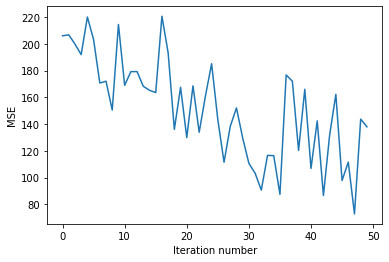

In [26]:
%pylab inline
plot(range(50), stoch_errors_by_iter[:50])
xlabel('Iteration number')
ylabel('MSE')

**Теперь посмотрим на зависимость ошибки от номера итерации для $10^5$ итераций стохастического градиентного спуска. Видим, что алгоритм сходится.**

Populating the interactive namespace from numpy and matplotlib


Text(0, 0.5, 'MSE')

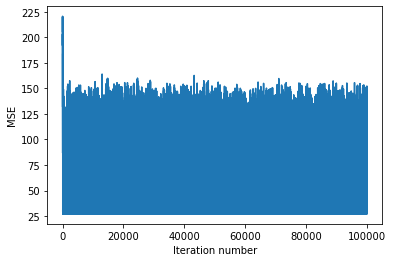

In [27]:
%pylab inline
plot(range(len(stoch_errors_by_iter)), stoch_errors_by_iter)
xlabel('Iteration number')
ylabel('MSE')

**Посмотрим на вектор весов, к которому сошелся метод.**

In [28]:
stoch_grad_desc_weights

array([14.00362253,  3.91635318,  3.01061487,  0.11868927])

**Посмотрим на среднеквадратичную ошибку на последней итерации.**

In [29]:
stoch_errors_by_iter[-1]

39.699731436875574

**Какова среднеквадратичная ошибка прогноза значений Sales в виде линейной модели с весами, найденными с помощью градиентного спуска? Полученный результат, округленный до 3 знаков после запятой, является ответом на *'4 задание'*.**

In [30]:
answer4 = mserror(y, linear_prediction(X, stoch_grad_desc_weights))
print(round(answer4, 3))

2.874
